In [ ]:
conda install -c conda-forge optuna

Channels:
 - conda-forge
 - defaults
Platform: linux-64
Solving environment: done

## Package Plan ##

  environment location: /home/j_choi9/miniconda3/envs/py3

  added / updated specs:
    - optuna


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    alembic-1.13.2             |     pyhd8ed1ab_0         155 KB  conda-forge
    colorlog-6.8.2             |  py312h7900ff3_0          22 KB  conda-forge
    greenlet-3.0.3             |  py312h30efb56_0         228 KB  conda-forge
    importlib-metadata-8.0.0   |     pyha770c72_0          27 KB  conda-forge
    importlib_resources-6.4.0  |     pyhd8ed1ab_0          32 KB  conda-forge
    mako-1.3.5                 |     pyhd8ed1ab_0          66 KB  conda-forge
    optuna-3.6.1               |     pyhd8ed1ab_0         218 KB  conda-forge
    sqlalchemy-2.0.31          |  py312h9a8786e_0         3.3 MB  conda-forge
    zipp-3.19.2               

In [ ]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
from sklearn import metrics
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score, precision_score, make_scorer
from sklearn.model_selection import train_test_split, GridSearchCV, LeaveOneGroupOut
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
import optuna

KeyboardInterrupt: 

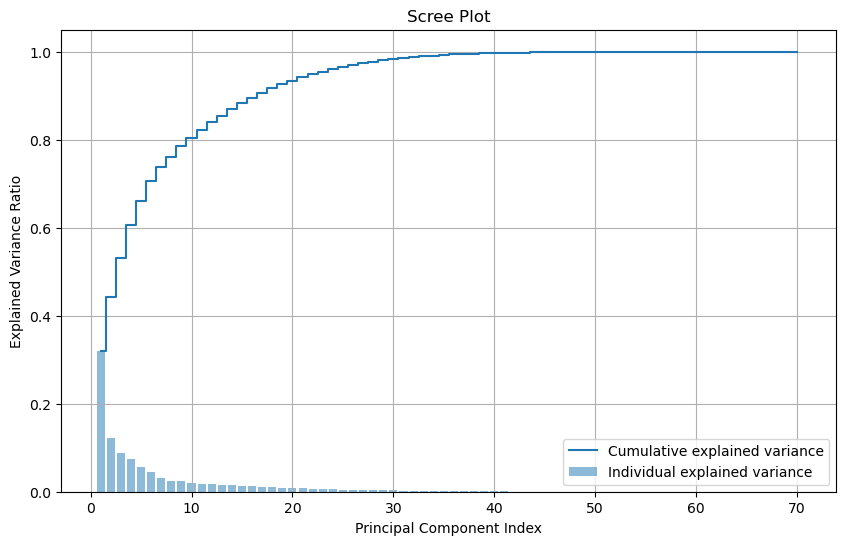

Number of components explaining 95% of the variance: 23


In [ ]:
dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data.loc[data['activity'].isin([0, 1, 2, 7, 8, 9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 4, 5, 6]), 'activity'] = 1
    dataframes[name] = data

combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(df[numerical_cols])
pca = PCA()
pca_data = pca.fit_transform(scaled_data)
explained_variance = pca.explained_variance_ratio_

# Cumulative variance explained
cumulative_variance = np.cumsum(explained_variance)

# Scree plot
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(1, len(cumulative_variance) + 1), cumulative_variance, where='mid', label='Cumulative explained variance')
plt.xlabel('Principal Component Index')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot')
plt.legend(loc='best')
plt.grid()
plt.show()

num_components_95_var = np.argmax(cumulative_variance >= 0.95) + 1

print(f"Number of components explaining 95% of the variance: {num_components_95_var}")

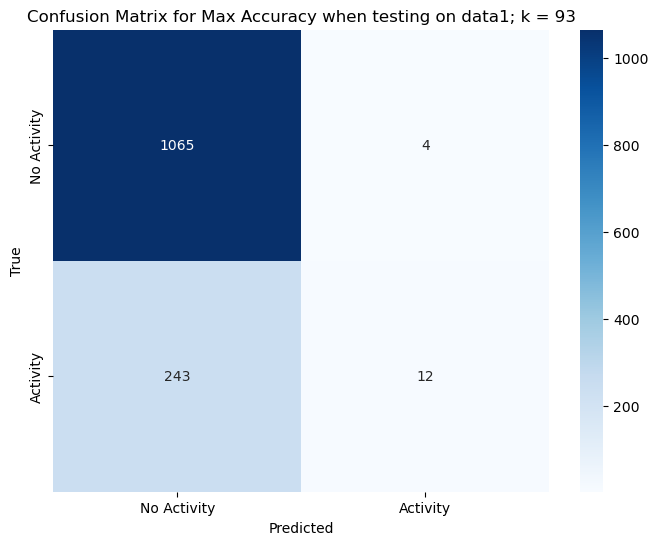

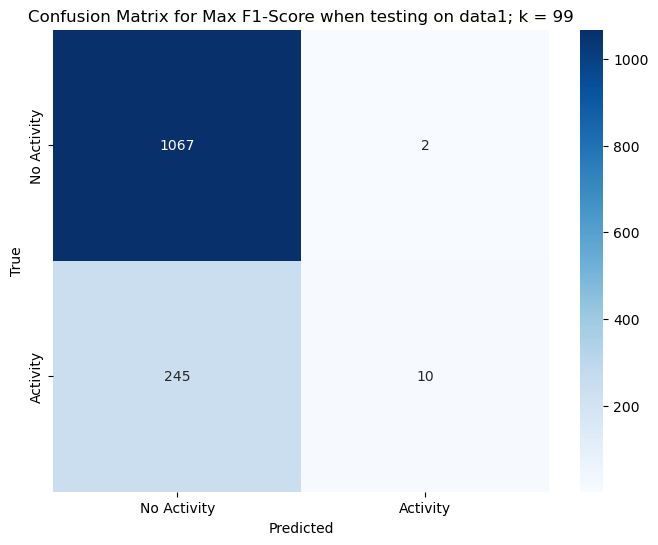

data1 has been tested on everyone


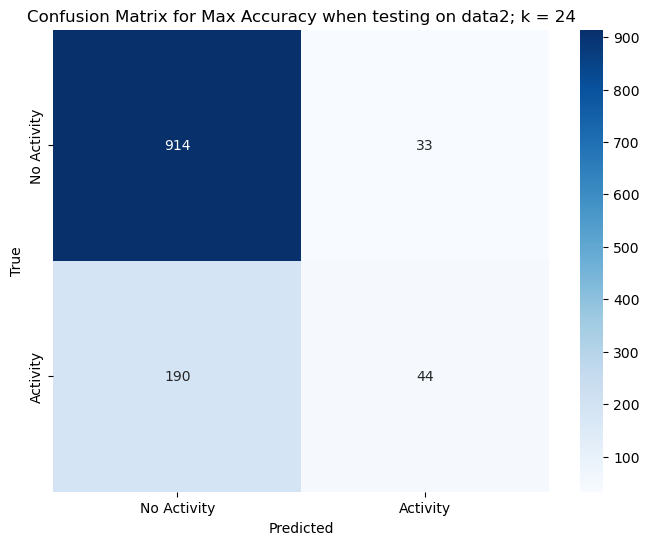

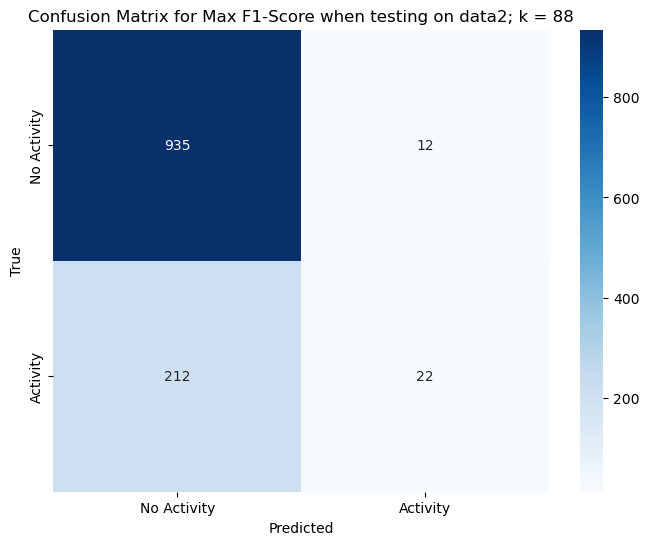

data2 has been tested on everyone


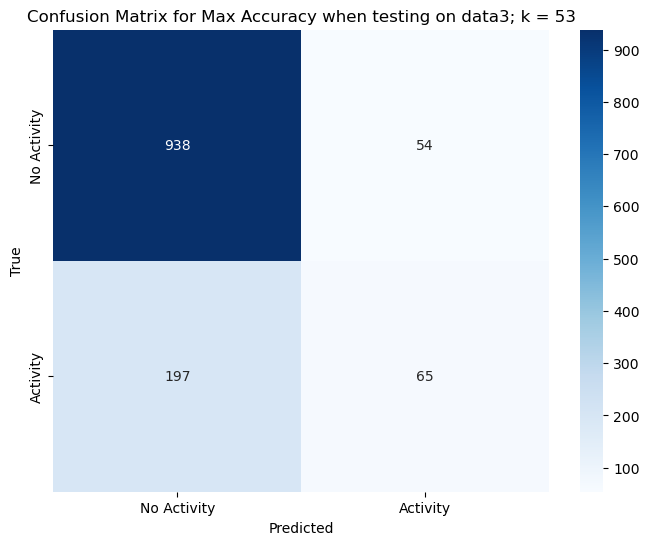

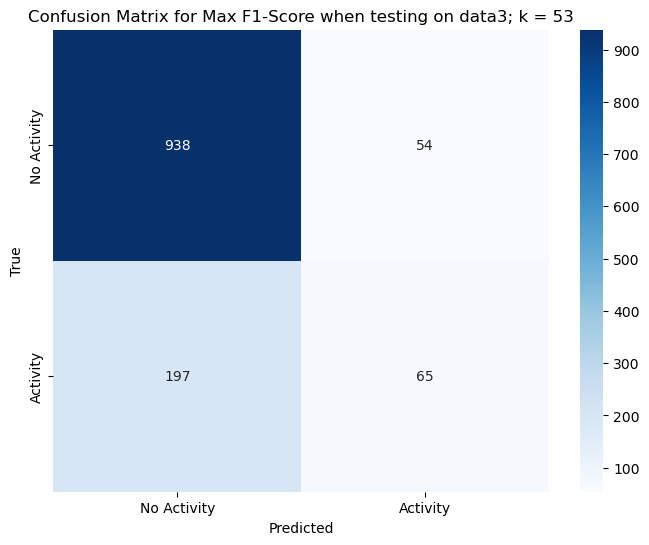

data3 has been tested on everyone


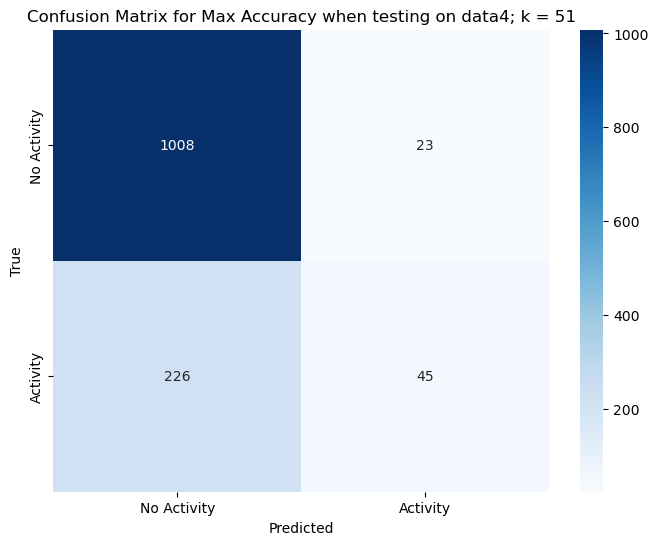

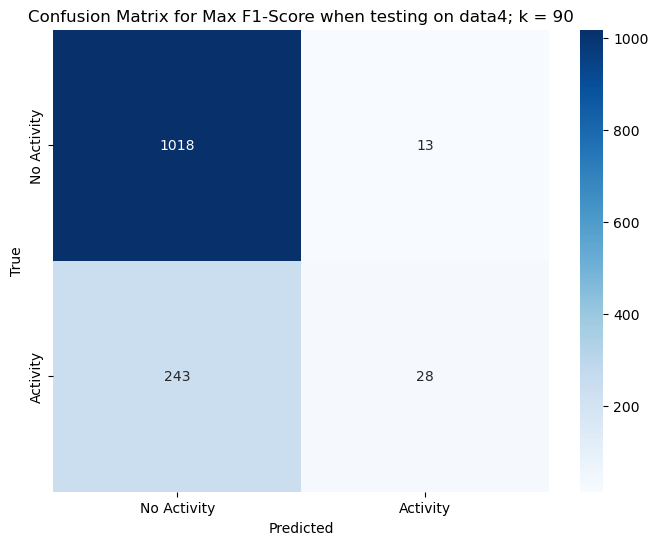

data4 has been tested on everyone


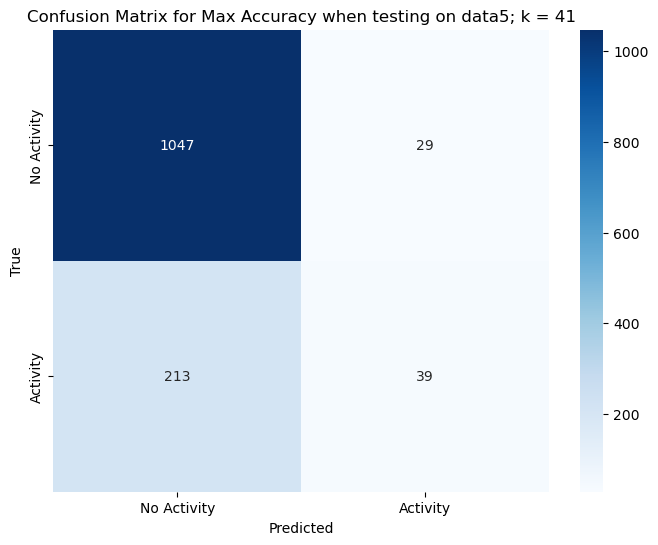

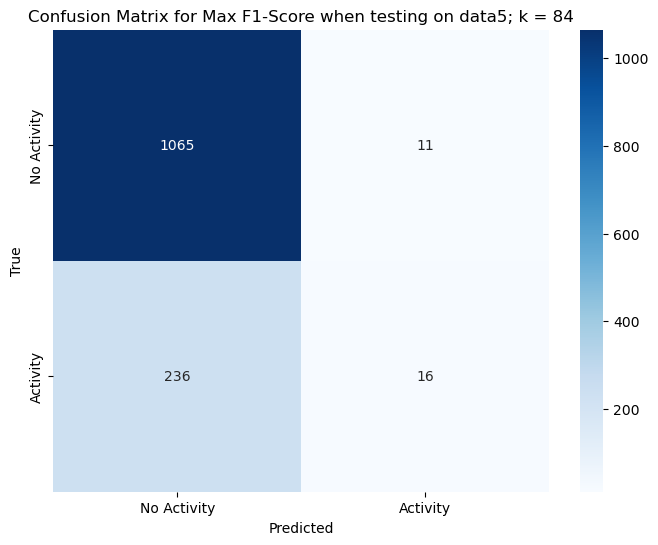

data5 has been tested on everyone


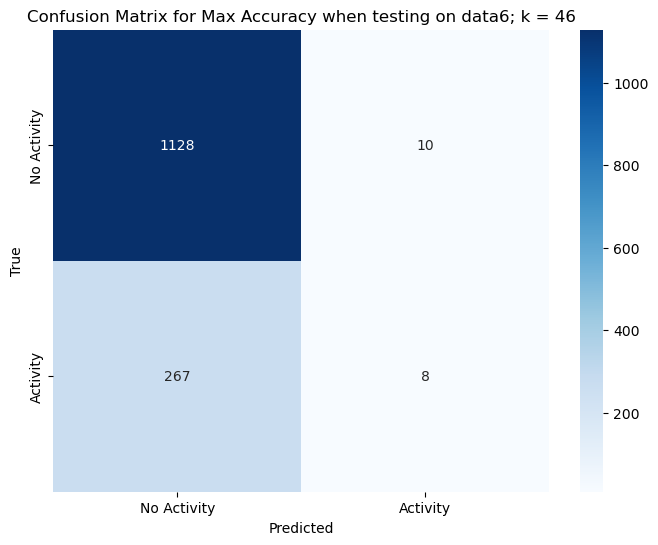

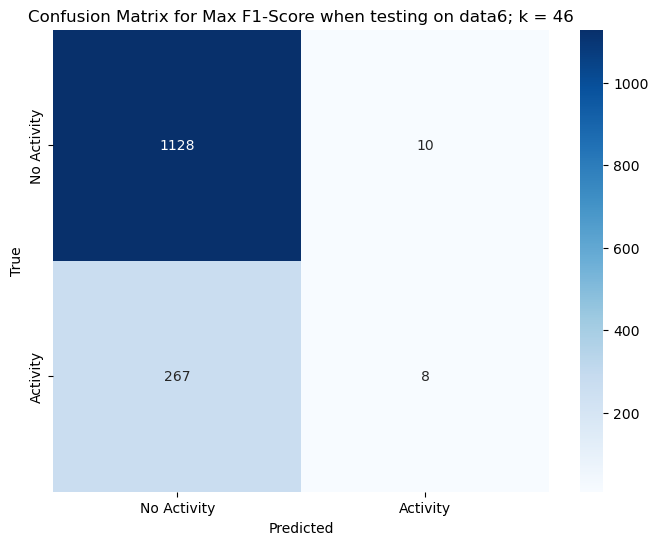

data6 has been tested on everyone


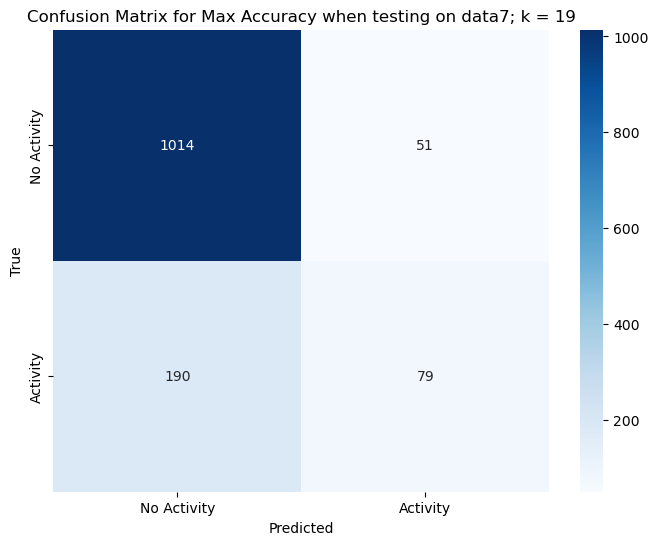

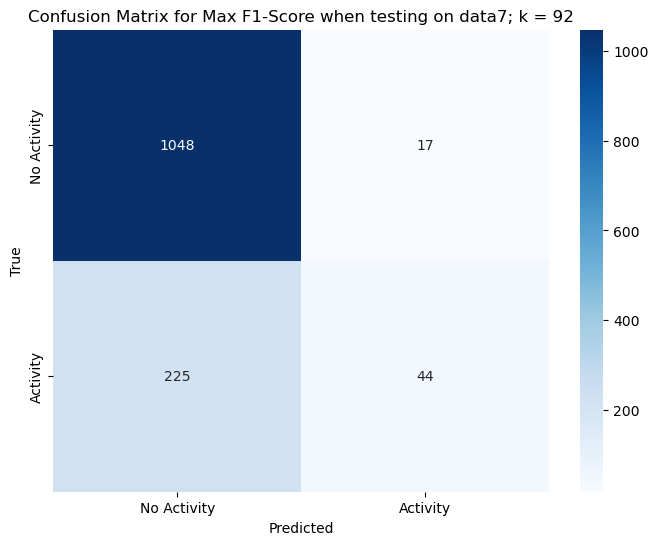

data7 has been tested on everyone


/home/j_choi9/miniconda3/envs/myenv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/j_choi9/miniconda3/envs/myenv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


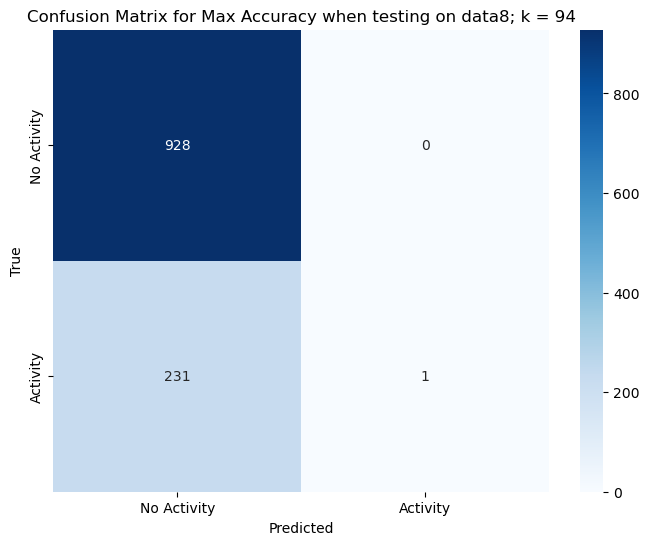

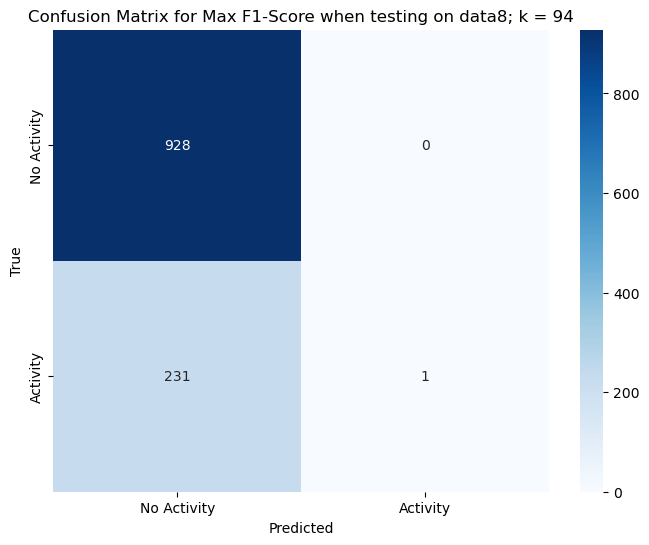

data8 has been tested on everyone


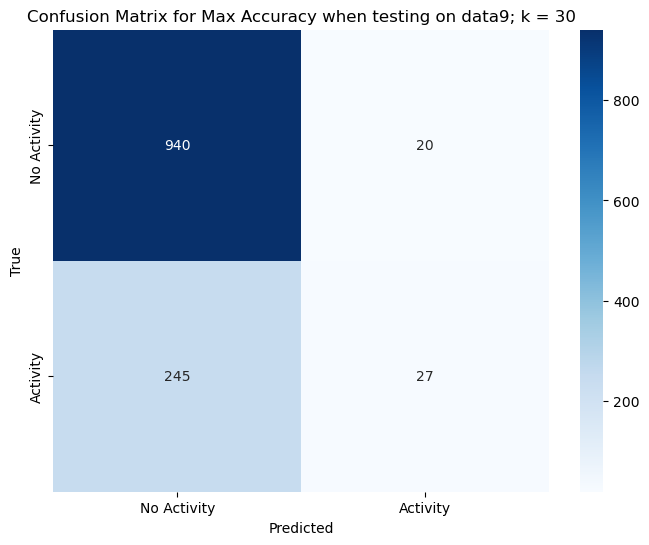

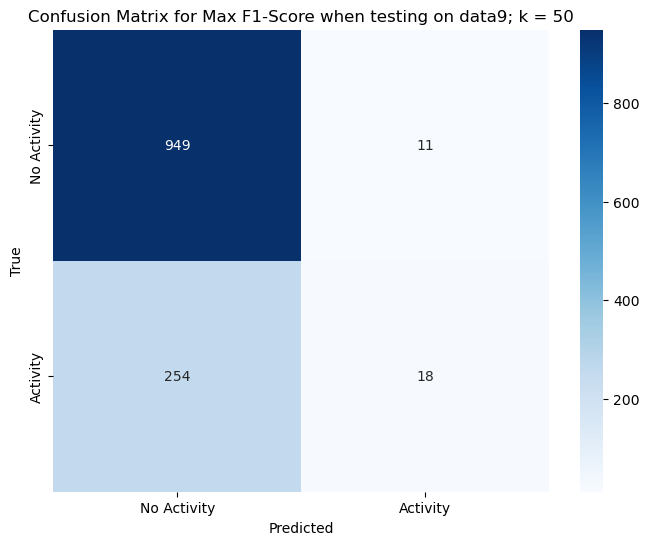

data9 has been tested on everyone


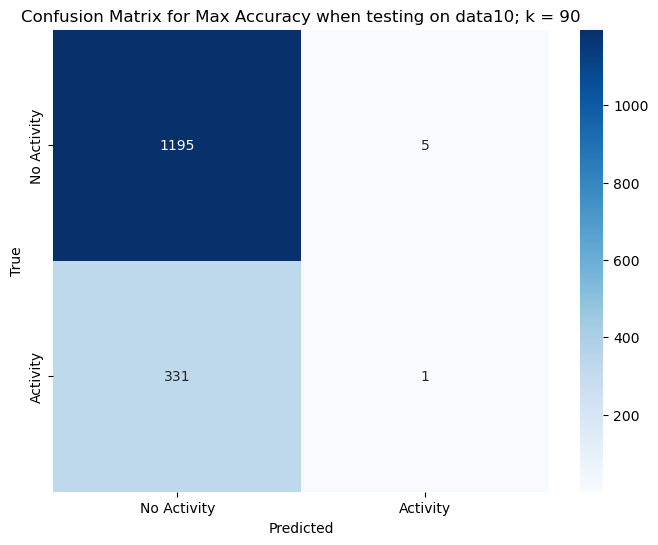

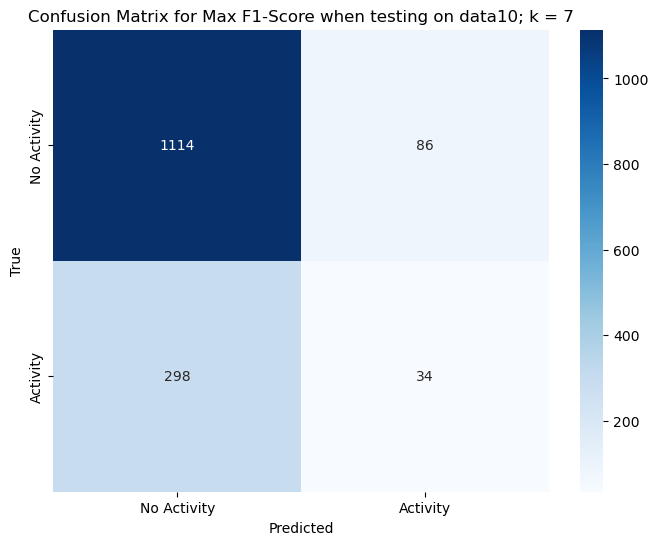

data10 has been tested on everyone


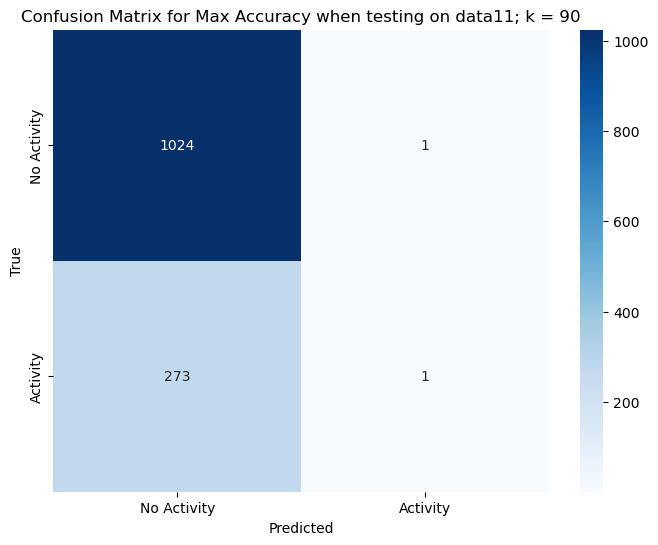

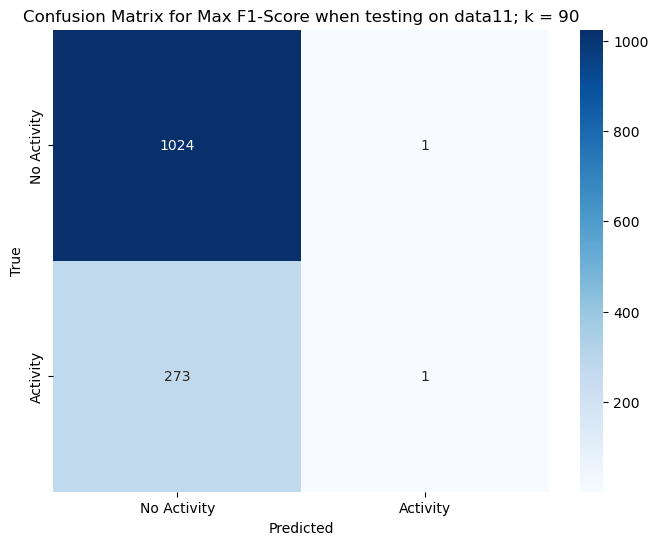

data11 has been tested on everyone


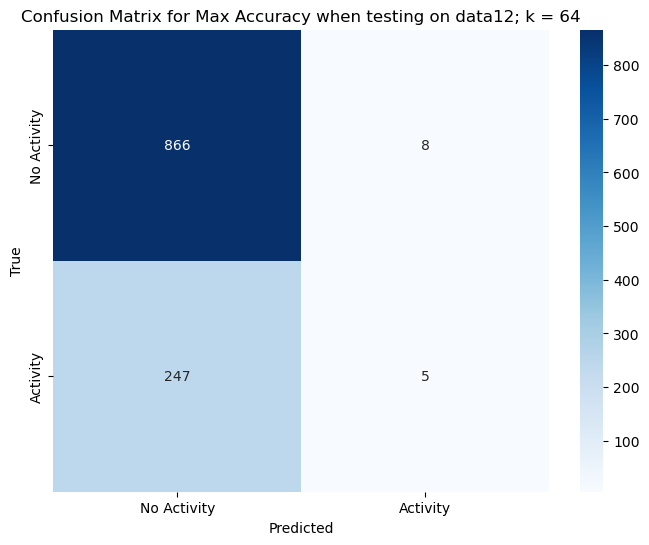

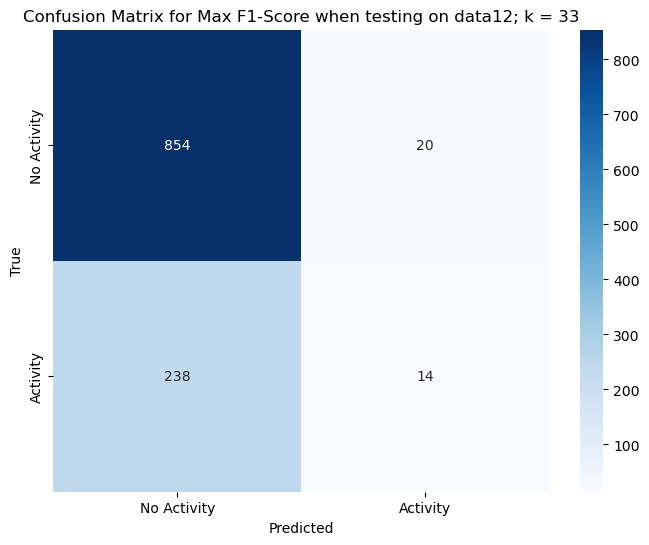

data12 has been tested on everyone


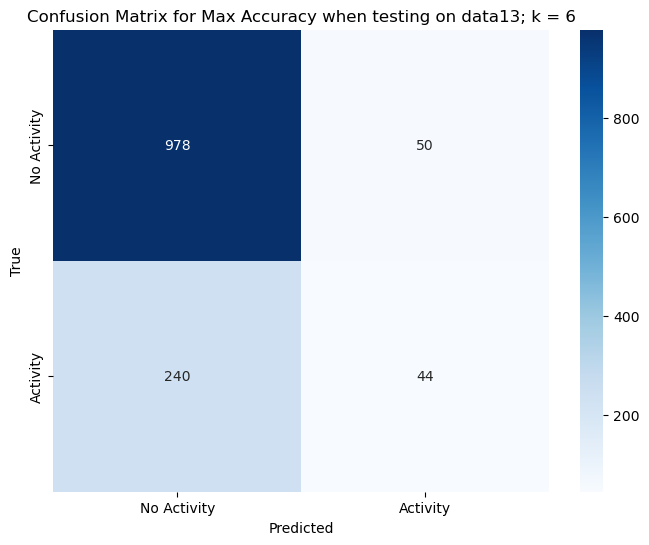

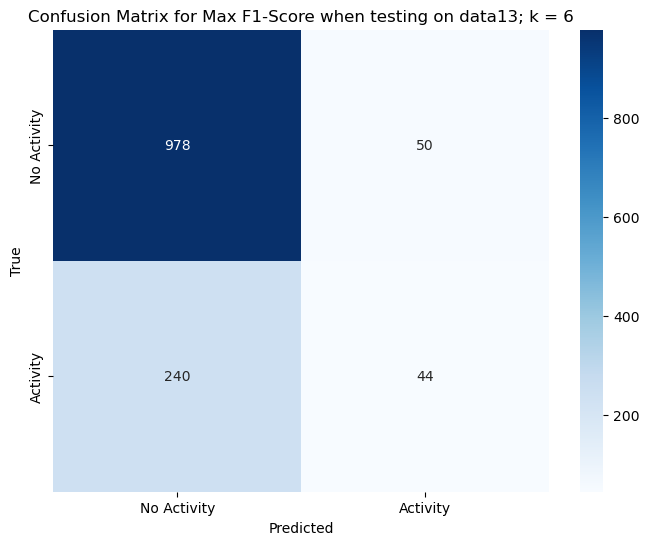

data13 has been tested on everyone


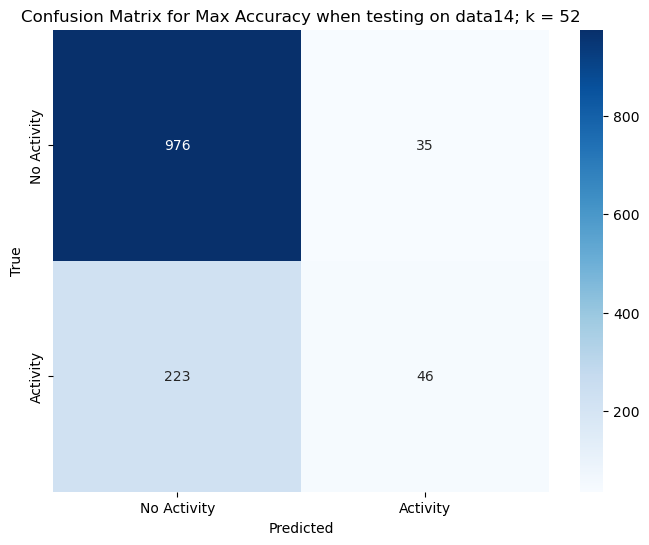

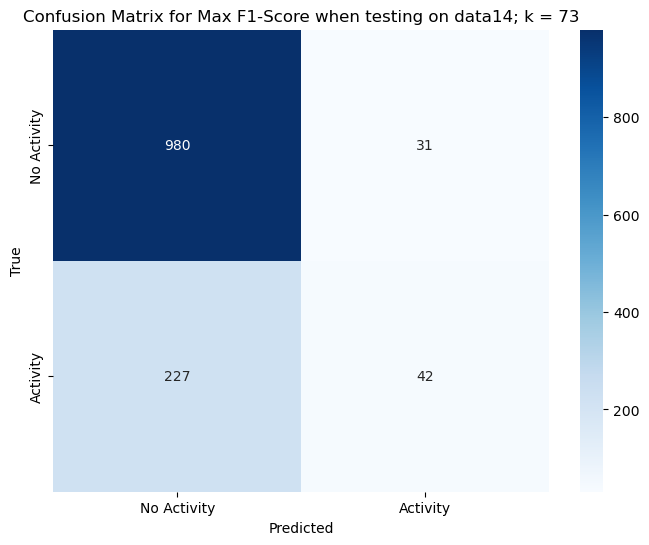

data14 has been tested on everyone


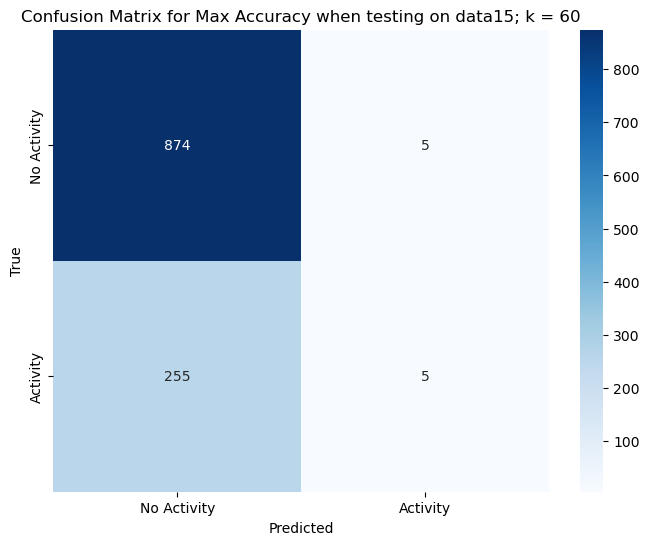

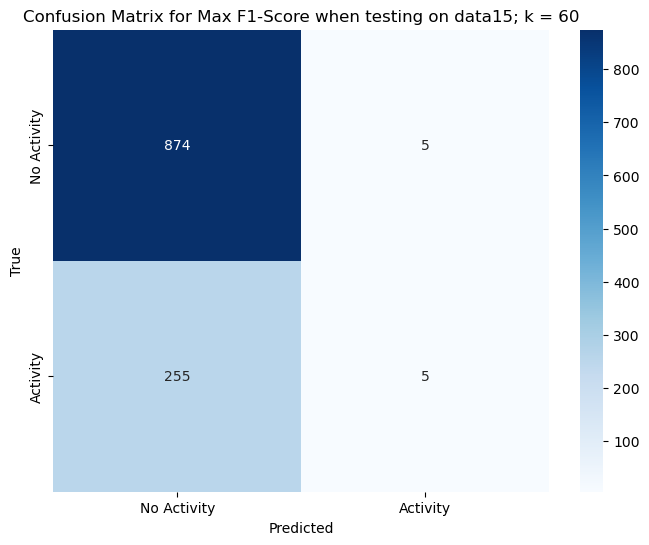

data15 has been tested on everyone


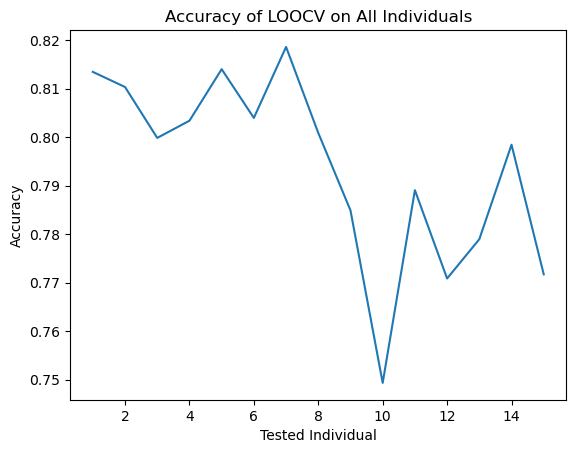

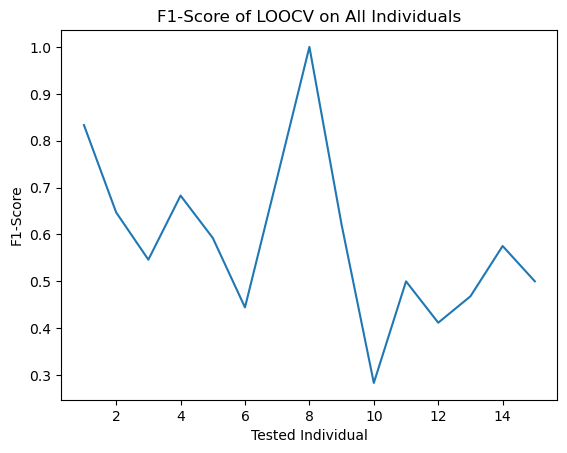

Average Accuracy:  0.793849031347139
Average F1-Score:  0.5884734168331581


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## 0: baseline, other measures
## 1: stairs, soccer, cycling, walking

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data.loc[data['activity'].isin([0, 1, 2, 7, 8, 9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 4, 5, 6]), 'activity'] = 1
    dataframes[name] = data


for key, df in dataframes.items():
    numerical_cols = [col for col in df.columns if col != 'activity']

    scaled_data = StandardScaler().fit_transform(df[numerical_cols])

    pca = PCA(n_components=23)
    pca_data = pca.fit_transform(scaled_data)
    pca_df = pd.DataFrame(data=pca_data, columns=[f'PCA{i}' for i in range(1, 24)])  # Adjust column names as needed
    pca_df['activity'] = df['activity']

    dataframes[key] = pca_df

LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = precision_score(testingActivity, knn.predict(testingFeatures))
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, precision_score(testingActivity, y_pred))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## 0: baseline, other measures
## 1: stairs, soccer, cycling, walking

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data.loc[data['activity'].isin([0, 1, 2, 7, 8, 9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 4, 5, 6]), 'activity'] = 1
    dataframes[name] = data

combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

pca = PCA(n_components=23)
pca_data = pca.fit_transform(scaled_data)
pca_df = pd.DataFrame(data=pca_data, columns=[f'PCA{i}' for i in range(1, 24)])  # Adjust column names as needed
pca_df['activity'] = df['activity']

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = pca_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx

LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = precision_score(testingActivity, knn.predict(testingFeatures))
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, precision_score(testingActivity, y_pred))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


ValueError: Input y contains NaN.

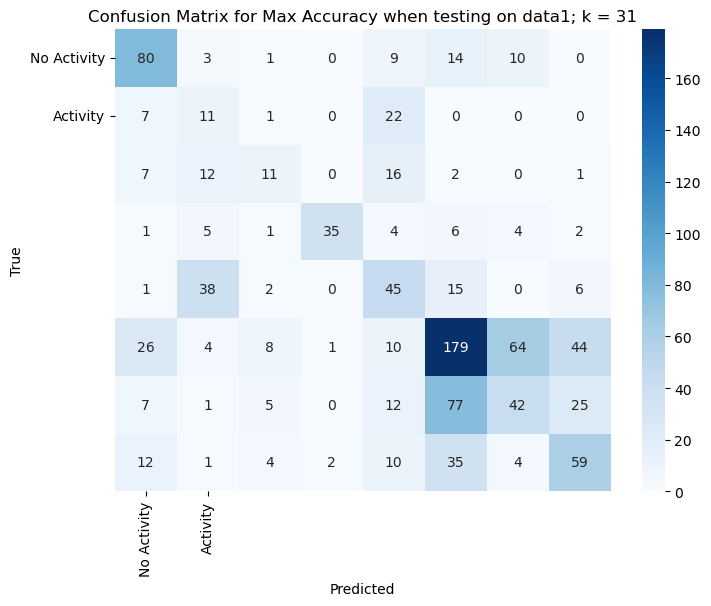

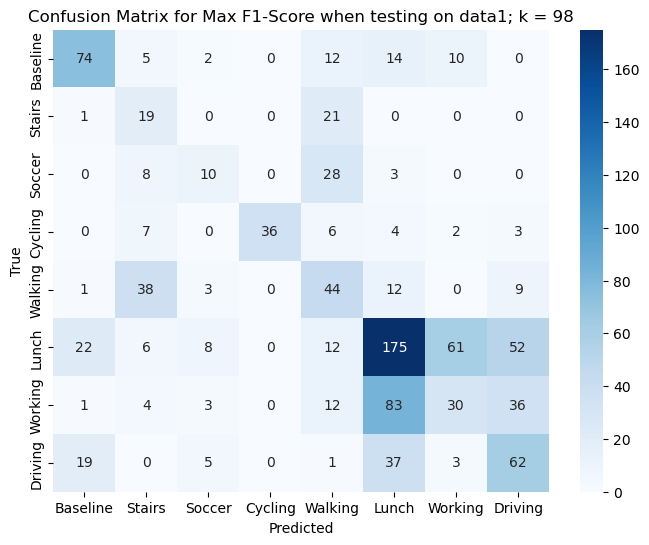

data1 has been tested on everyone


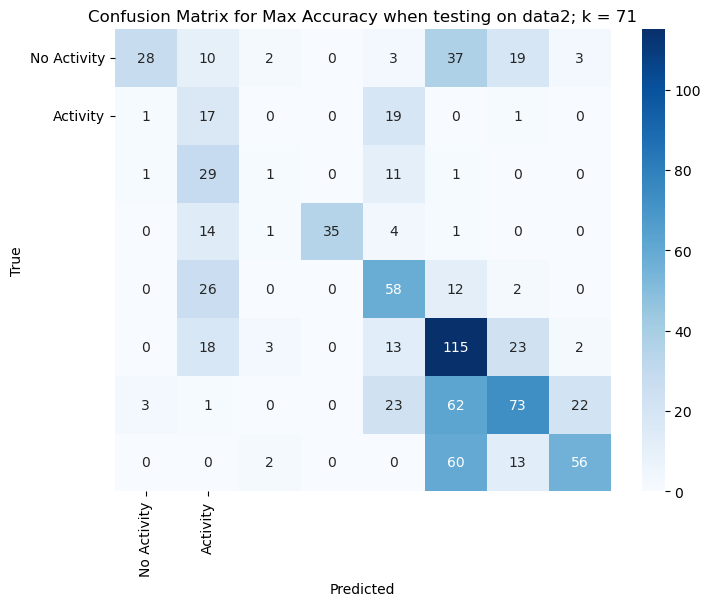

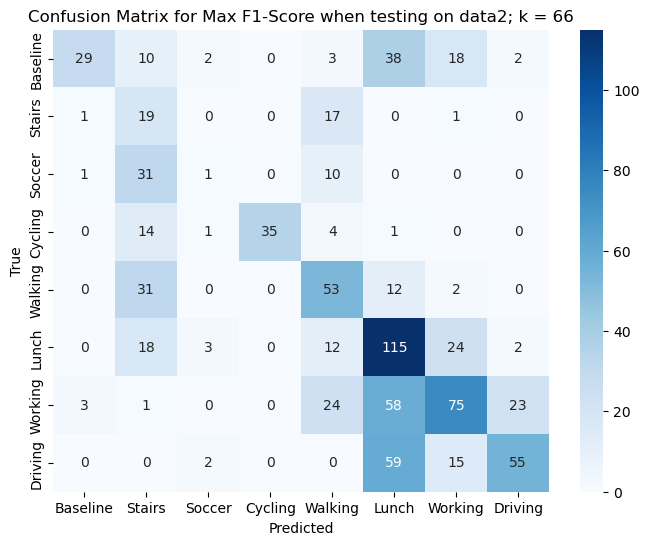

data2 has been tested on everyone


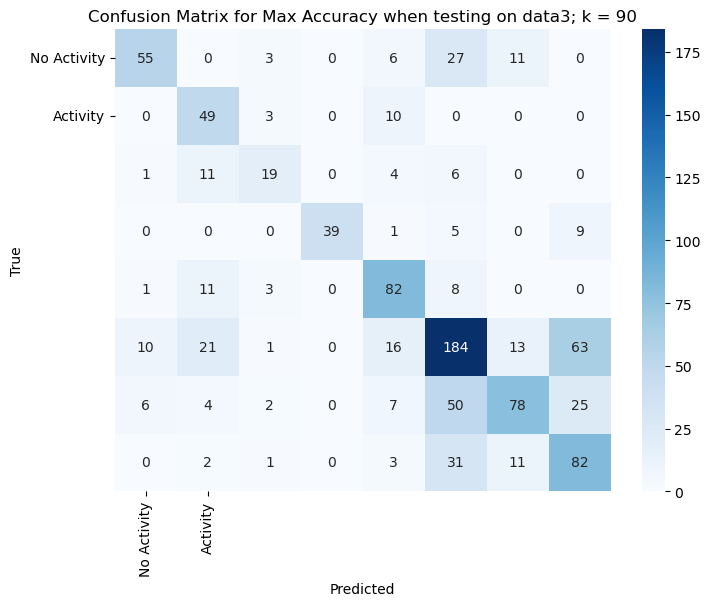

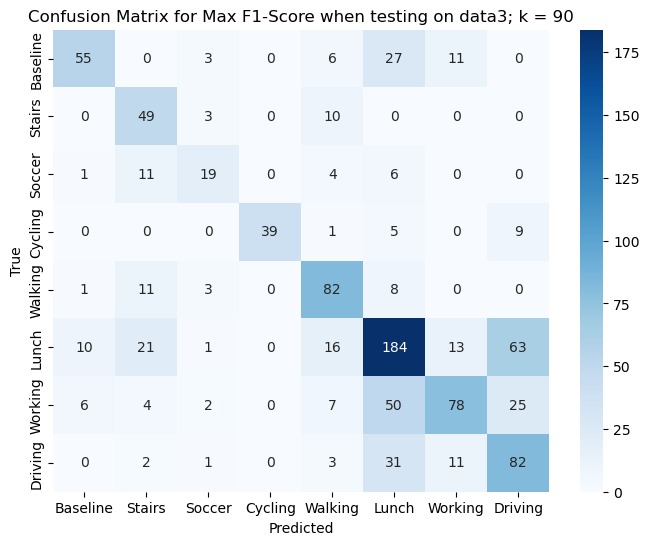

data3 has been tested on everyone


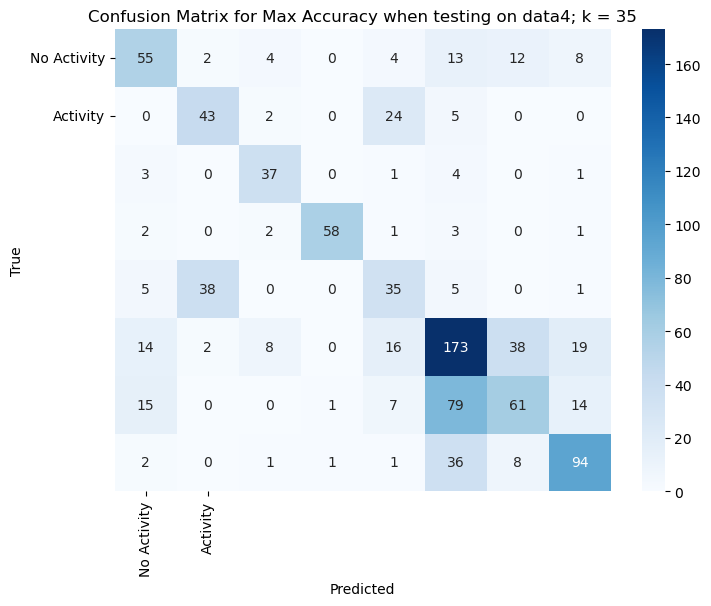

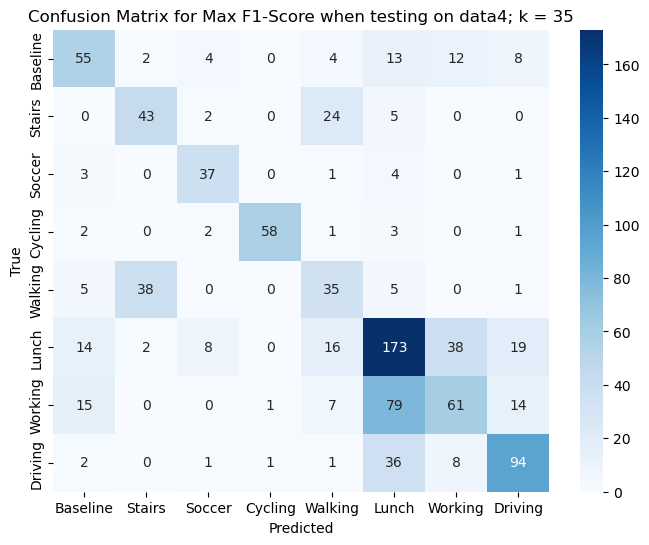

data4 has been tested on everyone


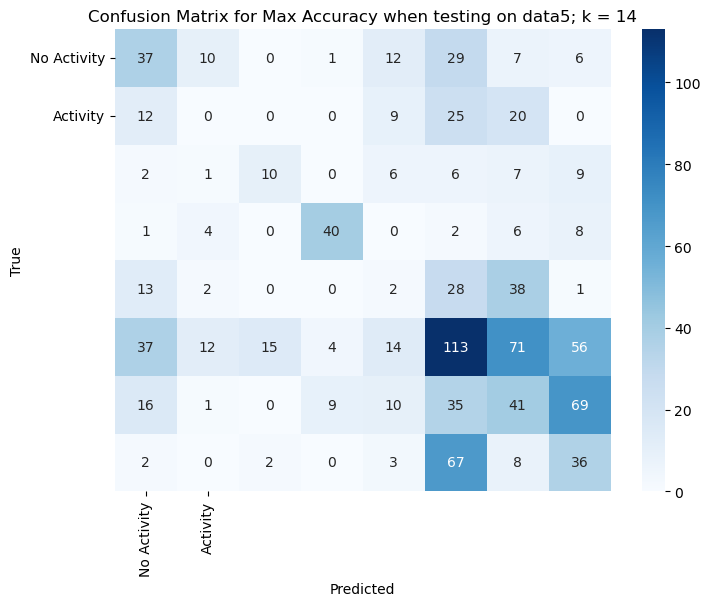

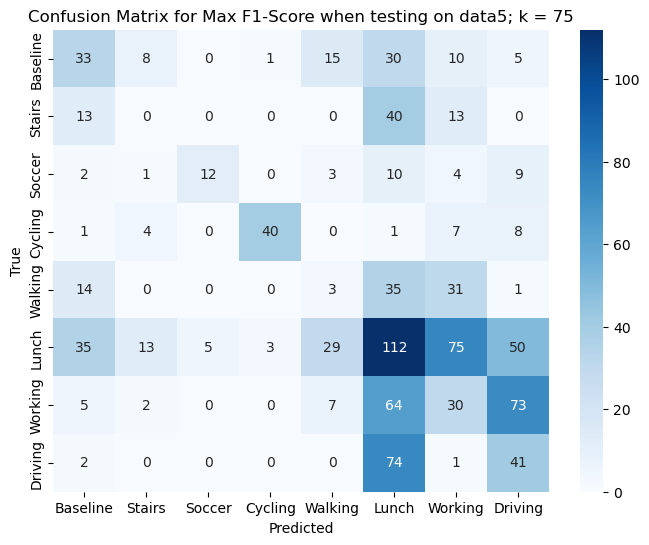

data5 has been tested on everyone


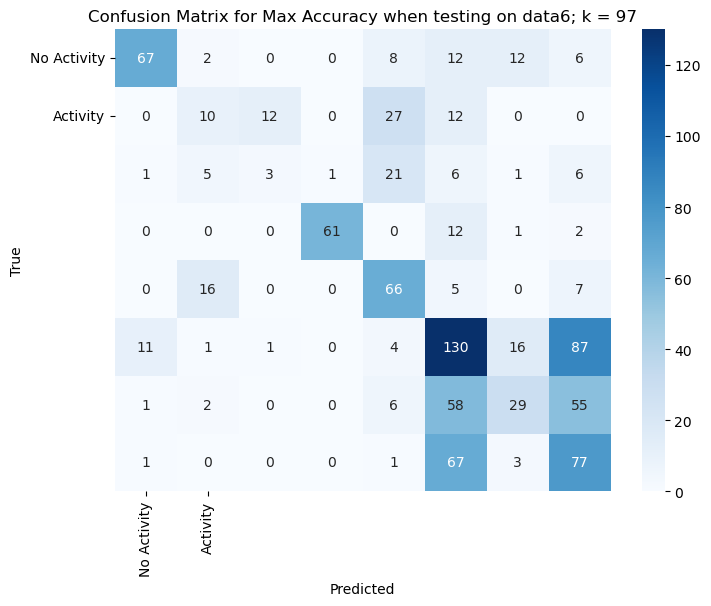

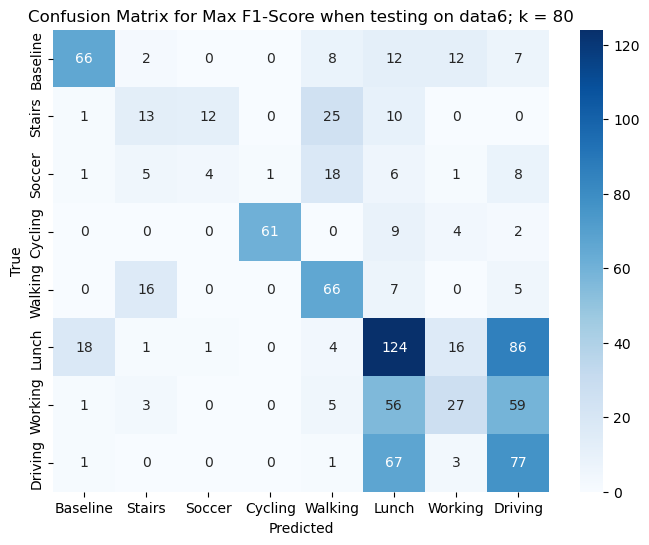

data6 has been tested on everyone


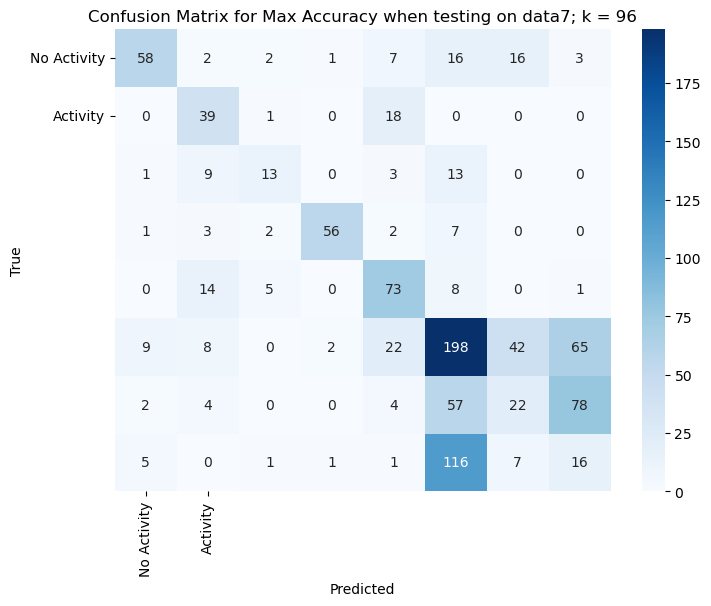

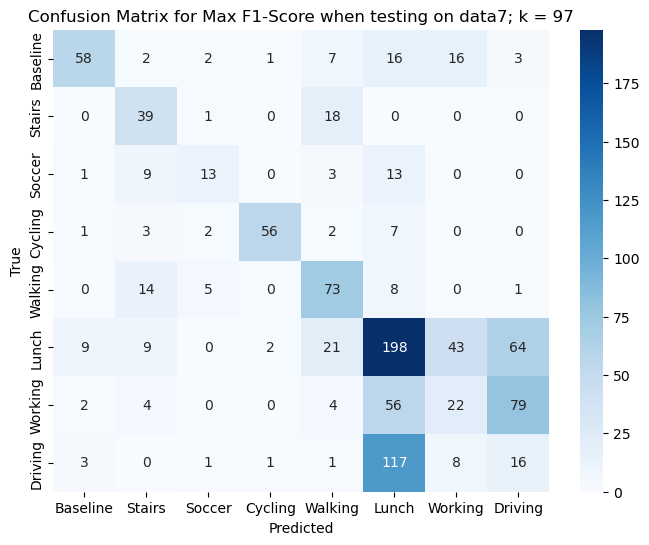

data7 has been tested on everyone


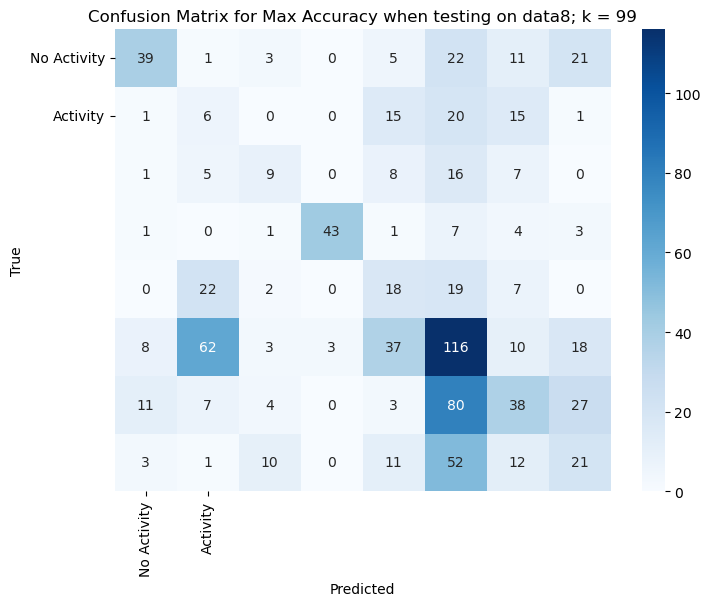

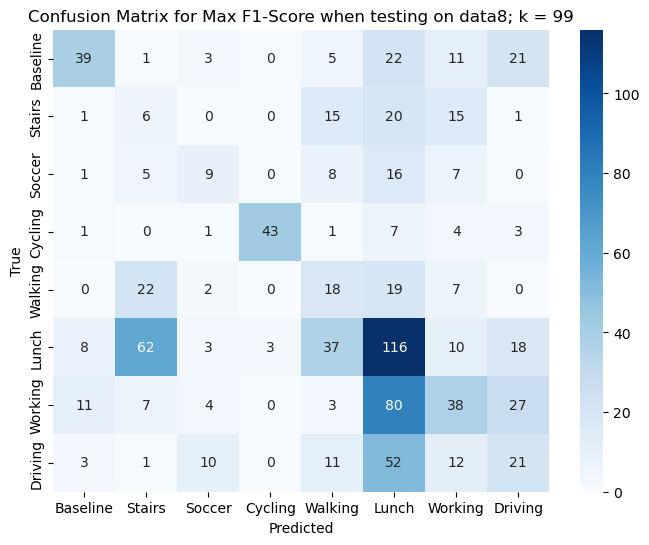

data8 has been tested on everyone


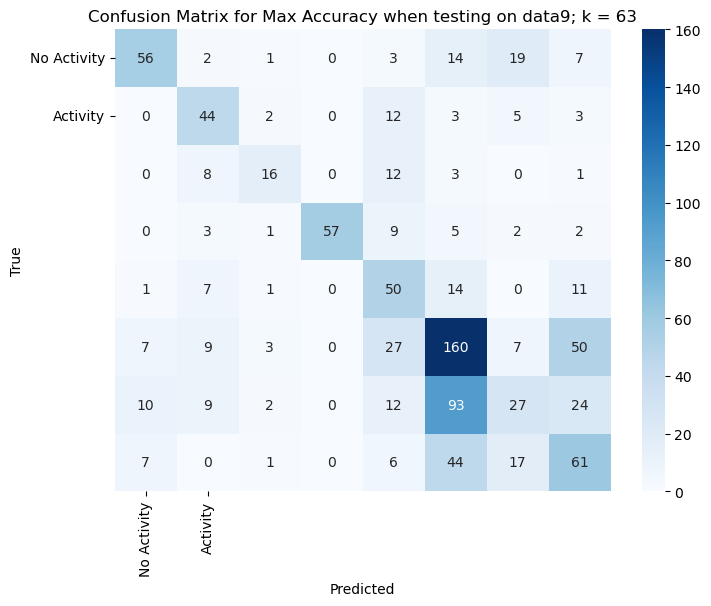

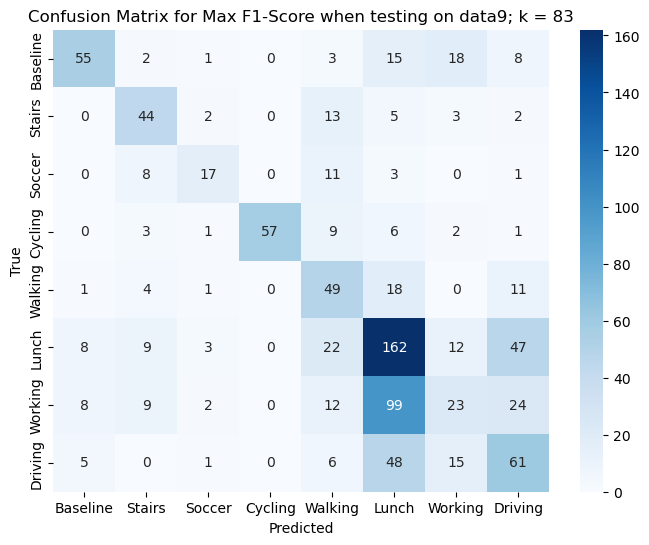

data9 has been tested on everyone


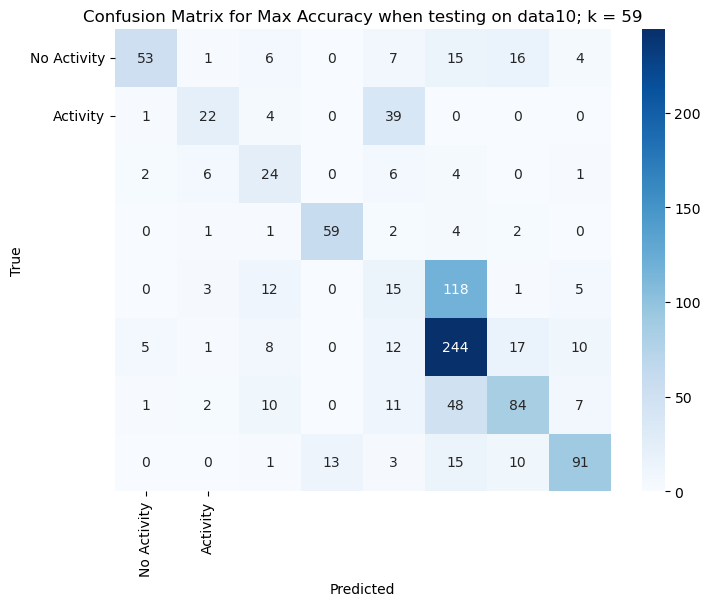

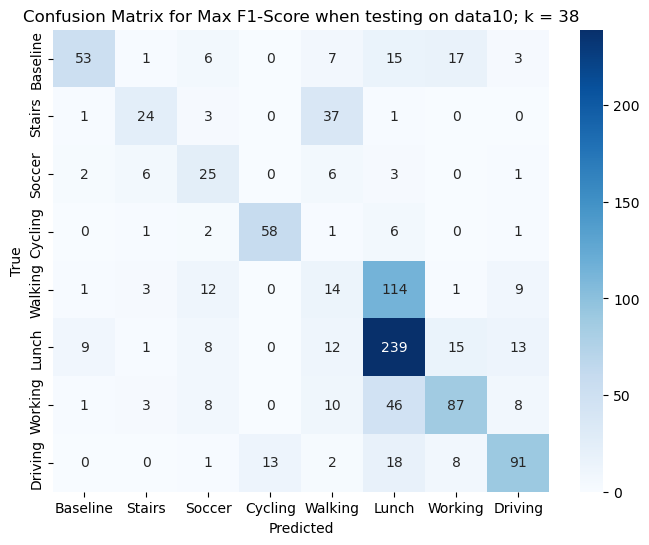

data10 has been tested on everyone


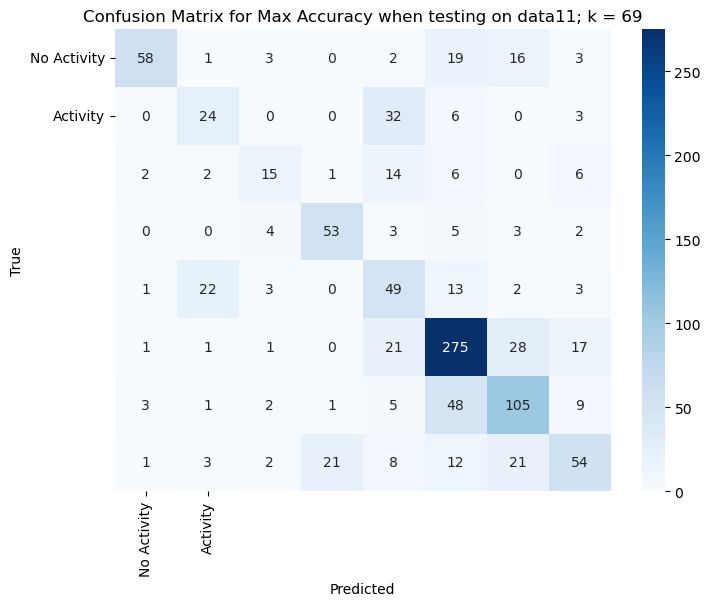

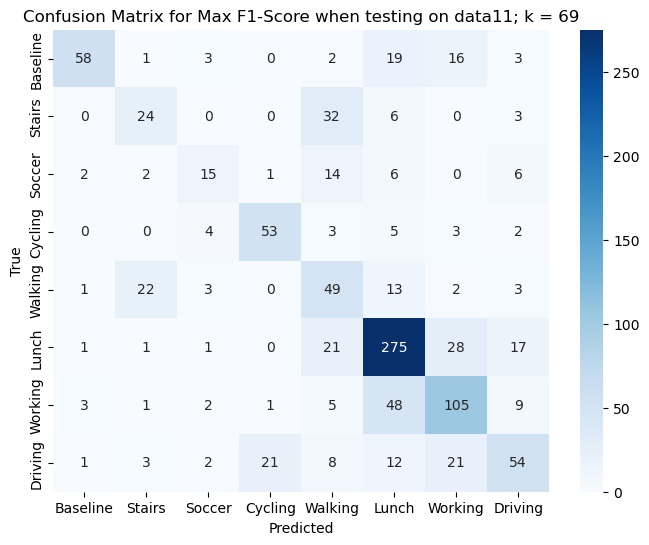

data11 has been tested on everyone


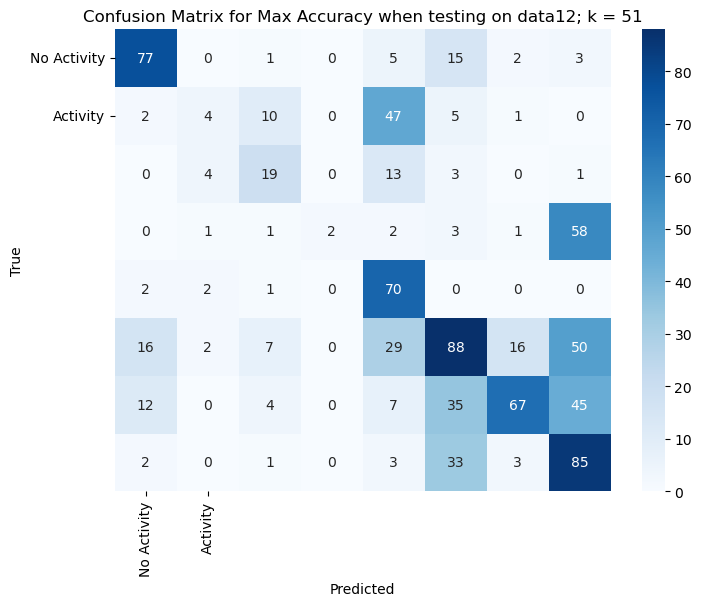

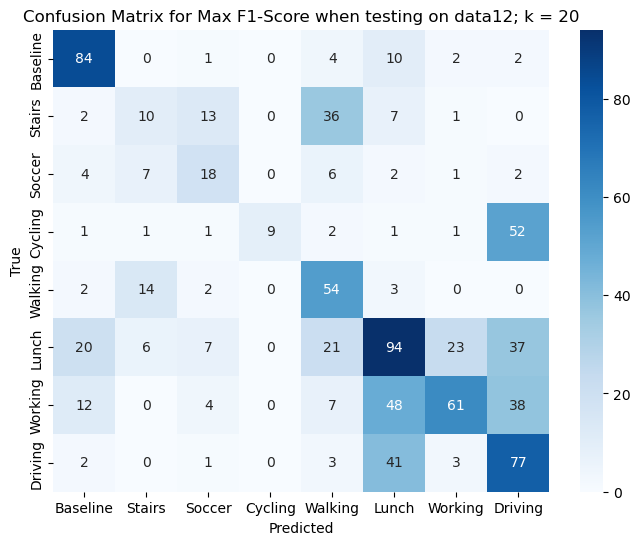

data12 has been tested on everyone


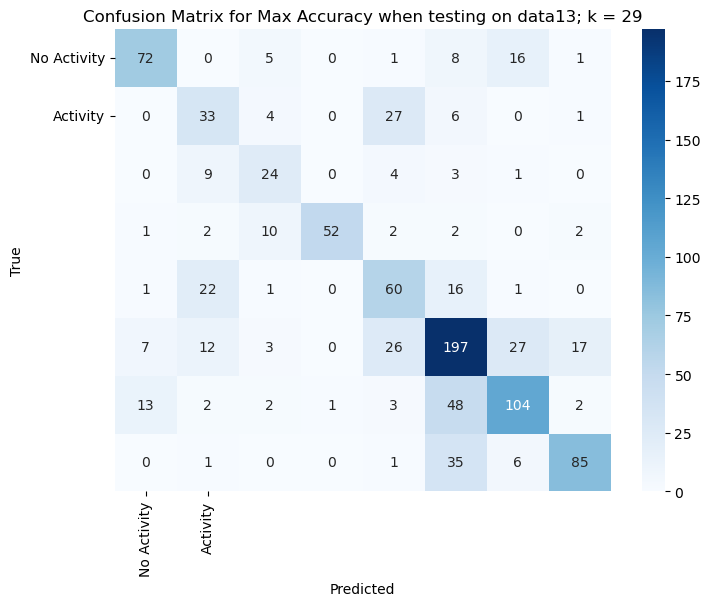

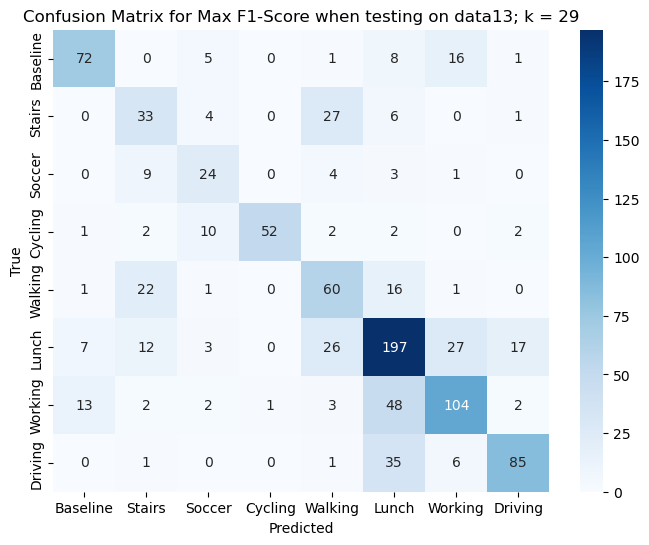

data13 has been tested on everyone


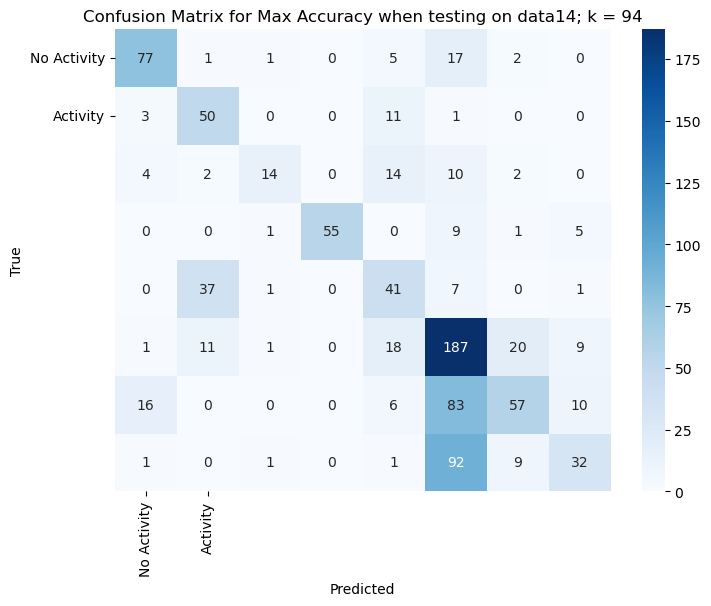

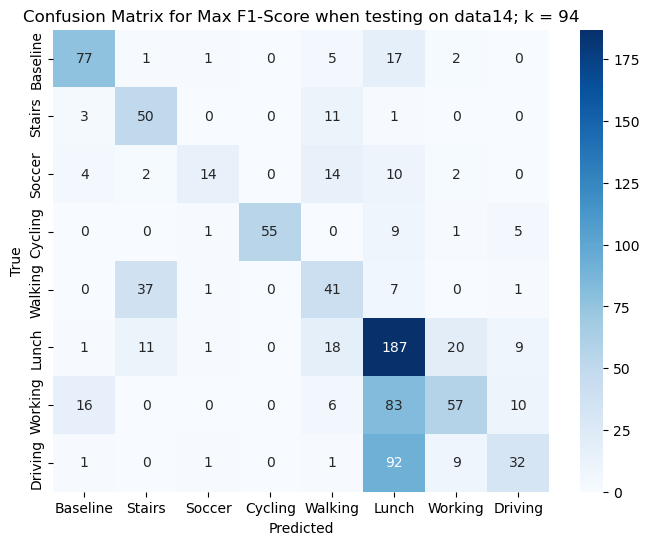

data14 has been tested on everyone


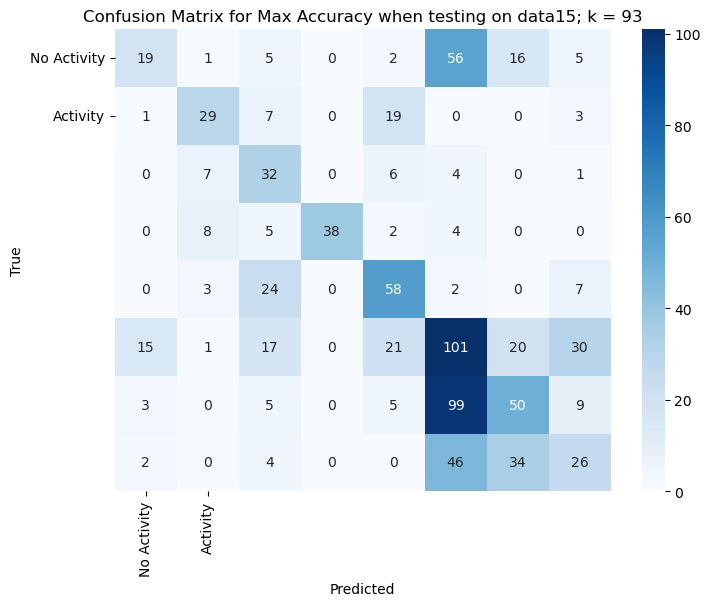

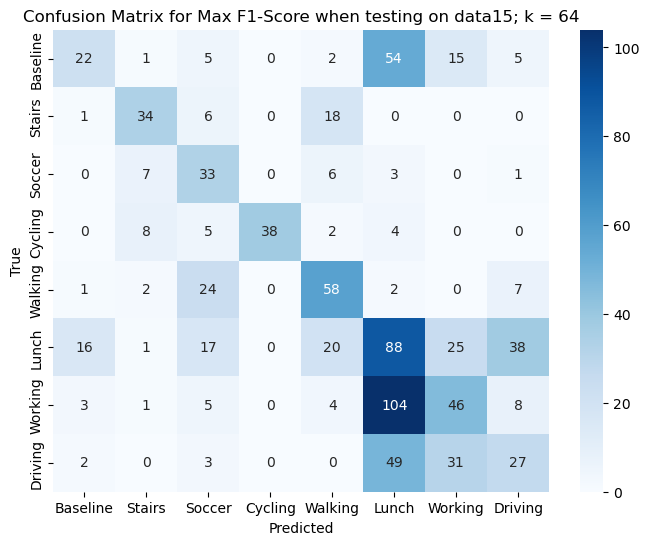

data15 has been tested on everyone


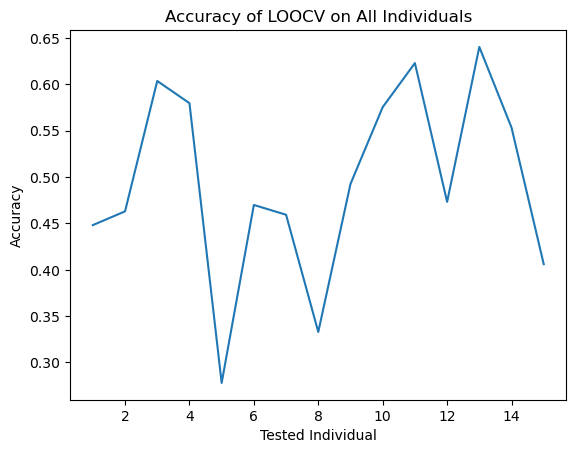

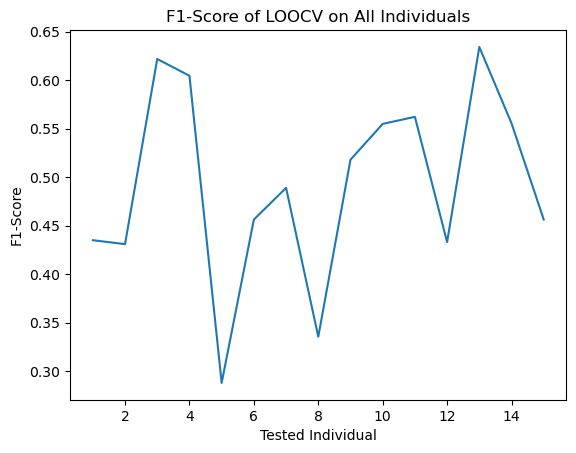

Average Accuracy:  0.493284921779399
Average F1-Score:  0.4915769353479415


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## tsne
## 0: all seperate classes

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0])]
    data.loc[data['activity'].isin([2]), 'activity'] = 1
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

tsne = TSNE(n_components=3)
X_tsne = tsne.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_tsne, columns=[f'TSNE{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = f1_score(testingActivity, knn.predict(testingFeatures), average='macro')
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Baseline", "Stairs", "Soccer", "Cycling", "Walking", "Lunch", "Working", "Driving"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Baseline", "Stairs", "Soccer", "Cycling", "Walking", "Lunch", "Working", "Driving"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, f1_score(testingActivity, y_pred, average='macro'))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


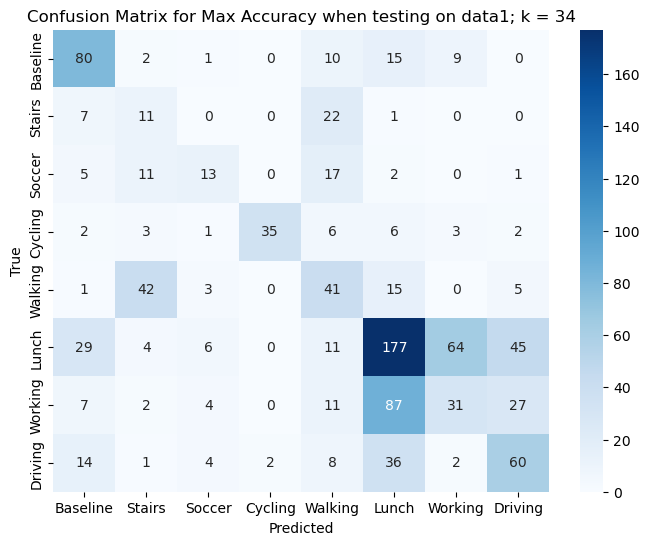

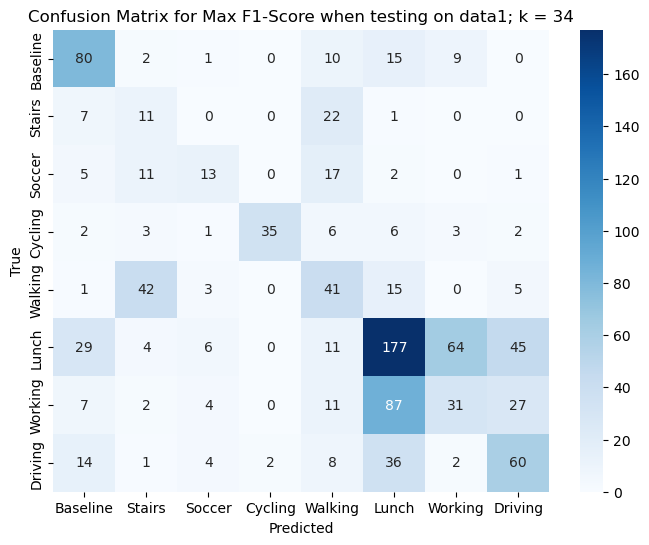

data1 has been tested on everyone


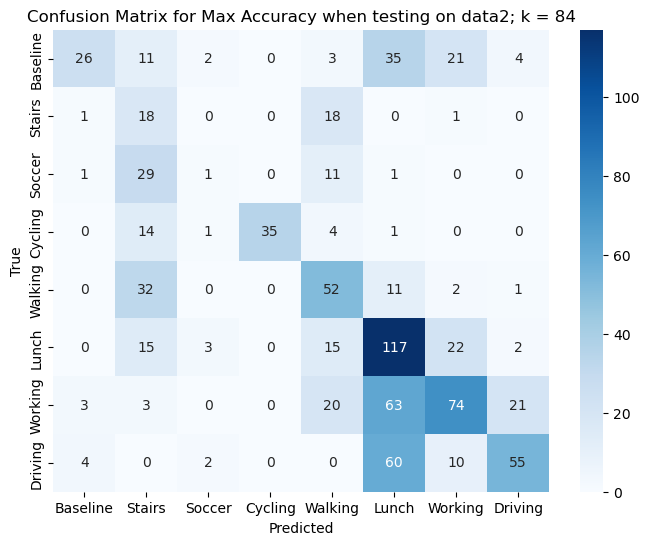

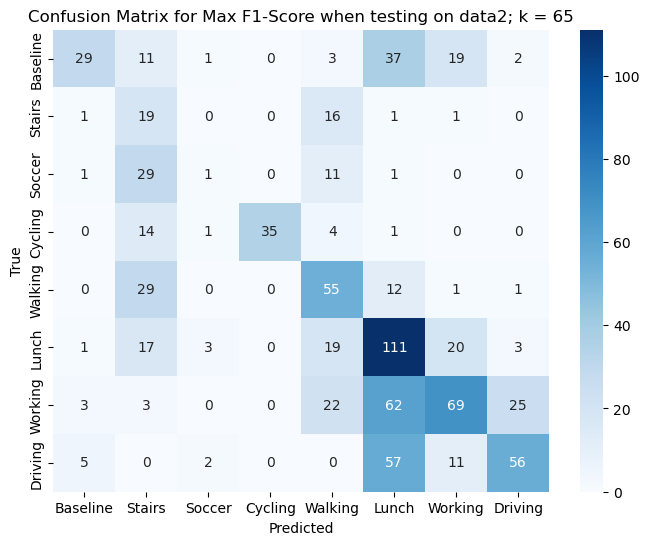

data2 has been tested on everyone


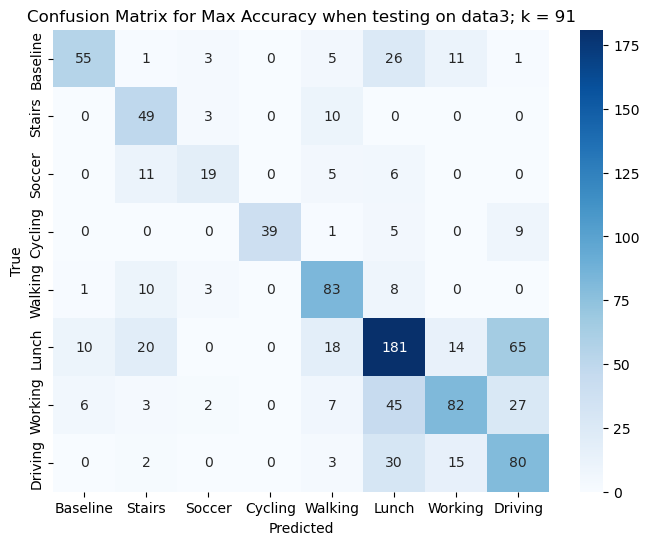

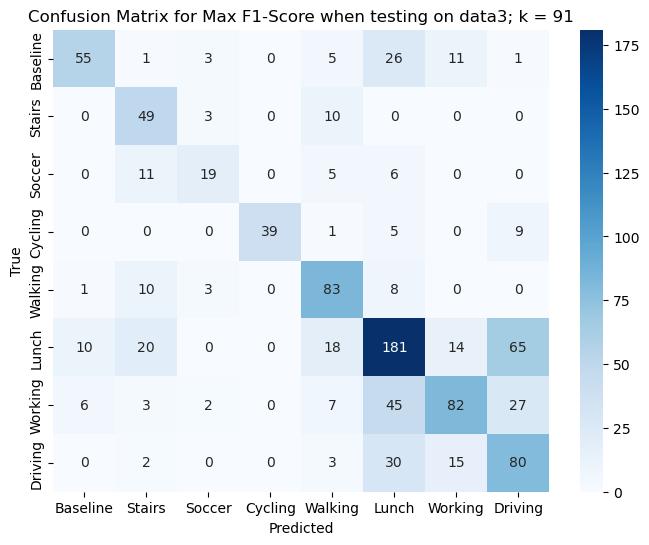

data3 has been tested on everyone


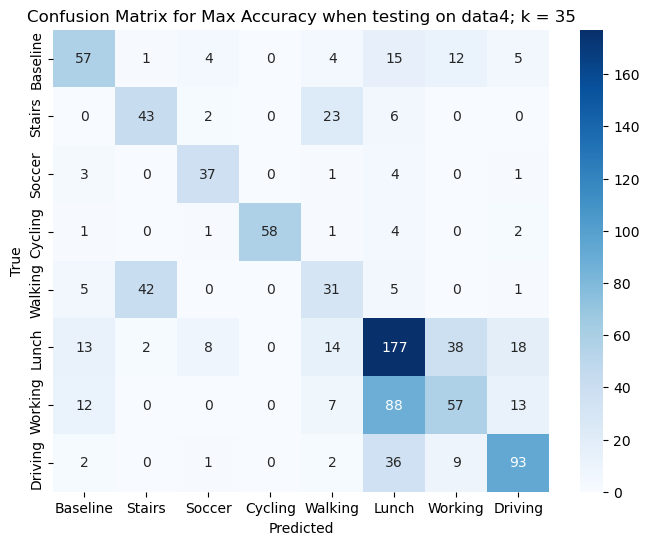

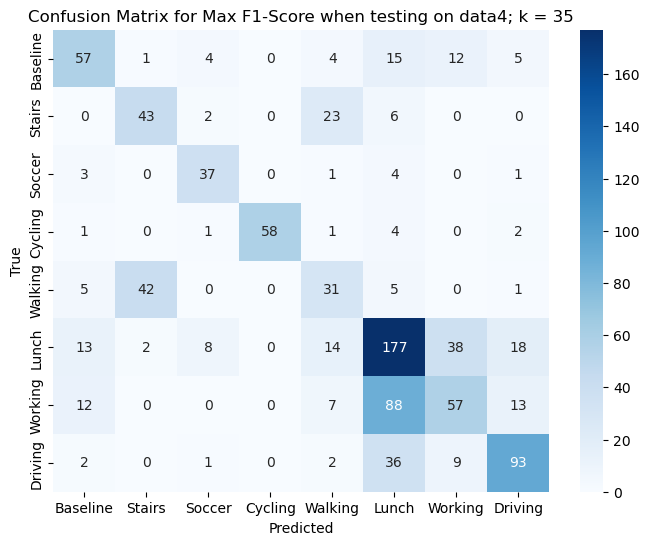

data4 has been tested on everyone


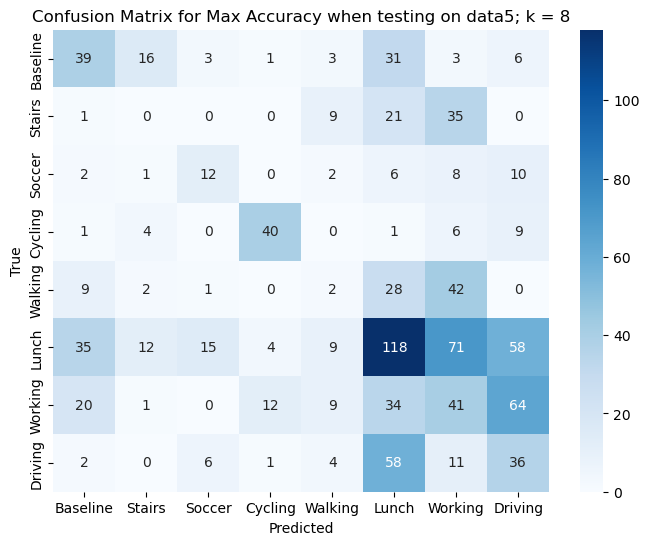

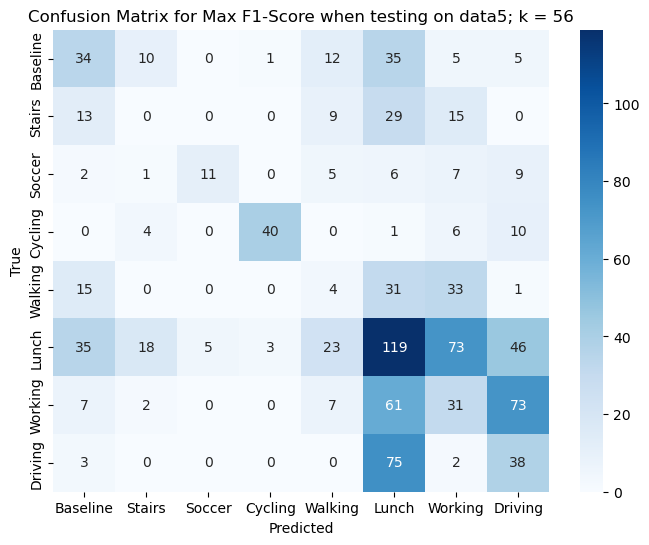

data5 has been tested on everyone


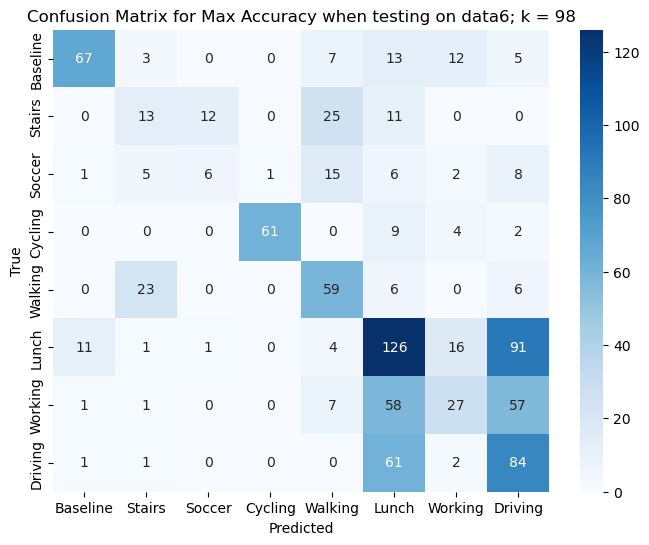

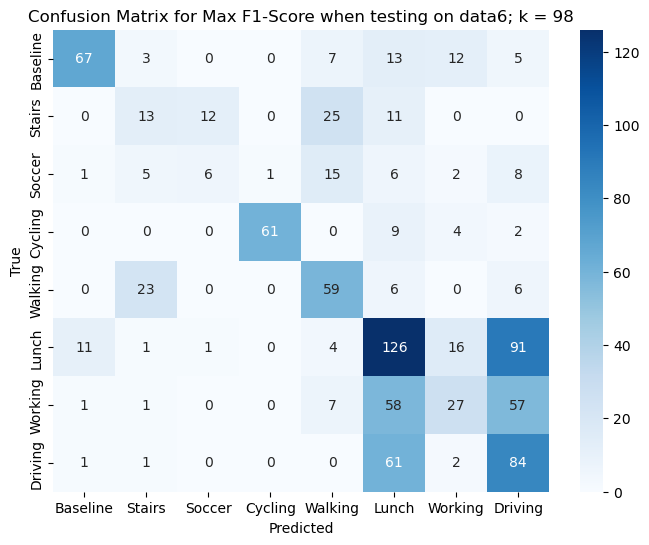

data6 has been tested on everyone


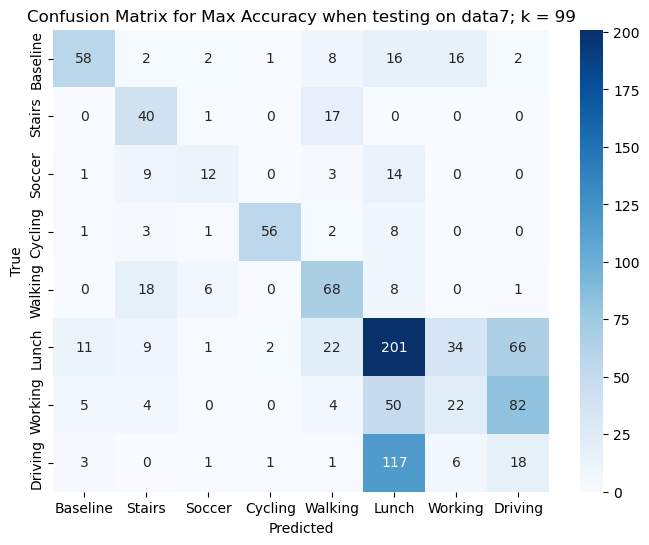

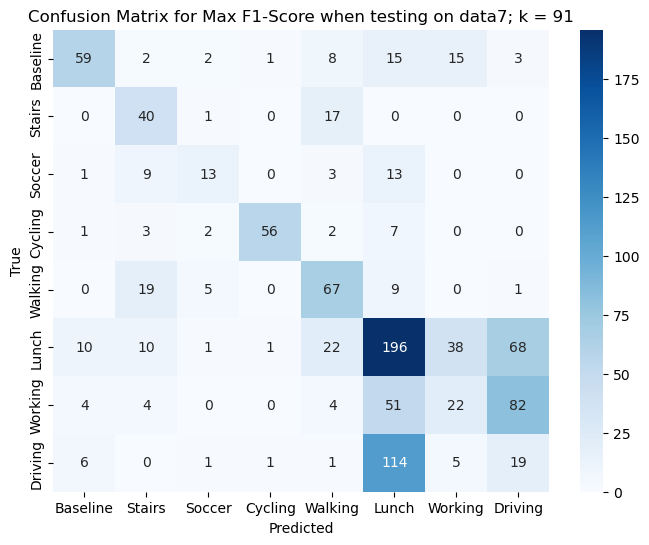

data7 has been tested on everyone


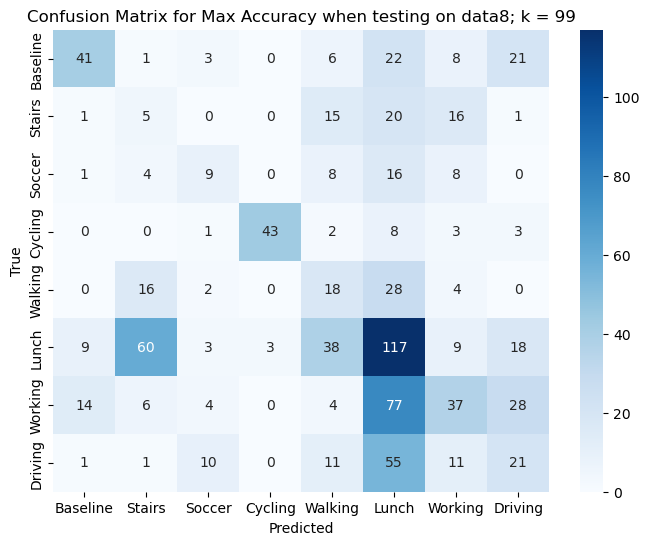

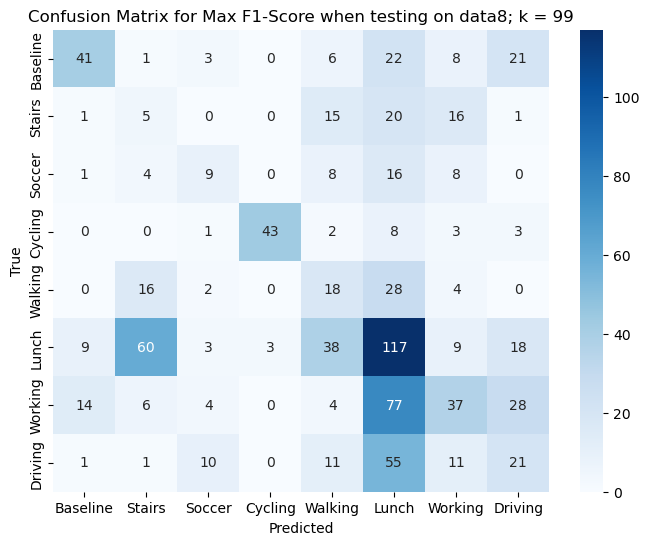

data8 has been tested on everyone


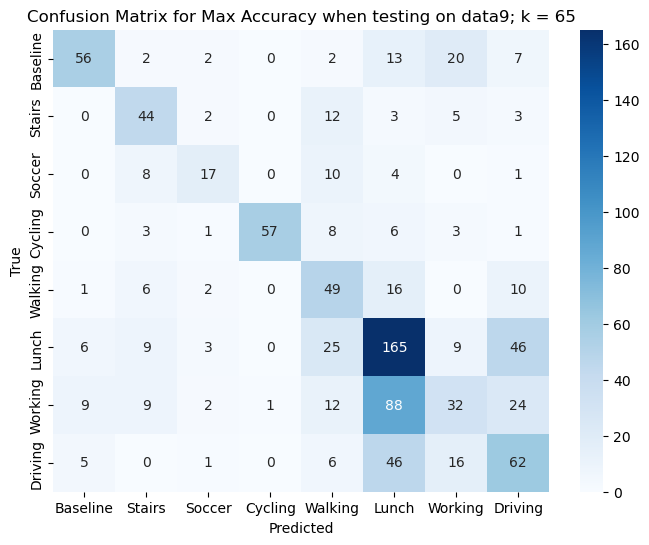

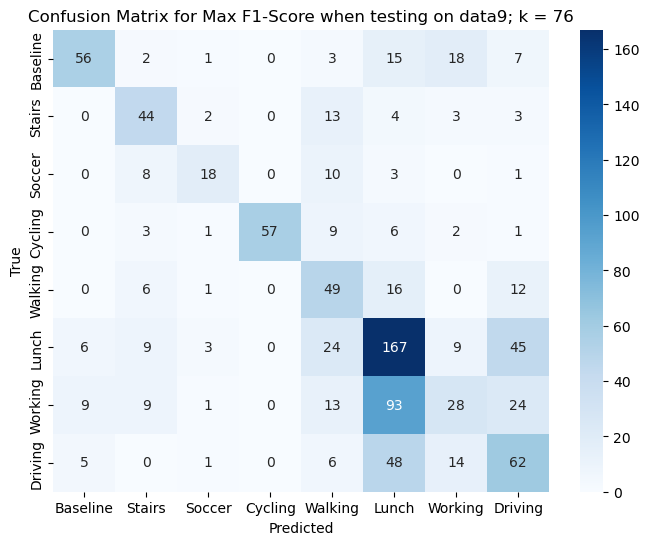

data9 has been tested on everyone


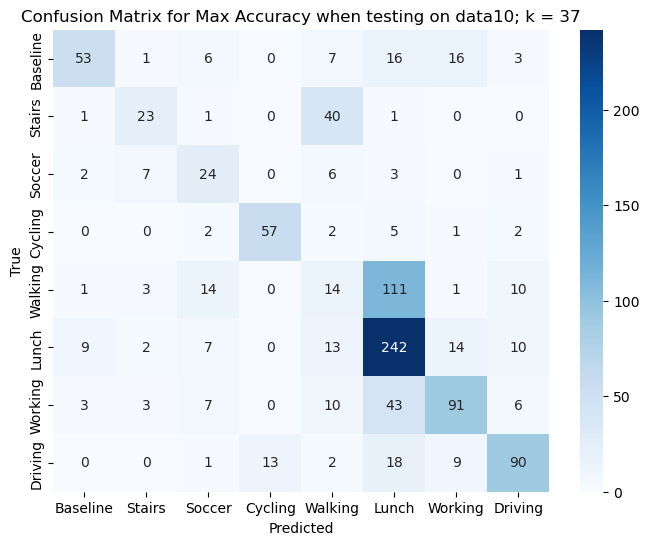

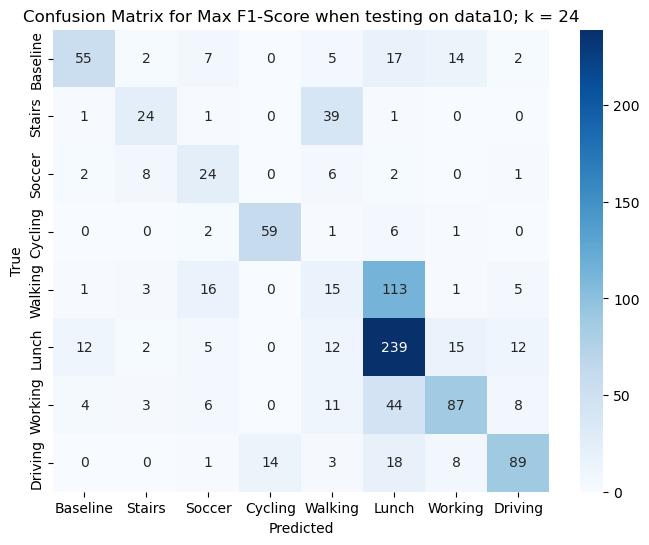

data10 has been tested on everyone


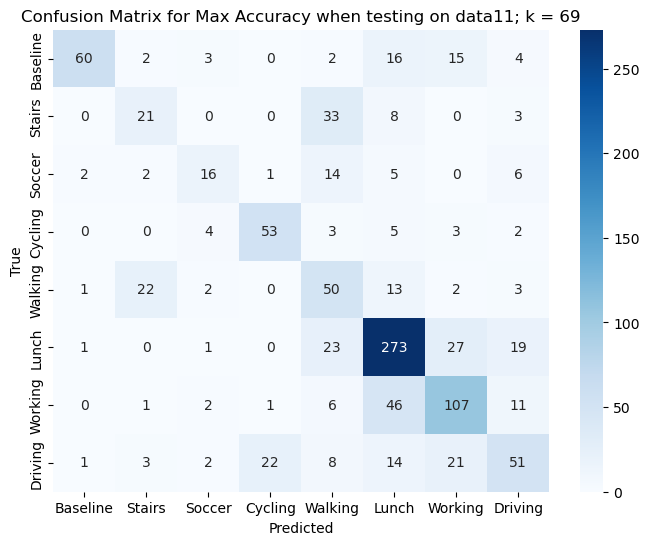

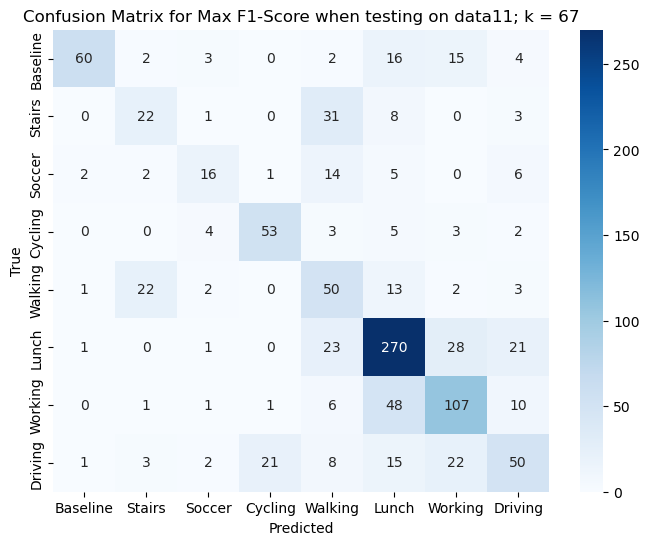

data11 has been tested on everyone


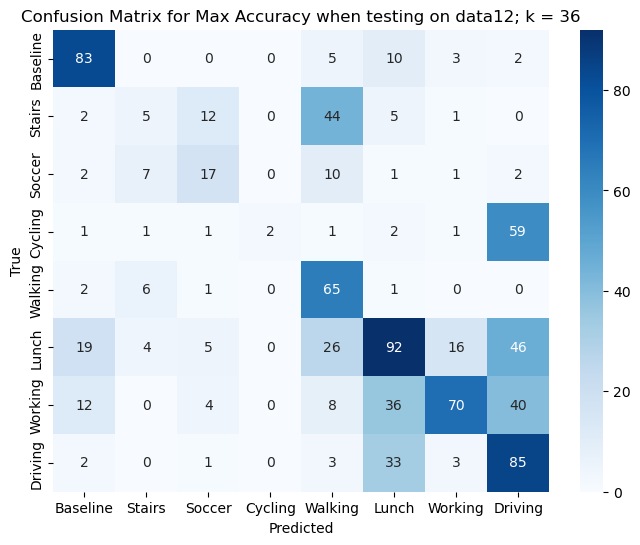

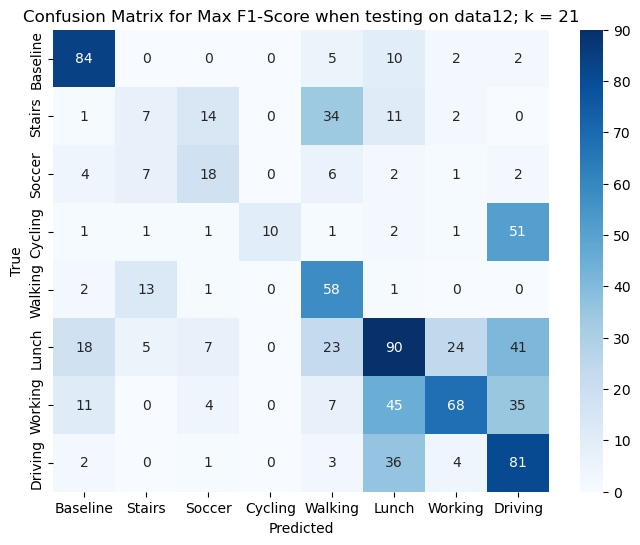

data12 has been tested on everyone


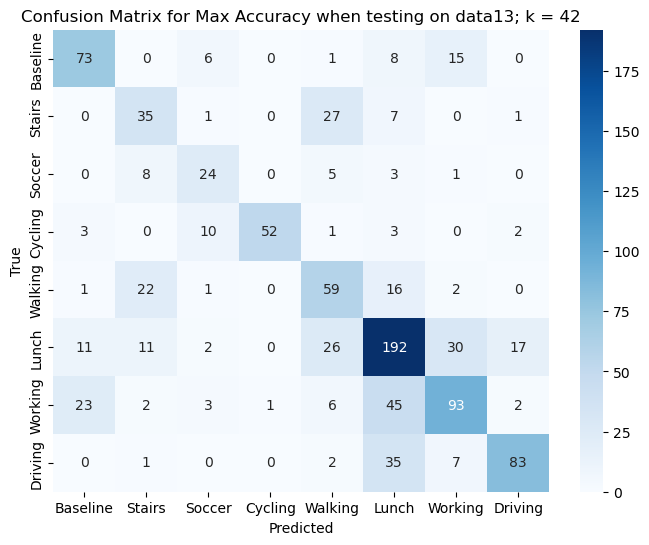

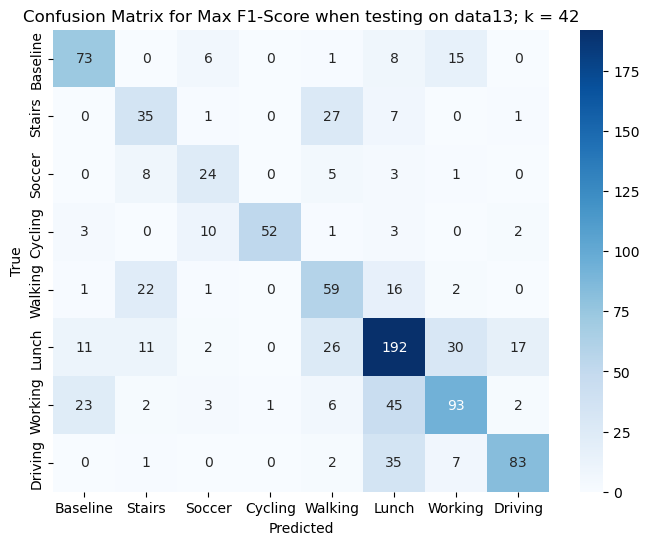

data13 has been tested on everyone


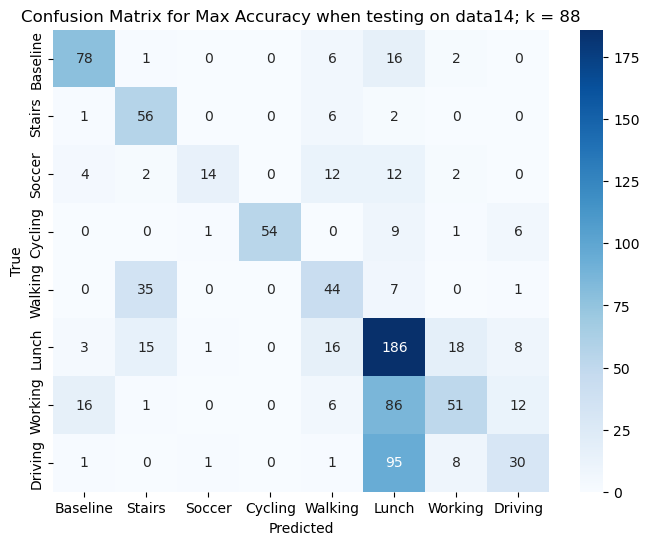

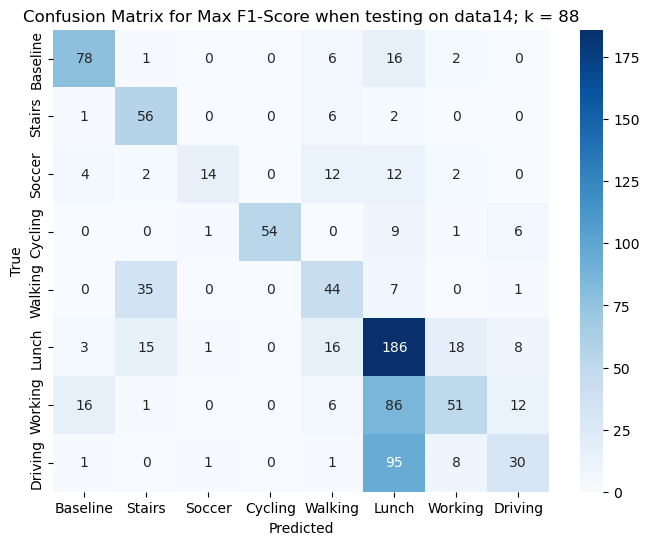

data14 has been tested on everyone


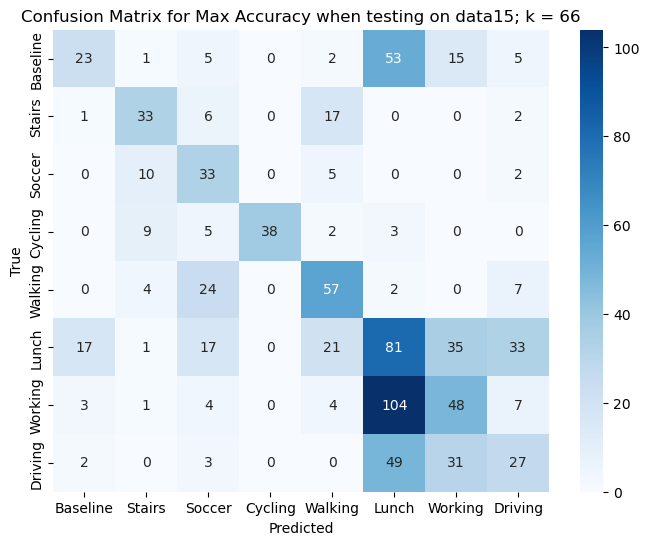

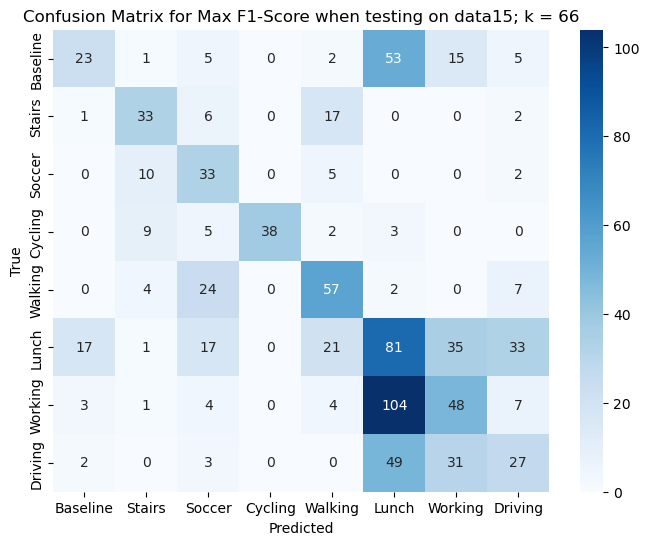

data15 has been tested on everyone


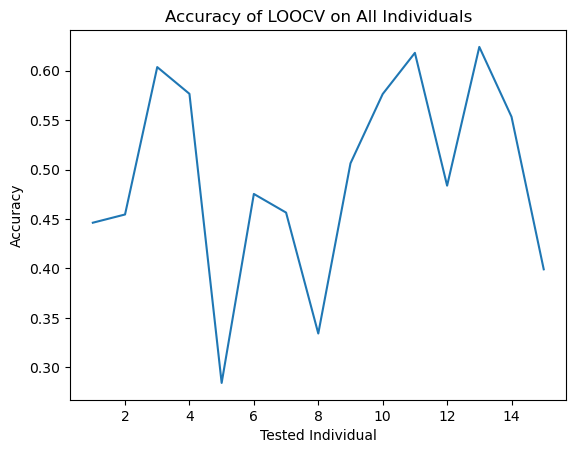

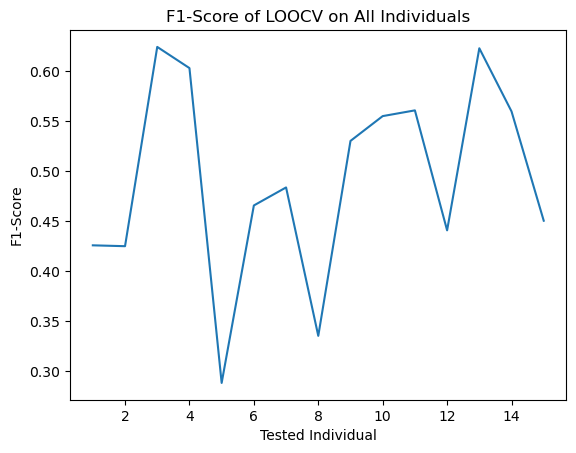

Average Accuracy:  0.4928166938889342
Average F1-Score:  0.4912119194672965


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## tsne
## 0: all seperate classes

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0])]
    data.loc[data['activity'].isin([2]), 'activity'] = 1
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

tsne = TSNE(n_components=3)
X_tsne = tsne.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_tsne, columns=[f'TSNE{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = f1_score(testingActivity, knn.predict(testingFeatures), average='macro')
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Baseline", "Stairs", "Soccer", "Cycling", "Walking", "Lunch", "Working", "Driving"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Baseline", "Stairs", "Soccer", "Cycling", "Walking", "Lunch", "Working", "Driving"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, f1_score(testingActivity, y_pred, average='macro'))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


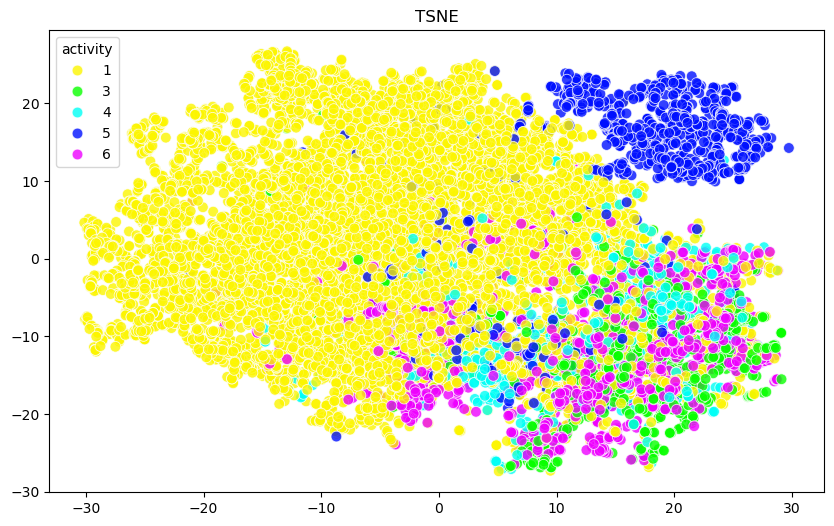

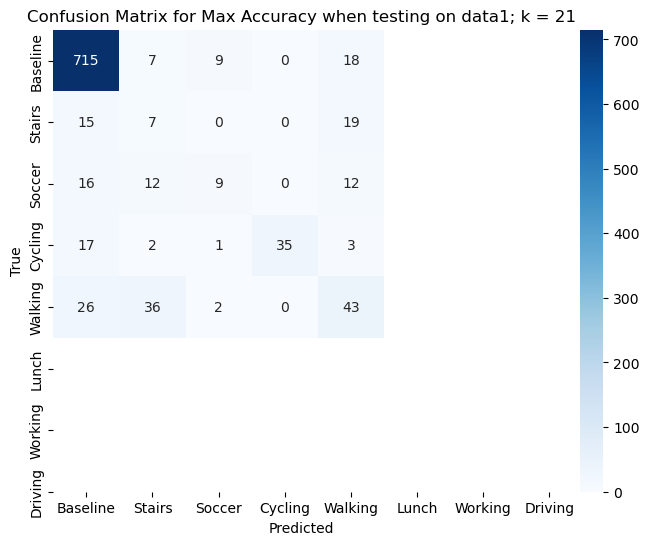

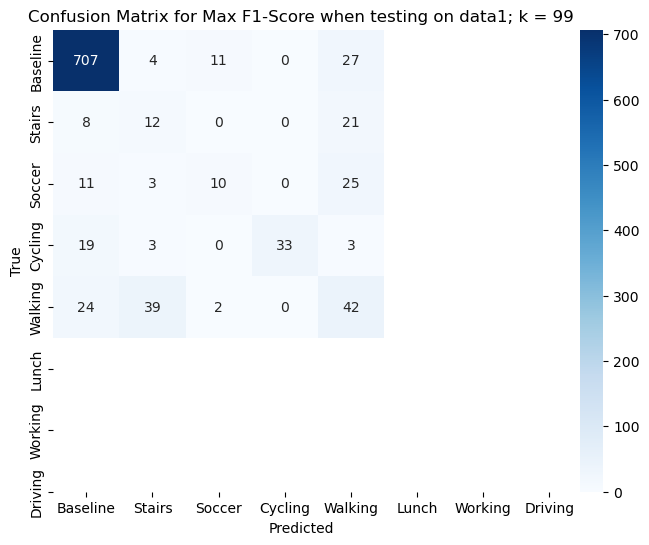

data1 has been tested on everyone


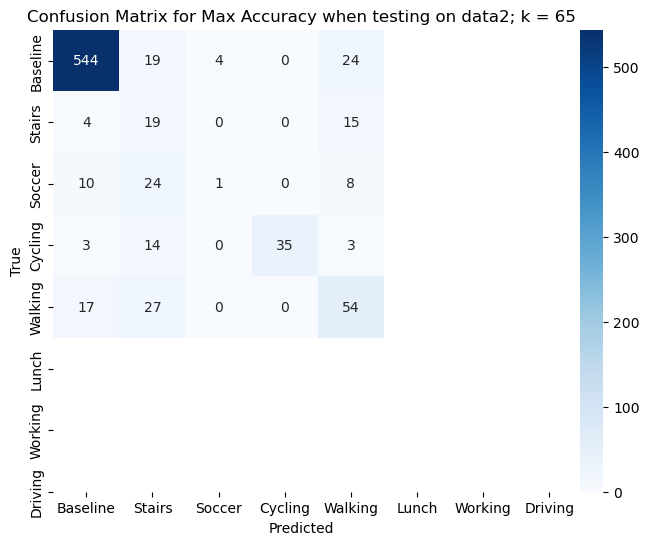

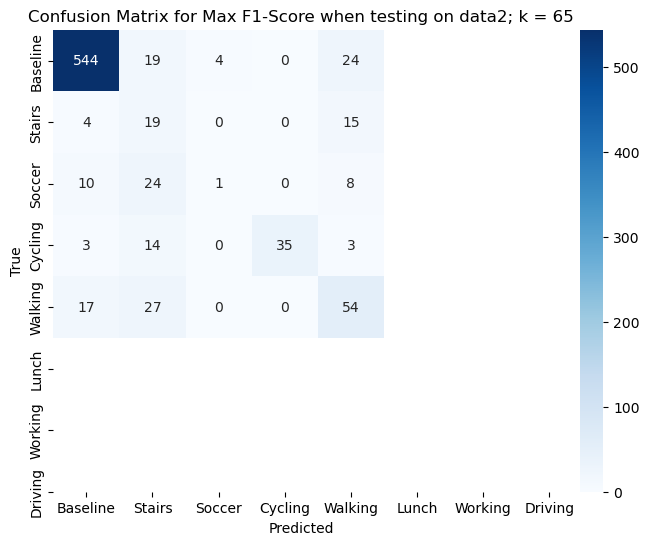

data2 has been tested on everyone


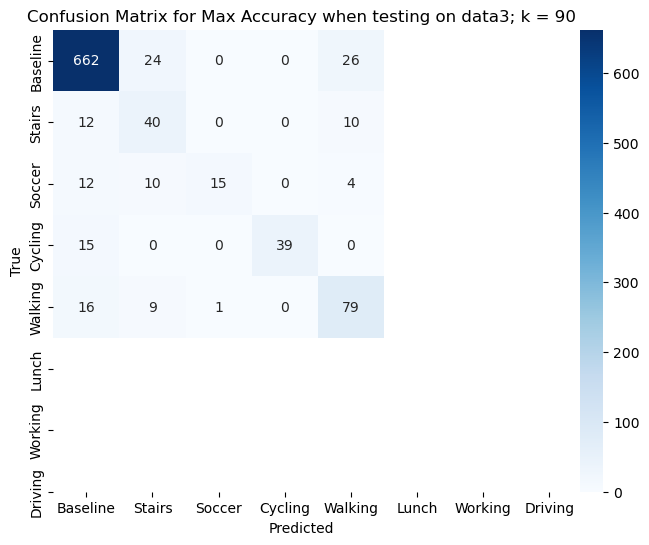

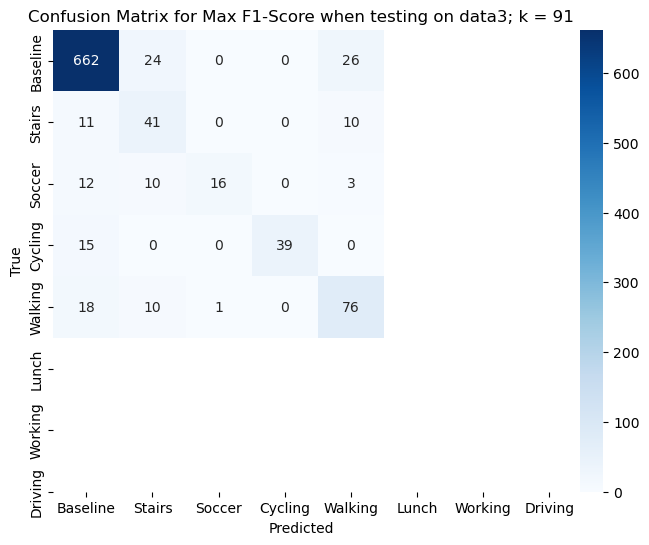

data3 has been tested on everyone


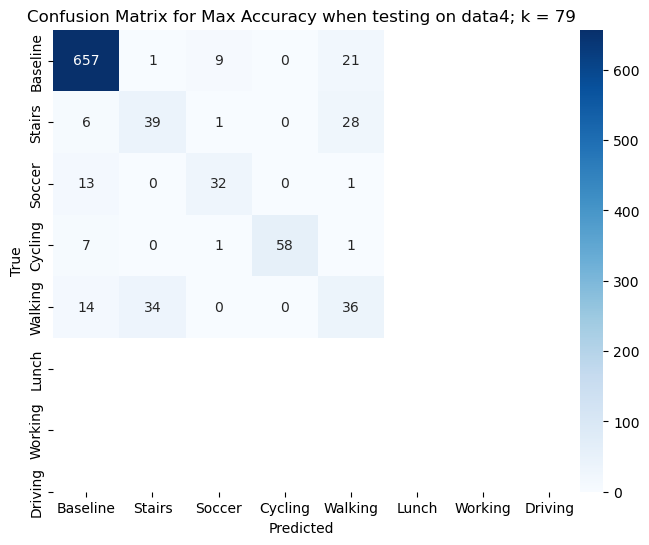

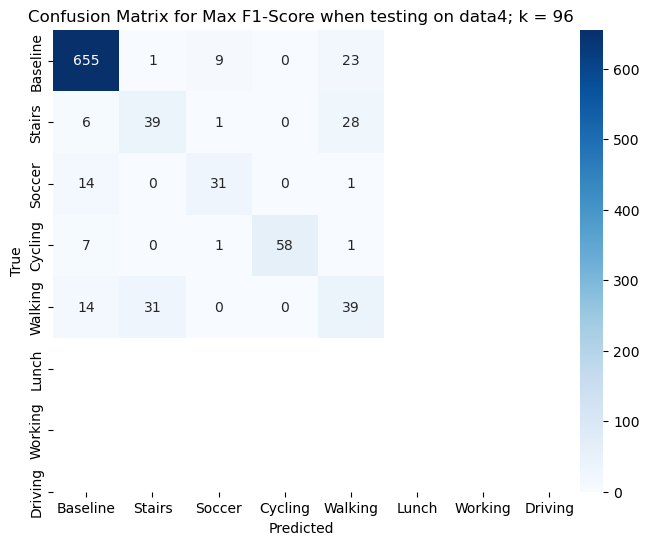

data4 has been tested on everyone


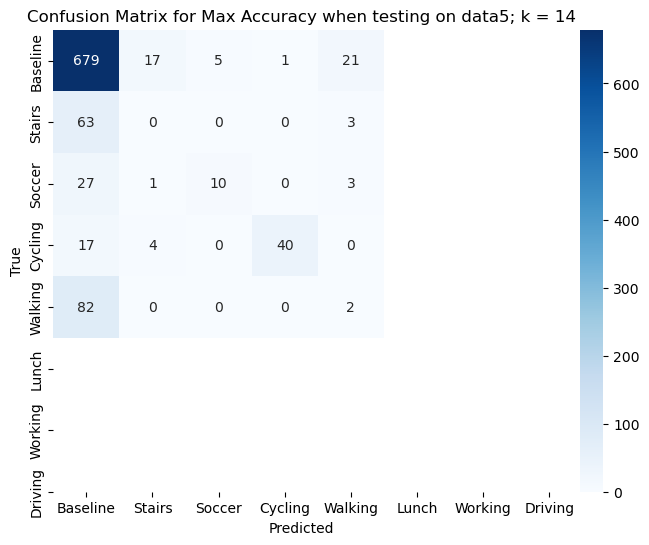

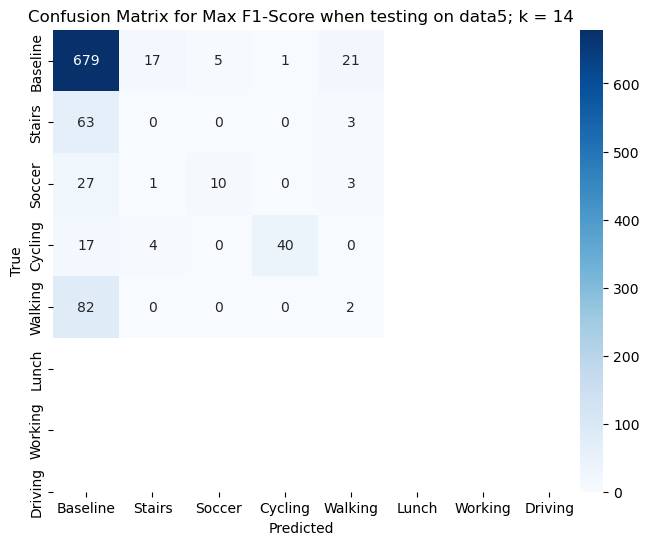

data5 has been tested on everyone


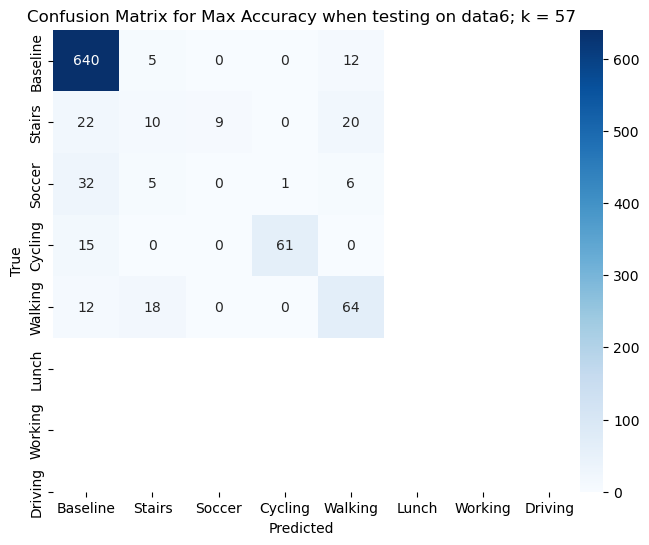

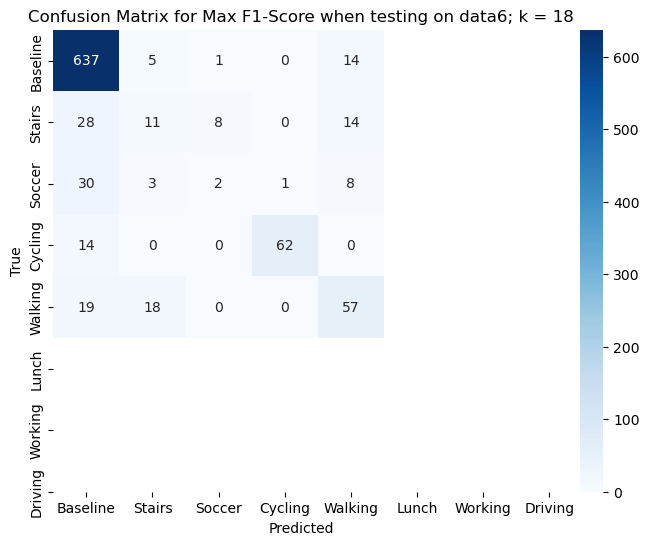

data6 has been tested on everyone


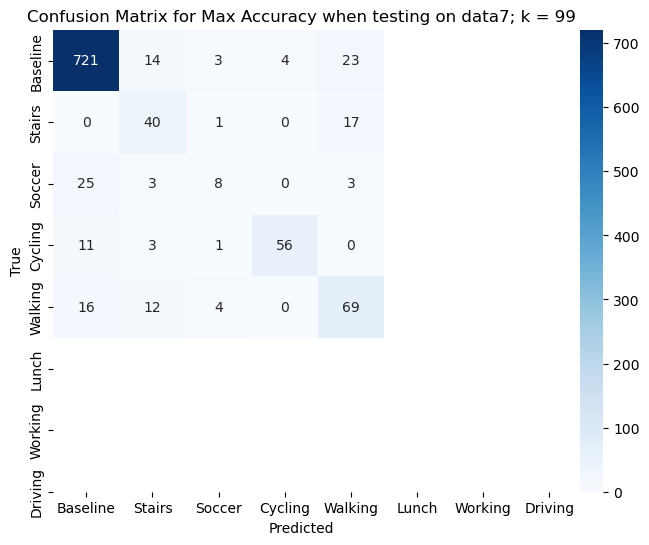

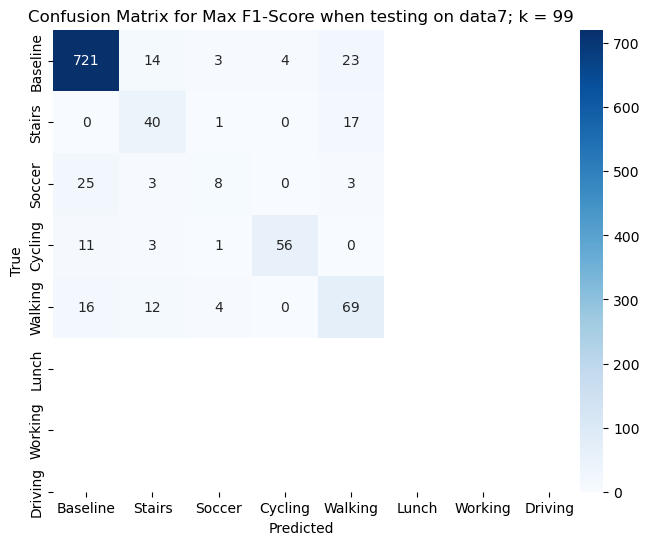

data7 has been tested on everyone


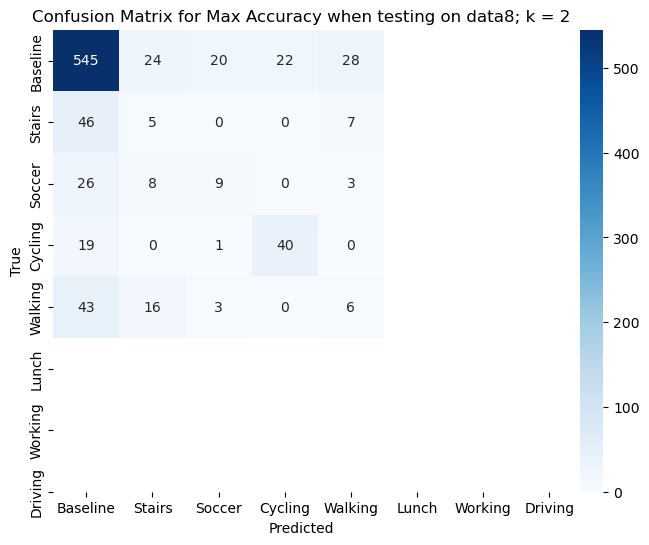

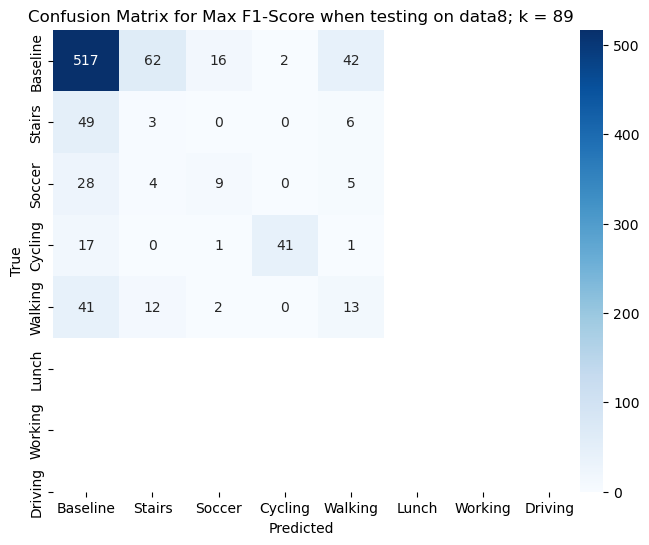

data8 has been tested on everyone


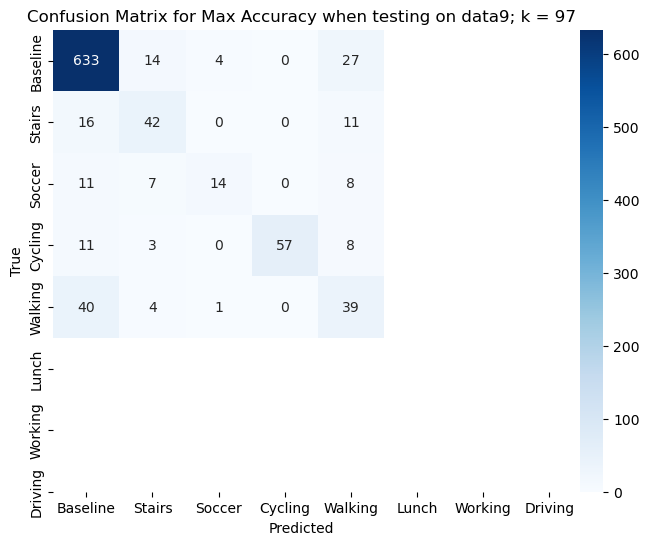

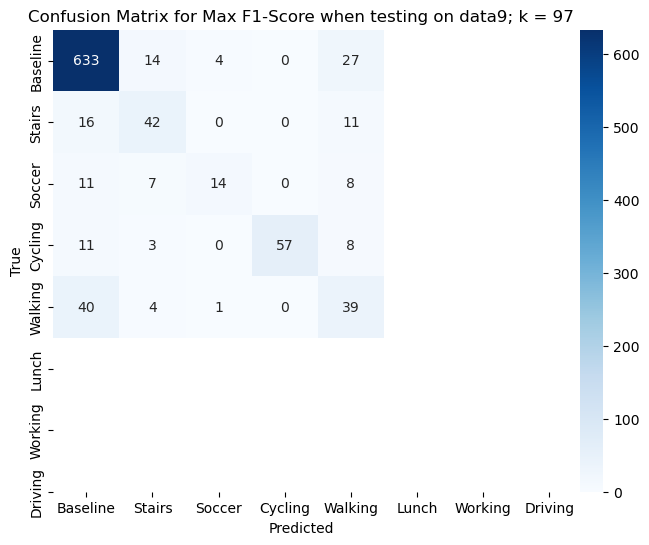

data9 has been tested on everyone


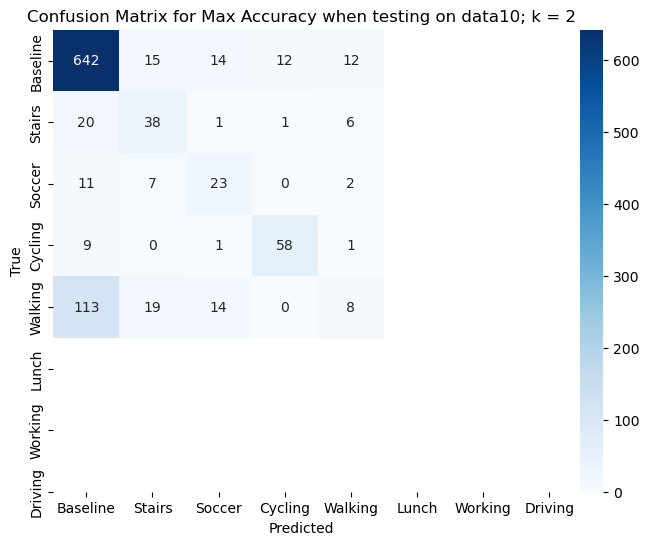

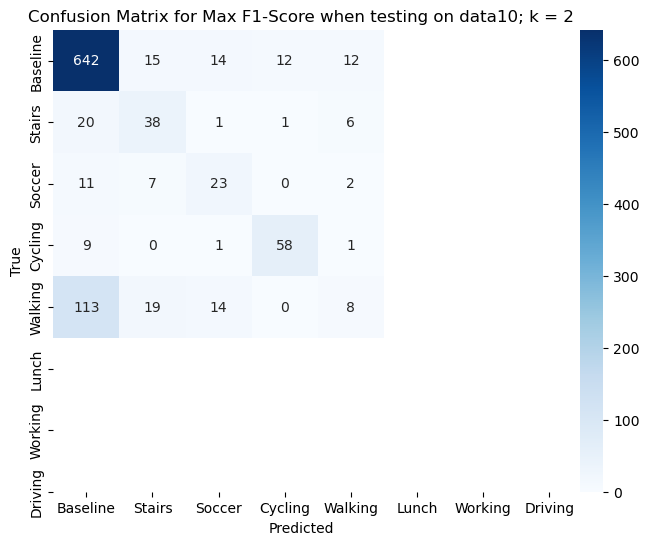

data10 has been tested on everyone


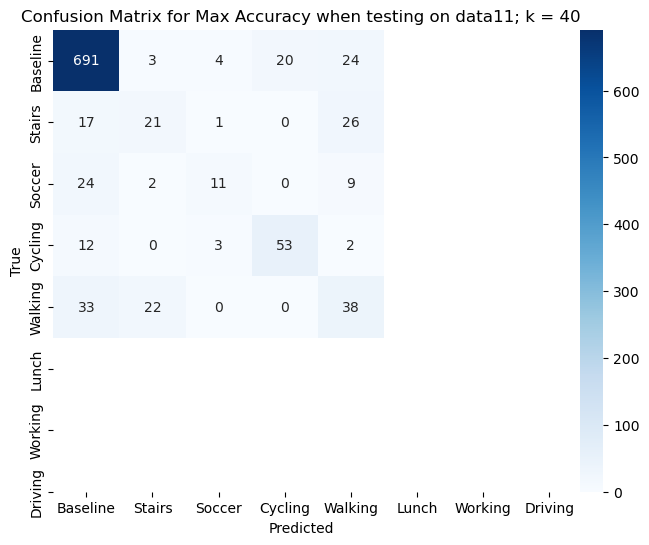

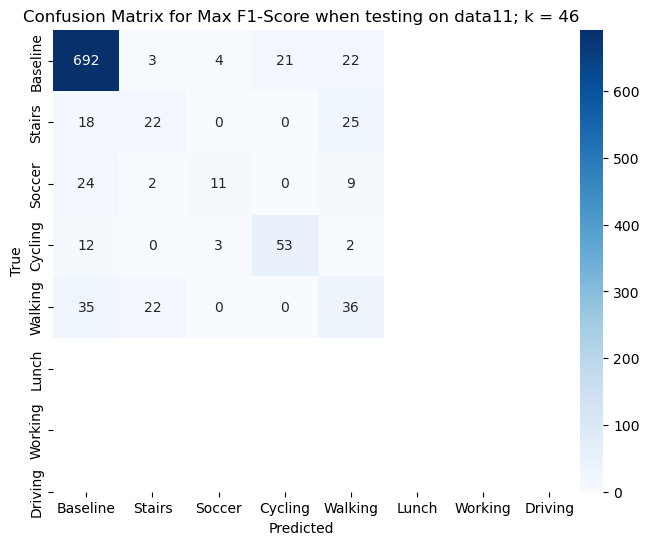

data11 has been tested on everyone


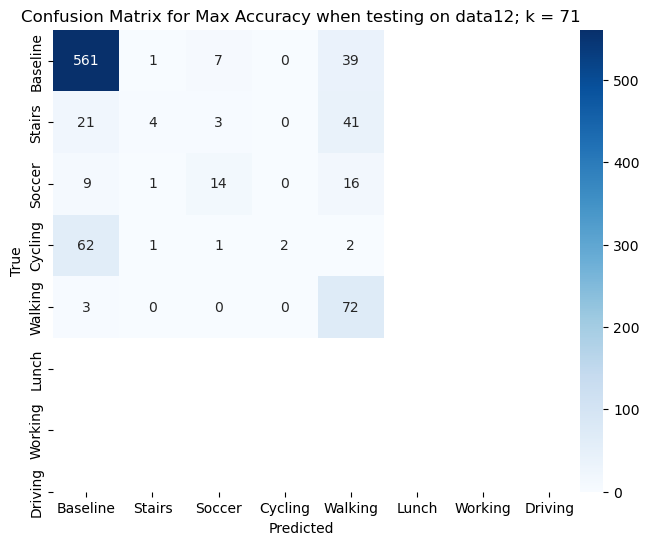

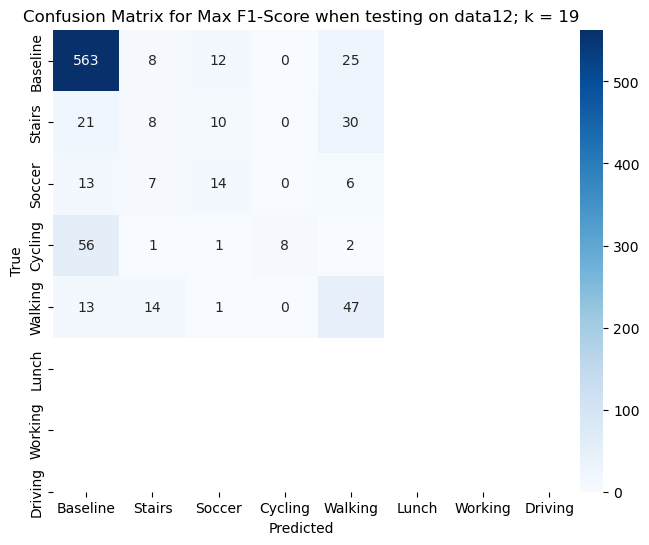

data12 has been tested on everyone


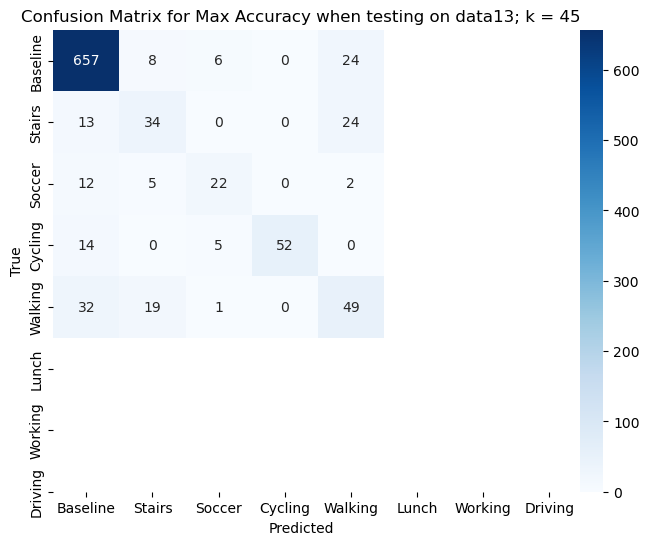

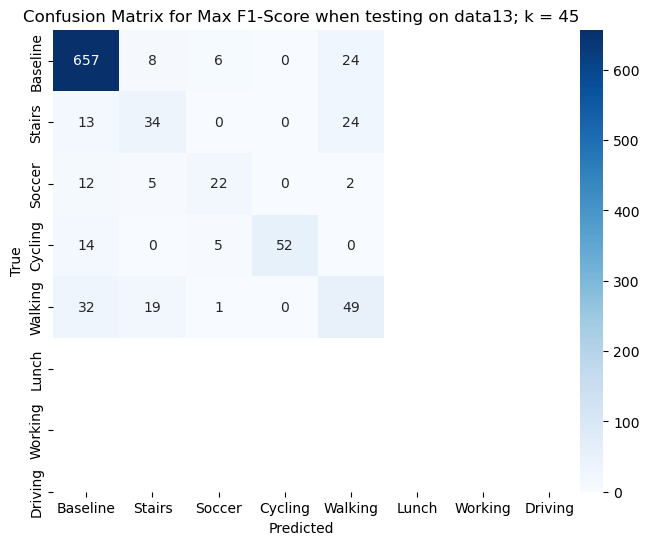

data13 has been tested on everyone


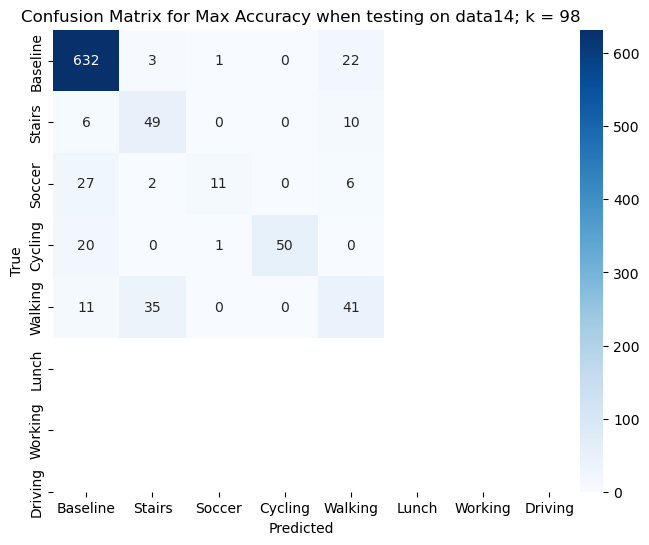

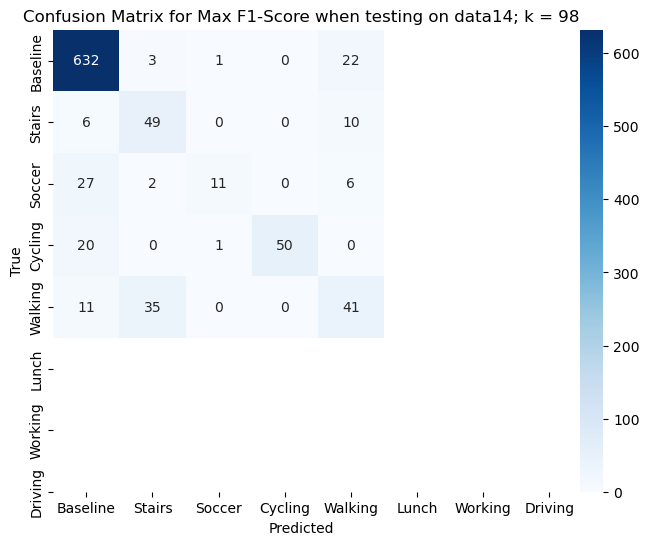

data14 has been tested on everyone


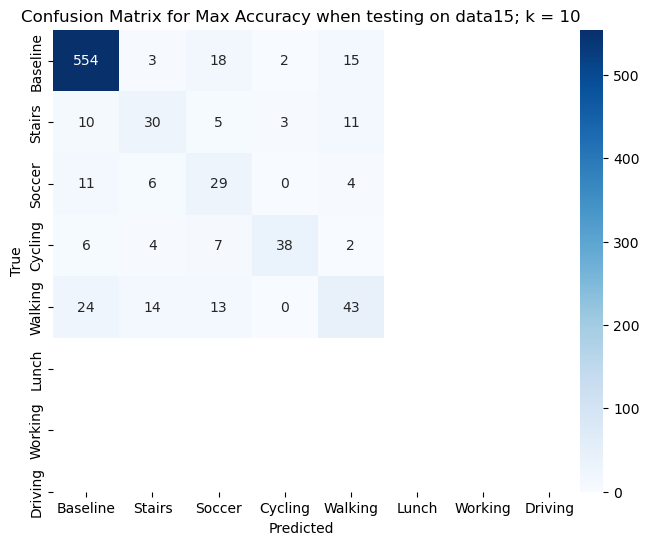

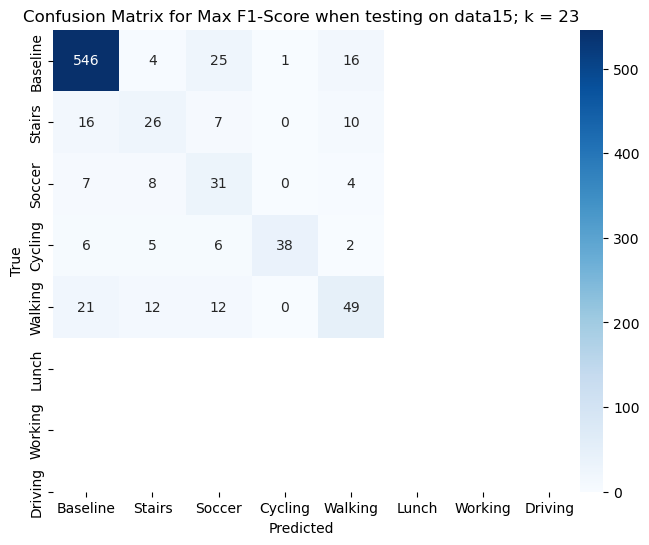

data15 has been tested on everyone


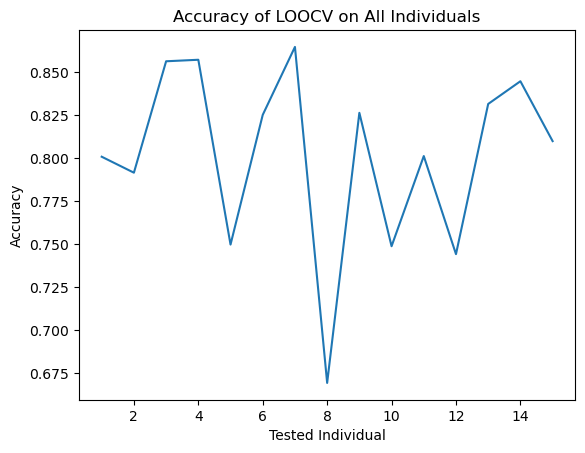

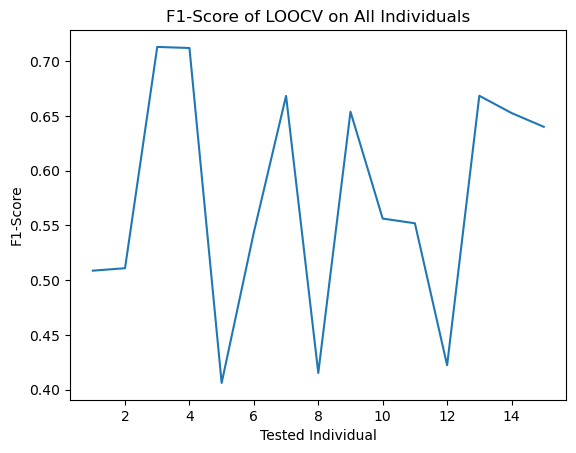

Average Accuracy:  0.801397561779845
Average F1-Score:  0.5748768899459797


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## tsne
## 0: baseline + misc
## 1: seperate ativity classes
def plot_clusters(X, y, title):
    plt.figure(figsize=(10, 6))
    palette = sns.color_palette("hsv", len(np.unique(y)))
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=y, legend='full', palette=palette, s=60, alpha=0.8)
    plt.title(title)
    plt.show()

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0])]
    data.loc[data['activity'].isin([2, 7, 8, 9]), 'activity'] = 1
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

tsne = TSNE(n_components=3)
X_tsne = tsne.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_tsne, columns=[f'TSNE{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

plot_clusters(X_tsne, tsne_df['activity'], "TSNE")

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = f1_score(testingActivity, knn.predict(testingFeatures), average='macro')
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Stairs", "Soccer", "Cycling", "Walking"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Stairs", "Soccer", "Cycling", "Walking"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, f1_score(testingActivity, y_pred, average='macro'))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


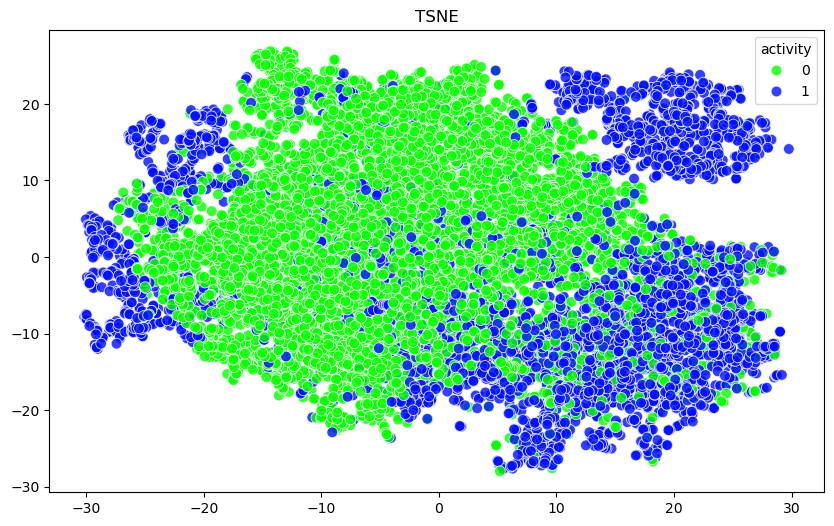

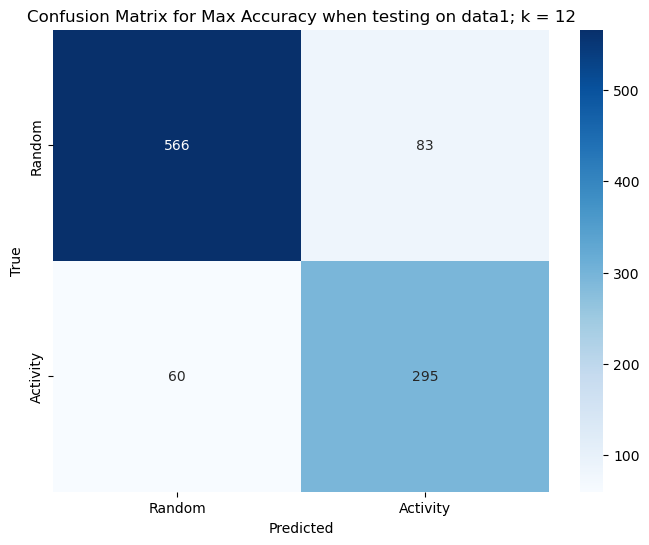

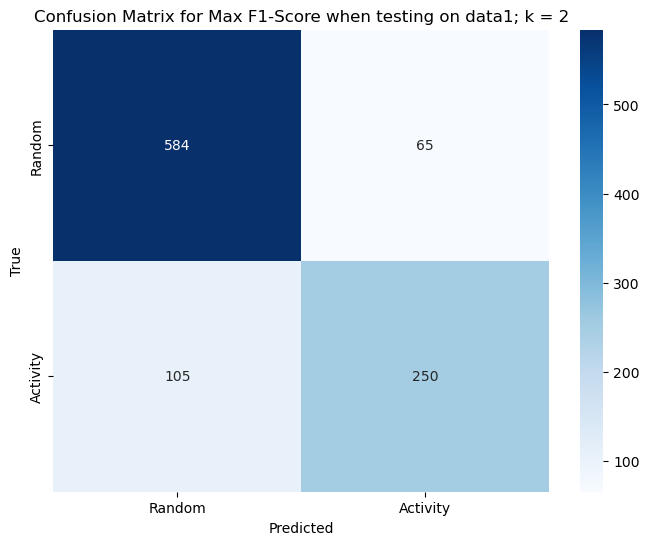

data1 has been tested on everyone


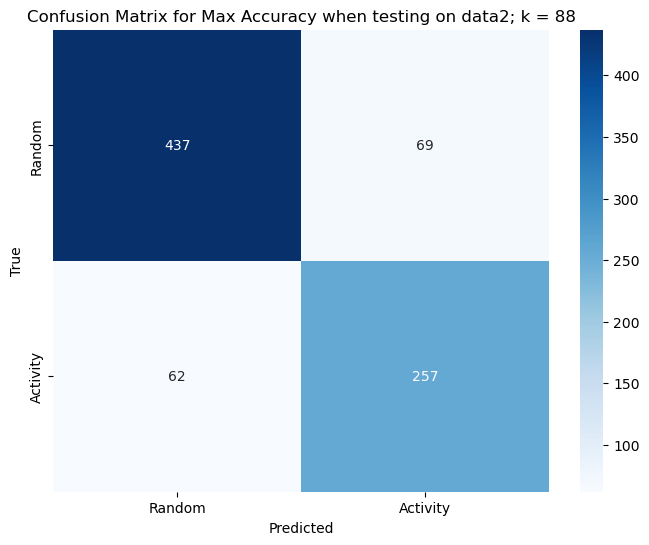

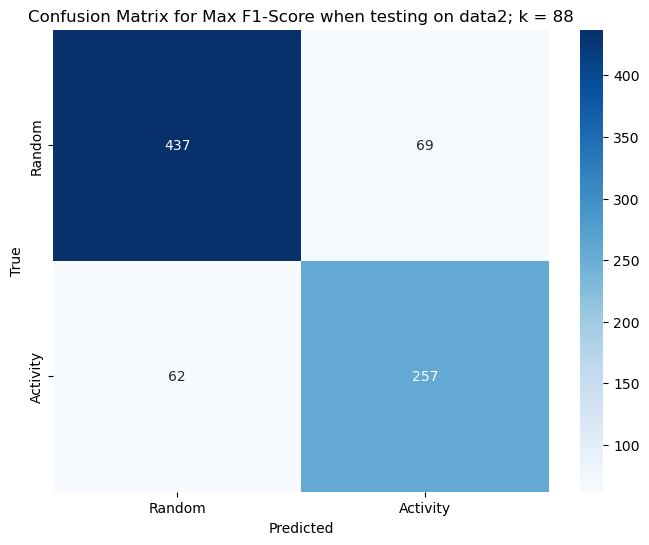

data2 has been tested on everyone


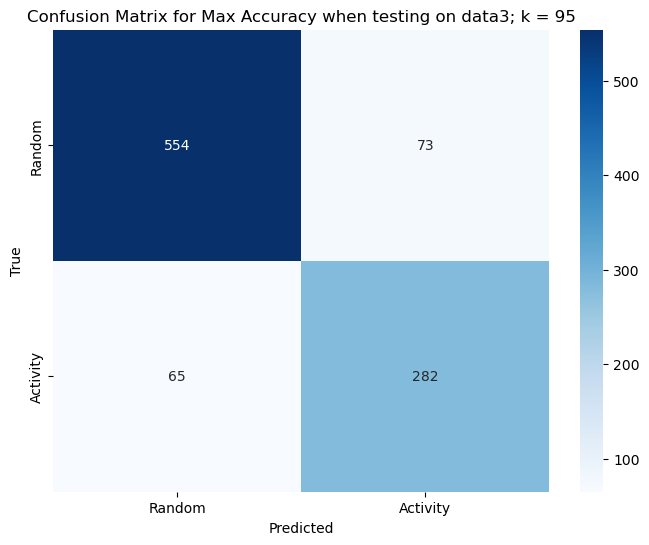

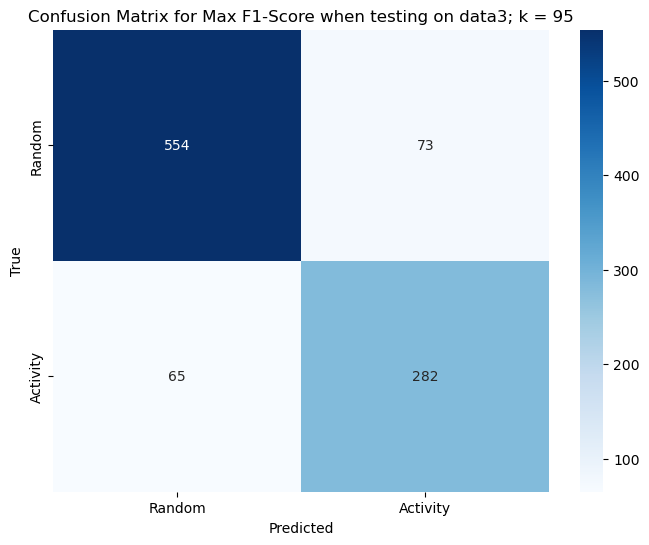

data3 has been tested on everyone


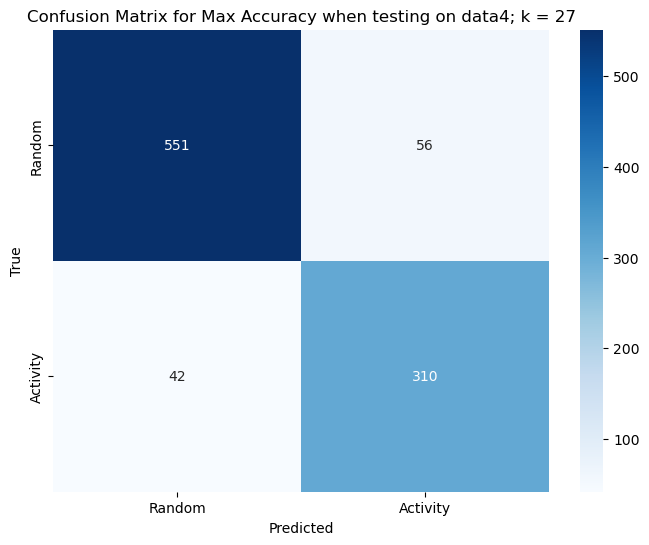

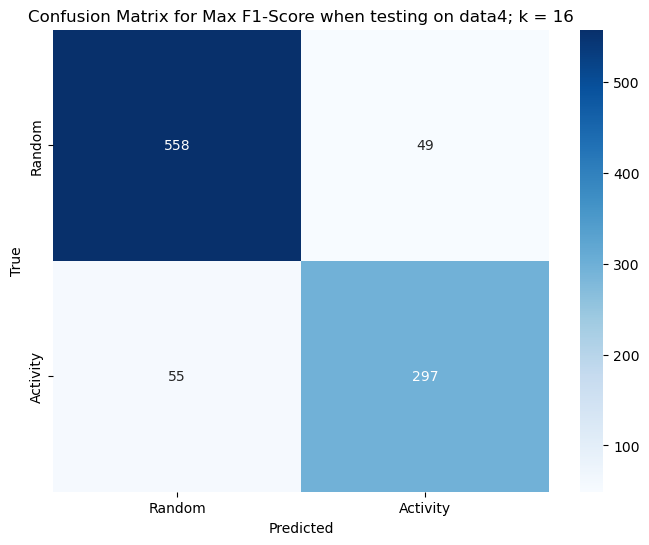

data4 has been tested on everyone


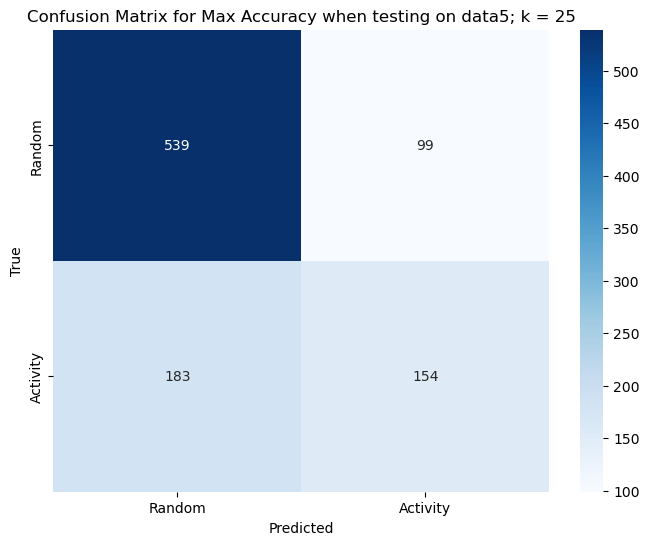

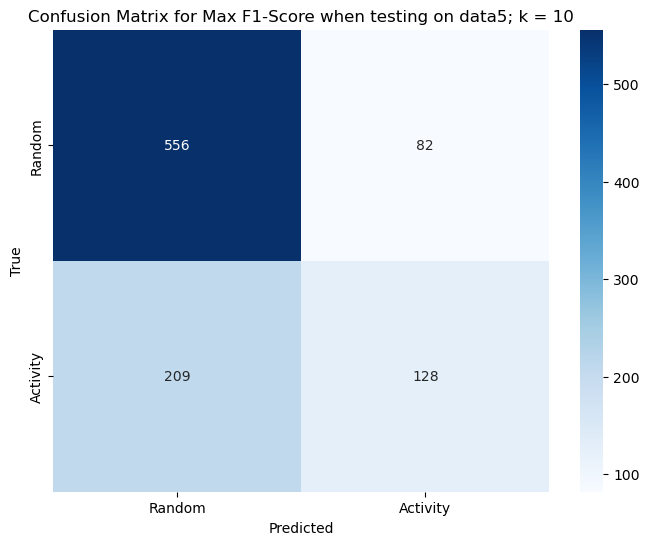

data5 has been tested on everyone


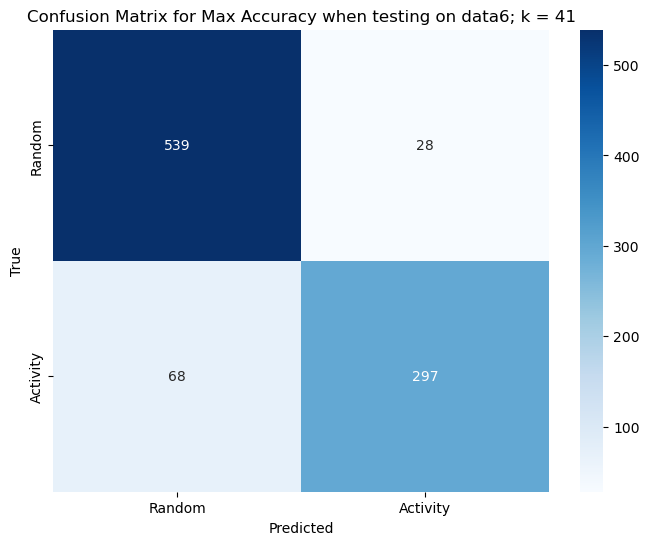

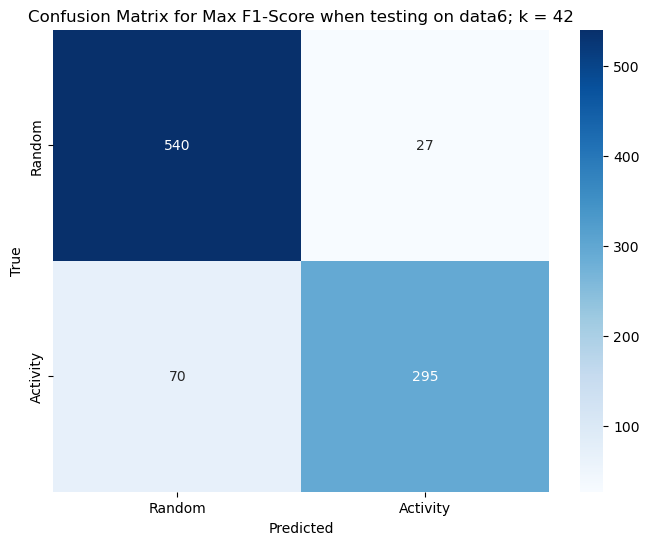

data6 has been tested on everyone


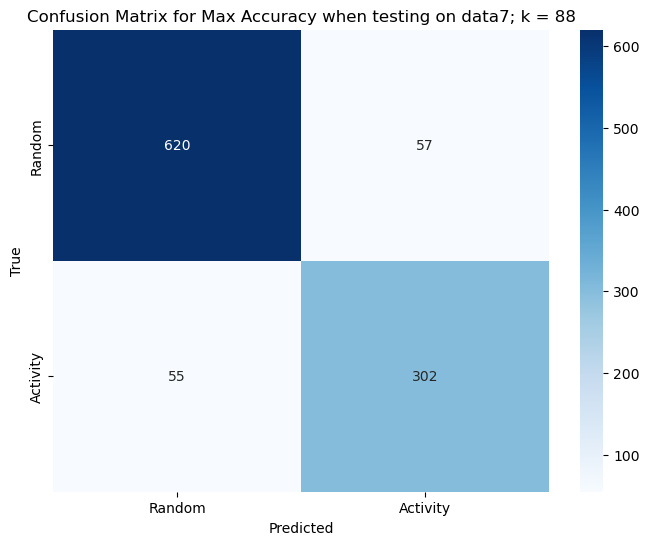

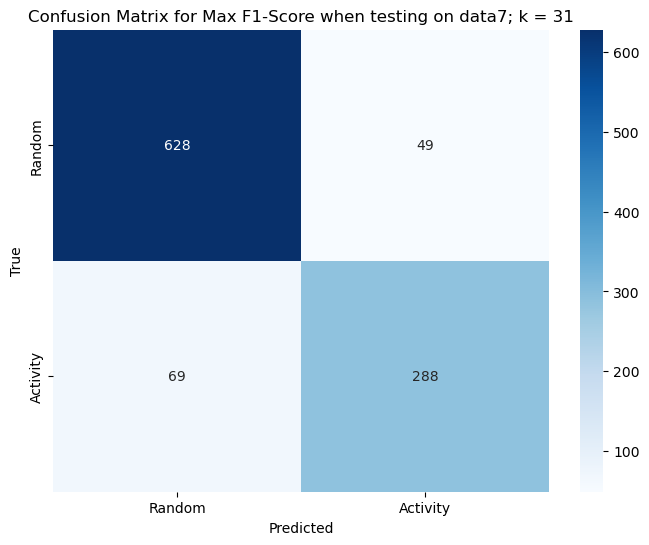

data7 has been tested on everyone


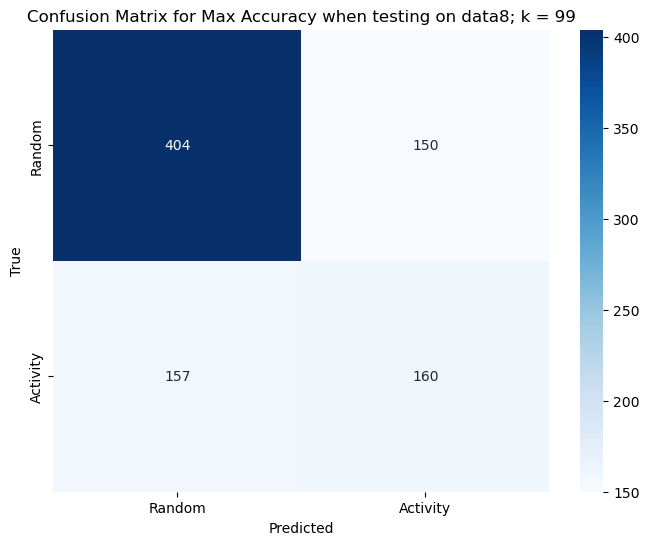

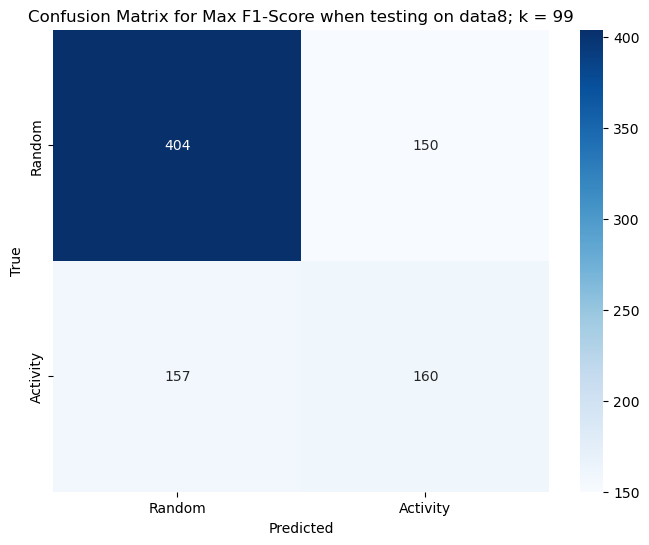

data8 has been tested on everyone


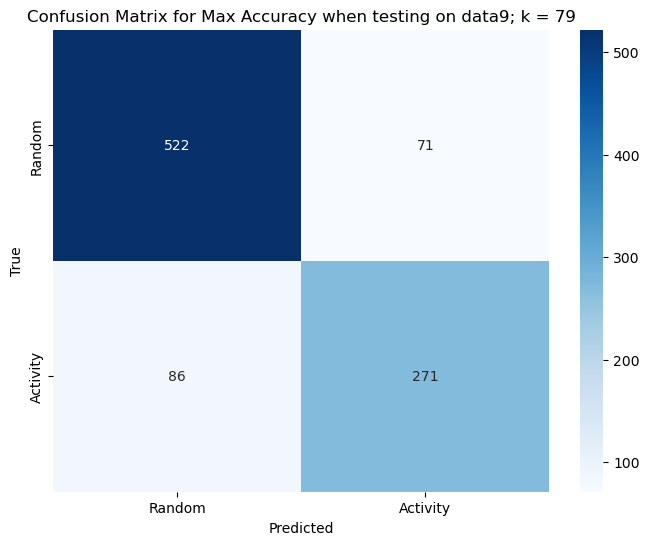

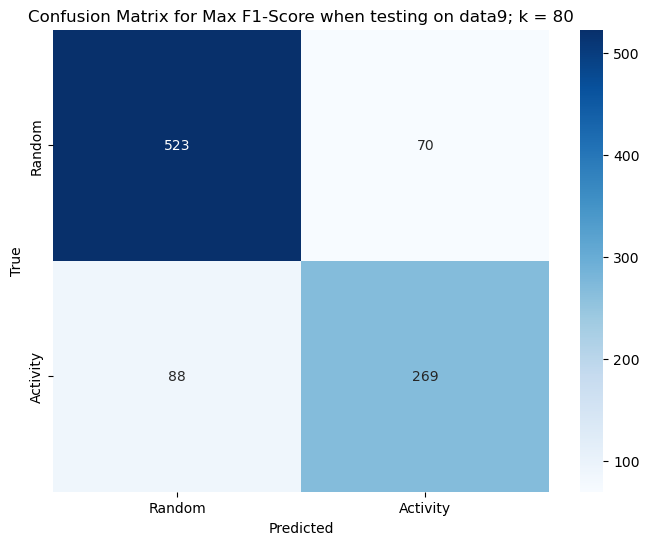

data9 has been tested on everyone


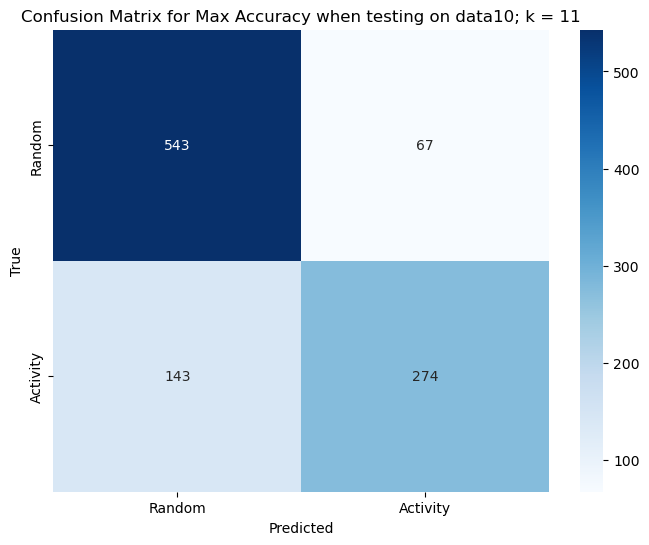

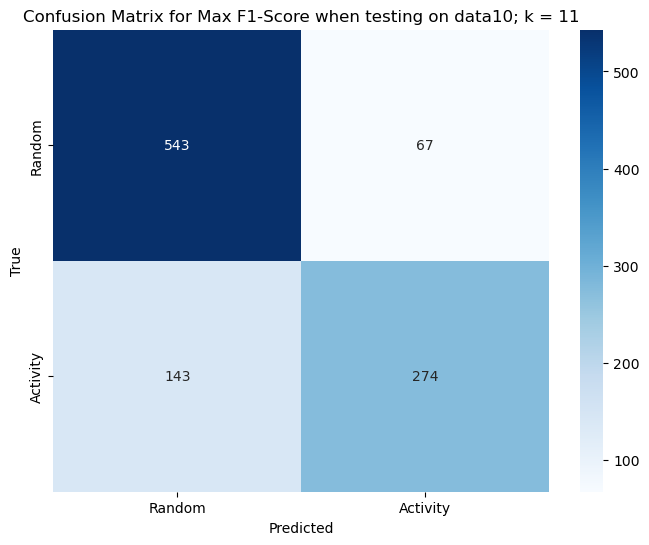

data10 has been tested on everyone


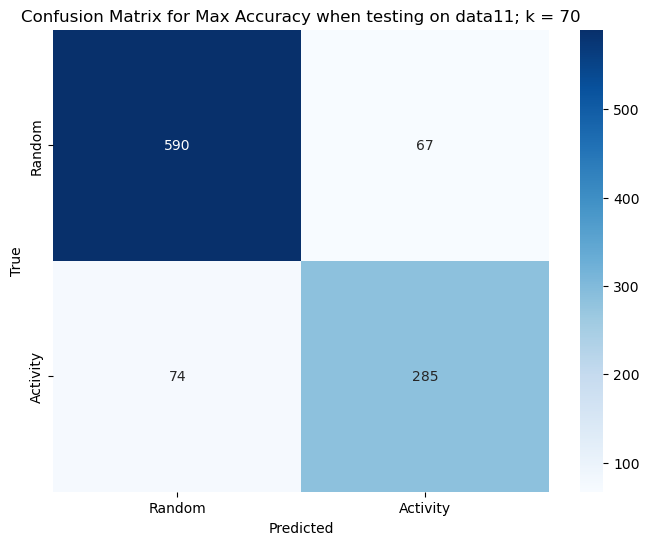

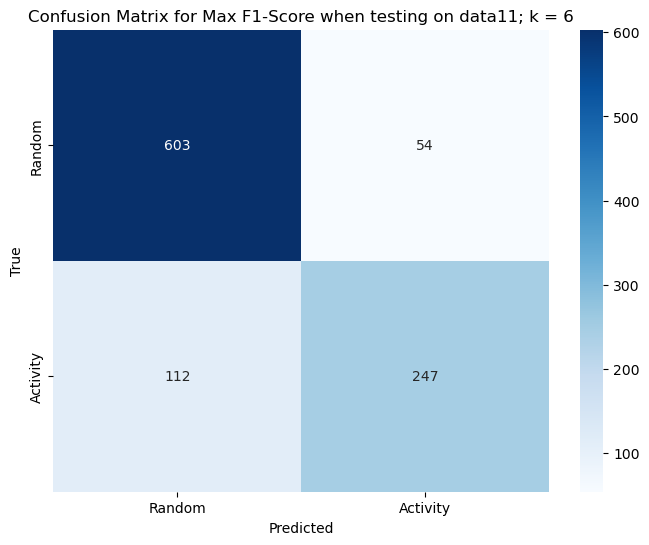

data11 has been tested on everyone


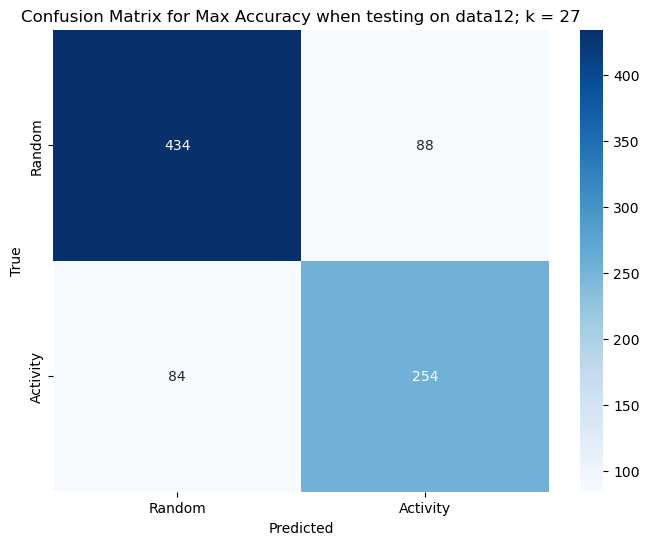

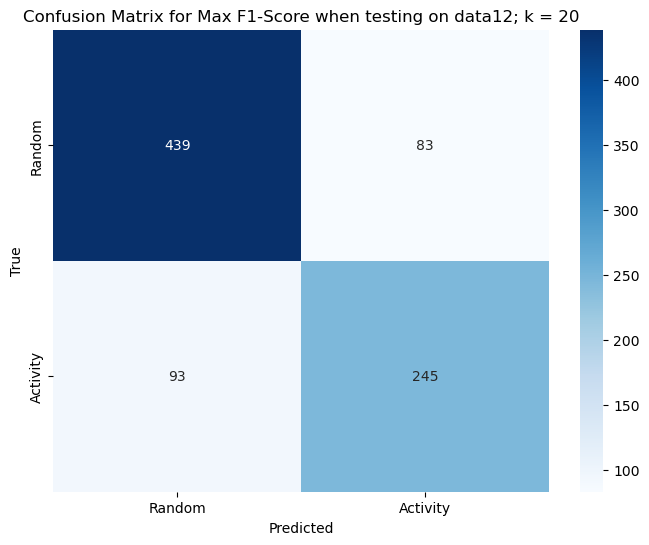

data12 has been tested on everyone


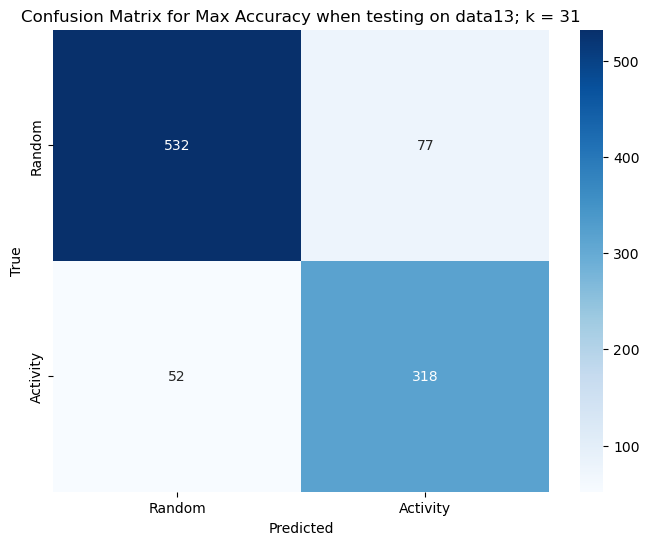

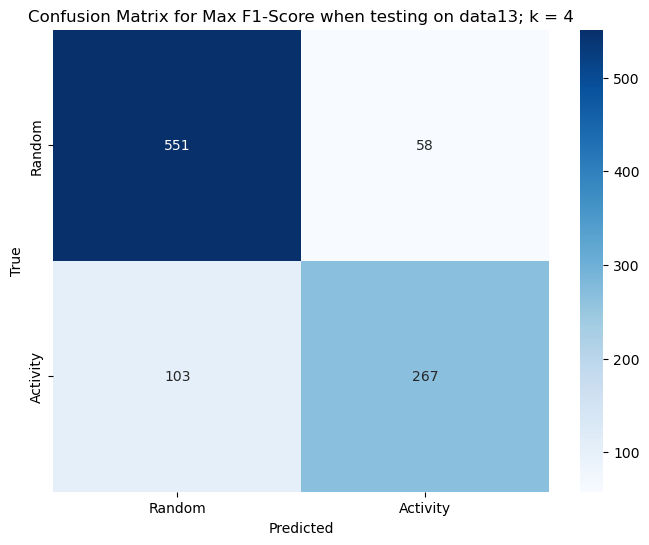

data13 has been tested on everyone


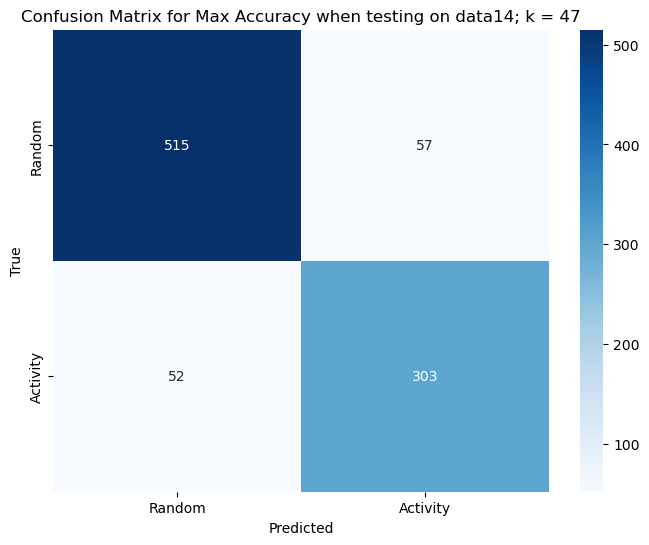

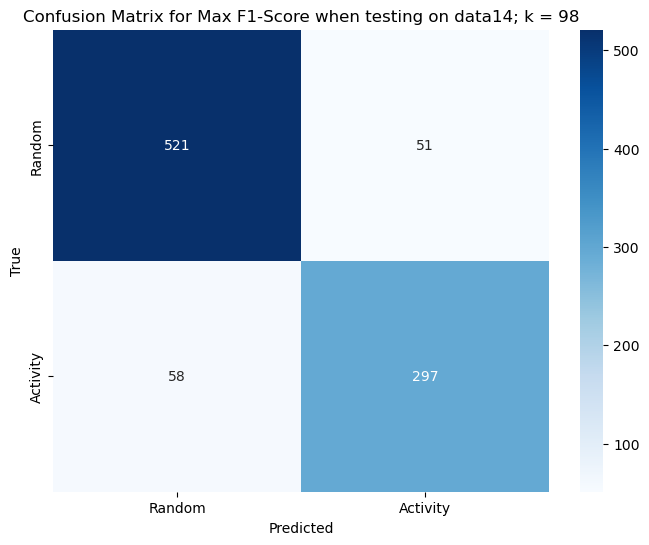

data14 has been tested on everyone


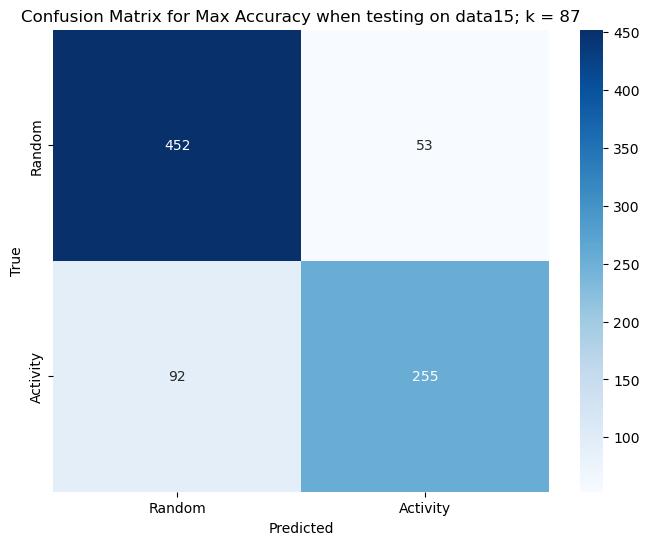

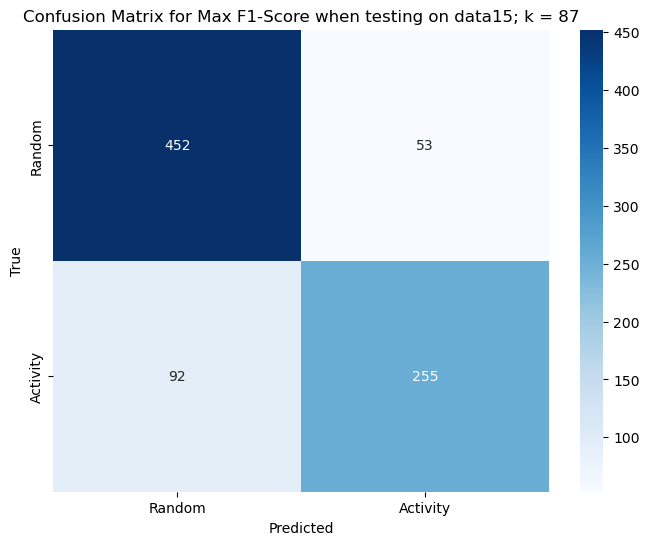

data15 has been tested on everyone


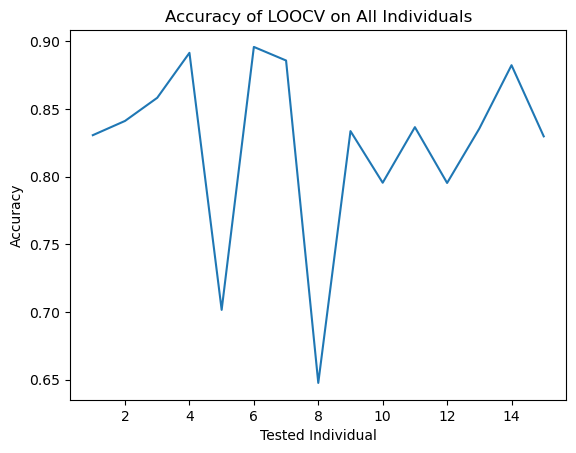

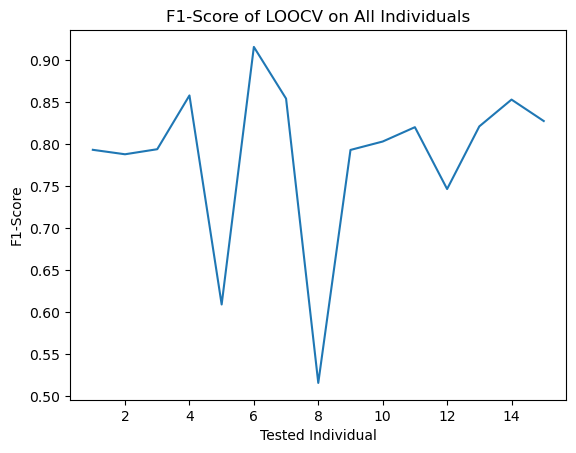

Average Accuracy:  0.8241050286303123
Average F1-Score:  0.7865753864123998


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## tsne
## 0: baseline + misc
## 1: activity
def plot_clusters(X, y, title):
    plt.figure(figsize=(10, 6))
    palette = sns.color_palette("hsv", len(np.unique(y)))
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=y, legend='full', palette=palette, s=60, alpha=0.8)
    plt.title(title)
    plt.show()

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0])]
    data.loc[data['activity'].isin([2, 7, 8, 9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 4, 5, 6]), 'activity'] = 1
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

tsne = TSNE(n_components=3)
X_tsne = tsne.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_tsne, columns=[f'TSNE{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

plot_clusters(X_tsne, tsne_df['activity'], "TSNE")

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = precision_score(testingActivity, knn.predict(testingFeatures))
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, precision_score(testingActivity, y_pred))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


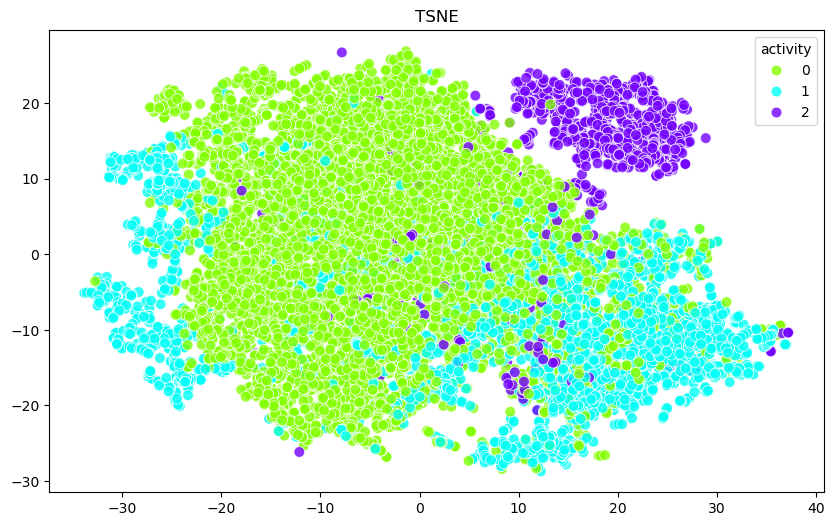

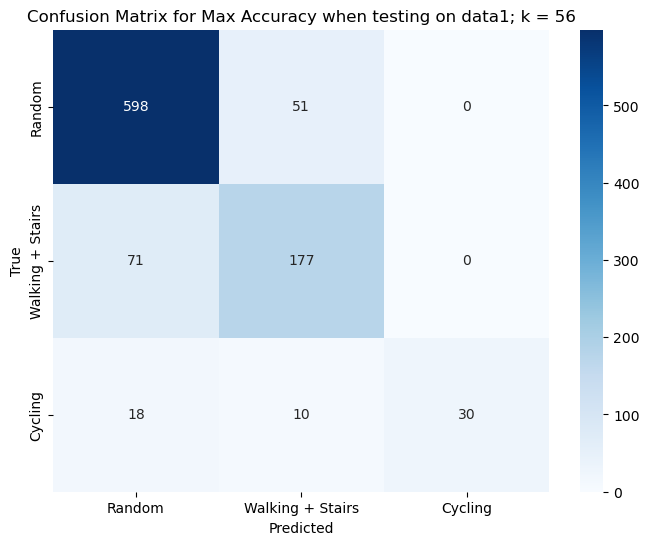

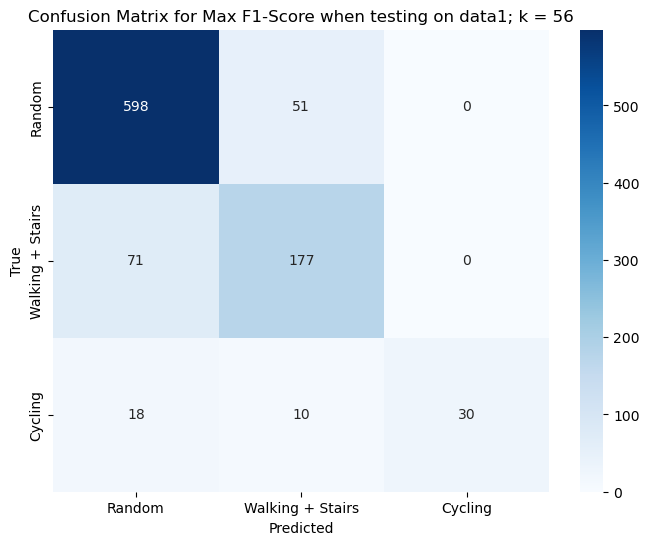

data1 has been tested on everyone


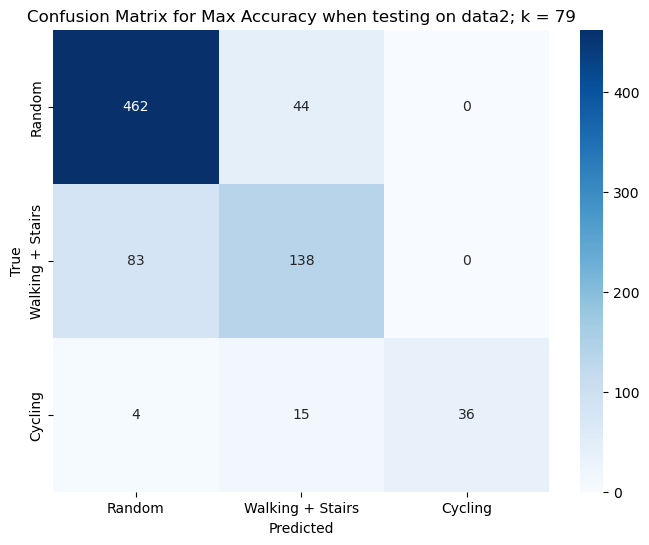

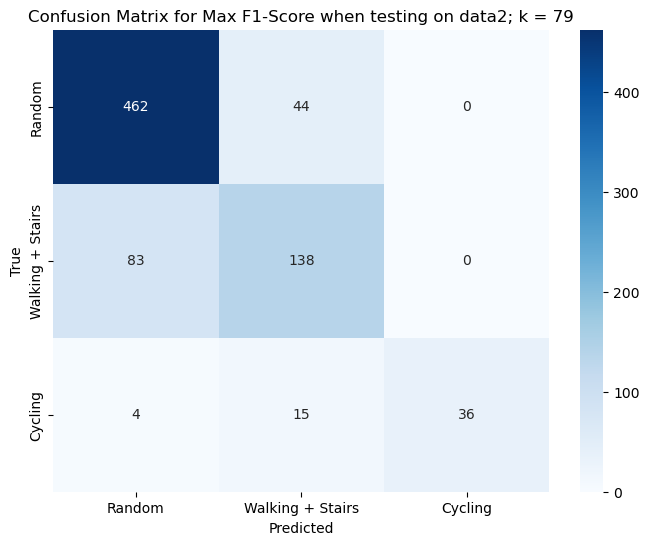

data2 has been tested on everyone


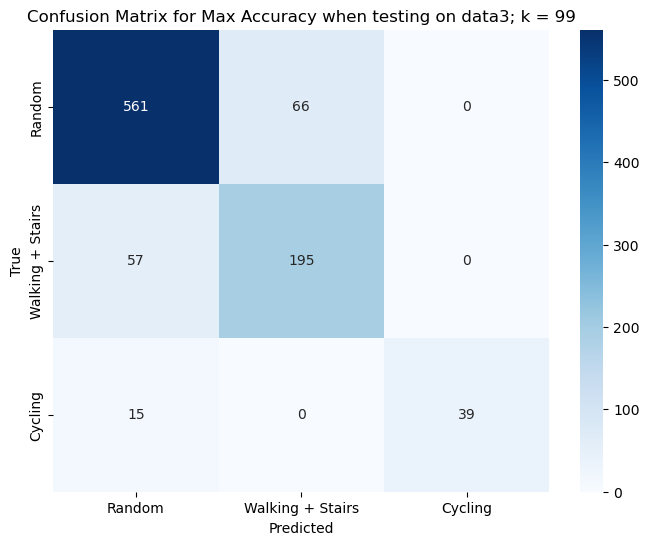

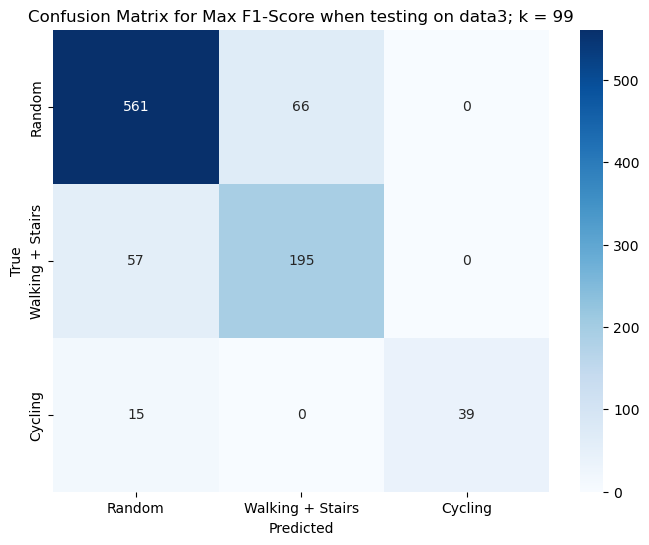

data3 has been tested on everyone


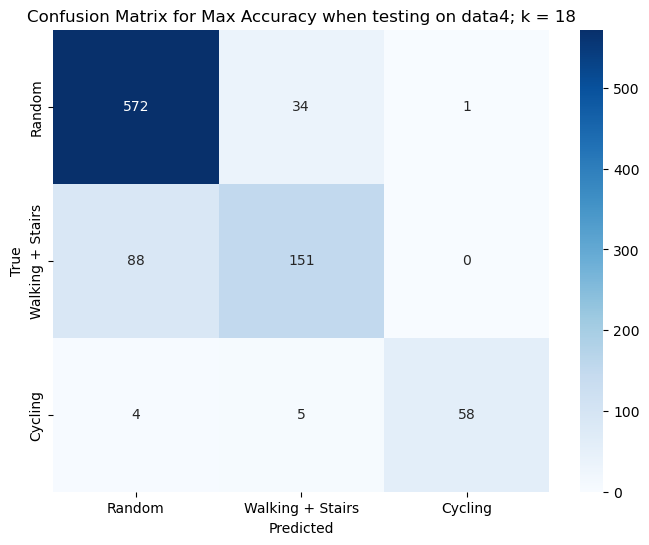

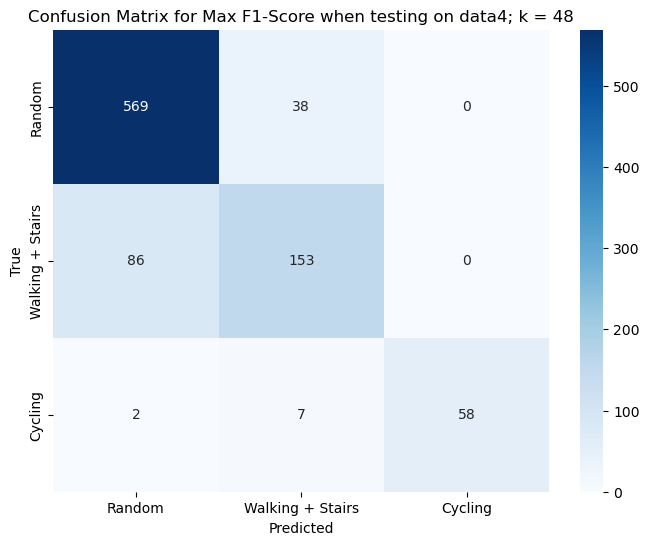

data4 has been tested on everyone


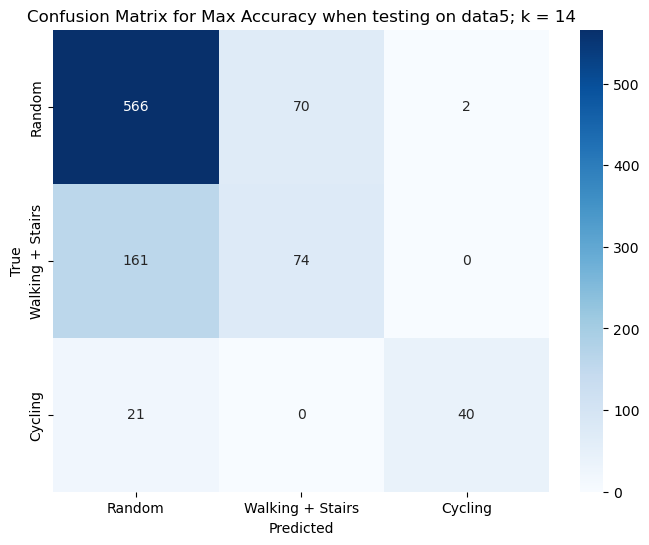

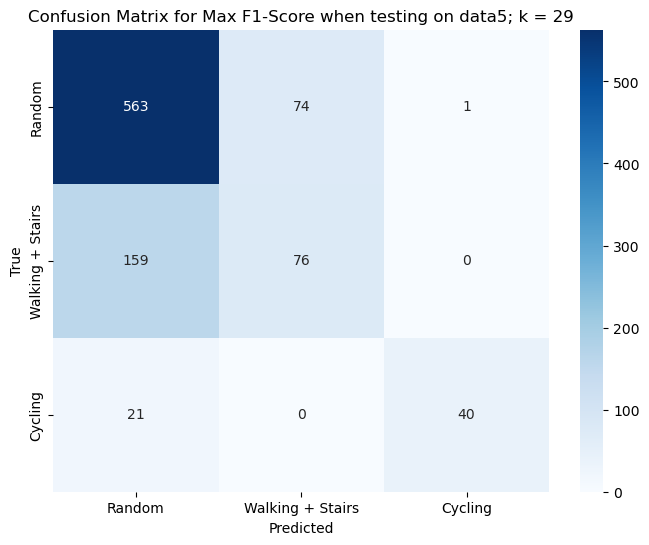

data5 has been tested on everyone


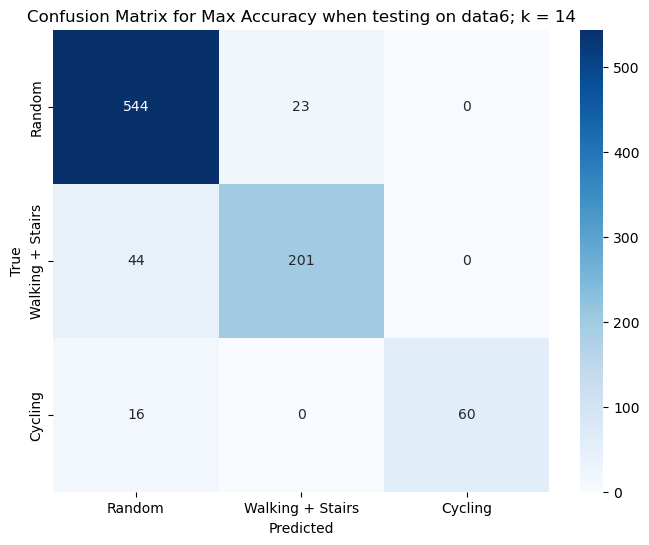

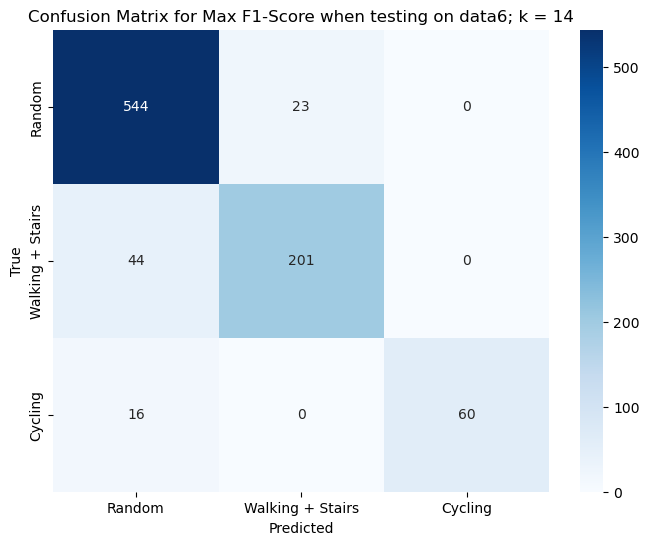

data6 has been tested on everyone


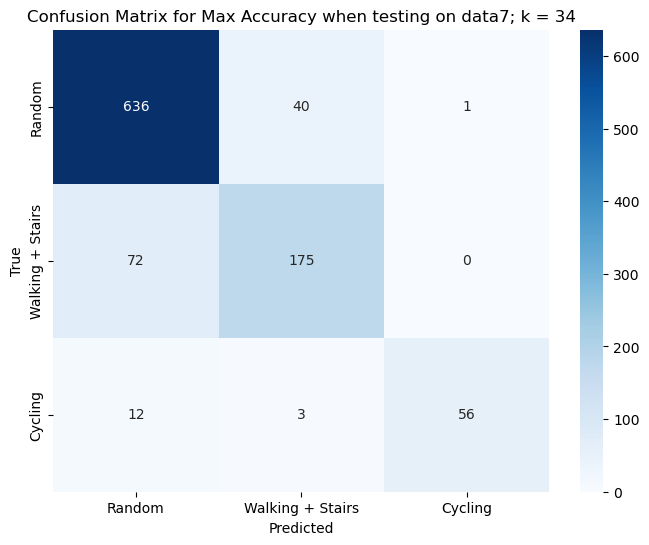

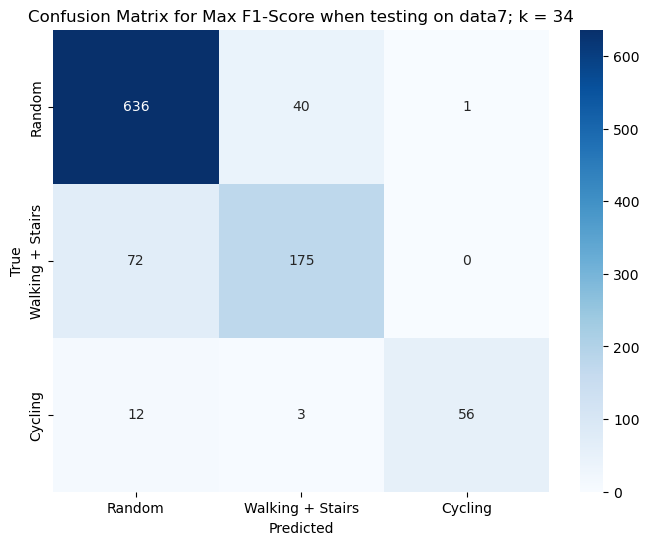

data7 has been tested on everyone


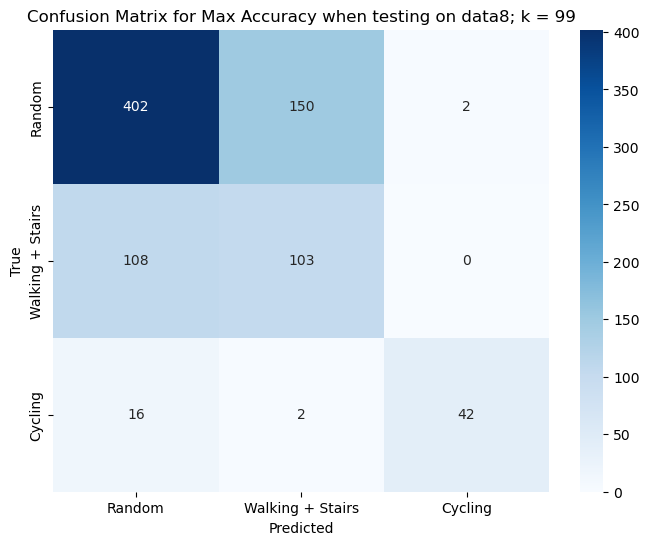

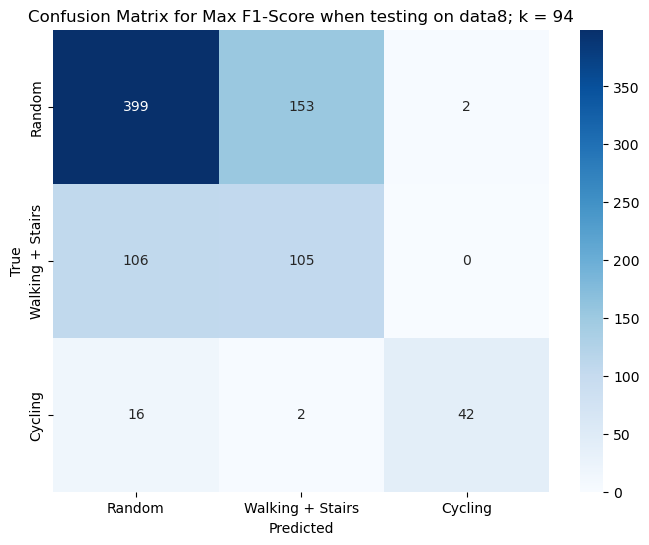

data8 has been tested on everyone


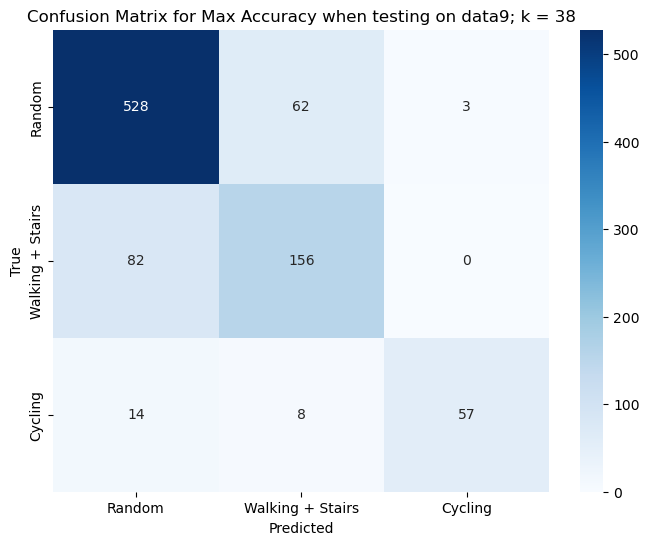

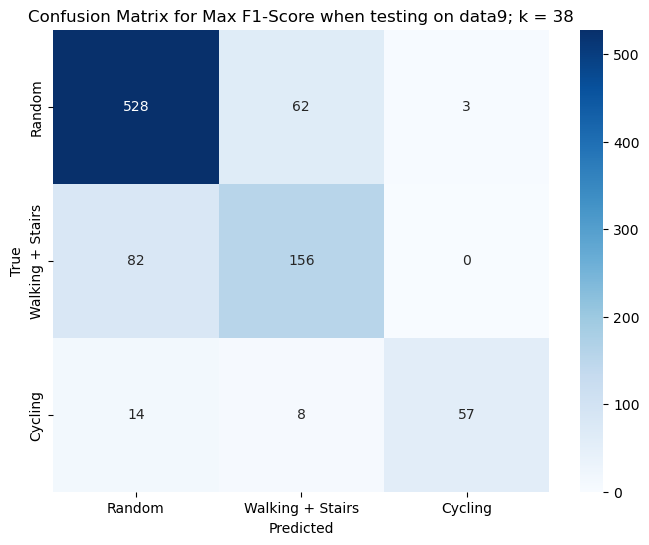

data9 has been tested on everyone


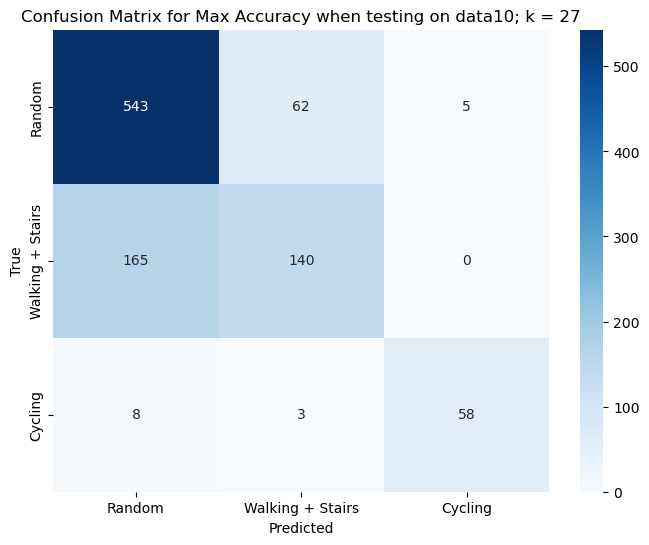

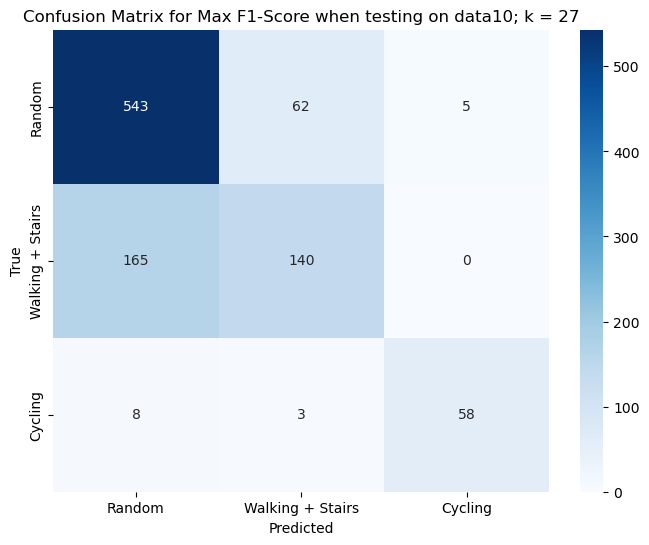

data10 has been tested on everyone


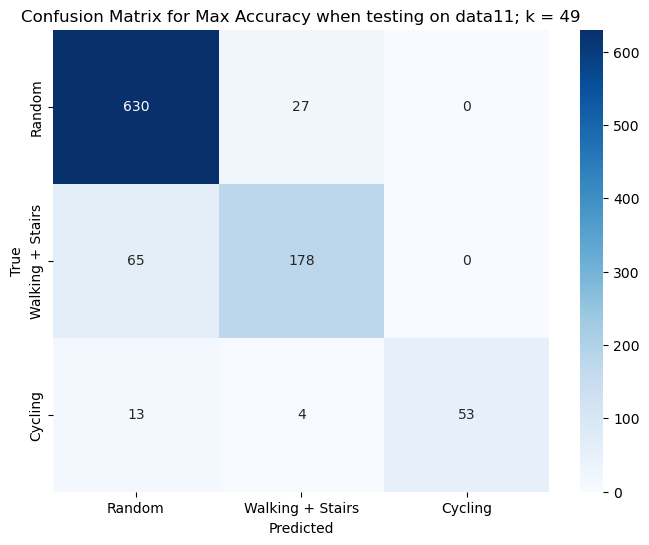

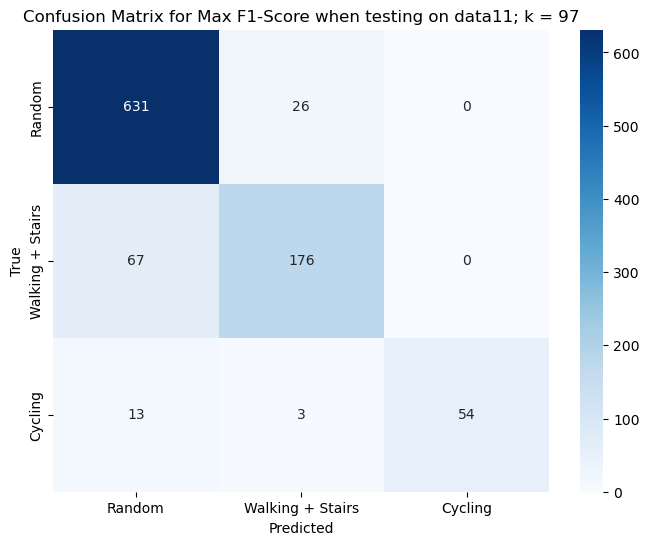

data11 has been tested on everyone


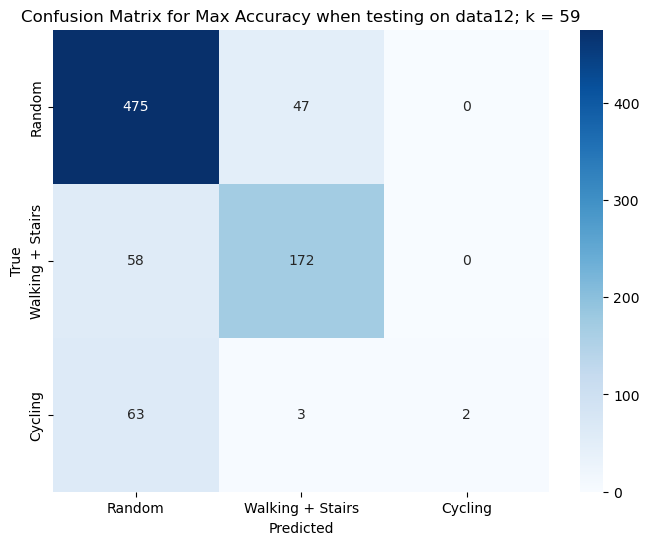

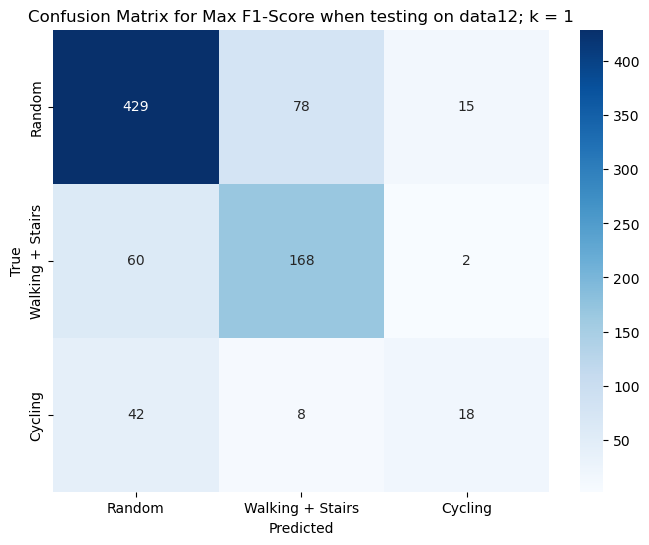

data12 has been tested on everyone


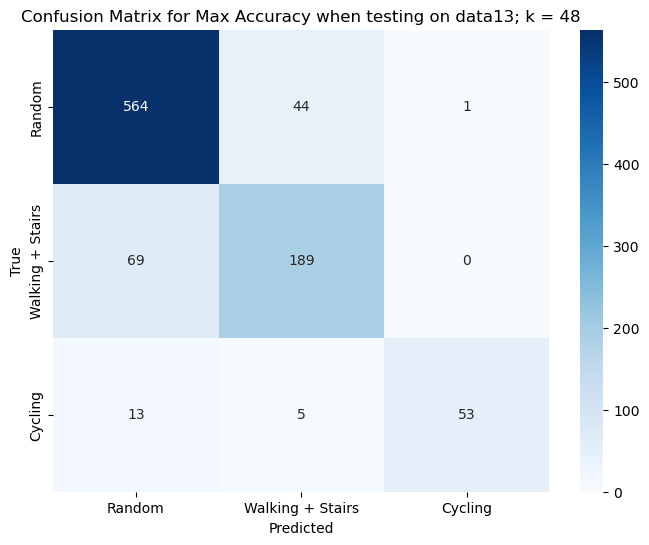

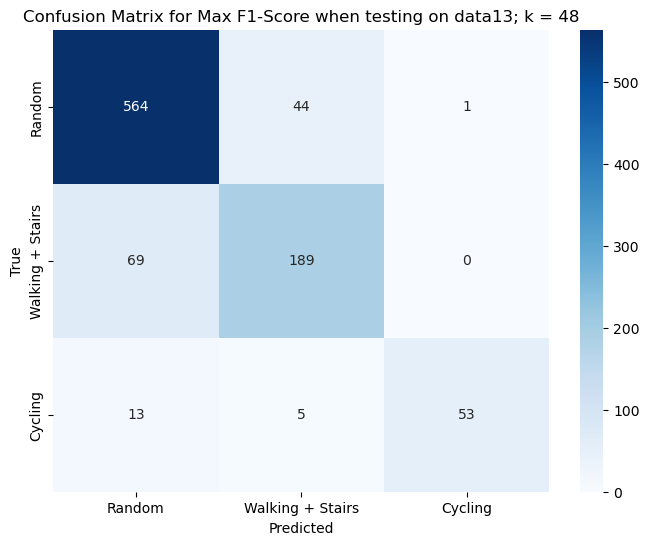

data13 has been tested on everyone


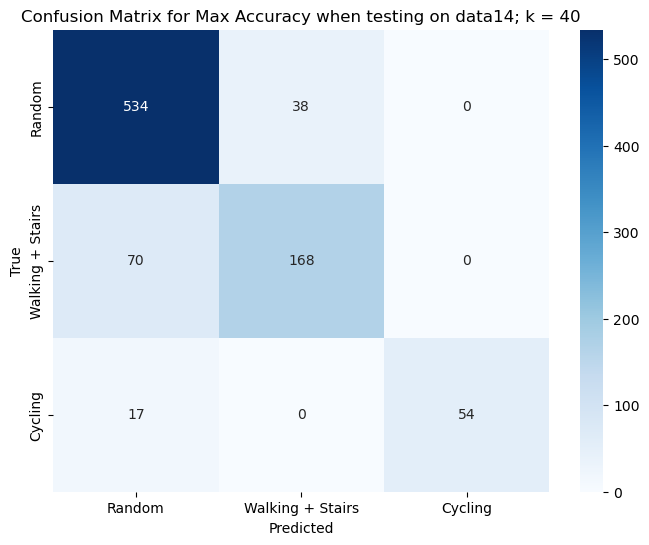

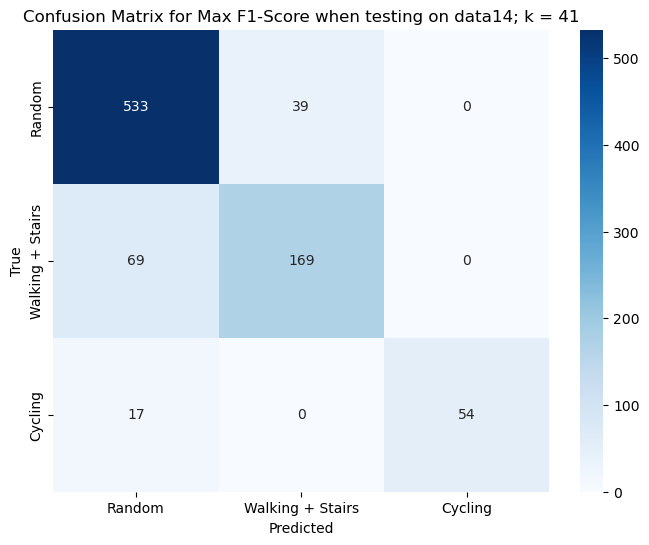

data14 has been tested on everyone


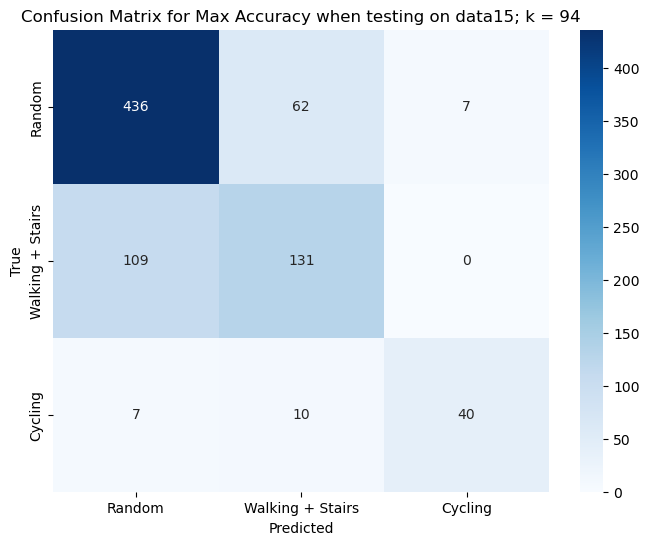

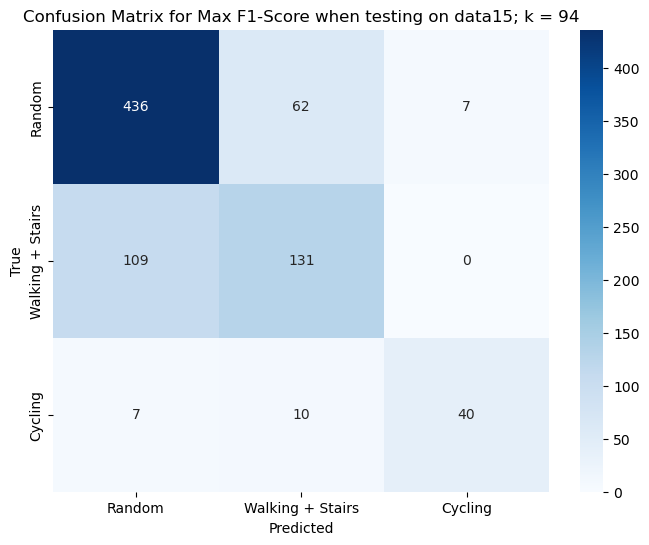

data15 has been tested on everyone


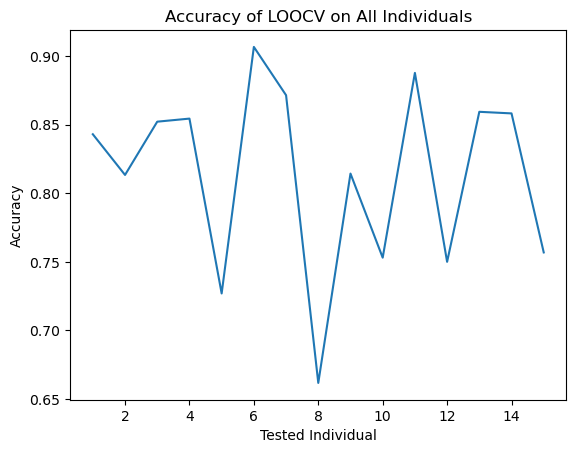

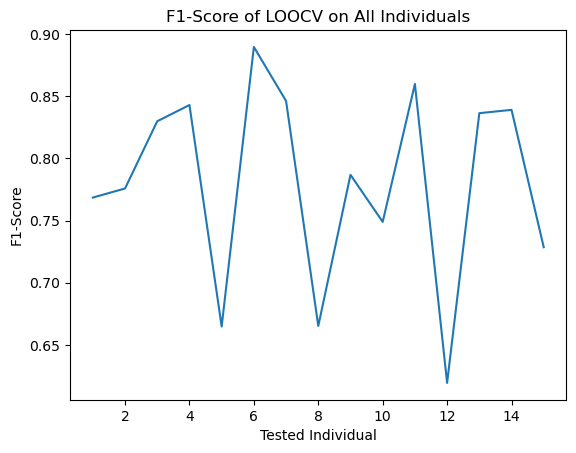

Average Accuracy:  0.813903124721627
Average F1-Score:  0.78009178970953


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## tsne
## 0: baseline + misc
## 1: walking + stairs
## 2: cycling
def plot_clusters(X, y, title):
    plt.figure(figsize=(10, 6))
    palette = sns.color_palette("hsv", len(np.unique(y)))
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=y, legend='full', palette=palette, s=60, alpha=0.8)
    plt.title(title)
    plt.show()

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0, 4])]
    data.loc[data['activity'].isin([2, 7, 8, 9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 6]), 'activity'] = 1
    data.loc[data['activity'].isin([5]), 'activity'] = 2
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

tsne = TSNE(n_components=3)
X_tsne = tsne.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_tsne, columns=[f'TSNE{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

plot_clusters(X_tsne, tsne_df['activity'], "TSNE")

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = f1_score(testingActivity, knn.predict(testingFeatures), average="macro")
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Walking + Stairs", "Cycling"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Walking + Stairs", "Cycling"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, f1_score(testingActivity, y_pred, average='macro'))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


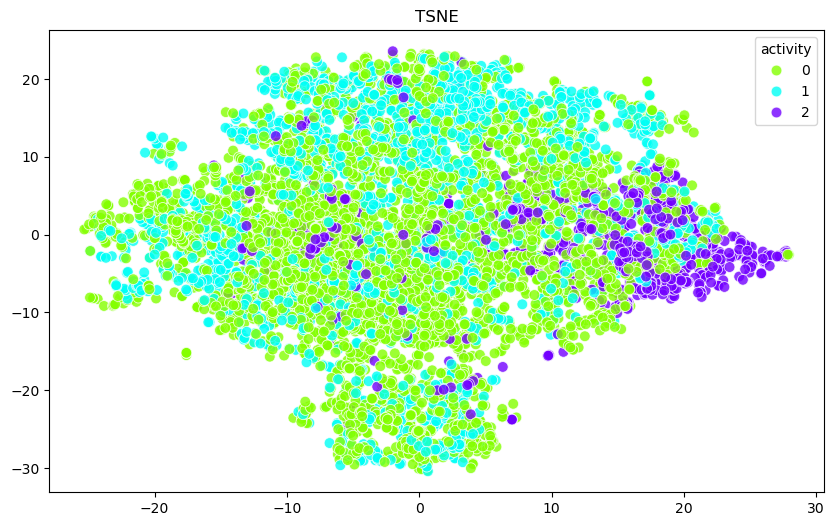

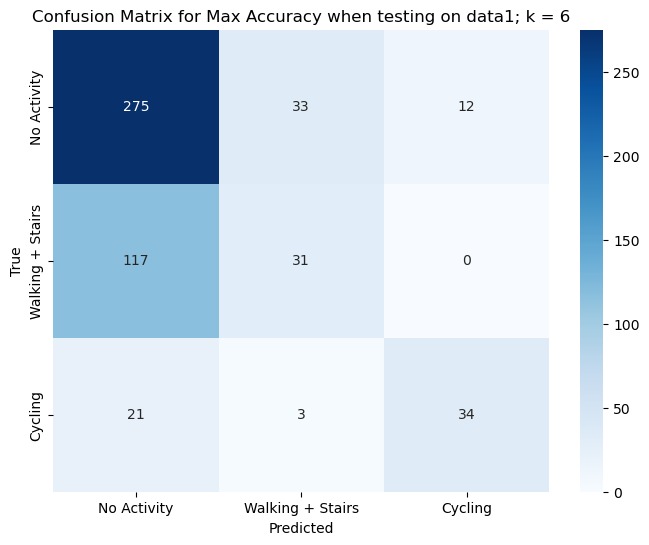

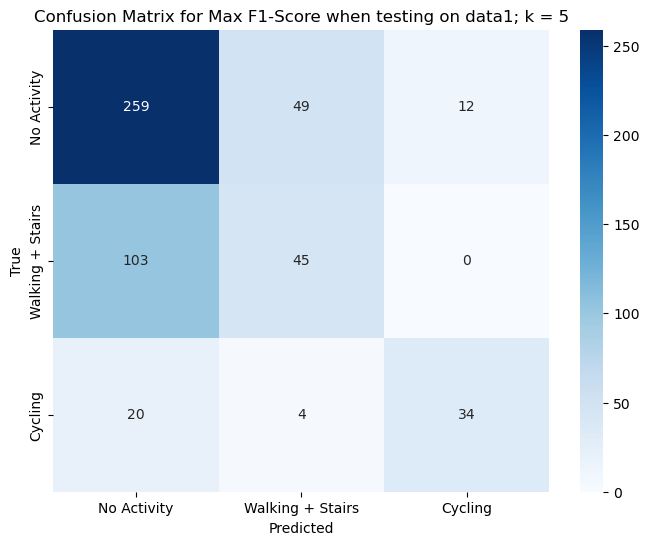

data1 has been tested on everyone


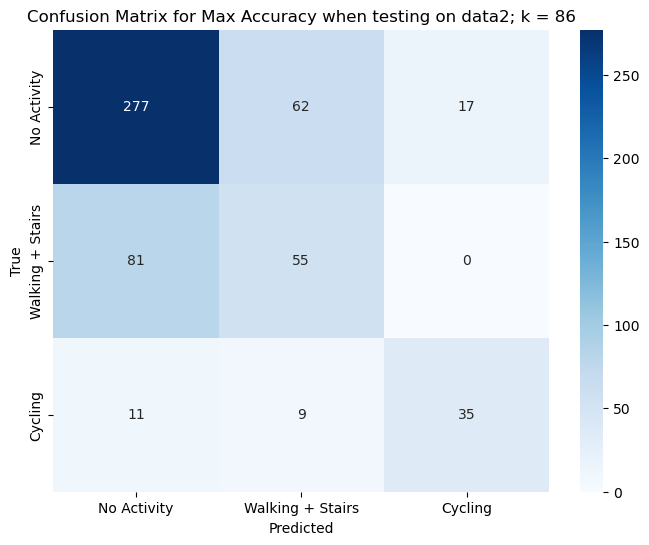

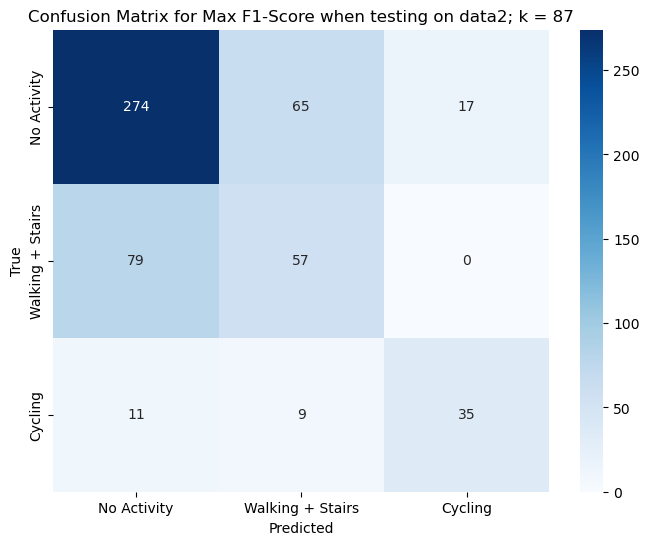

data2 has been tested on everyone


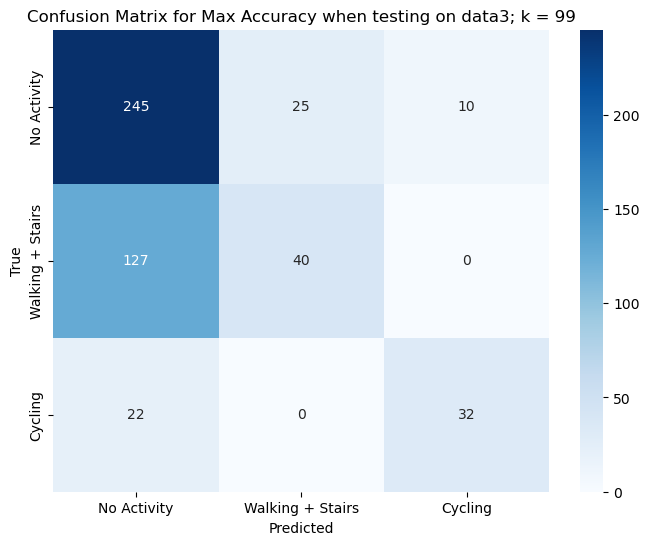

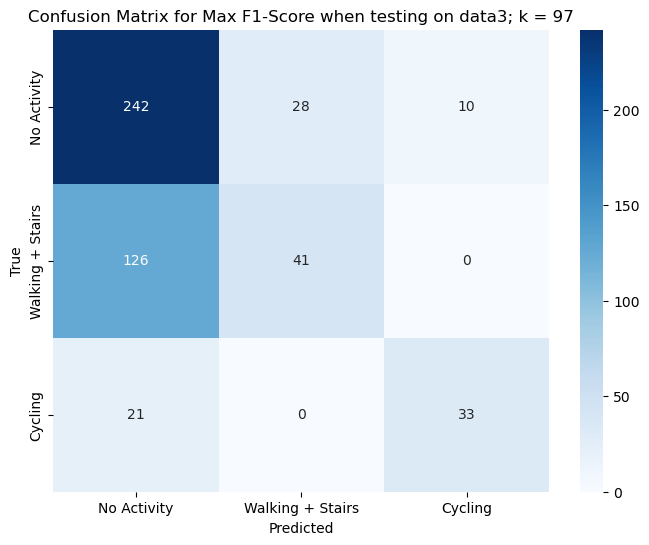

data3 has been tested on everyone


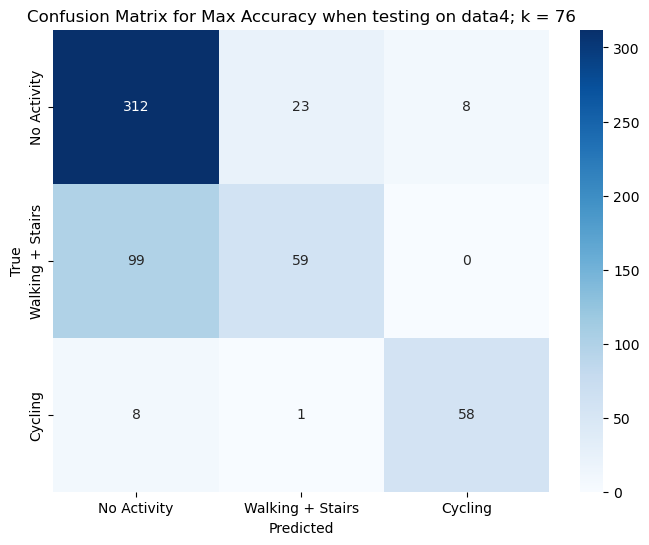

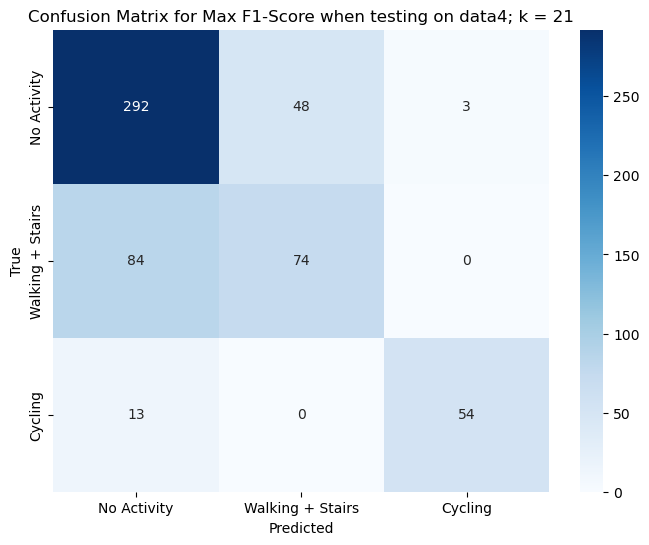

data4 has been tested on everyone


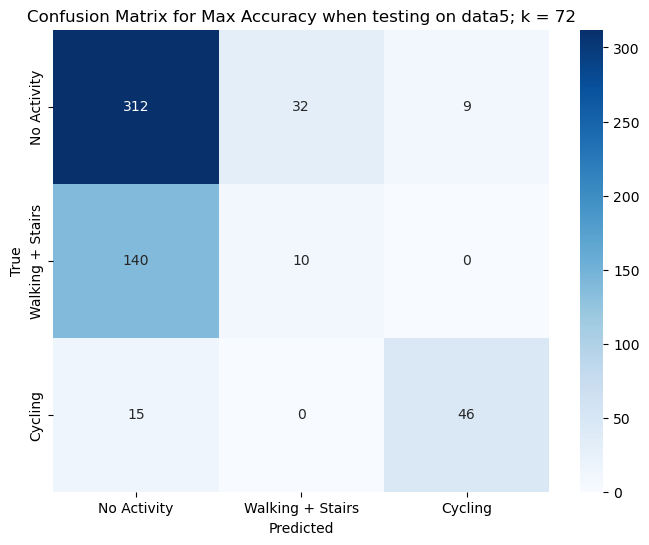

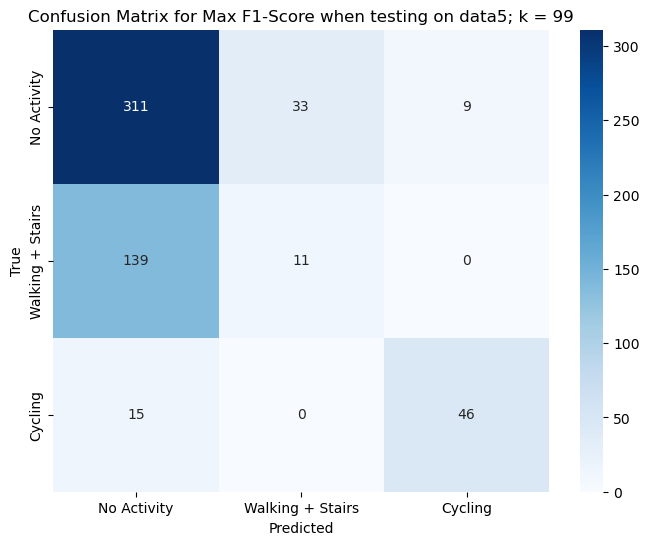

data5 has been tested on everyone


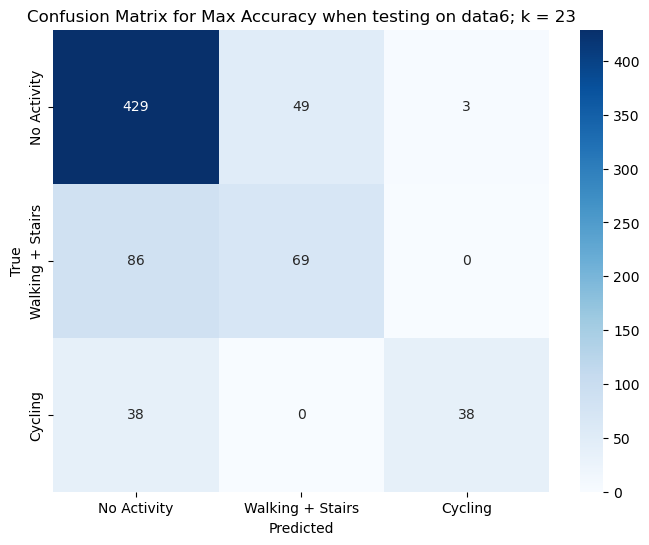

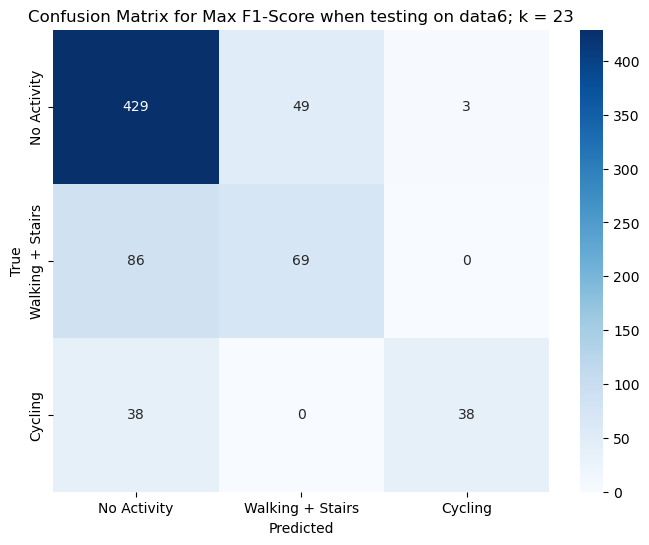

data6 has been tested on everyone


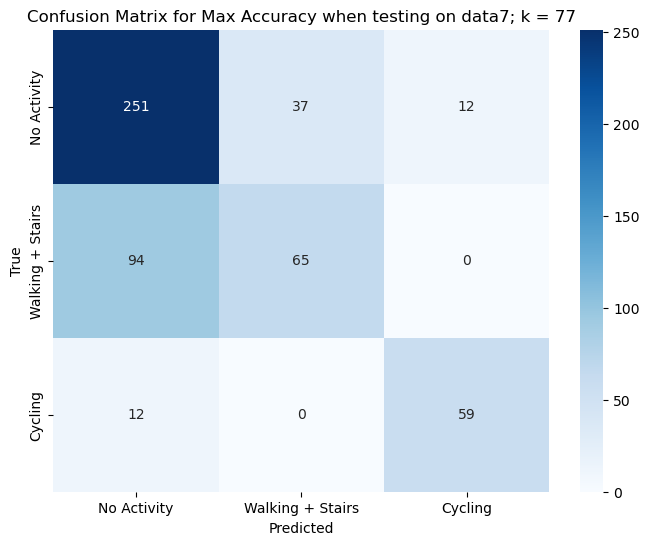

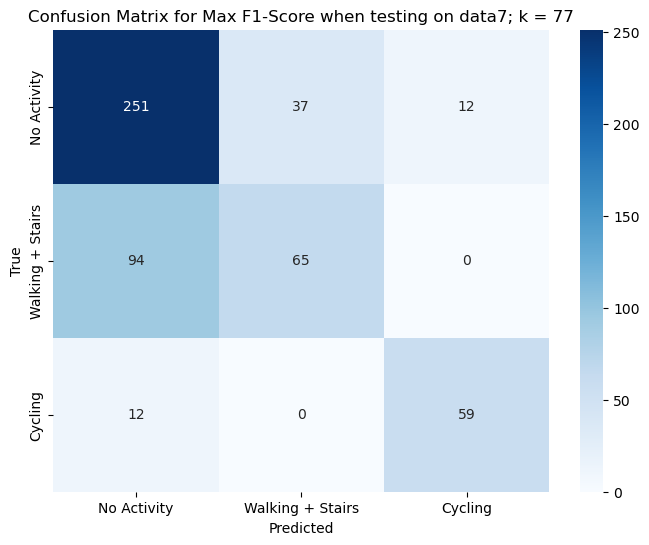

data7 has been tested on everyone


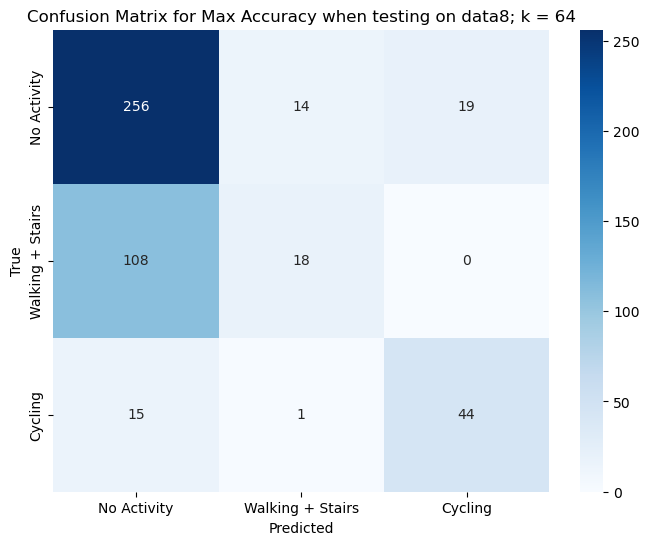

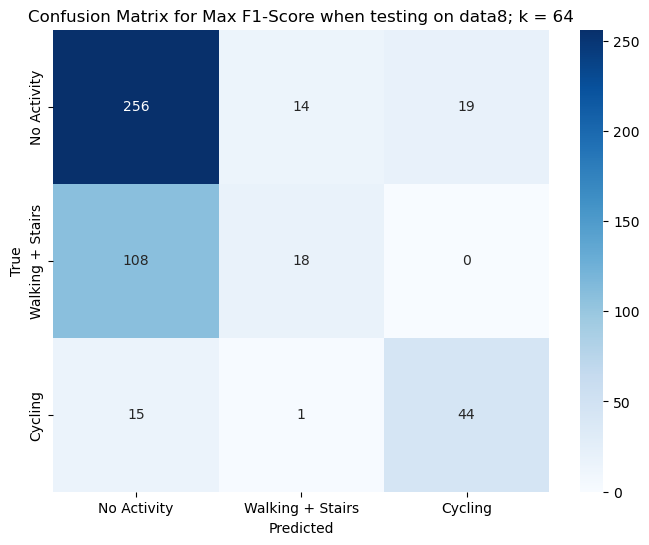

data8 has been tested on everyone


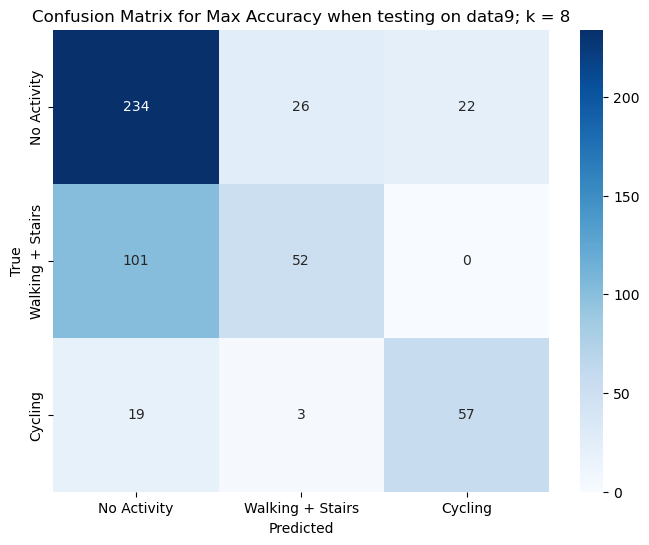

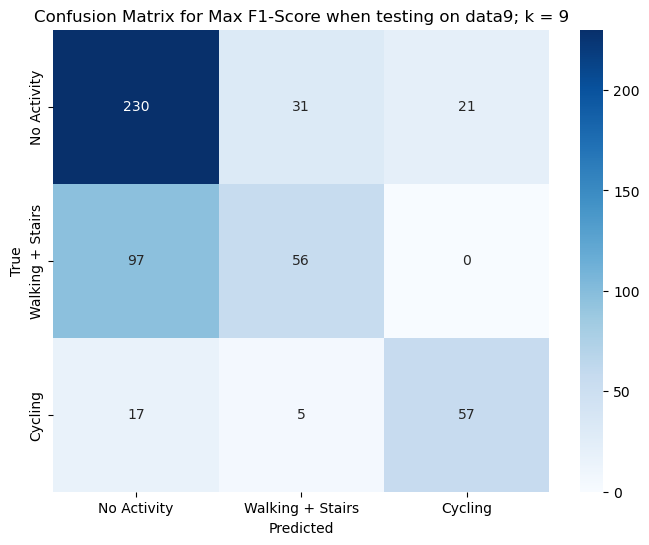

data9 has been tested on everyone


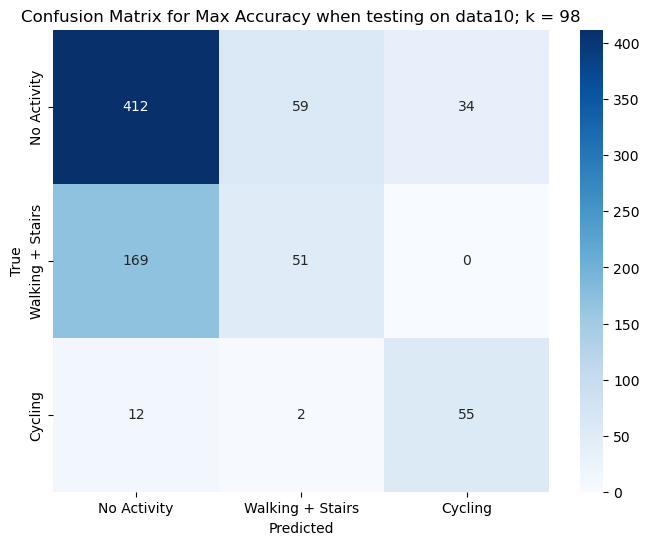

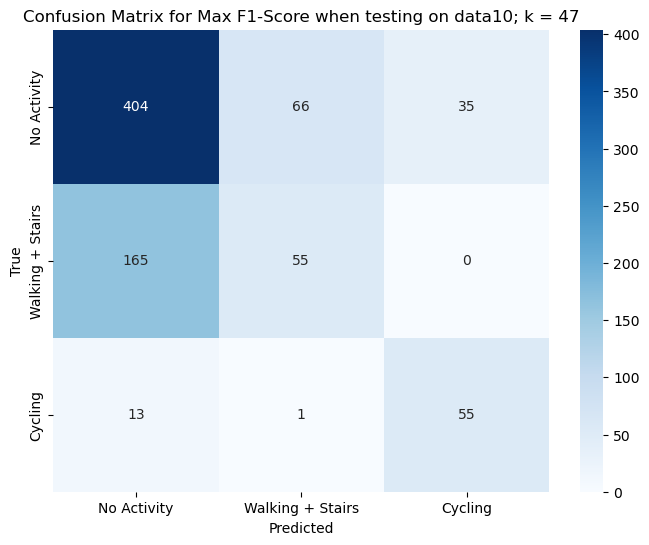

data10 has been tested on everyone


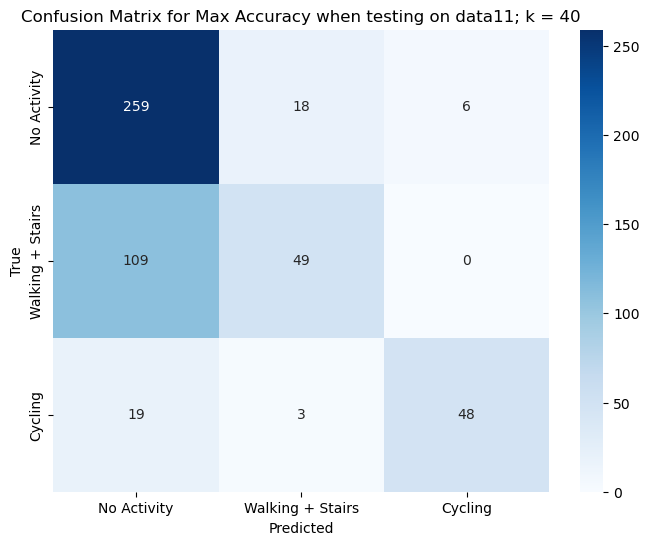

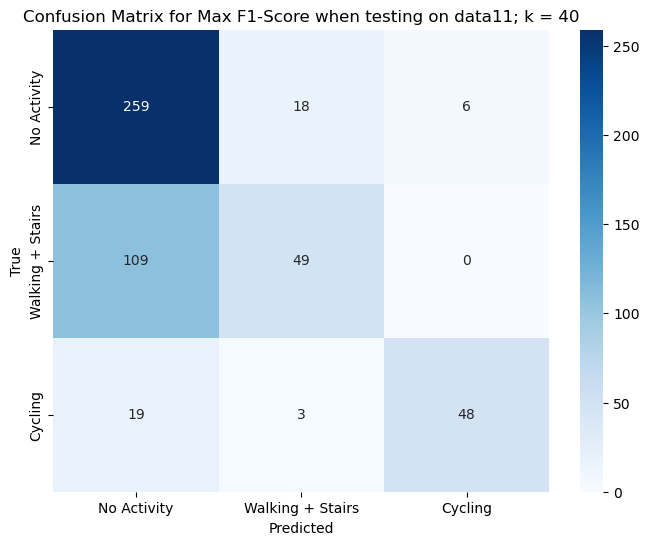

data11 has been tested on everyone


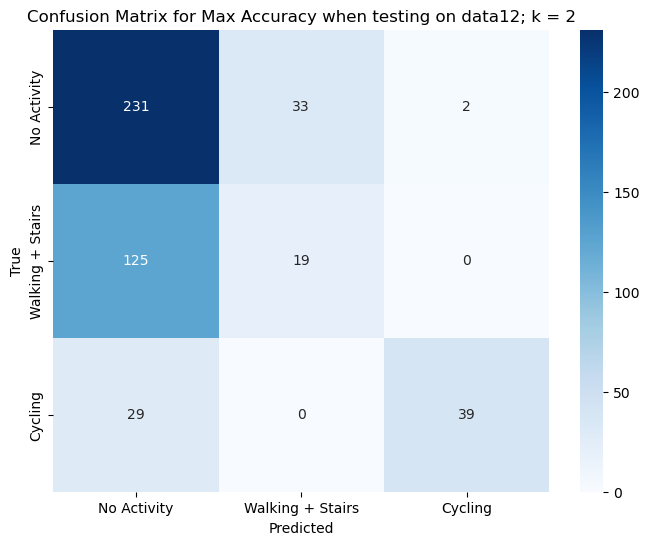

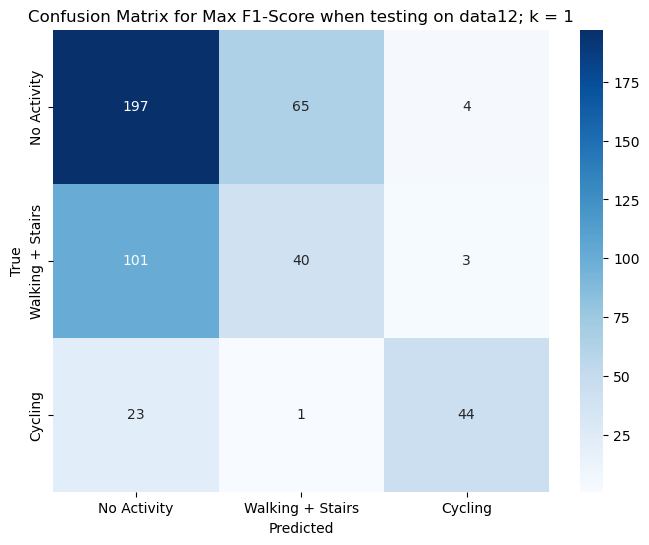

data12 has been tested on everyone


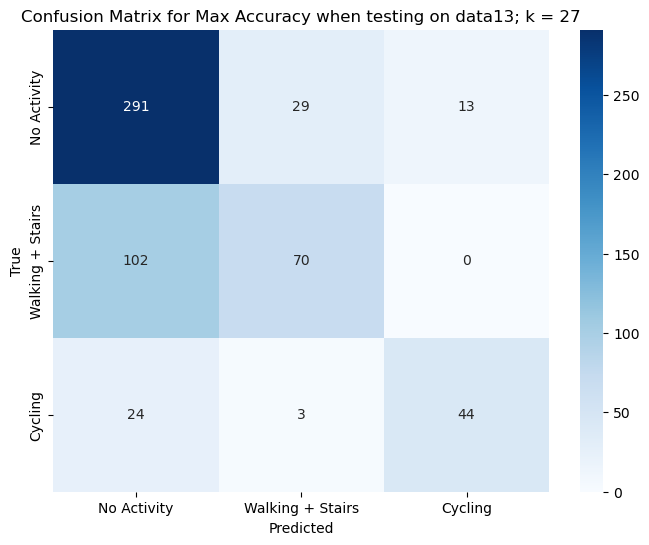

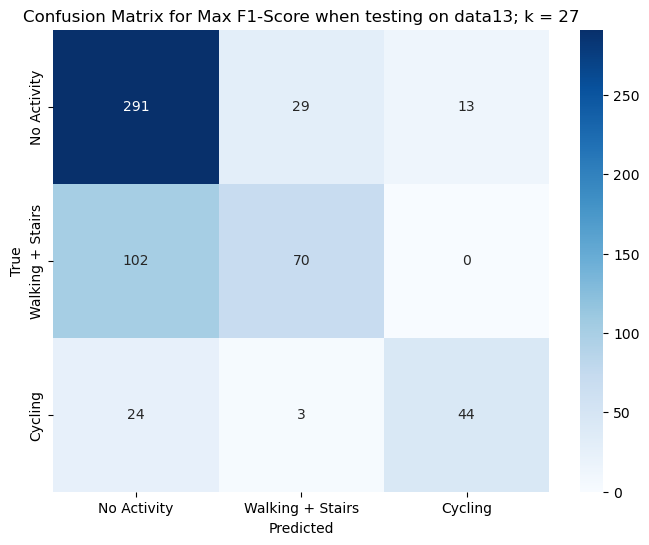

data13 has been tested on everyone


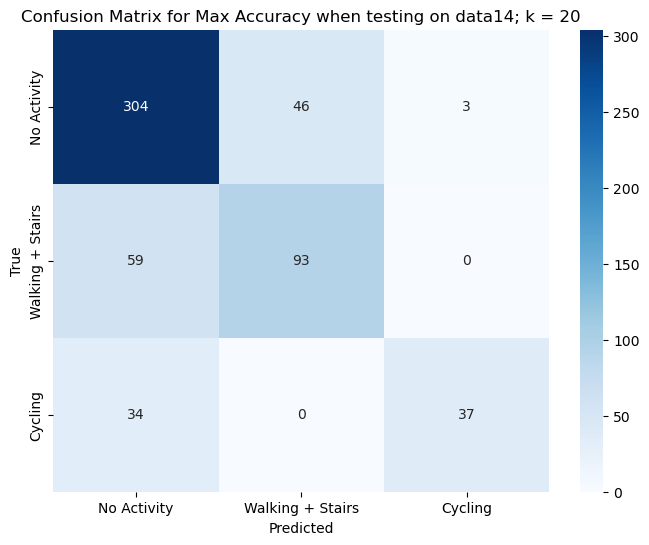

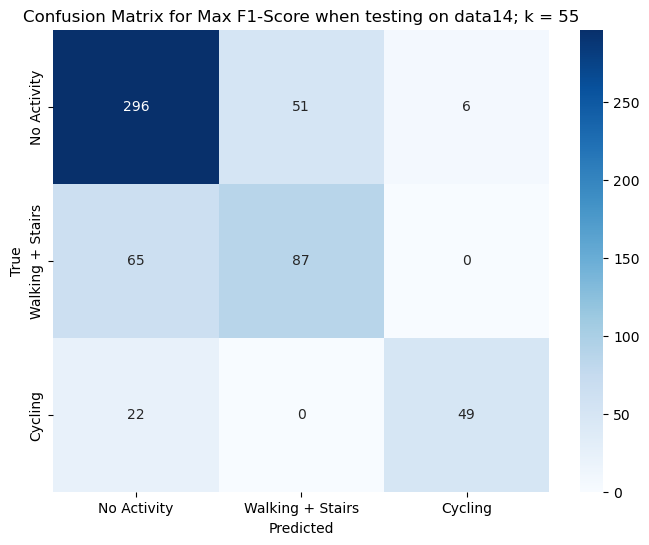

data14 has been tested on everyone


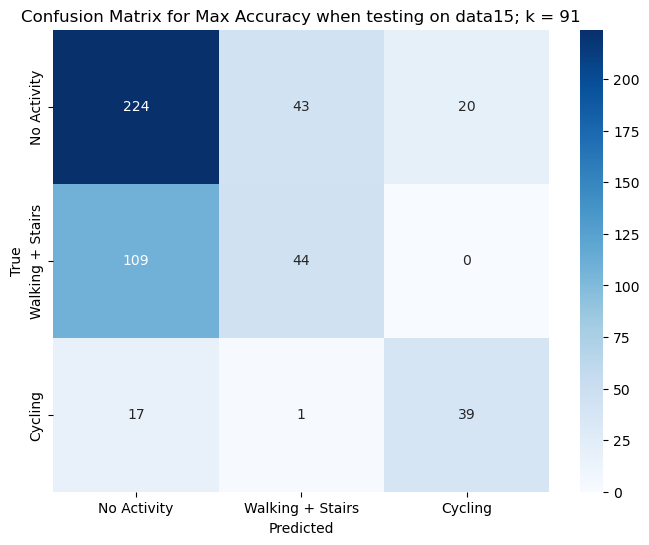

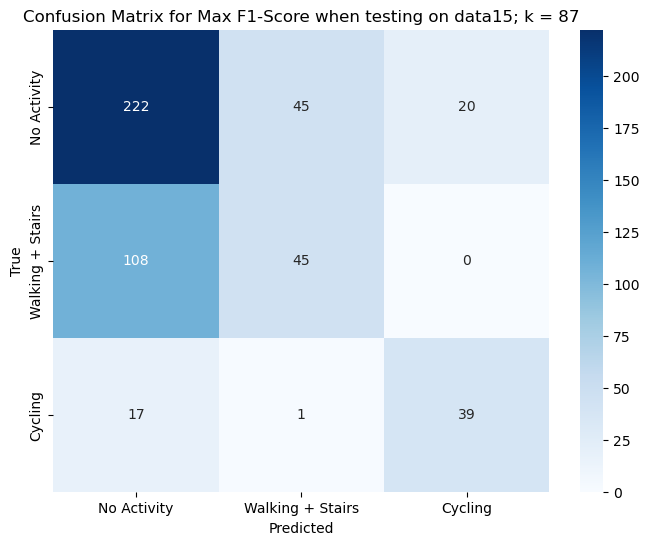

data15 has been tested on everyone


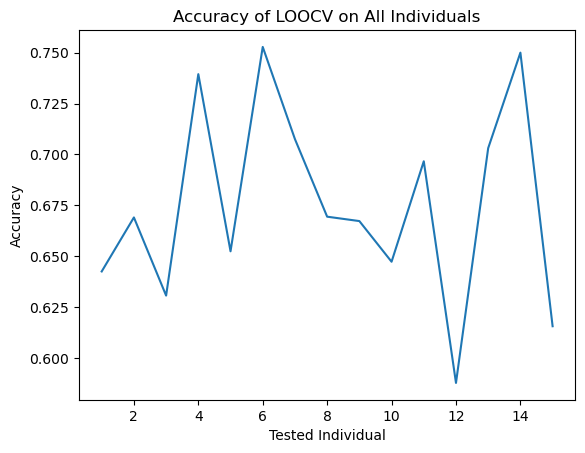

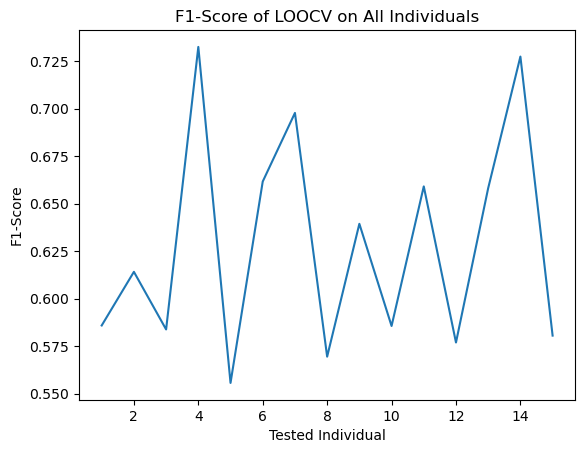

Average Accuracy:  0.6754803875647665
Average F1-Score:  0.6285040653826545


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## tsne
## 0: no activity
## 1: walking + stairs
## 2: cycling
def plot_clusters(X, y, title):
    plt.figure(figsize=(10, 6))
    palette = sns.color_palette("hsv", len(np.unique(y)))
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=y, legend='full', palette=palette, s=60, alpha=0.8)
    plt.title(title)
    plt.show()

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([1, 2, 4, 7, 8, 9])]
    data.loc[data['activity'].isin([3, 6]), 'activity'] = 1
    data.loc[data['activity'].isin([5]), 'activity'] = 2
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

tsne = TSNE(n_components=3)
X_tsne = tsne.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_tsne, columns=[f'TSNE{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

plot_clusters(X_tsne, tsne_df['activity'], "TSNE")

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = f1_score(testingActivity, knn.predict(testingFeatures), average="macro")
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Walking + Stairs", "Cycling"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Walking + Stairs", "Cycling"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, f1_score(testingActivity, y_pred, average='macro'))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


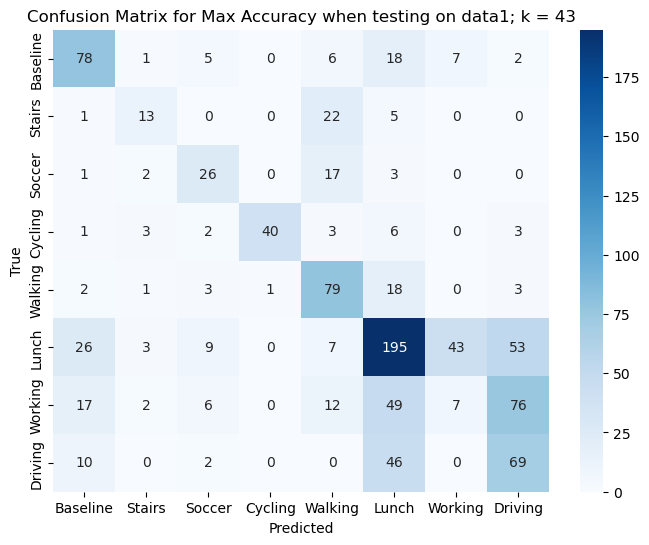

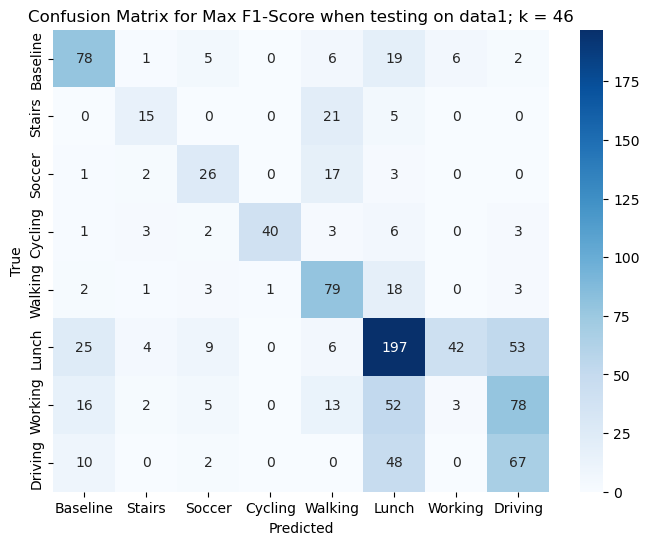

data1 has been tested on everyone


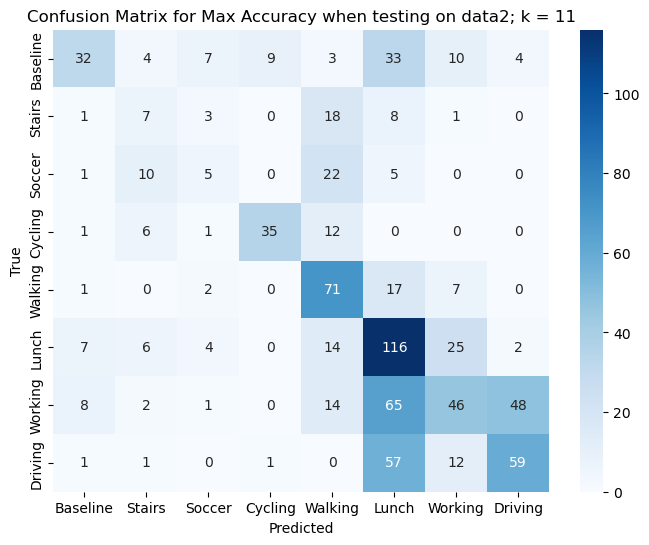

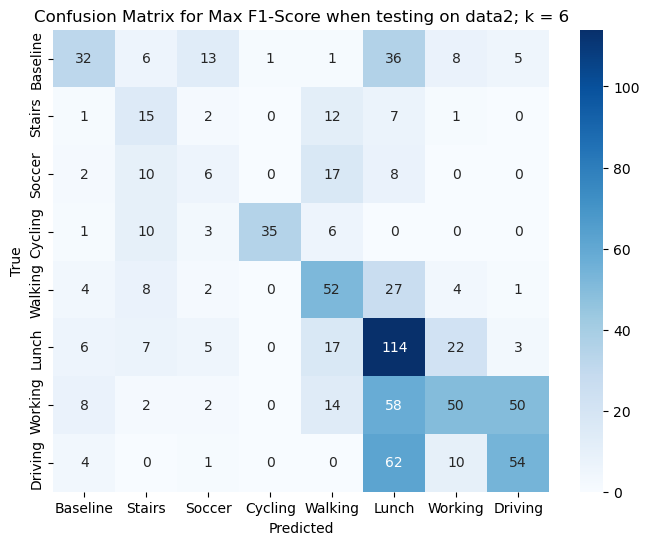

data2 has been tested on everyone


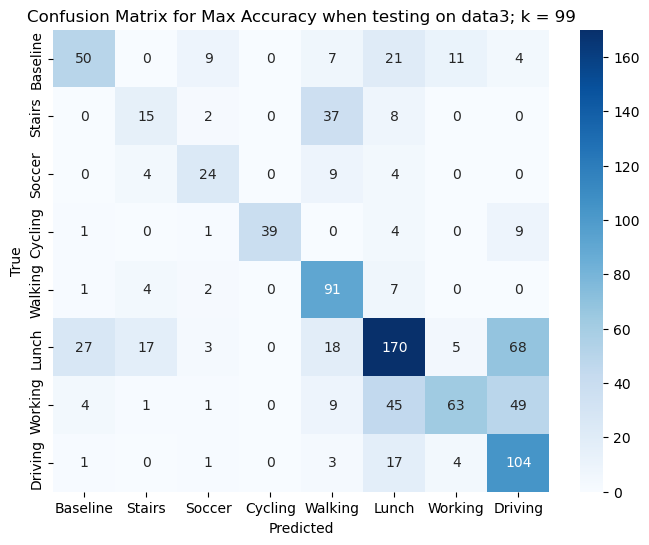

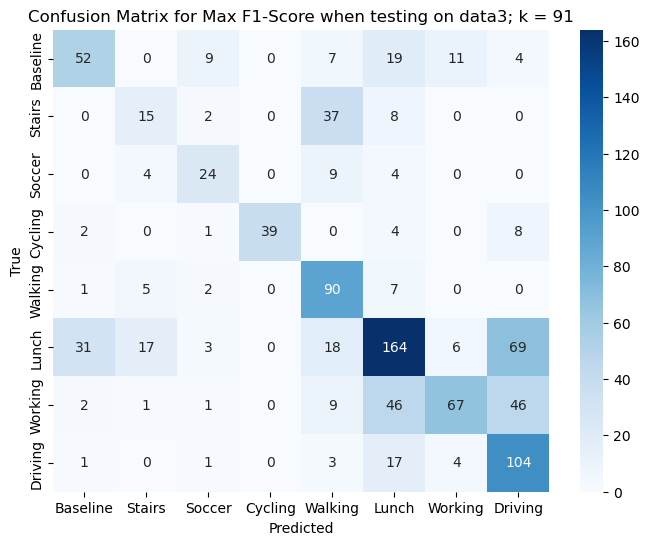

data3 has been tested on everyone


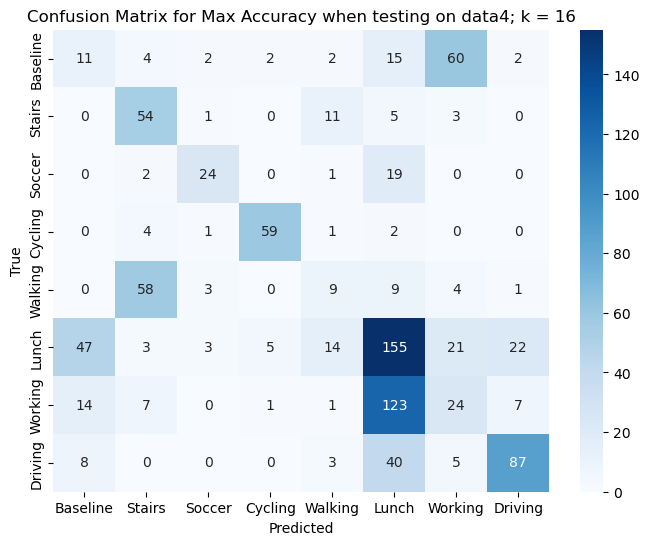

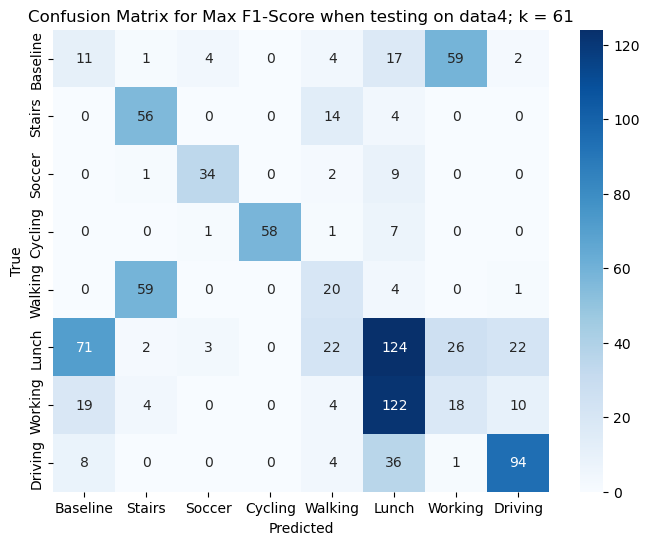

data4 has been tested on everyone


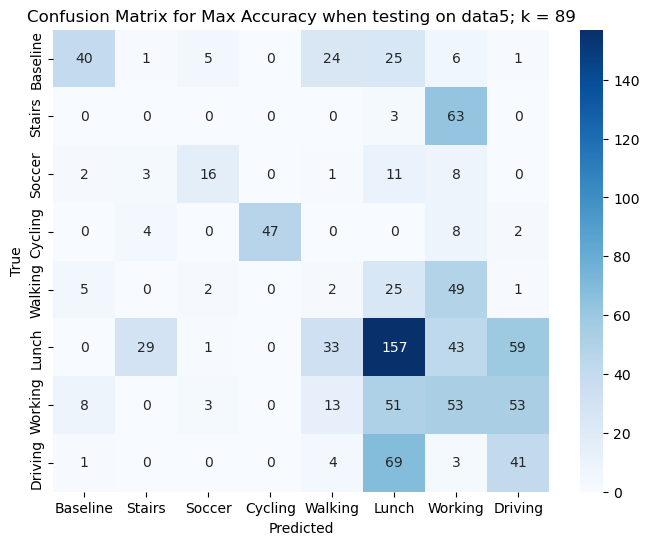

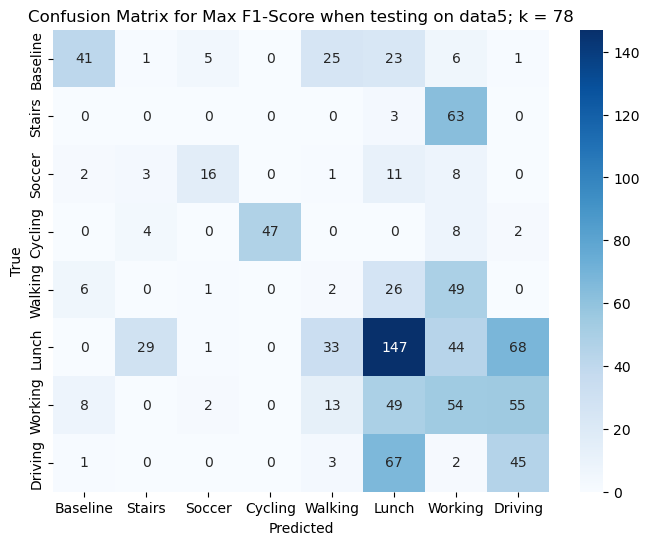

data5 has been tested on everyone


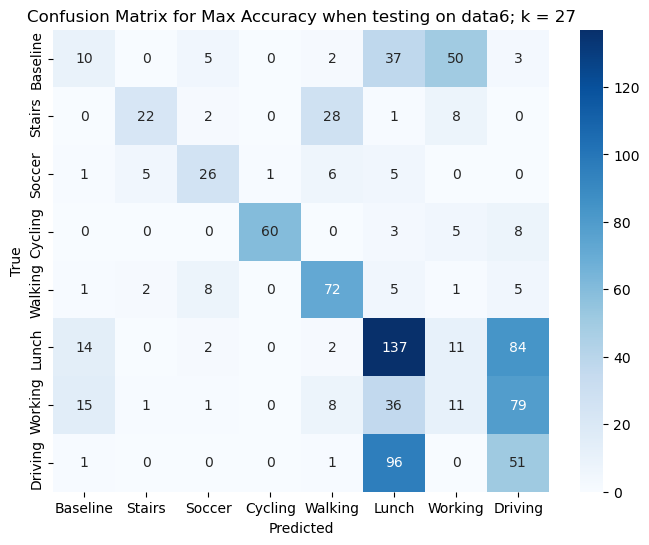

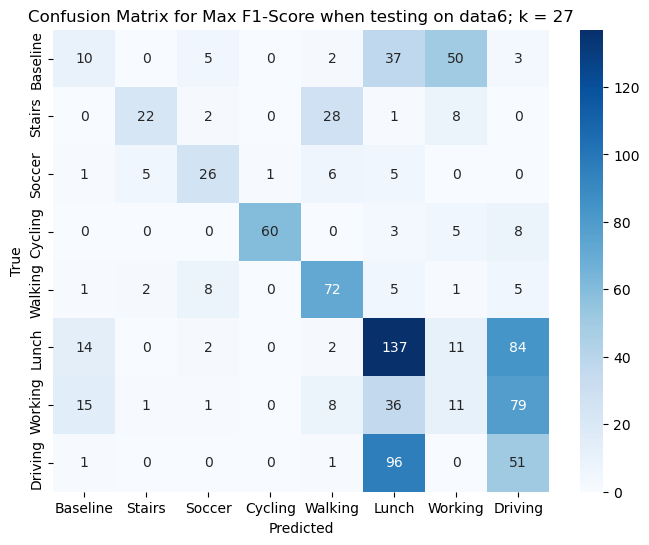

data6 has been tested on everyone


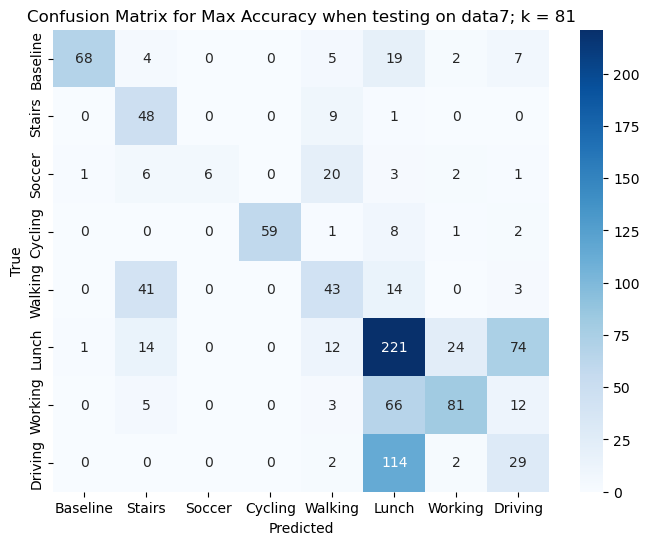

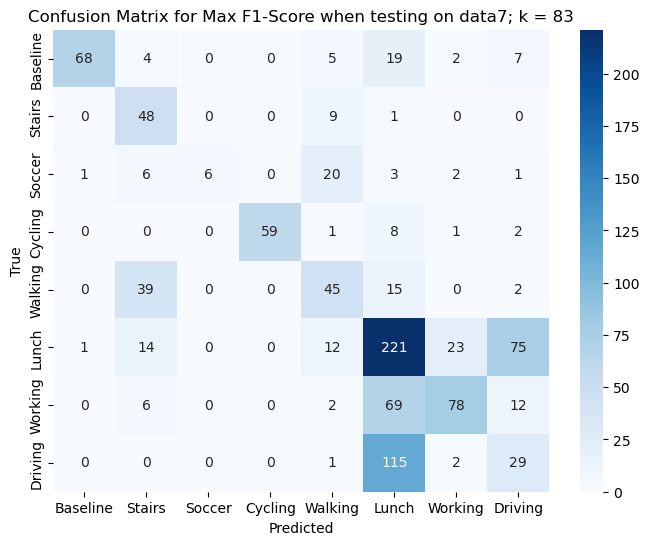

data7 has been tested on everyone


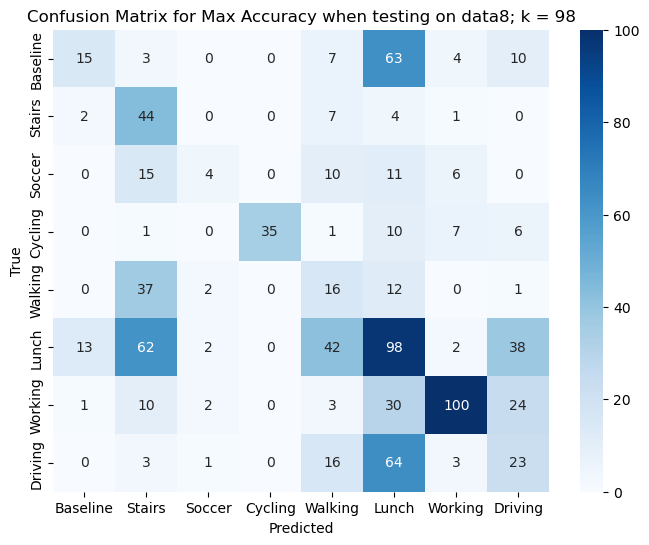

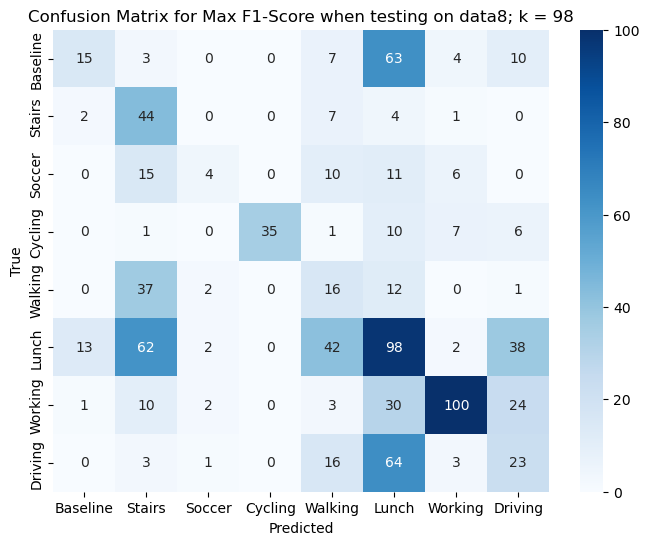

data8 has been tested on everyone


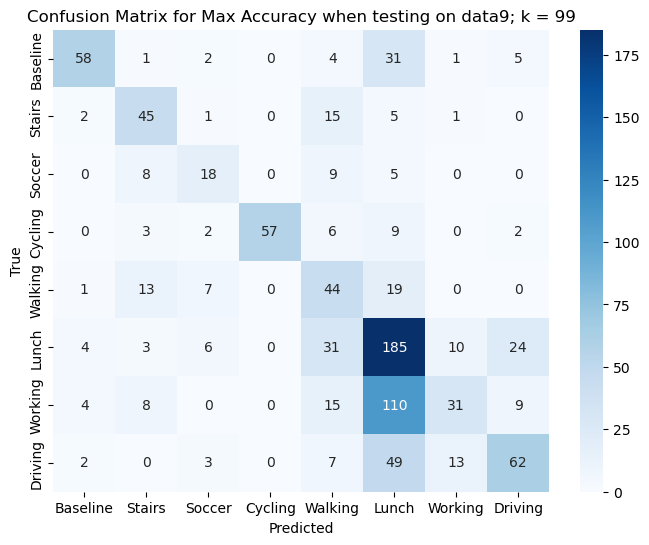

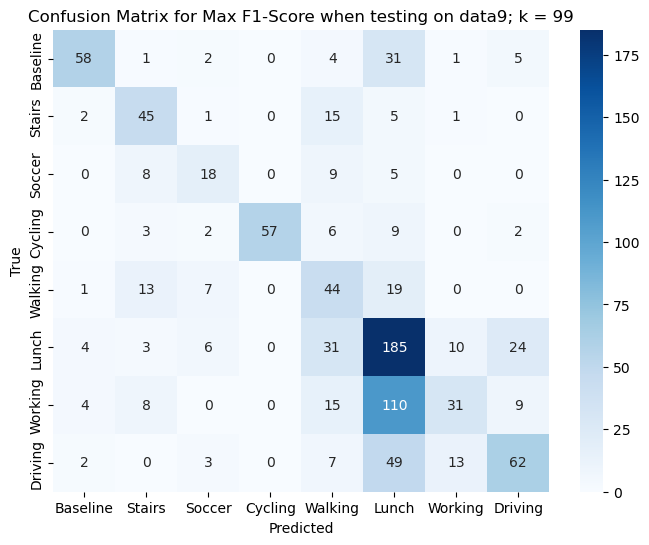

data9 has been tested on everyone


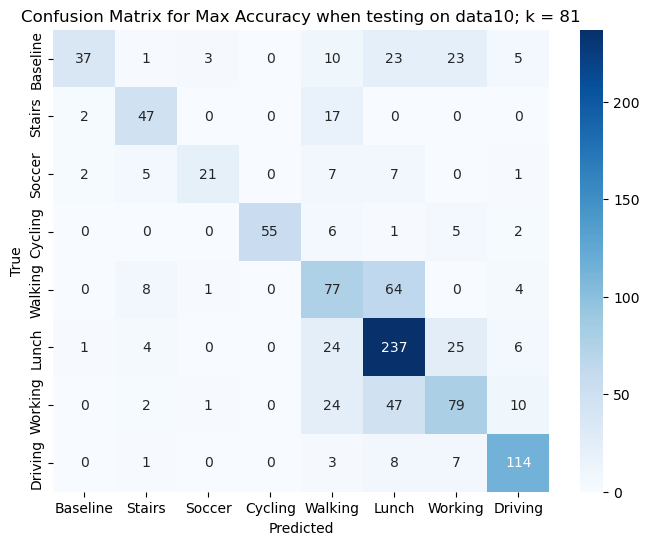

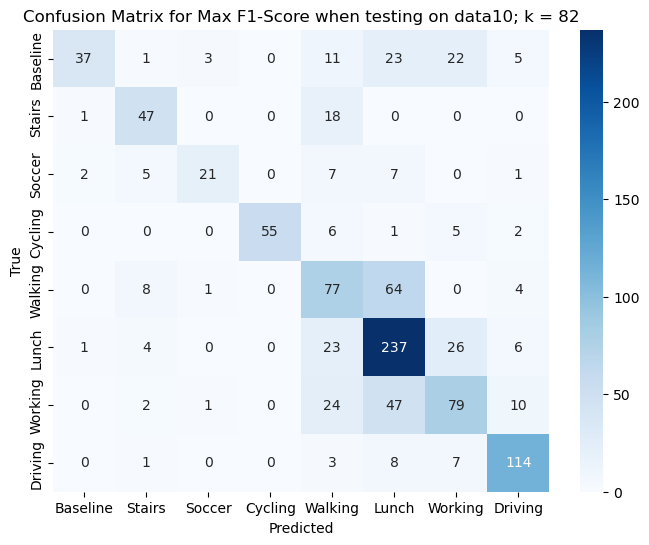

data10 has been tested on everyone


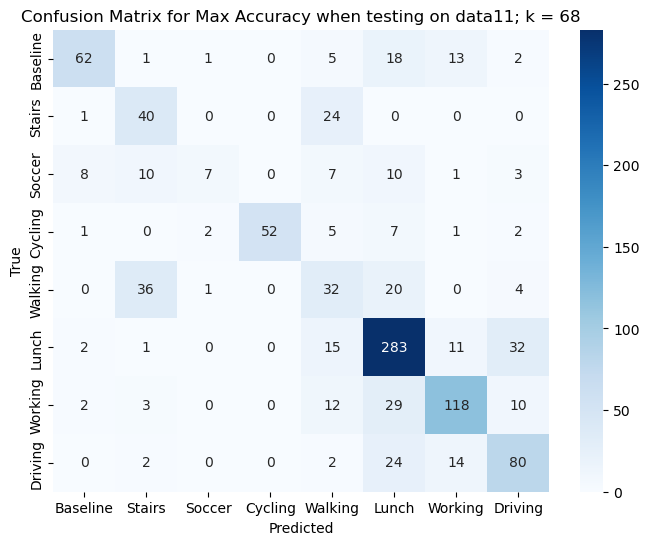

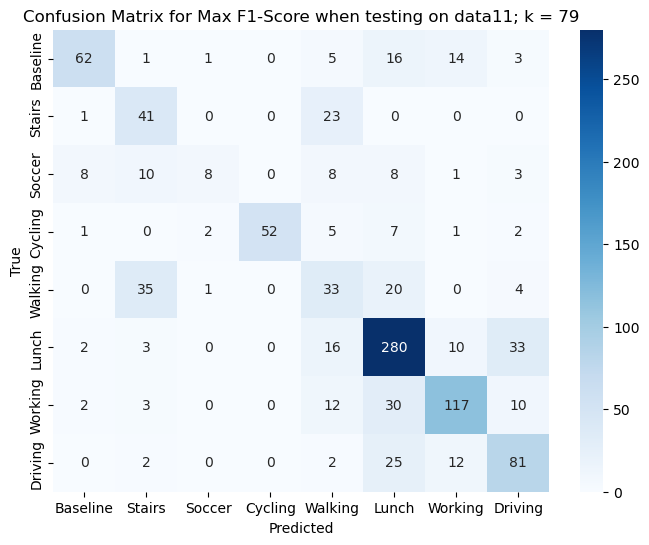

data11 has been tested on everyone


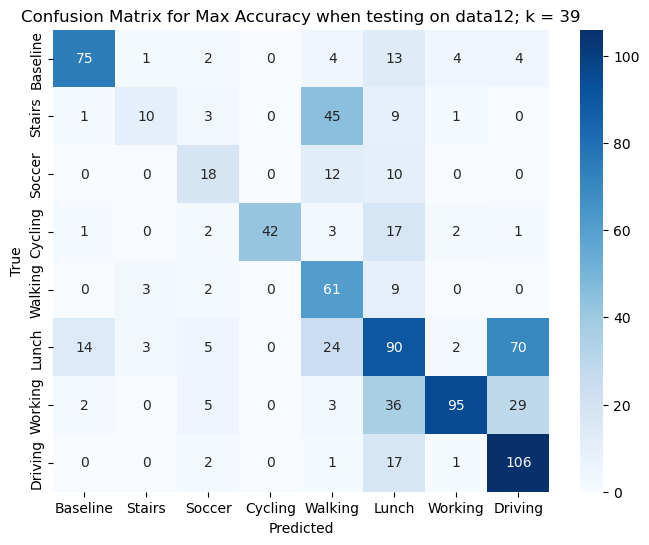

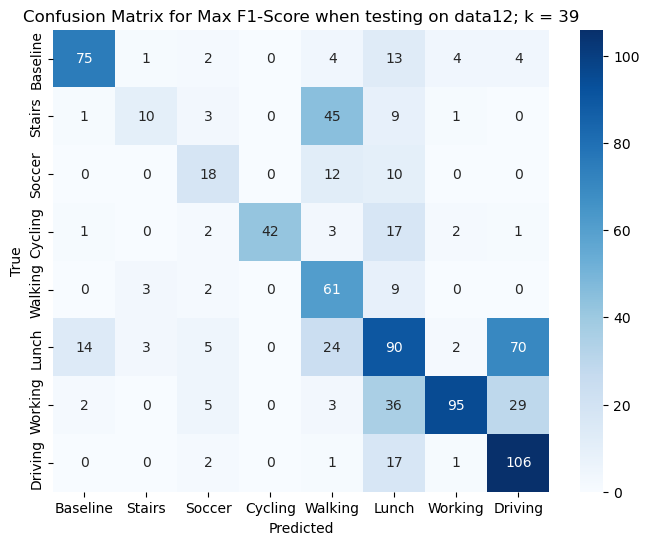

data12 has been tested on everyone


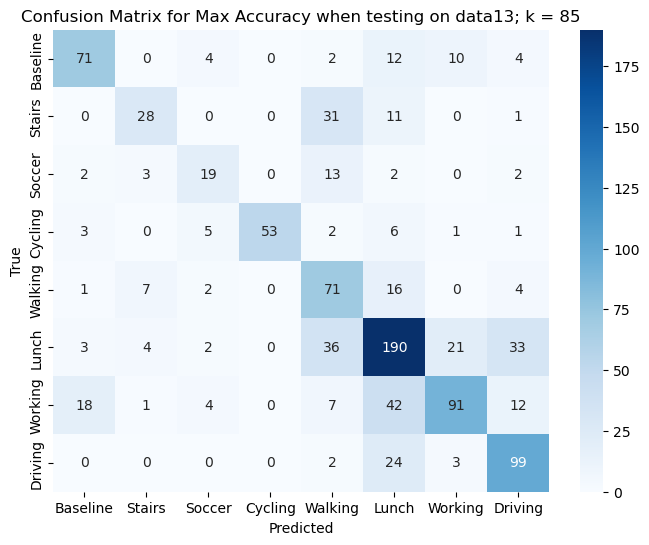

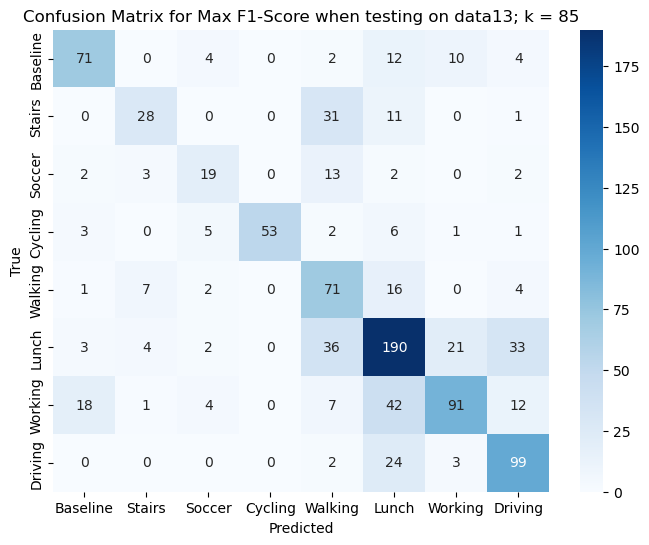

data13 has been tested on everyone


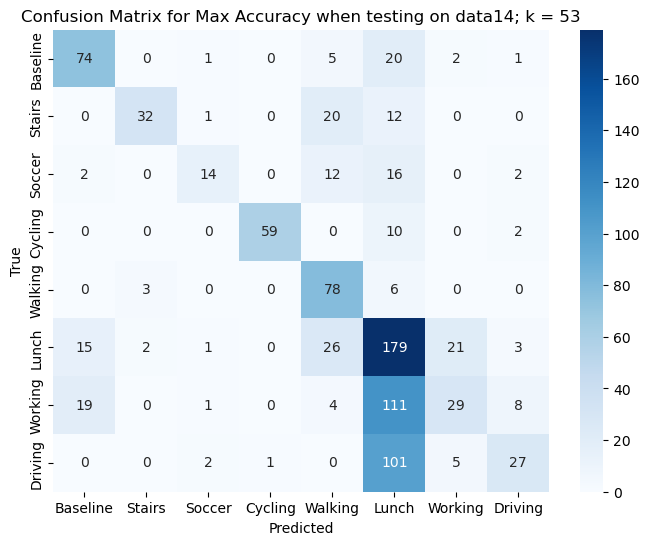

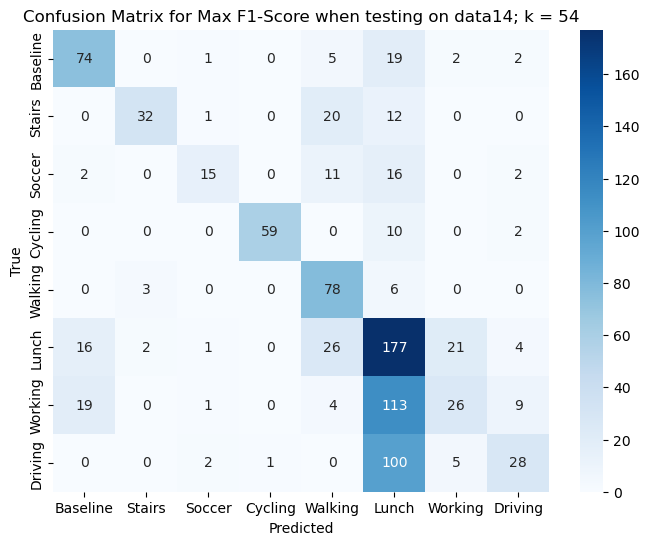

data14 has been tested on everyone


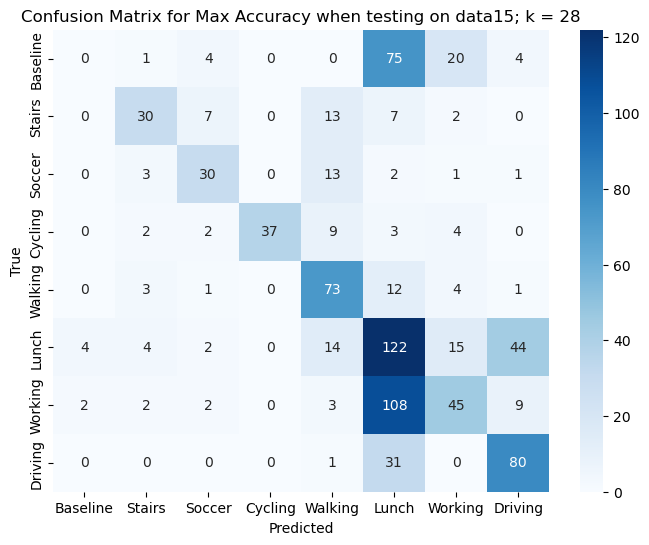

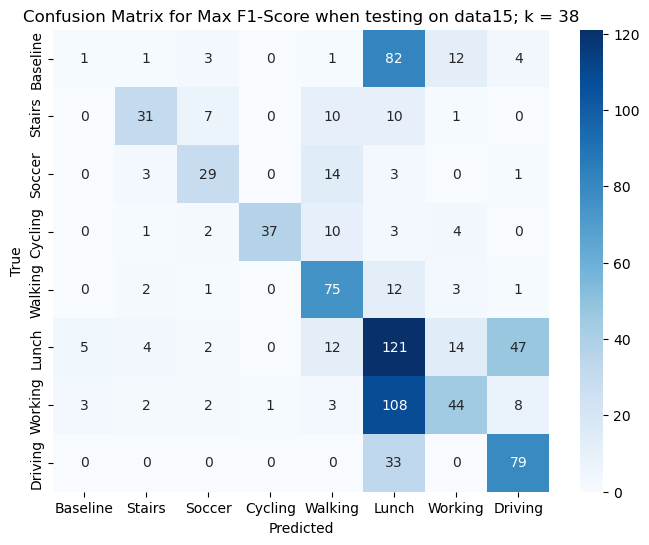

data15 has been tested on everyone


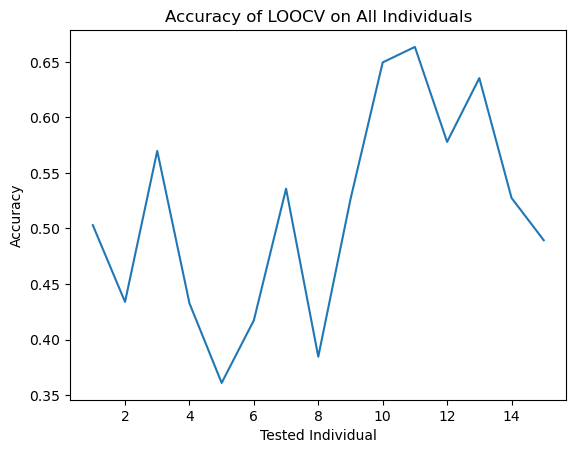

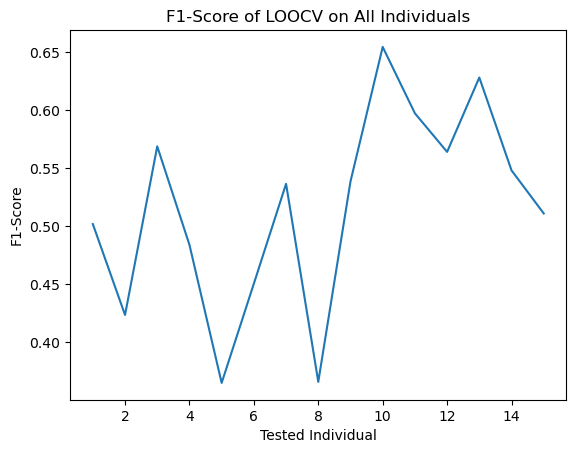

Average Accuracy:  0.5138434260760023
Average F1-Score:  0.5157961928693563


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## umap
## 0: all seperate classes

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0])]
    data.loc[data['activity'].isin([2]), 'activity'] = 1
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

umap_reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3)
X_umap = umap_reducer.fit_transform(scaled_data)

tsne_df = pd.DataFrame(data=X_umap, columns=[f'UMAP{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = f1_score(testingActivity, knn.predict(testingFeatures), average='macro')
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Baseline", "Stairs", "Soccer", "Cycling", "Walking", "Lunch", "Working", "Driving"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Baseline", "Stairs", "Soccer", "Cycling", "Walking", "Lunch", "Working", "Driving"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, f1_score(testingActivity, y_pred, average='macro'))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


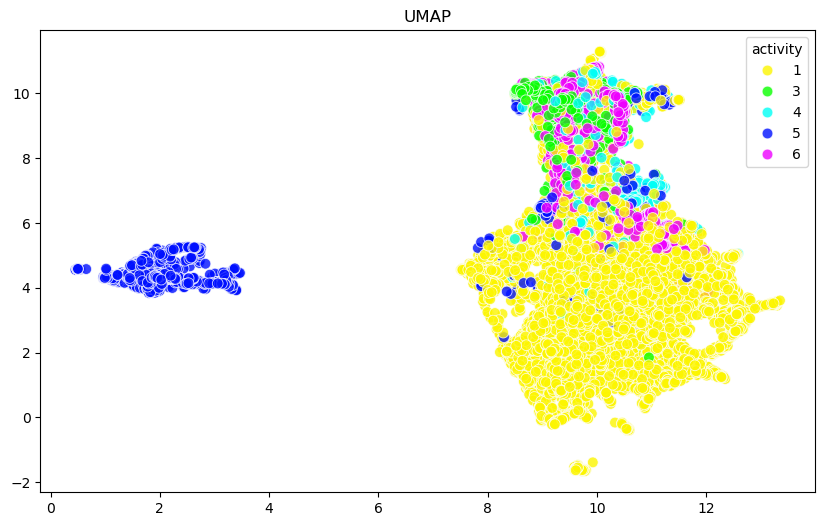

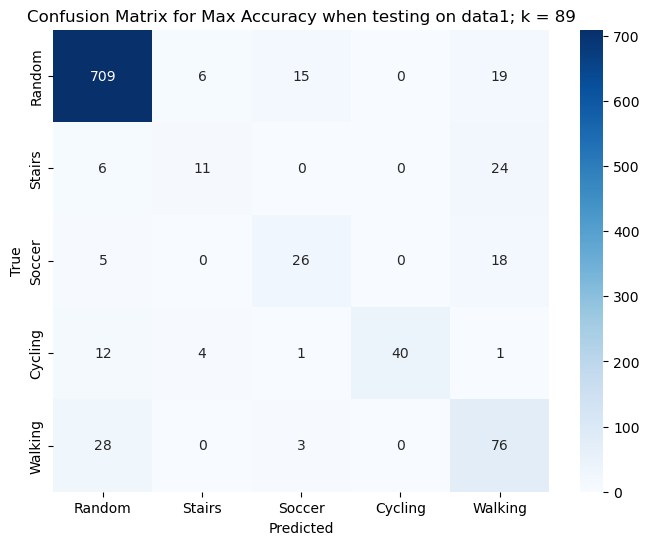

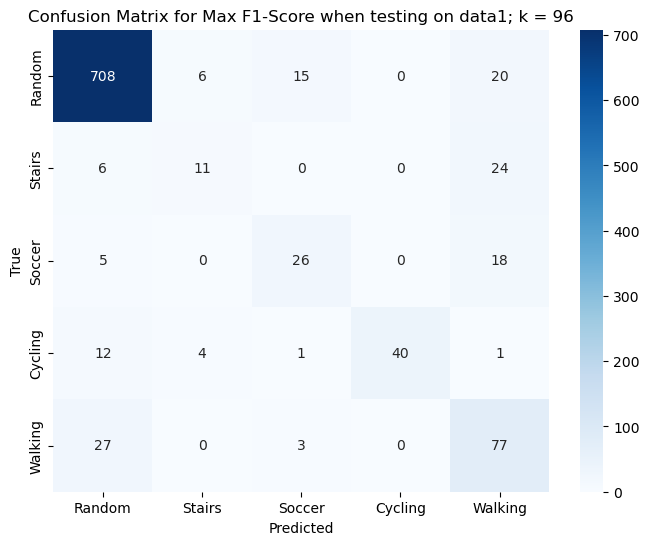

data1 has been tested on everyone


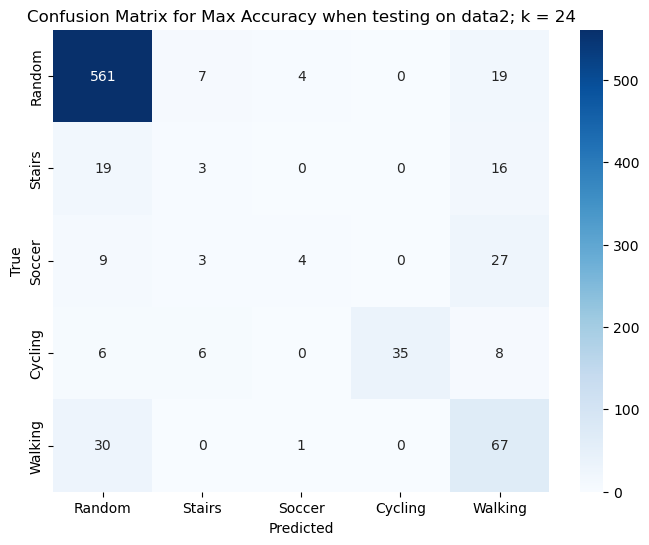

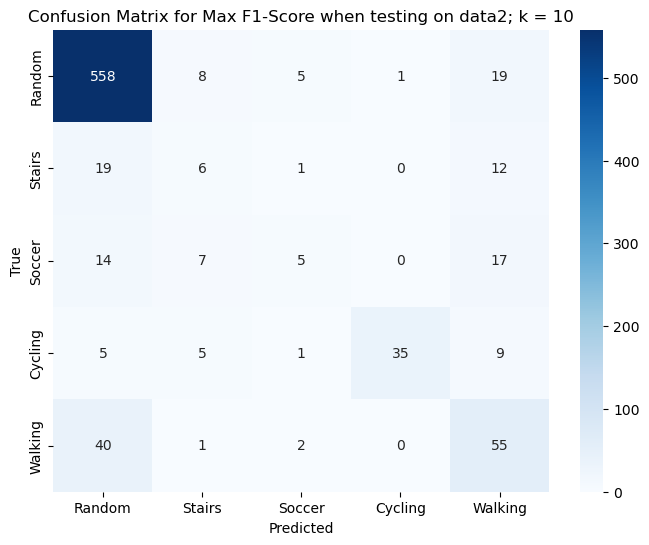

data2 has been tested on everyone


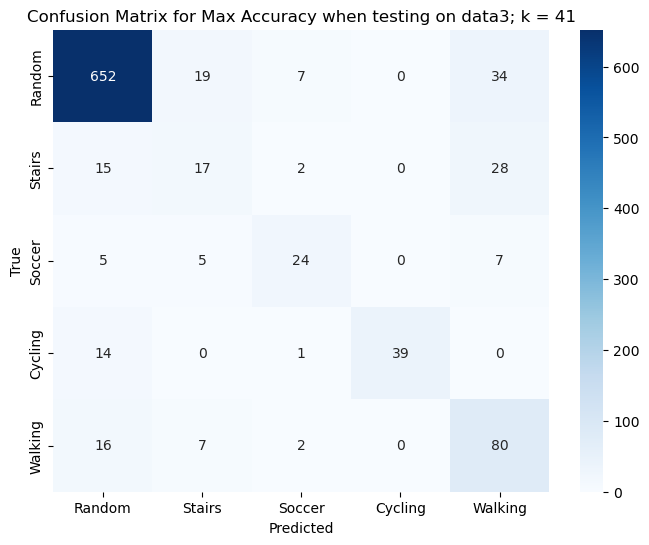

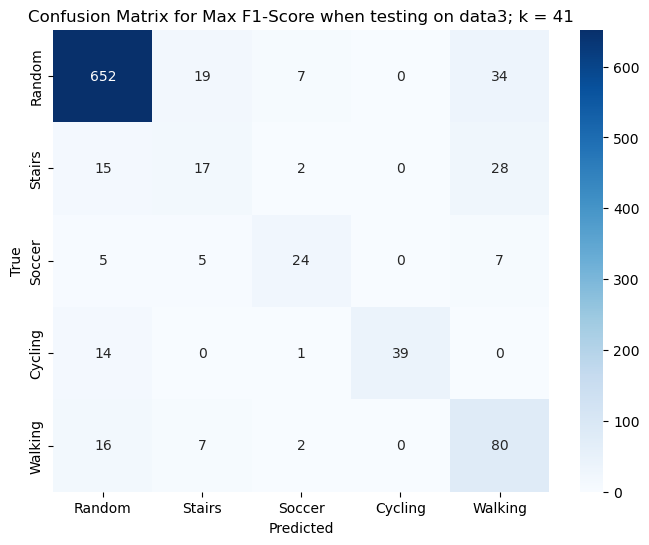

data3 has been tested on everyone


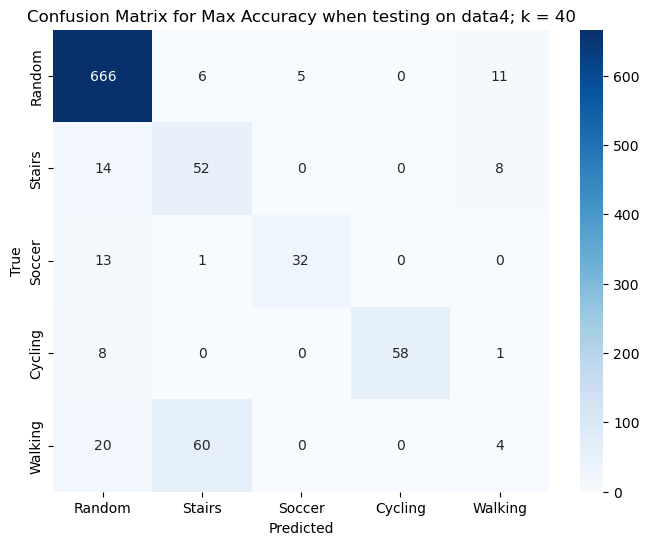

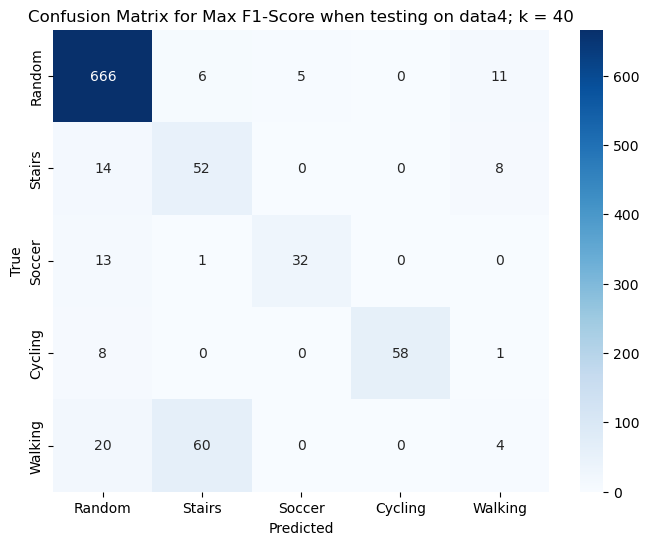

data4 has been tested on everyone


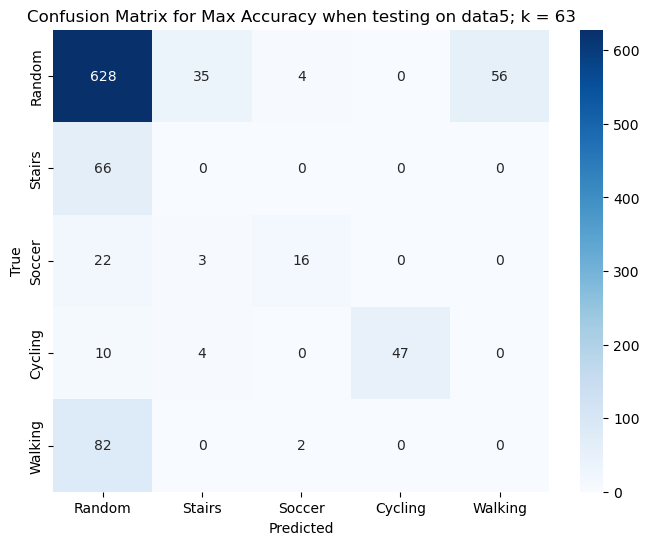

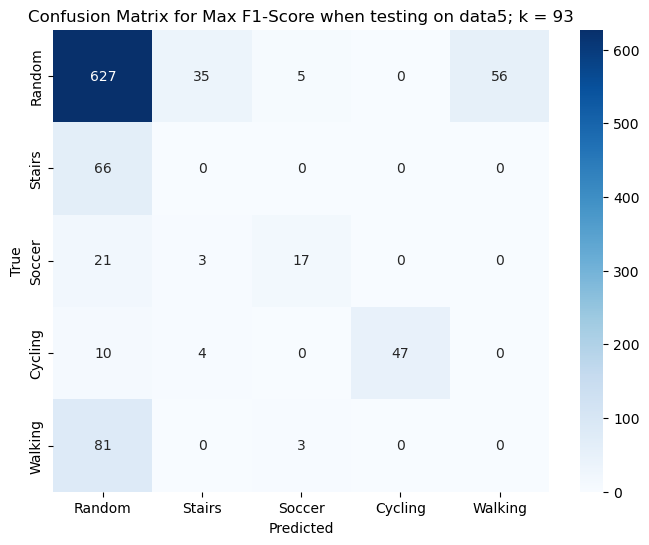

data5 has been tested on everyone


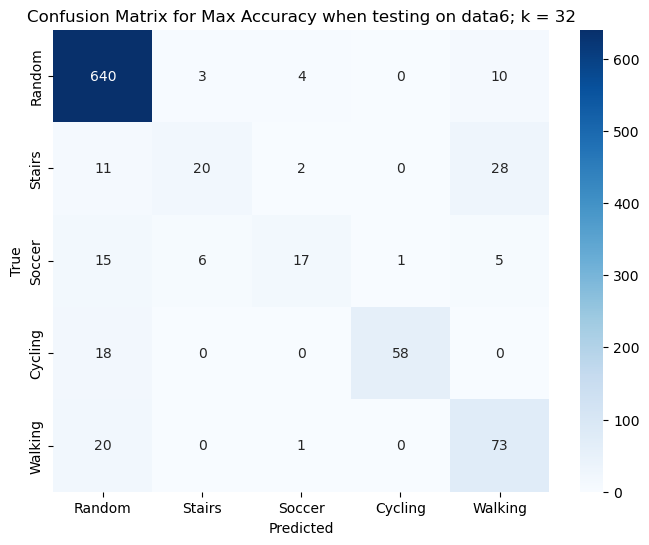

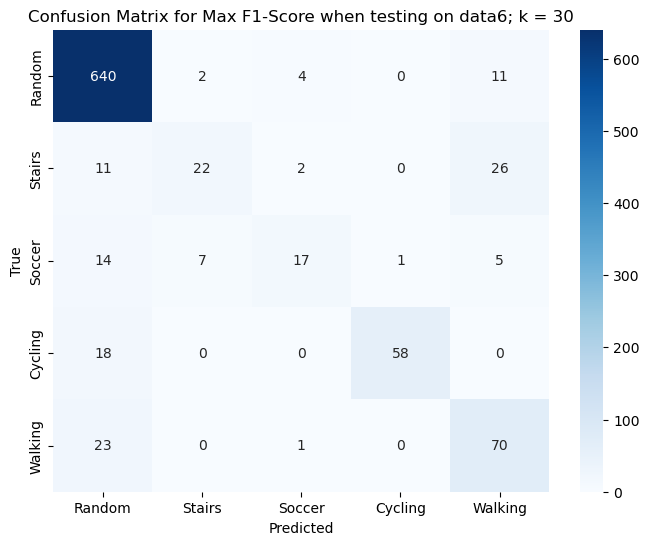

data6 has been tested on everyone


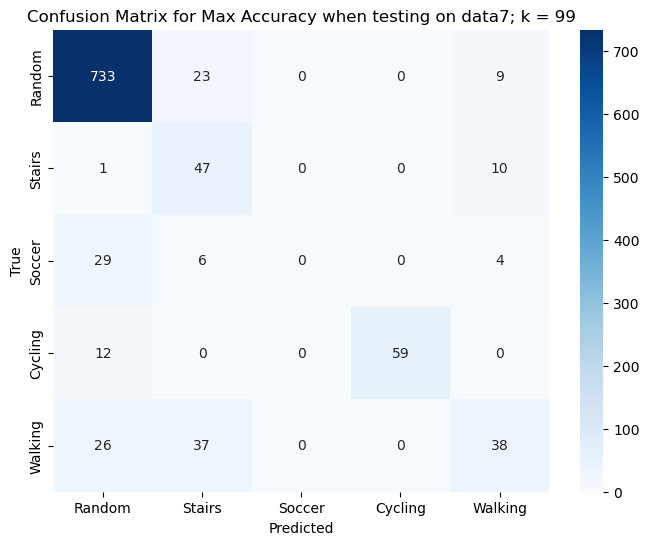

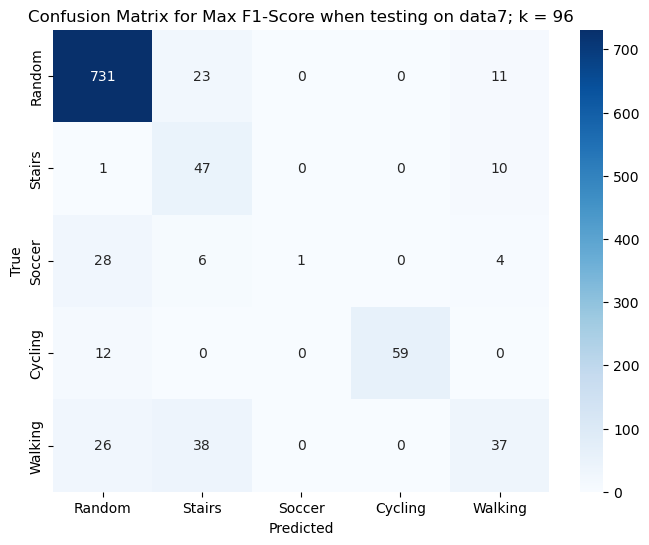

data7 has been tested on everyone


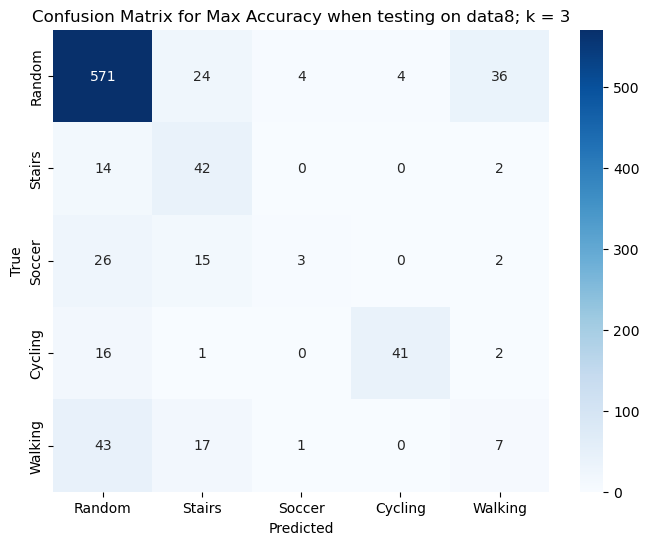

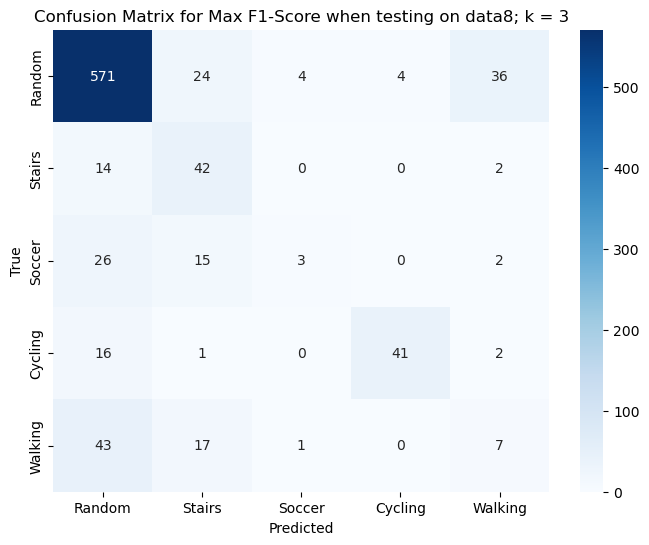

data8 has been tested on everyone


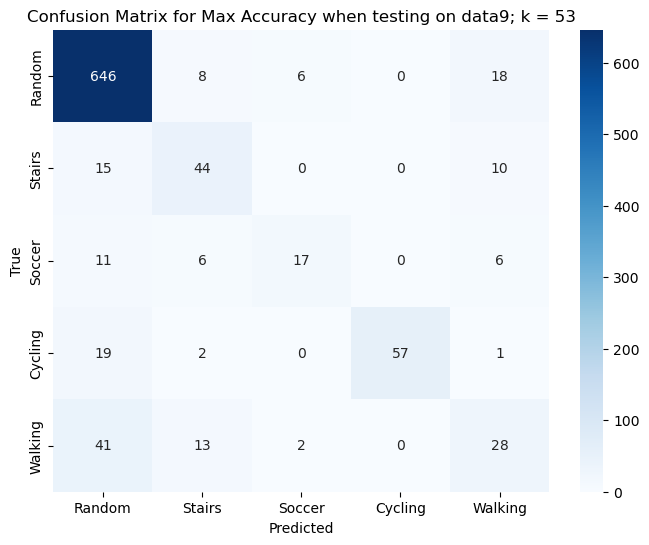

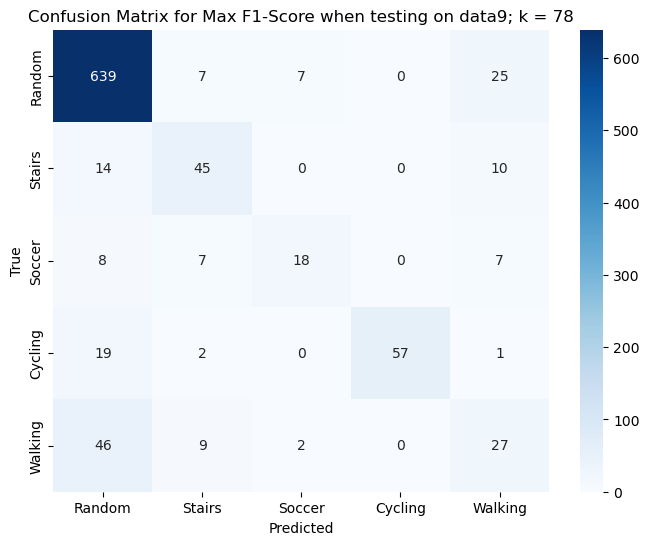

data9 has been tested on everyone


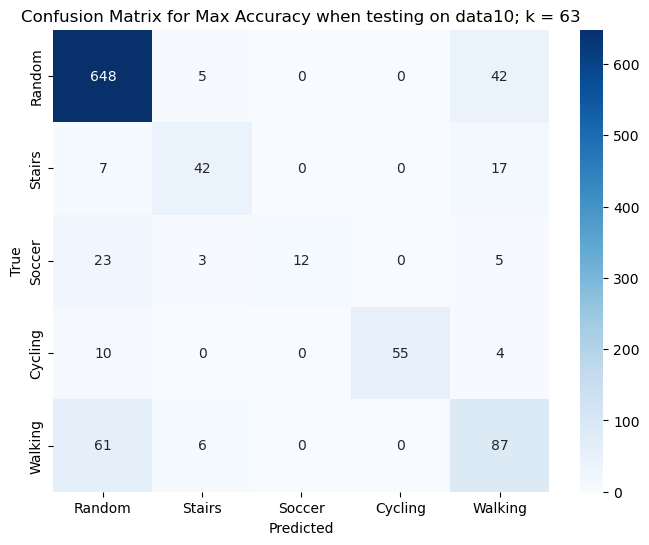

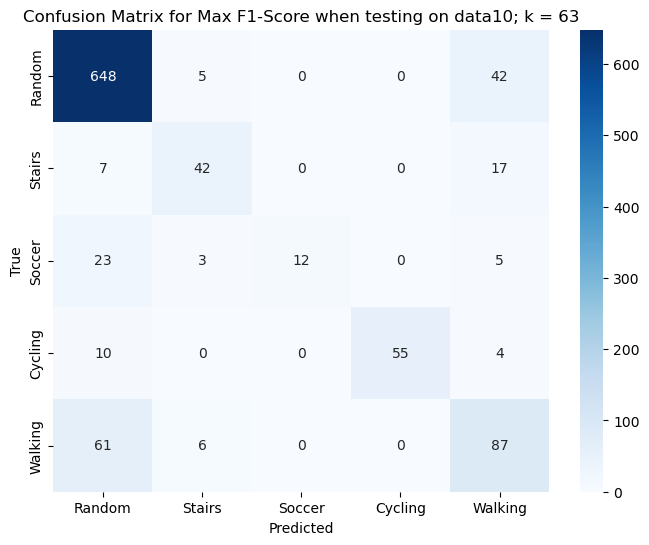

data10 has been tested on everyone


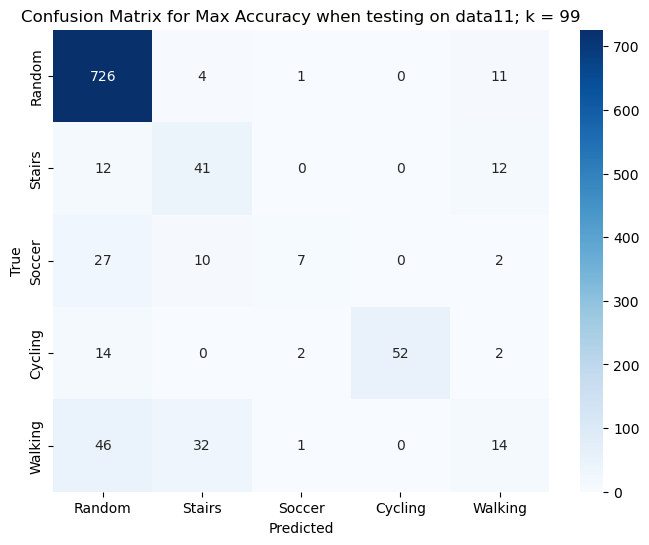

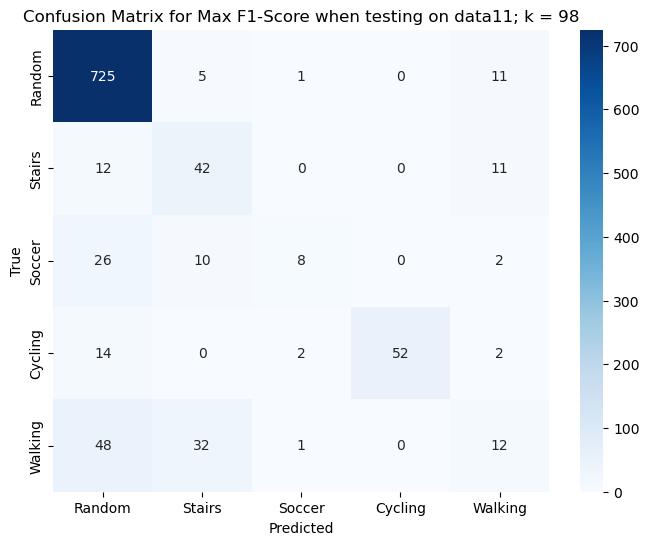

data11 has been tested on everyone


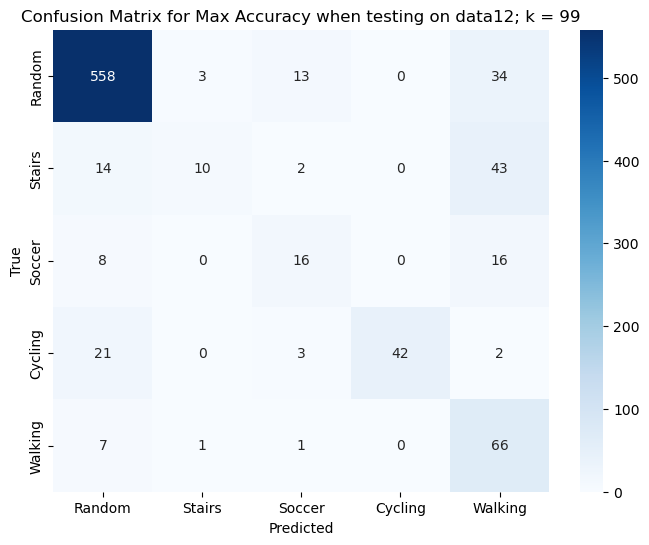

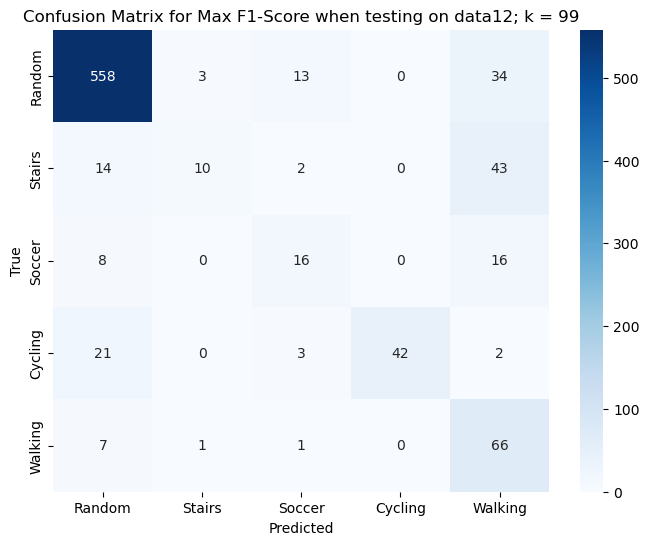

data12 has been tested on everyone


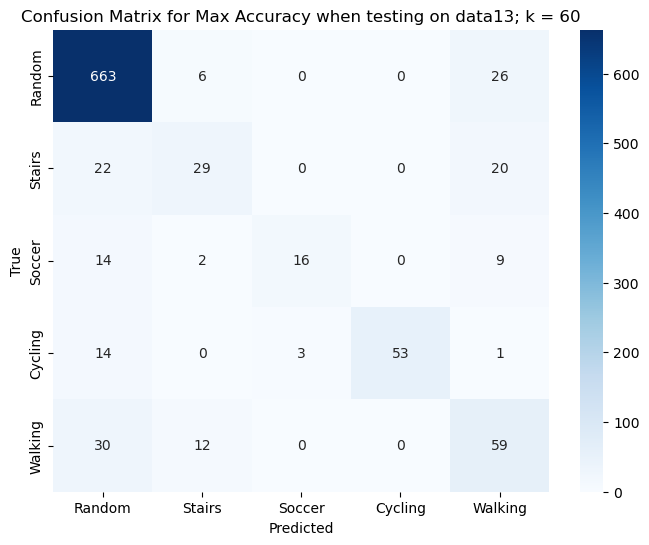

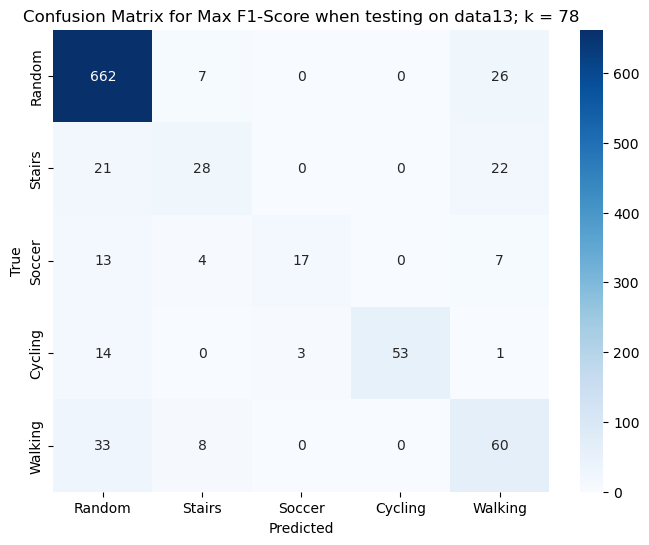

data13 has been tested on everyone


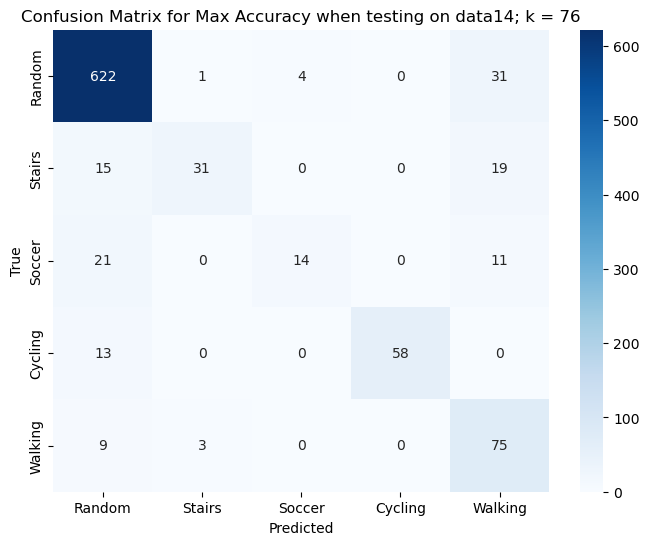

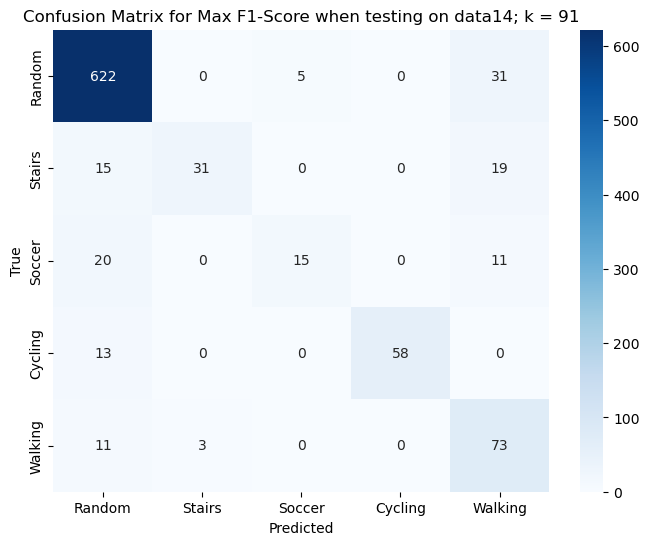

data14 has been tested on everyone


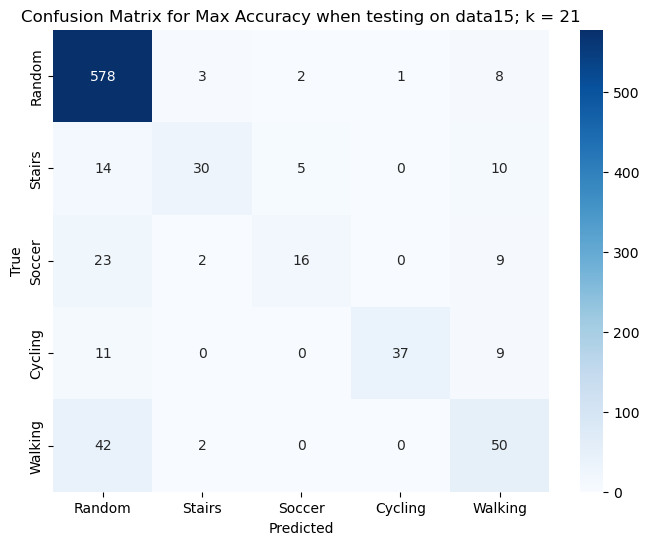

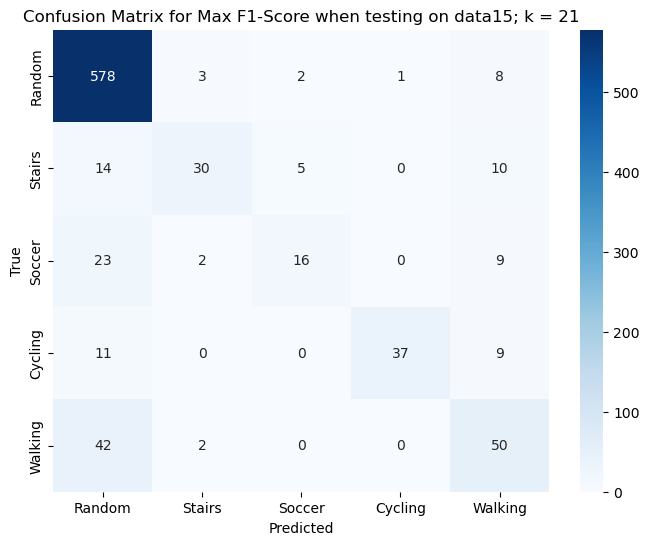

data15 has been tested on everyone


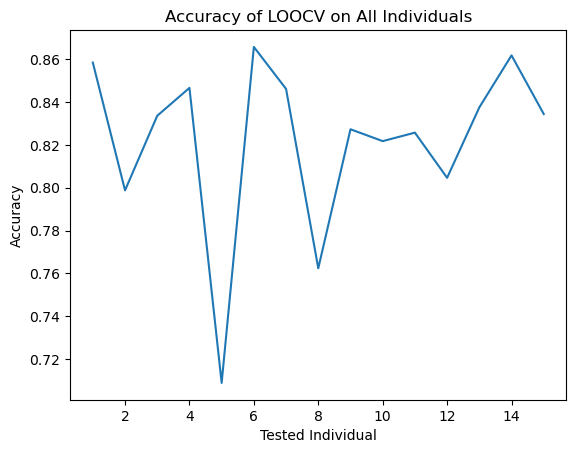

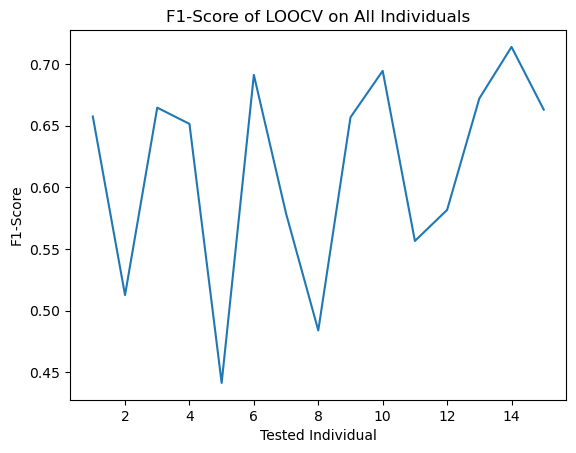

Average Accuracy:  0.8223031559222118
Average F1-Score:  0.6146492921258748


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## umap
## 0: baseline + misc
## 1: seperate ativity classes
def plot_clusters(X, y, title):
    plt.figure(figsize=(10, 6))
    palette = sns.color_palette("hsv", len(np.unique(y)))
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=y, legend='full', palette=palette, s=60, alpha=0.8)
    plt.title(title)
    plt.show()

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0])]
    data.loc[data['activity'].isin([2, 7, 8, 9]), 'activity'] = 1
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

umap_reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3)
X_umap = umap_reducer.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_umap, columns=[f'UMAP{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

plot_clusters(X_umap, tsne_df['activity'], "UMAP")

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = f1_score(testingActivity, knn.predict(testingFeatures), average='macro')
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Stairs", "Soccer", "Cycling", "Walking"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Stairs", "Soccer", "Cycling", "Walking"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, f1_score(testingActivity, y_pred, average='macro'))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


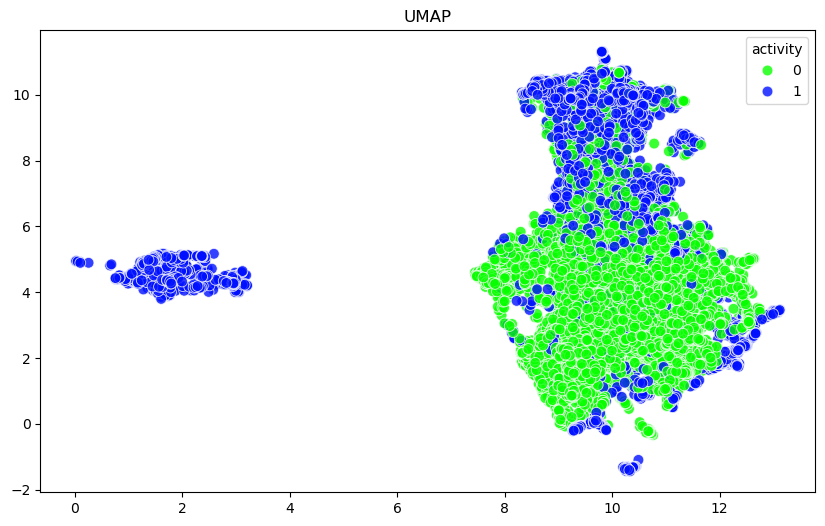

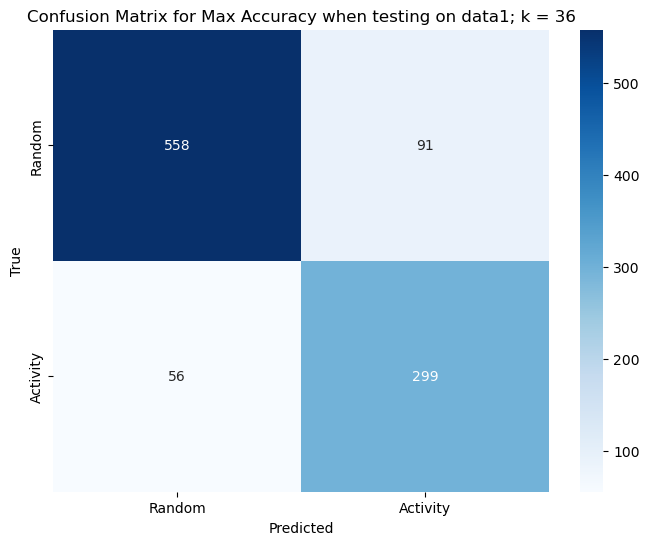

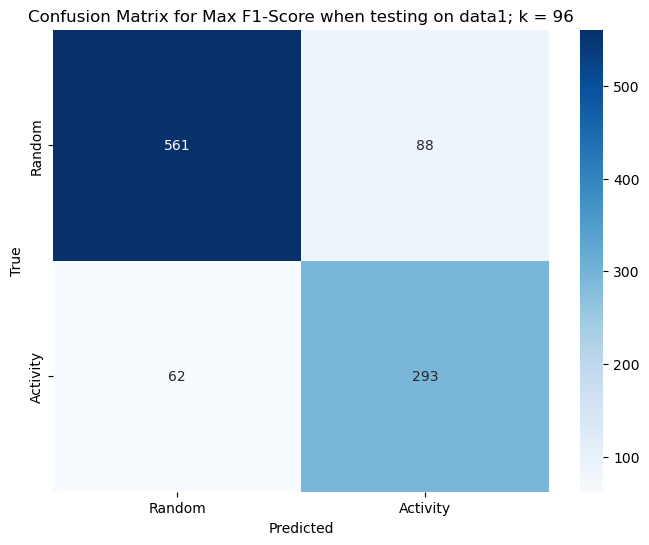

data1 has been tested on everyone


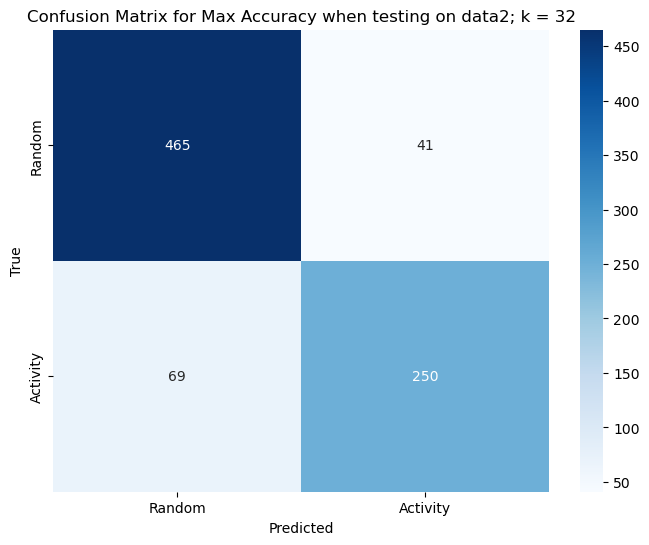

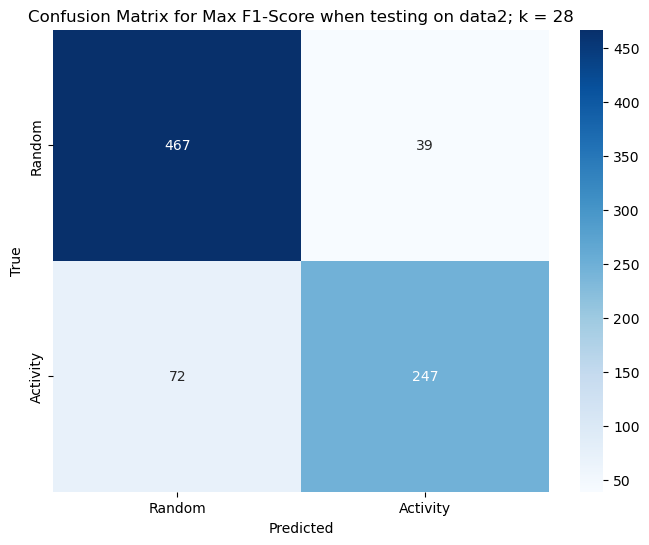

data2 has been tested on everyone


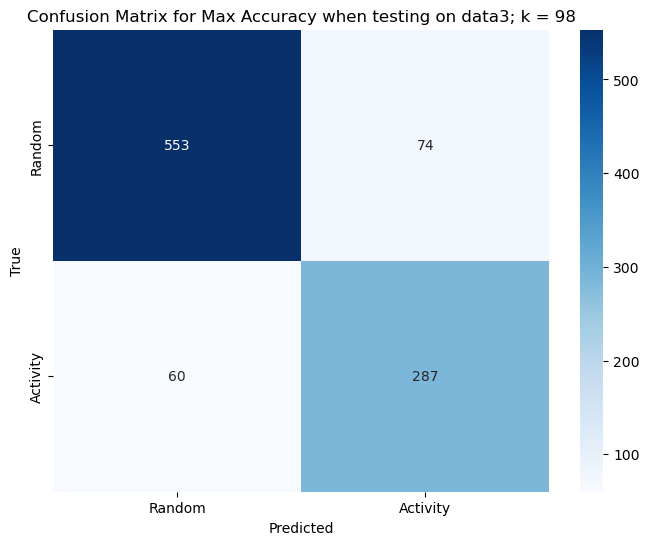

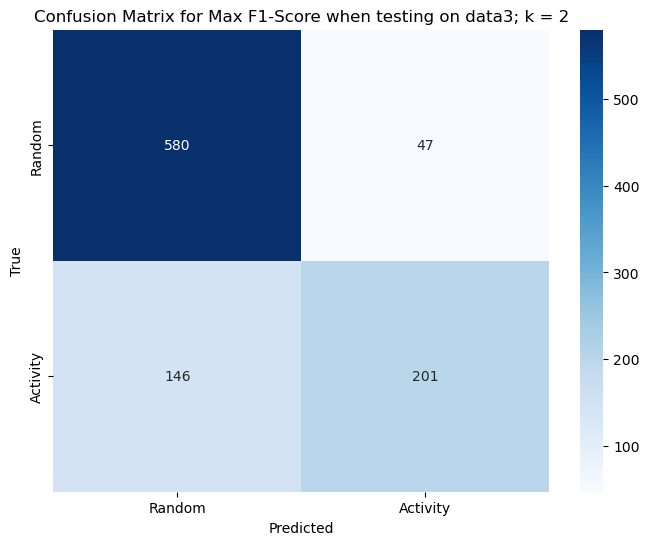

data3 has been tested on everyone


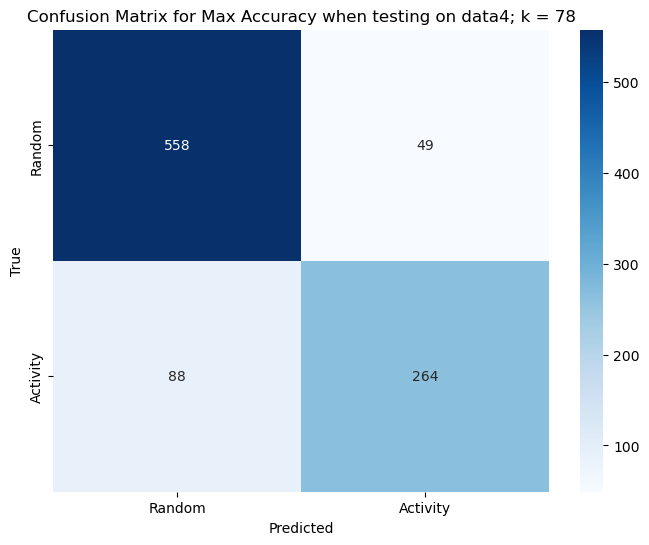

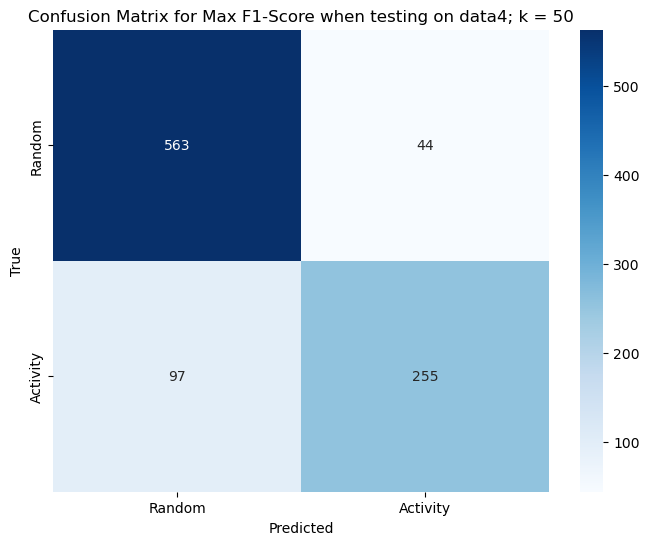

data4 has been tested on everyone


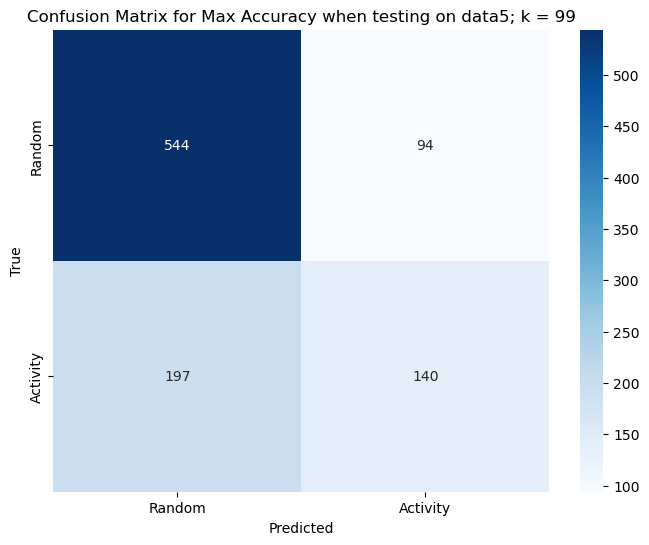

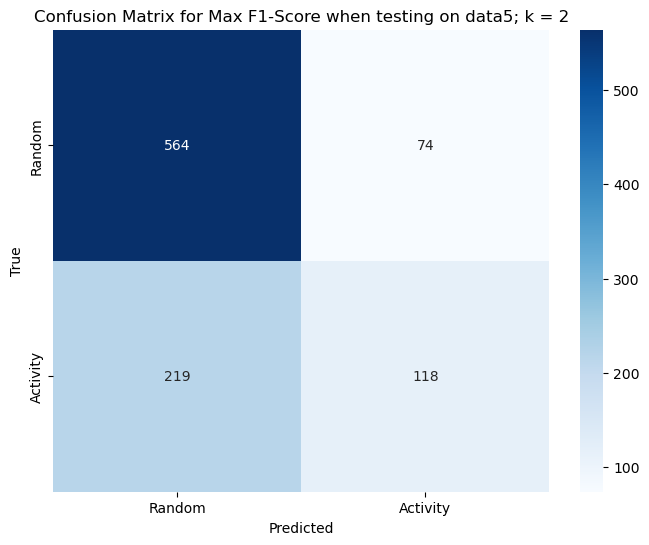

data5 has been tested on everyone


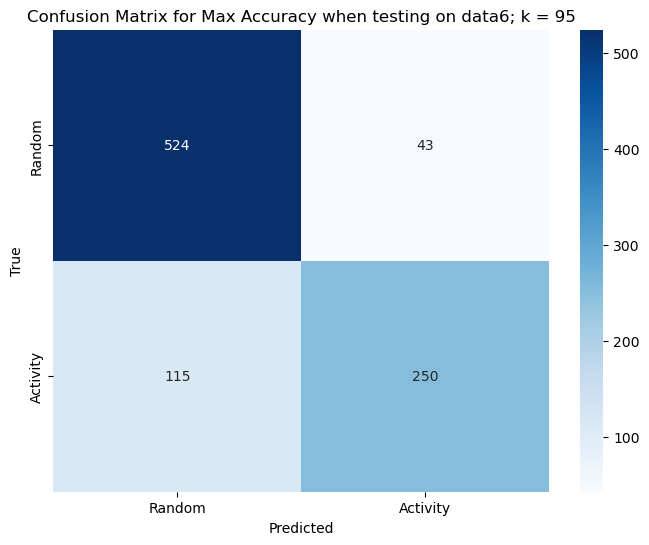

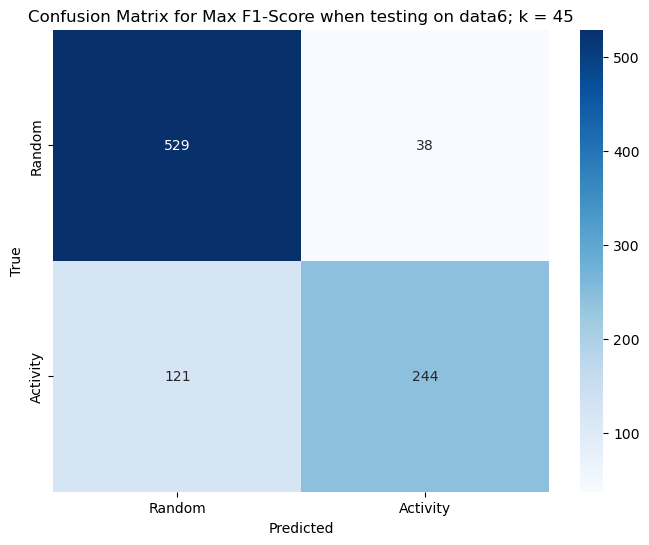

data6 has been tested on everyone


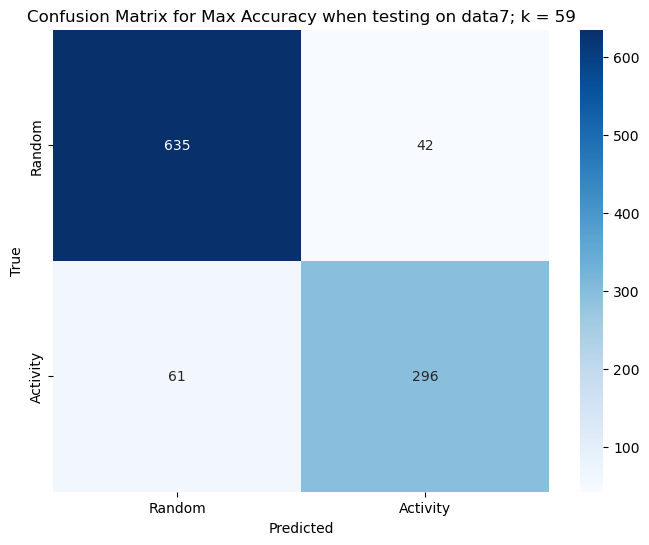

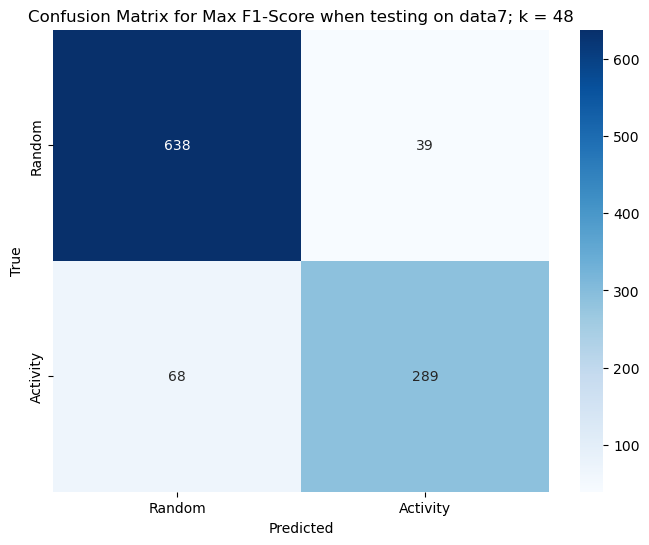

data7 has been tested on everyone


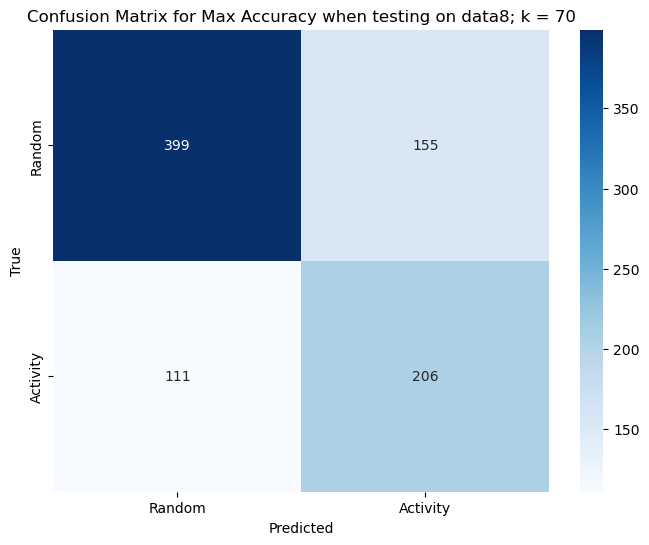

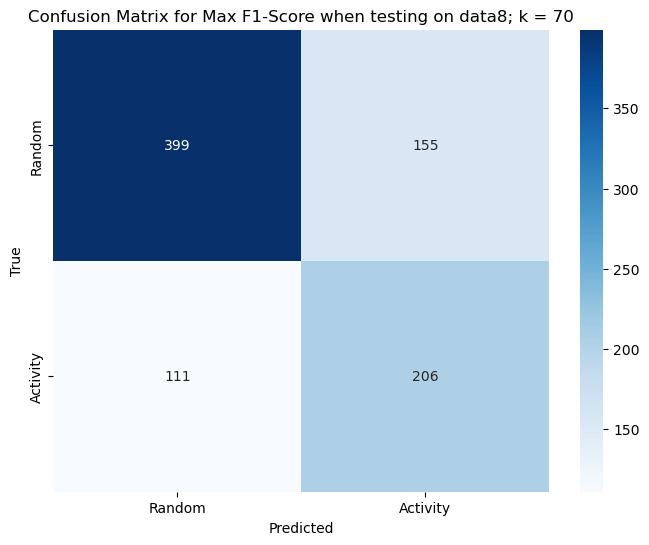

data8 has been tested on everyone


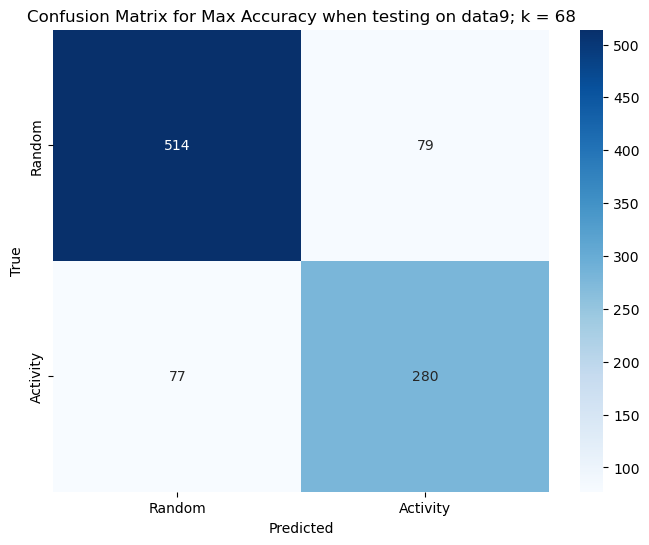

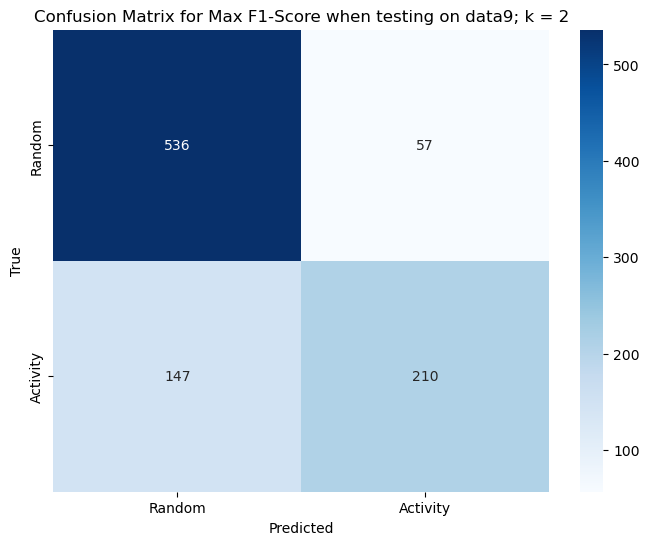

data9 has been tested on everyone


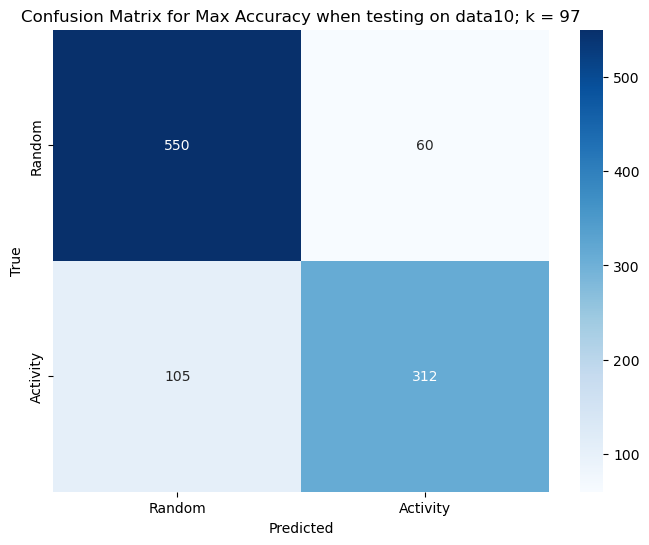

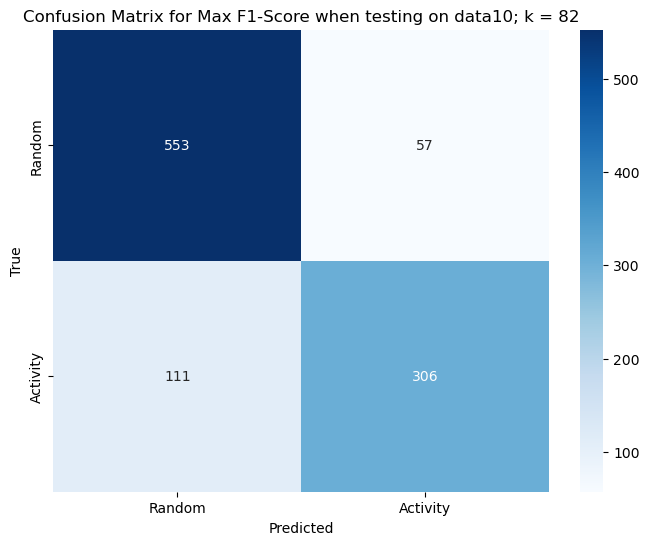

data10 has been tested on everyone


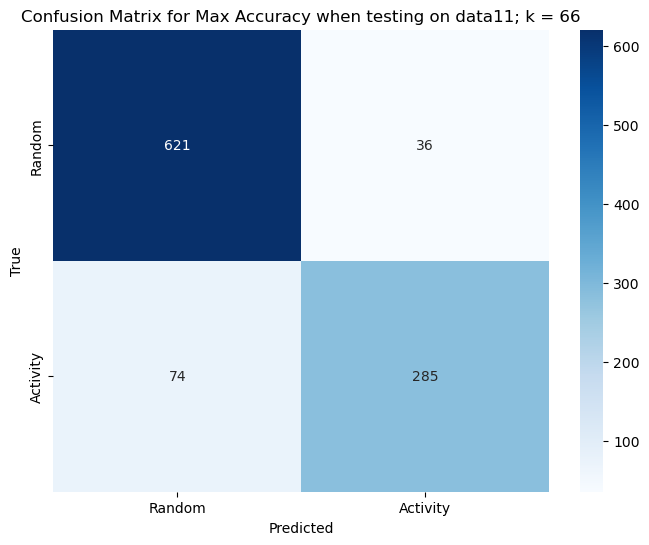

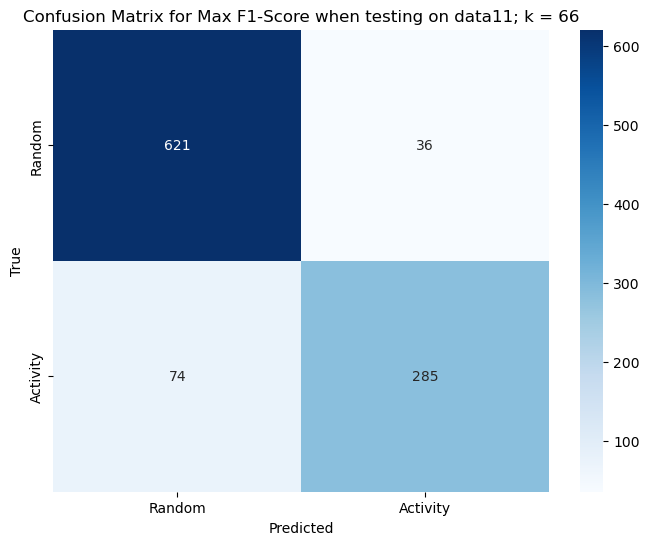

data11 has been tested on everyone


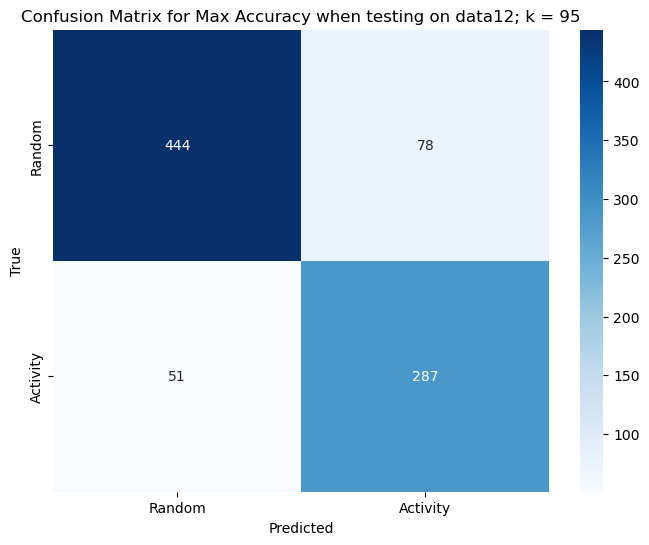

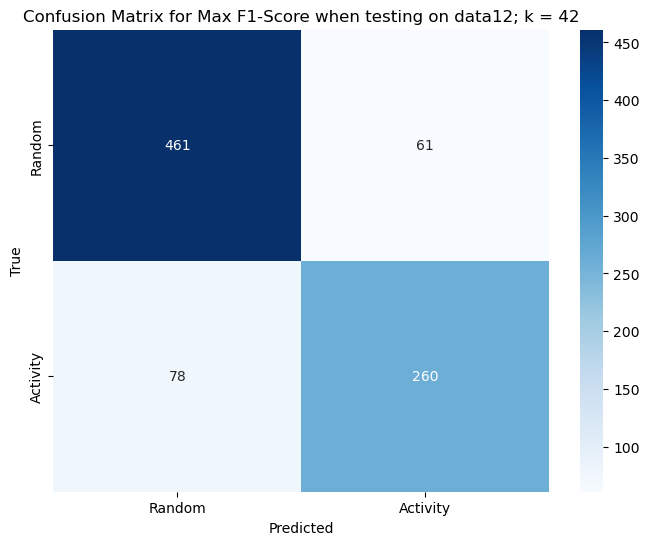

data12 has been tested on everyone


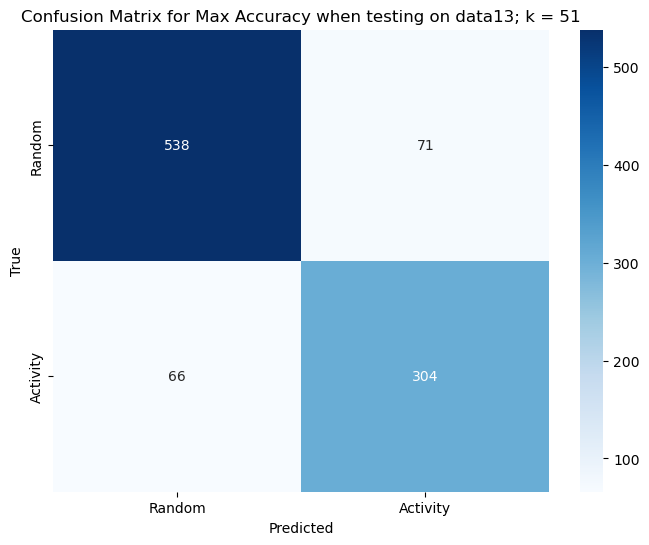

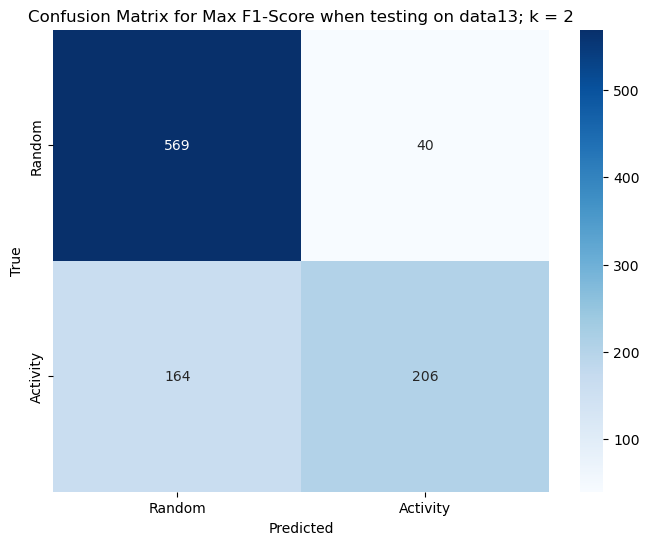

data13 has been tested on everyone


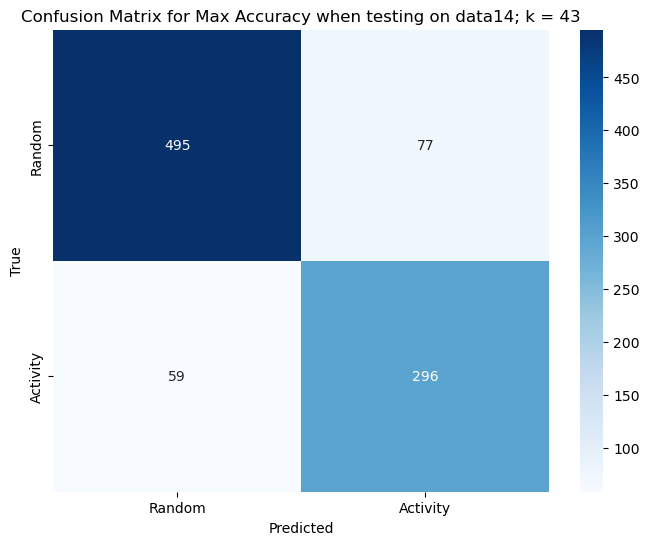

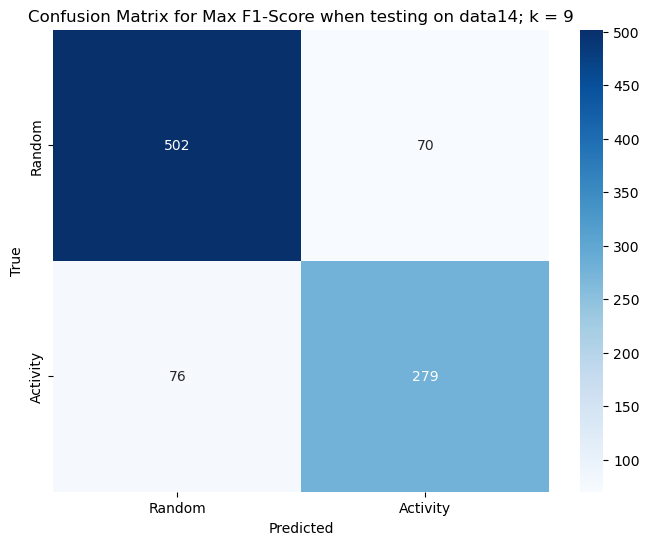

data14 has been tested on everyone


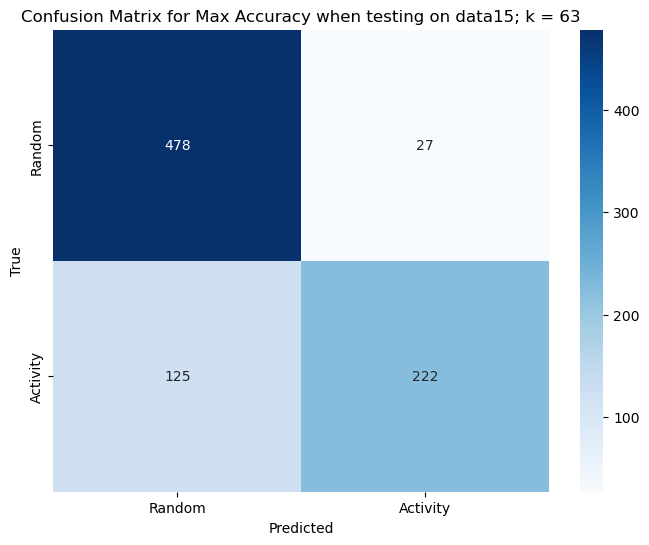

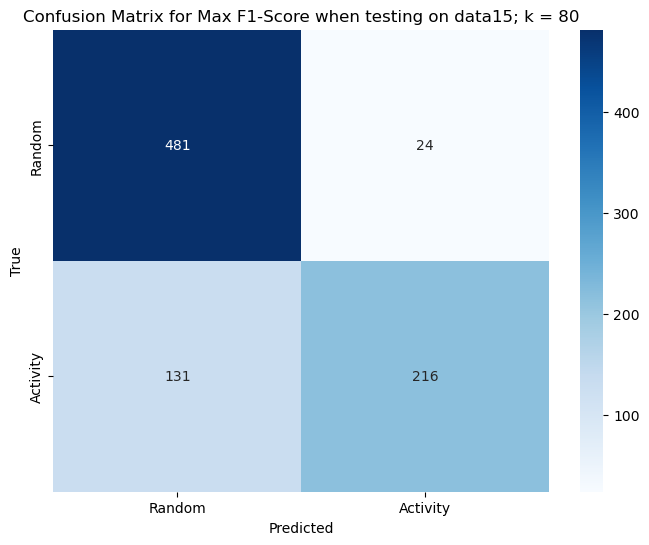

data15 has been tested on everyone


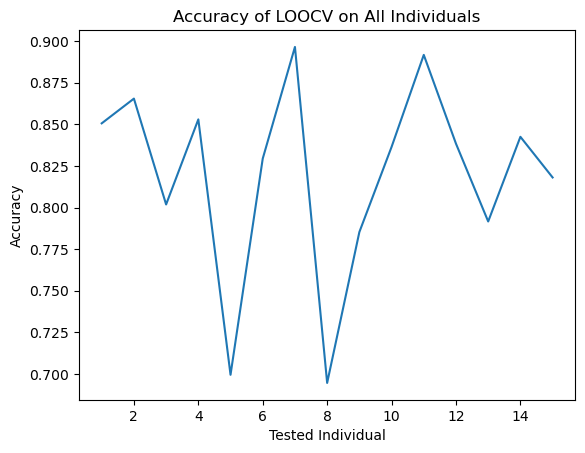

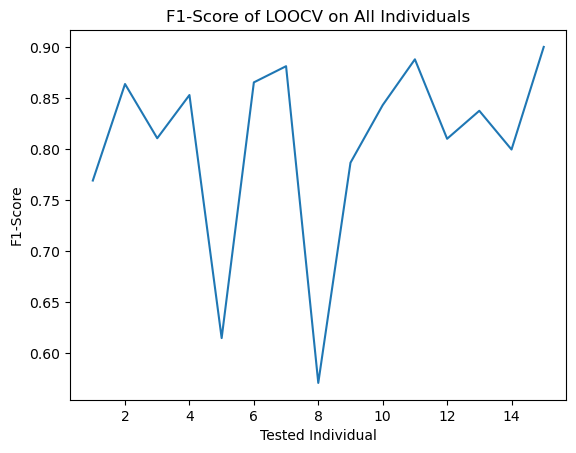

Average Accuracy:  0.8196577901702837
Average F1-Score:  0.8061129892666442


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## umap
## 0: baseline + misc
## 1: activity
def plot_clusters(X, y, title):
    plt.figure(figsize=(10, 6))
    palette = sns.color_palette("hsv", len(np.unique(y)))
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=y, legend='full', palette=palette, s=60, alpha=0.8)
    plt.title(title)
    plt.show()

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0])]
    data.loc[data['activity'].isin([1, 2, 7, 8, 9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 4, 5, 6]), 'activity'] = 1
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

umap_reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3)
X_umap = umap_reducer.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_umap, columns=[f'UMAP{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

plot_clusters(X_umap, tsne_df['activity'], "UMAP")

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = precision_score(testingActivity, knn.predict(testingFeatures))
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, precision_score(testingActivity, y_pred))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


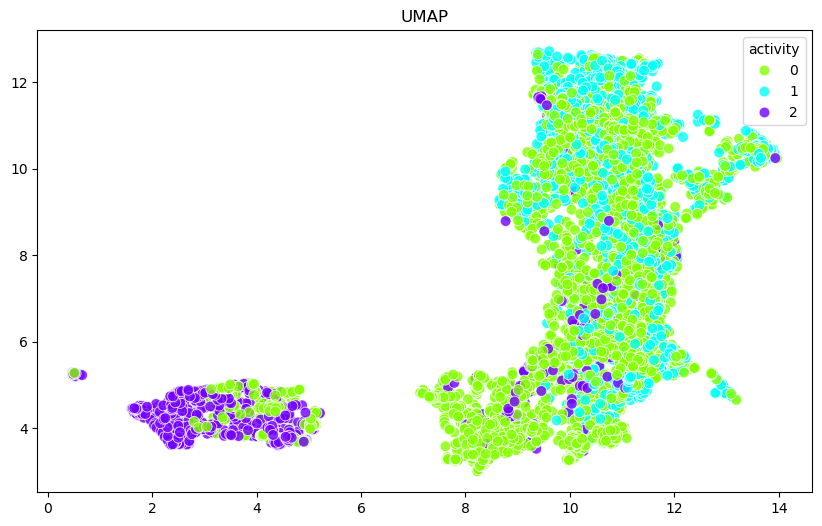

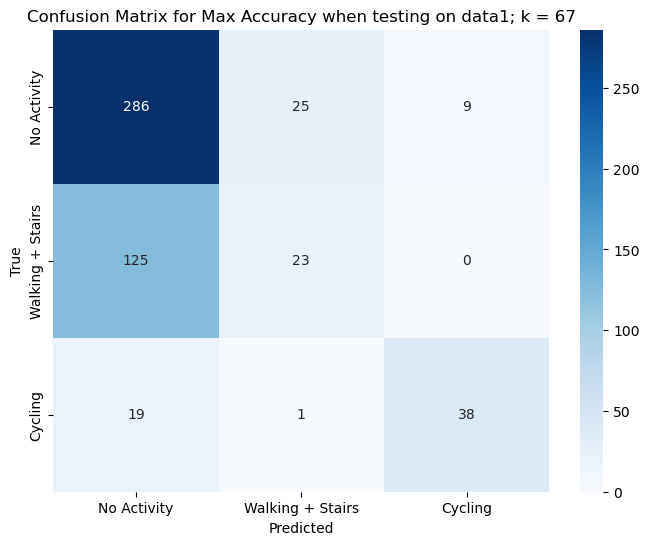

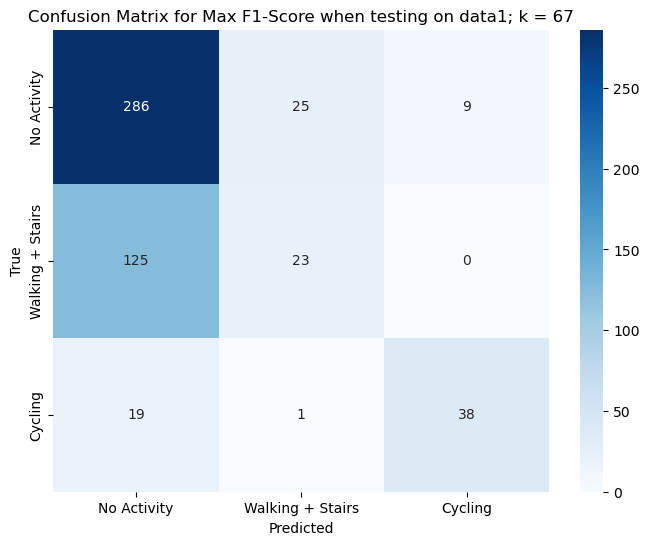

data1 has been tested on everyone


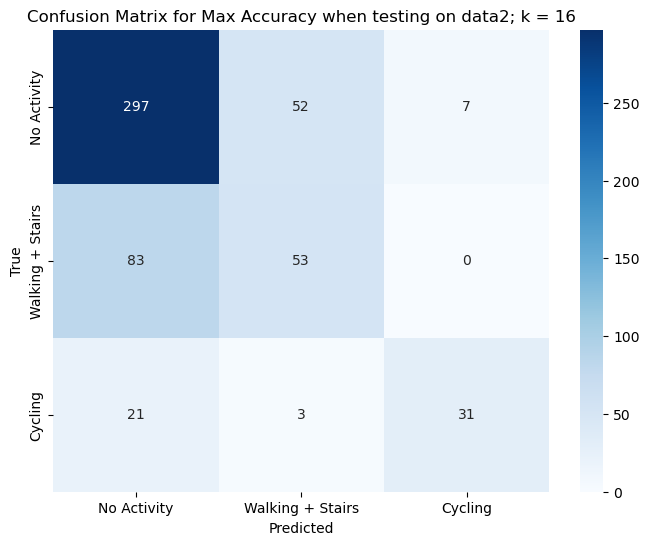

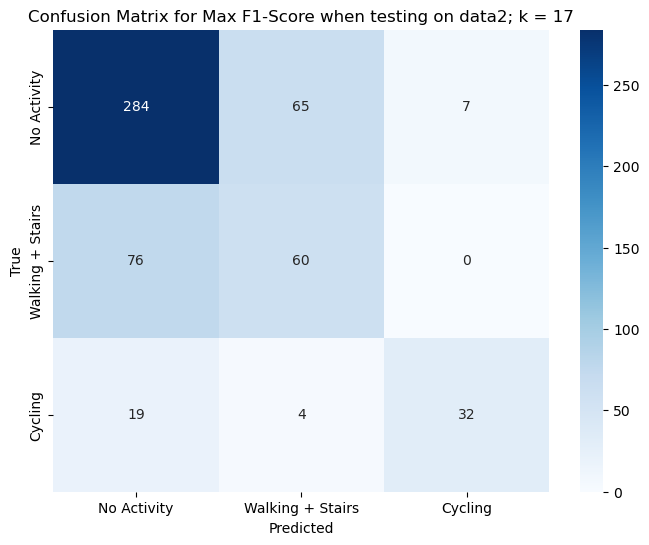

data2 has been tested on everyone


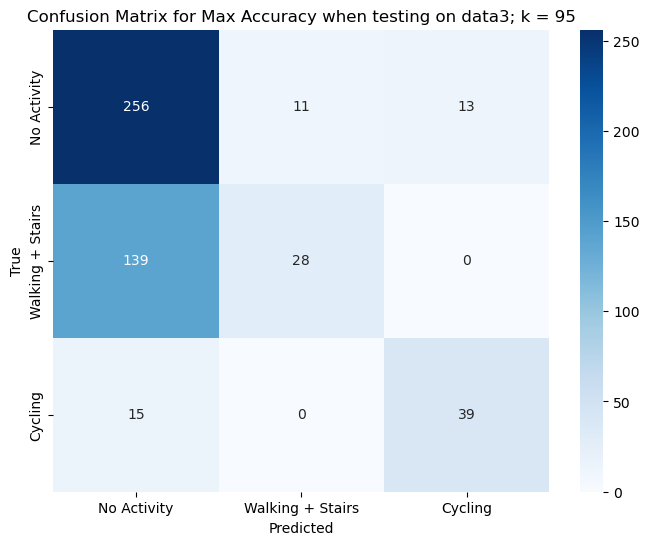

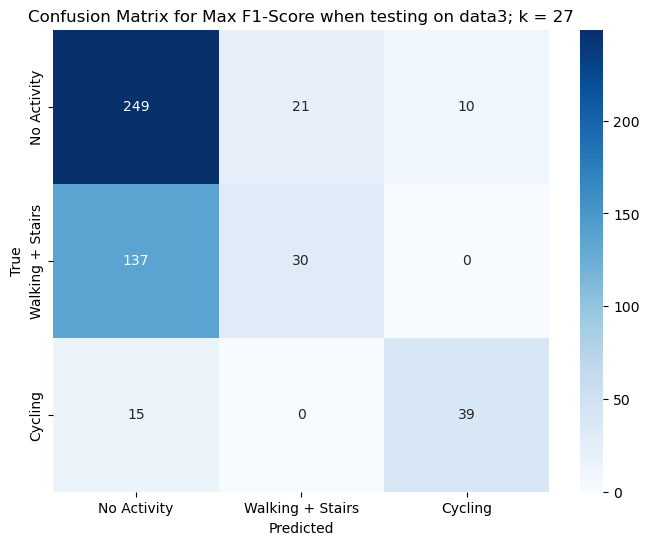

data3 has been tested on everyone


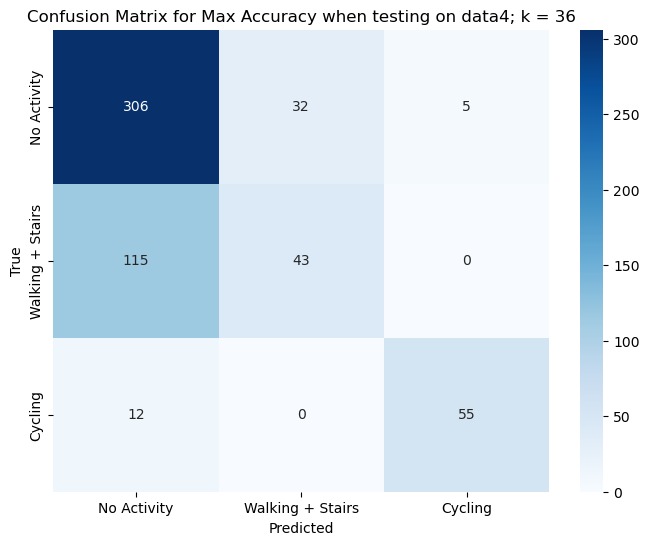

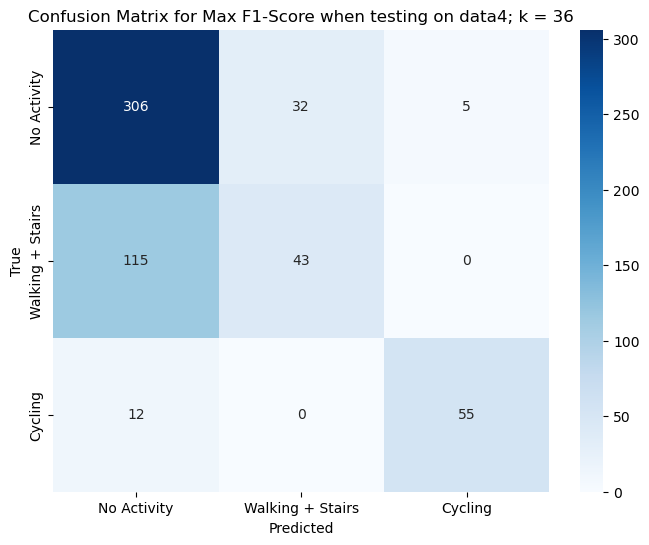

data4 has been tested on everyone


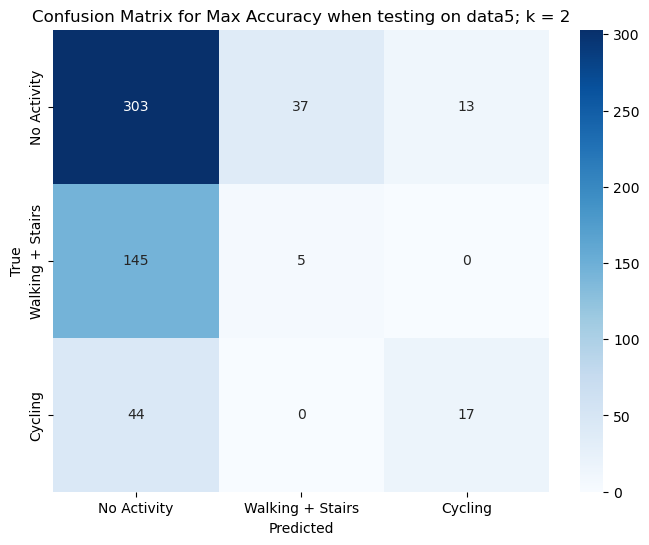

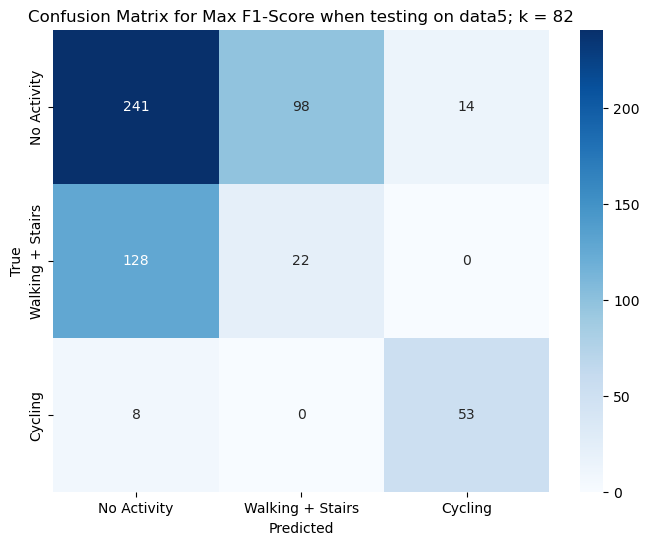

data5 has been tested on everyone


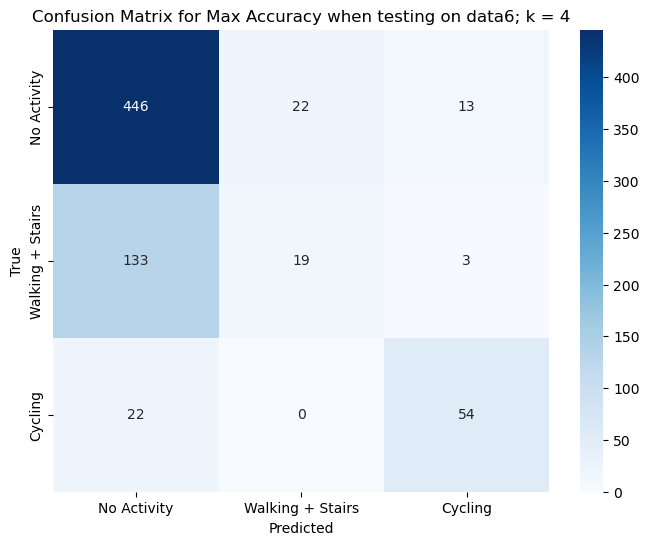

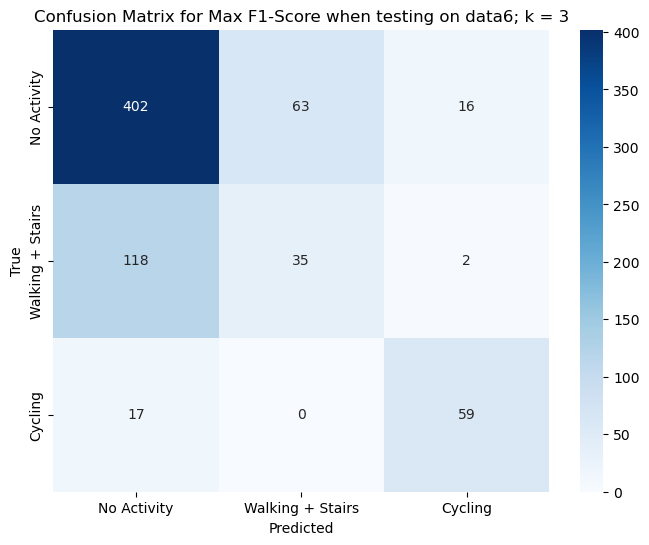

data6 has been tested on everyone


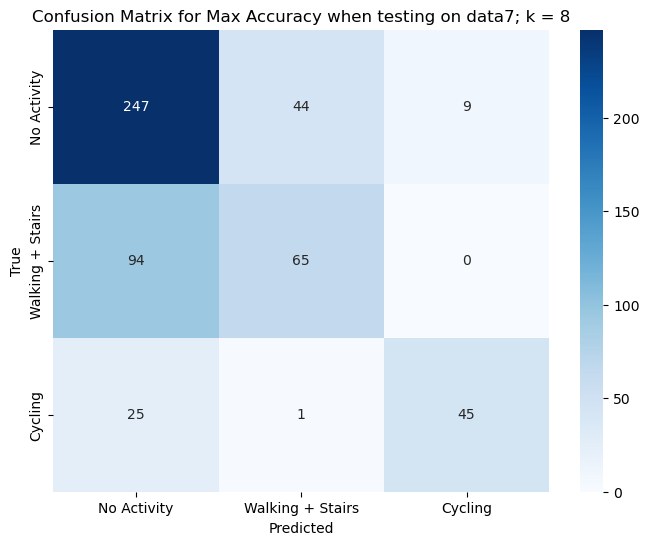

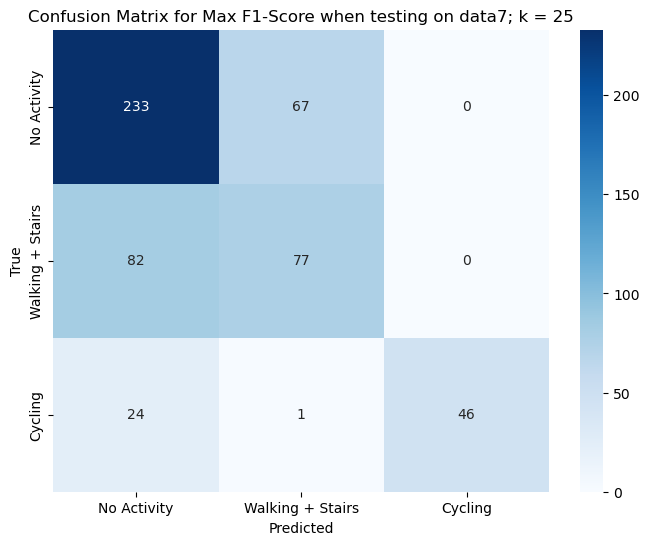

data7 has been tested on everyone


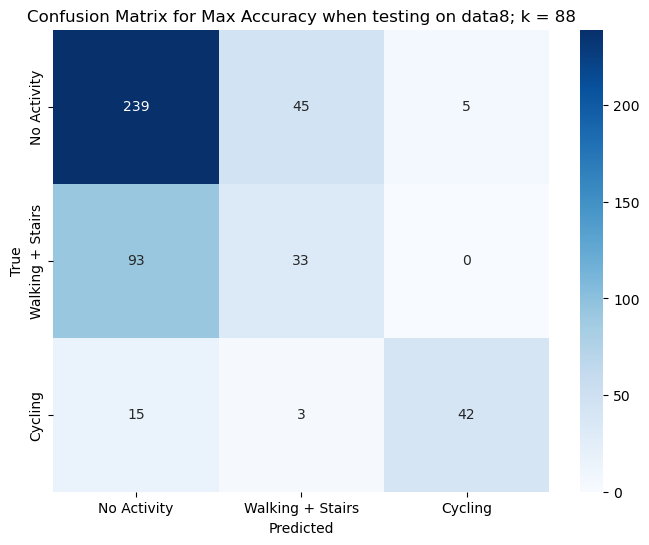

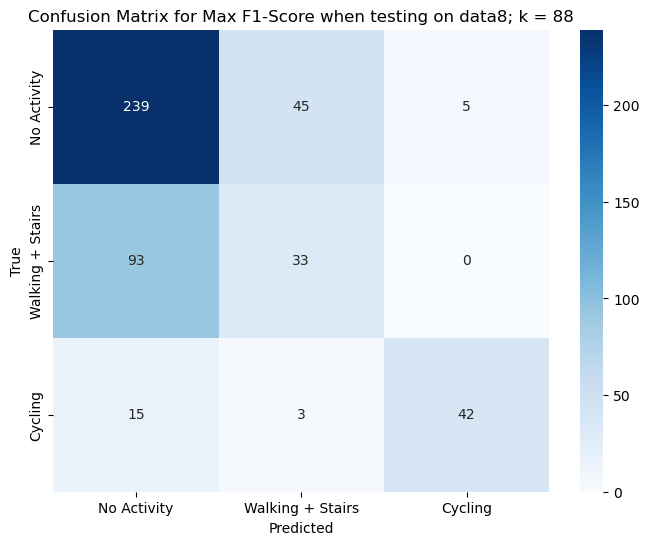

data8 has been tested on everyone


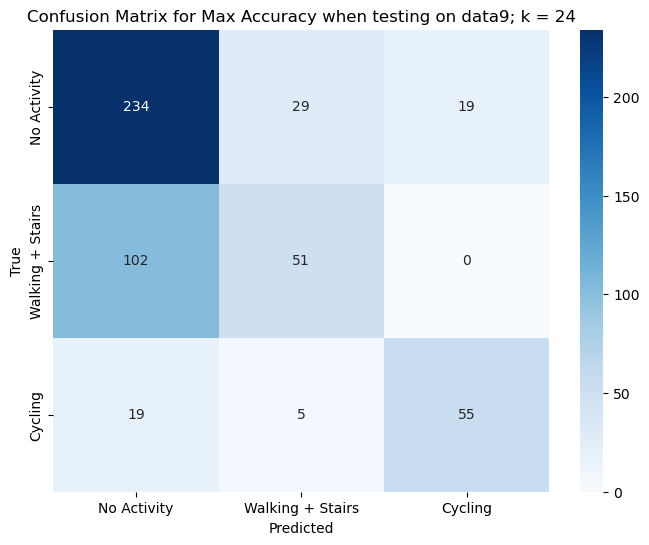

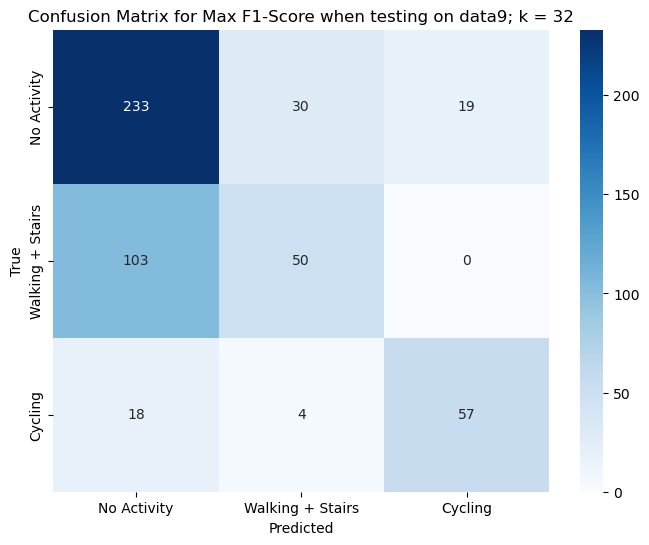

data9 has been tested on everyone


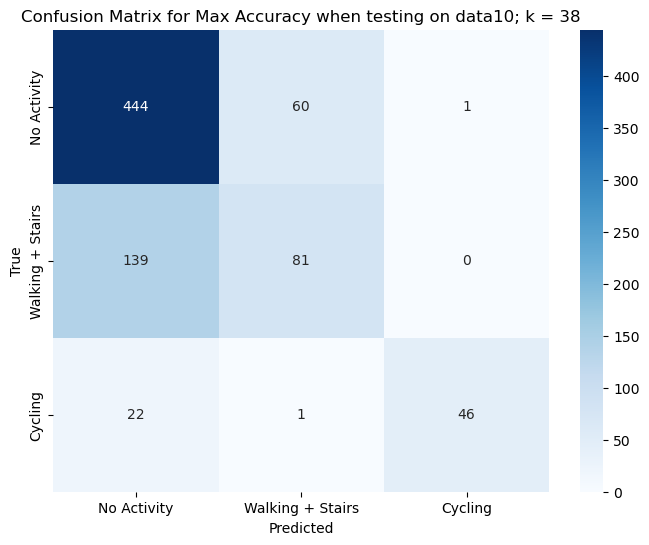

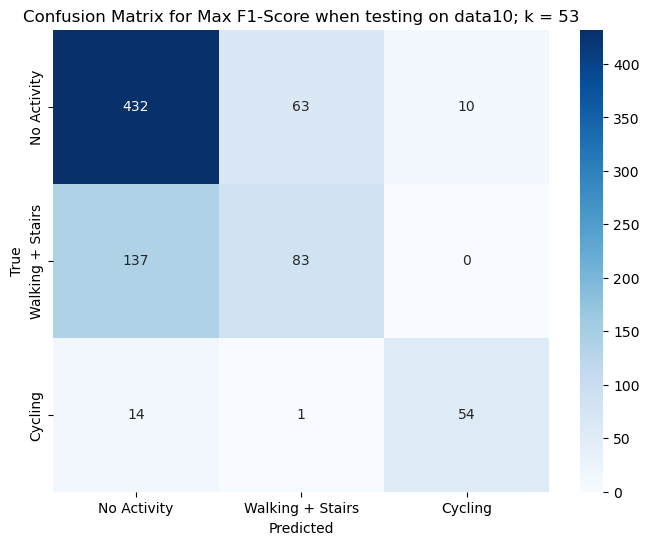

data10 has been tested on everyone


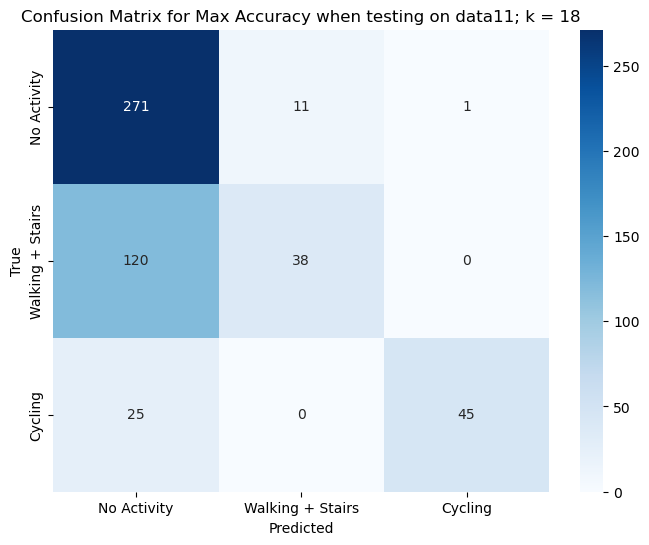

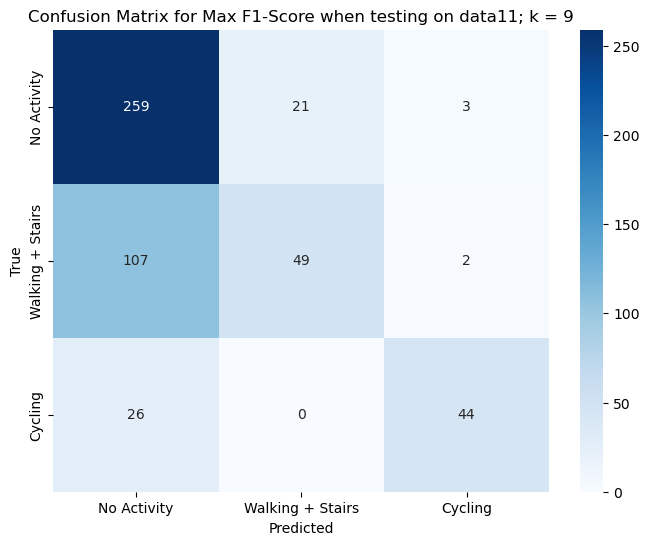

data11 has been tested on everyone


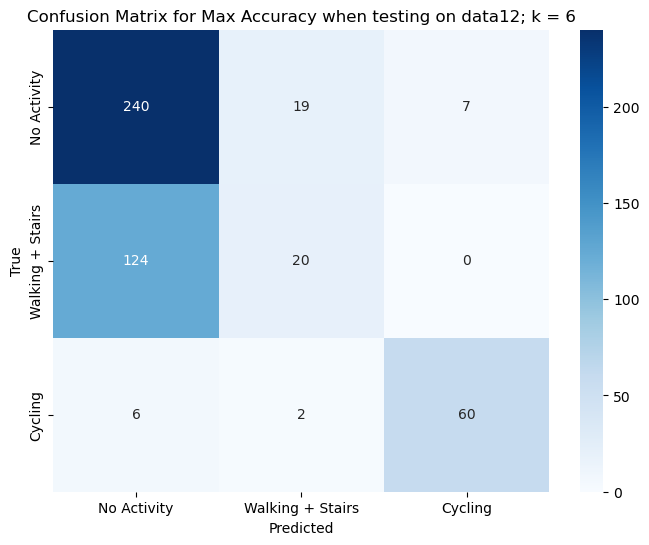

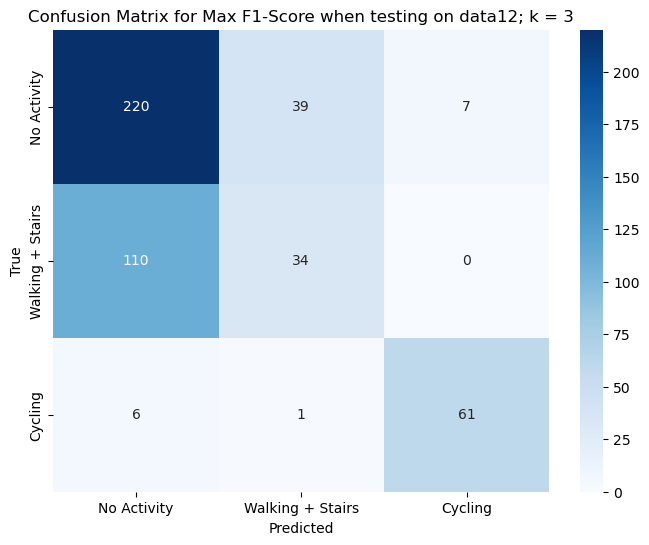

data12 has been tested on everyone


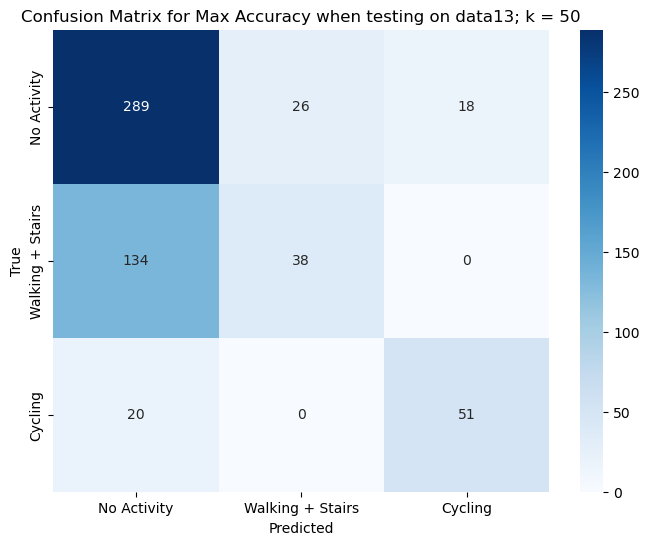

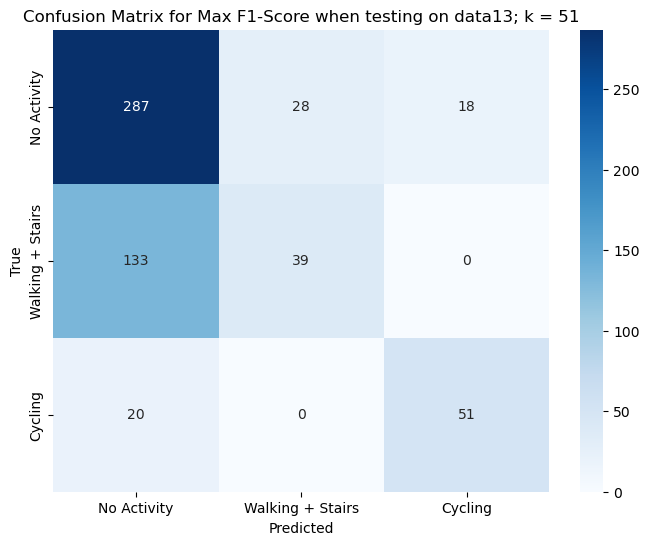

data13 has been tested on everyone


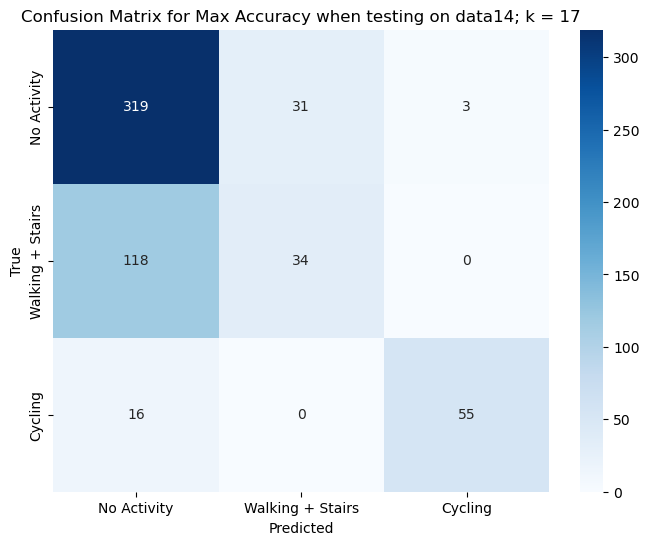

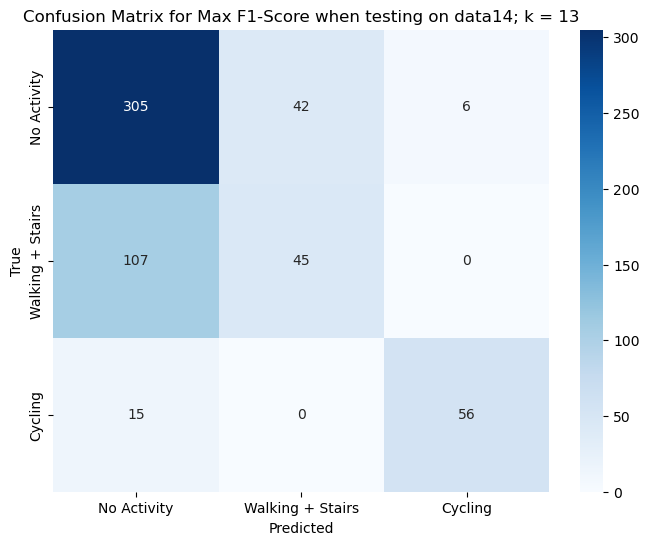

data14 has been tested on everyone


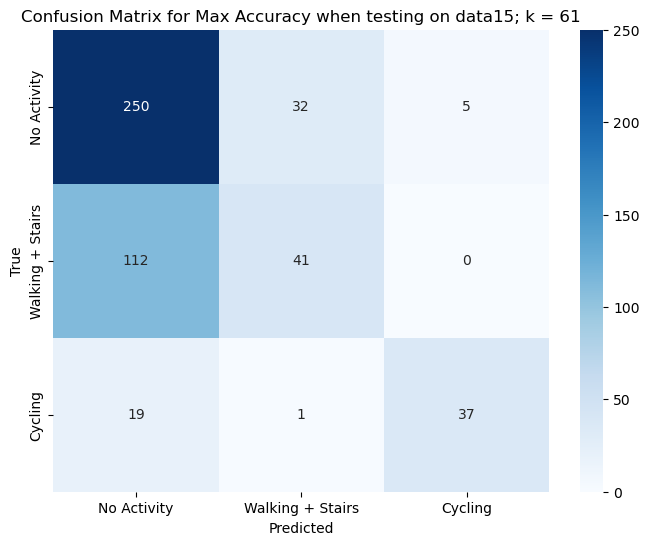

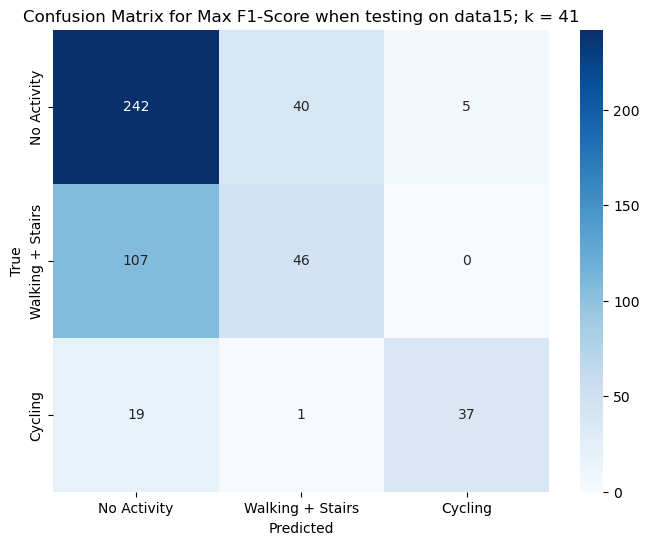

data15 has been tested on everyone


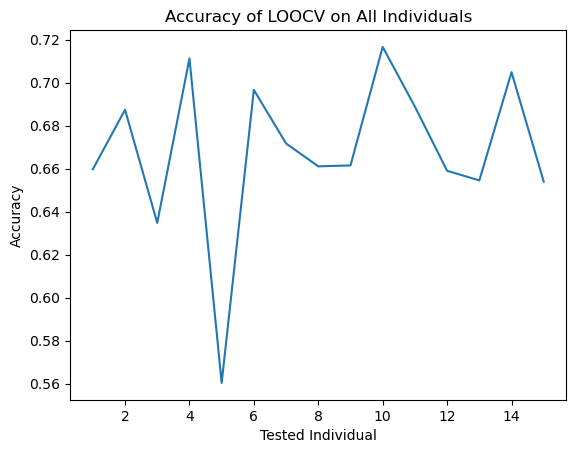

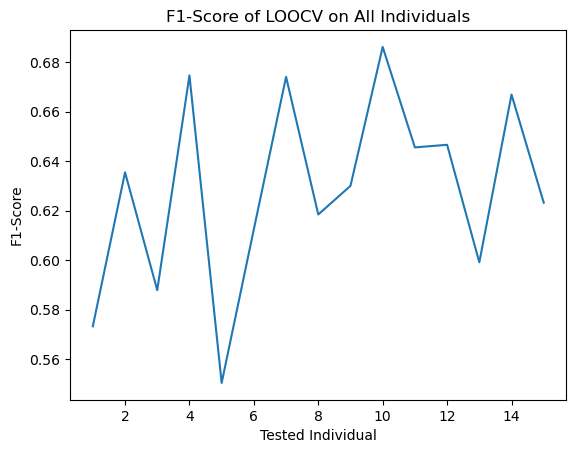

Average Accuracy:  0.6681324260895408
Average F1-Score:  0.6283109777793664


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## umap
## 0: no activity
## 1: walking + stairs
## 2: cycling
def plot_clusters(X, y, title):
    plt.figure(figsize=(10, 6))
    palette = sns.color_palette("hsv", len(np.unique(y)))
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=y, legend='full', palette=palette, s=60, alpha=0.8)
    plt.title(title)
    plt.show()

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([1, 2, 4, 7, 8, 9])]
    data.loc[data['activity'].isin([3, 6]), 'activity'] = 1
    data.loc[data['activity'].isin([5]), 'activity'] = 2
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

umap_reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3)
X_umap = umap_reducer.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_umap, columns=[f'UMAP{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

plot_clusters(X_umap, tsne_df['activity'], "UMAP")

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = f1_score(testingActivity, knn.predict(testingFeatures), average="macro")
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Walking + Stairs", "Cycling"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Walking + Stairs", "Cycling"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, f1_score(testingActivity, y_pred, average='macro'))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


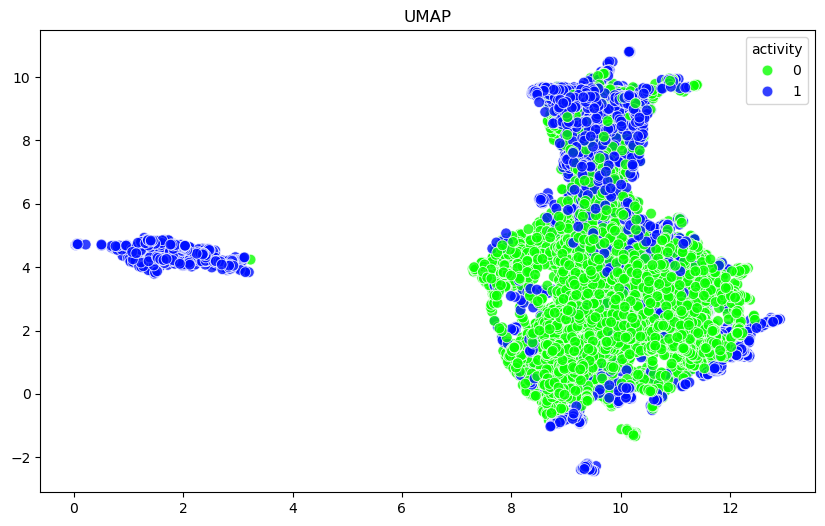

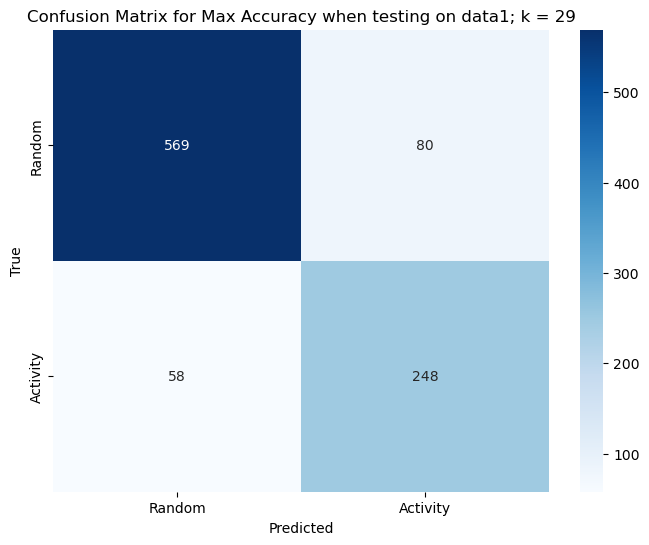

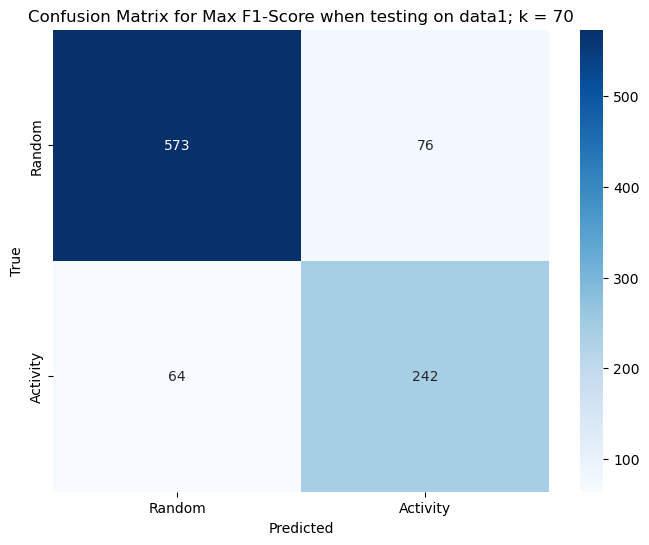

data1 has been tested on everyone


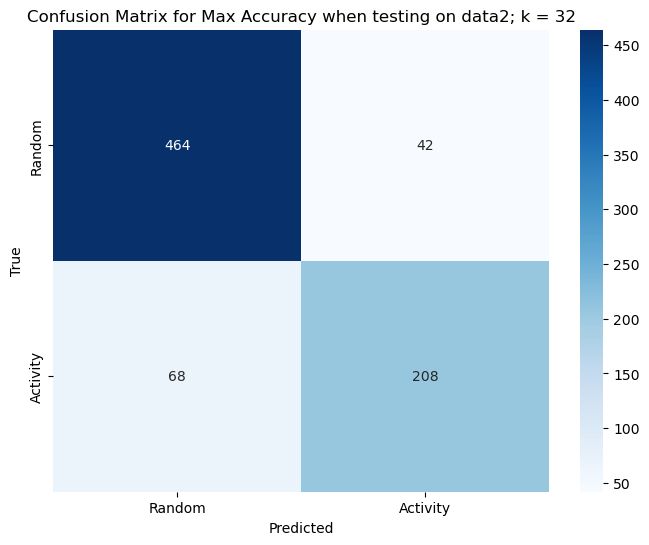

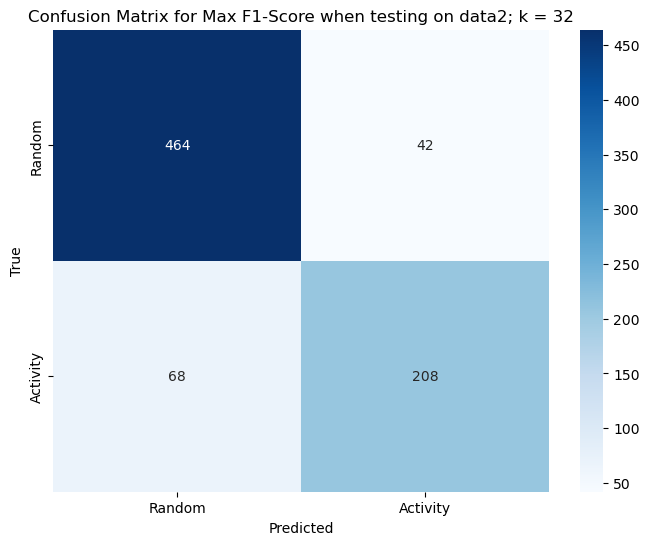

data2 has been tested on everyone


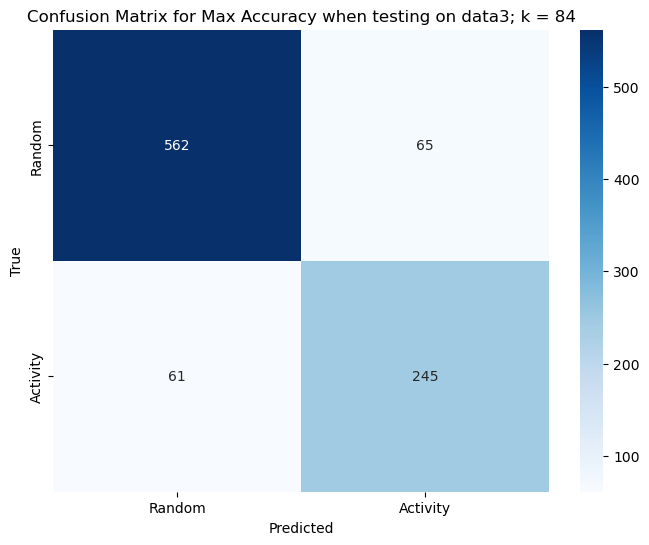

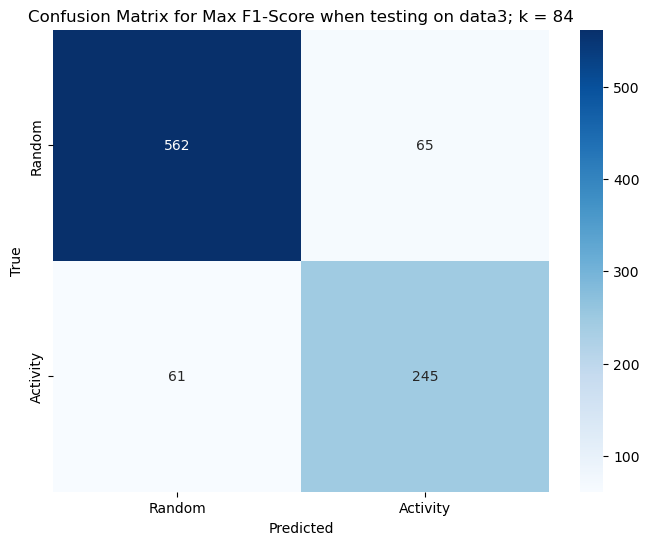

data3 has been tested on everyone


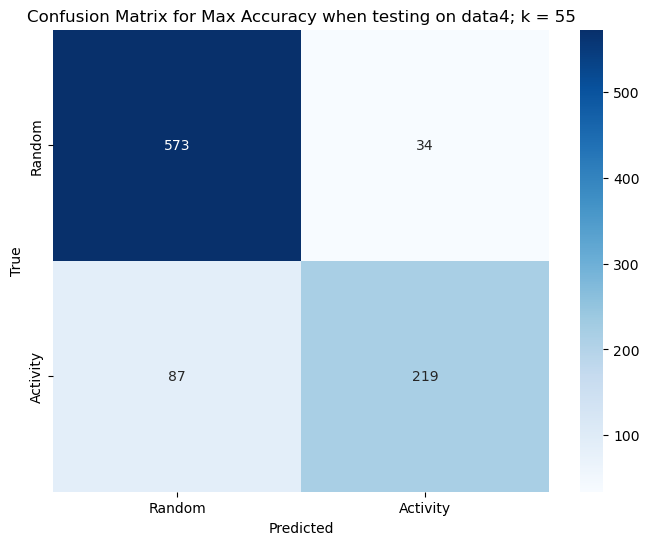

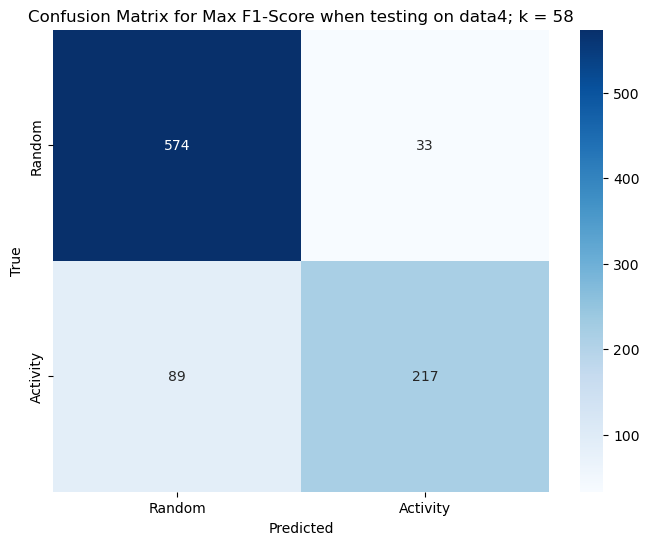

data4 has been tested on everyone


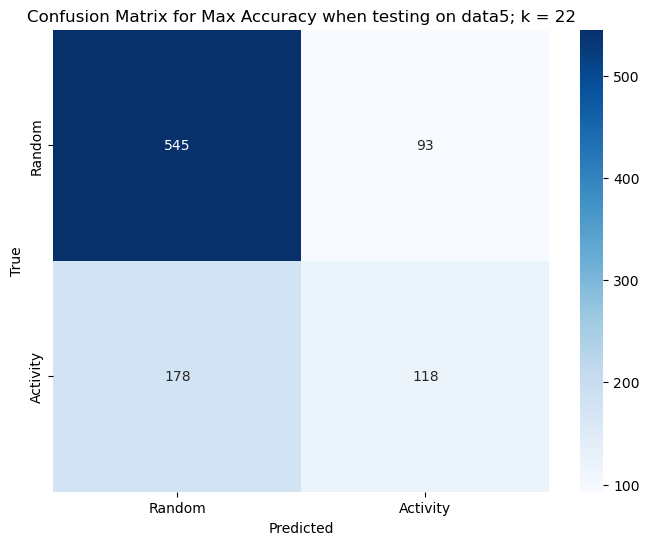

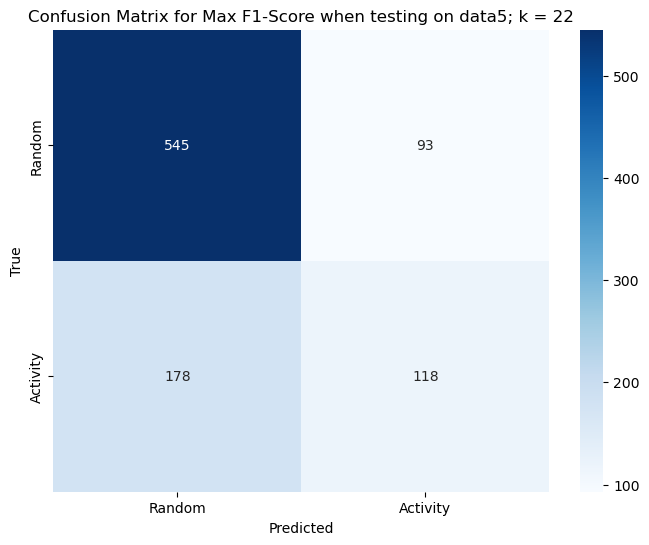

data5 has been tested on everyone


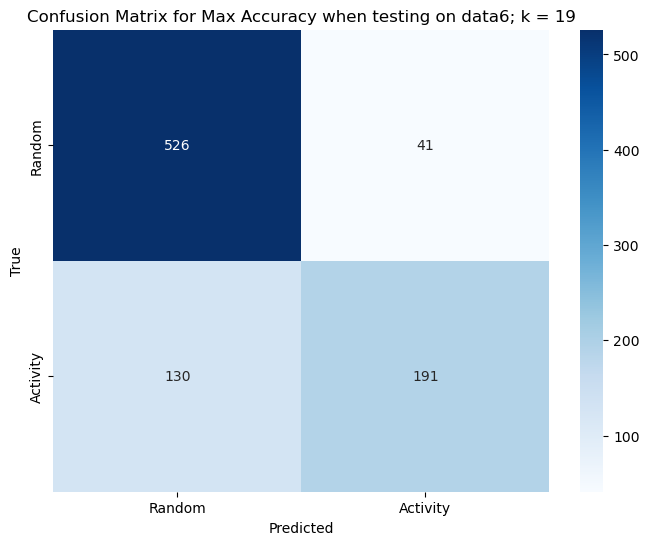

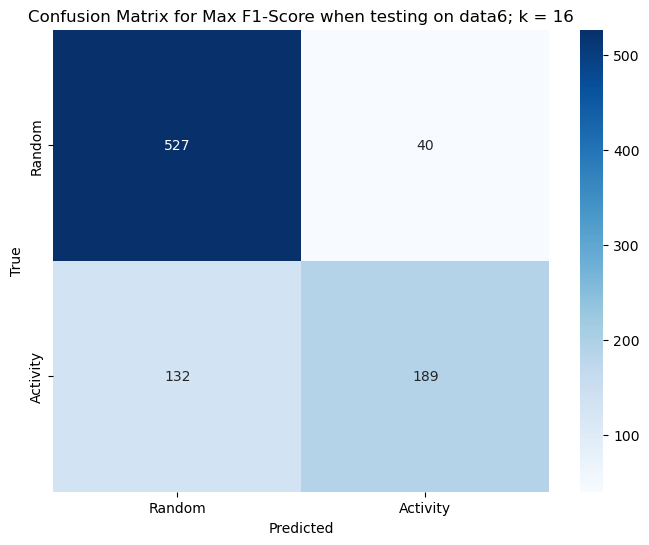

data6 has been tested on everyone


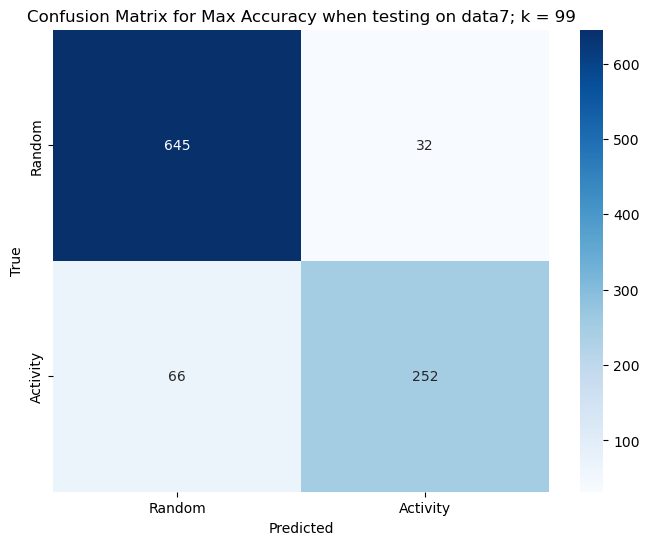

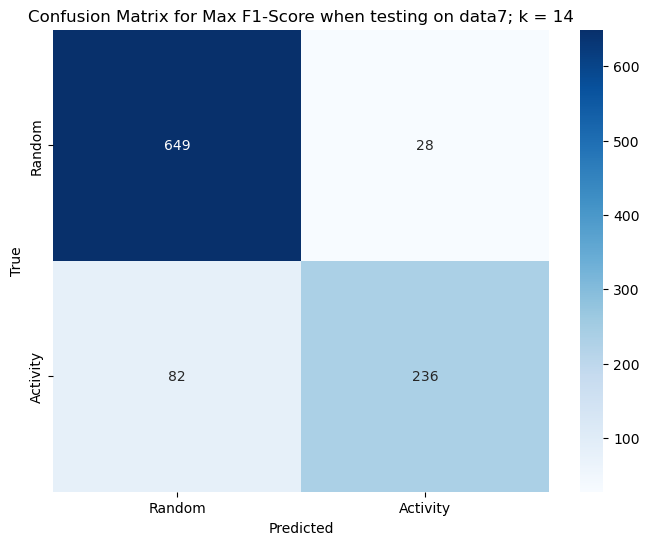

data7 has been tested on everyone


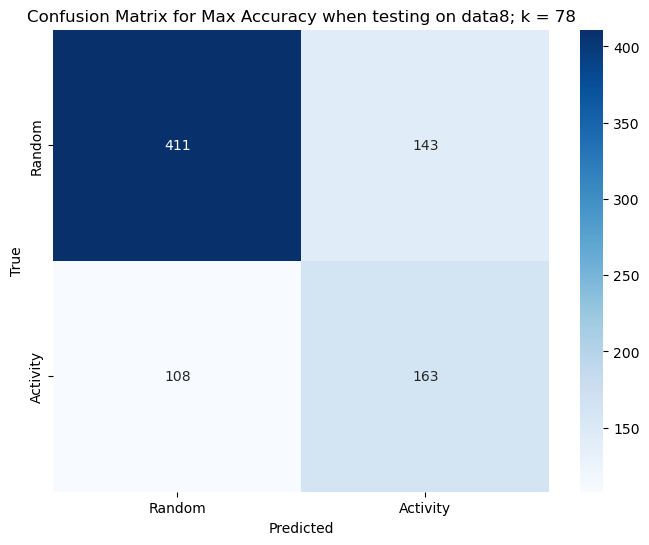

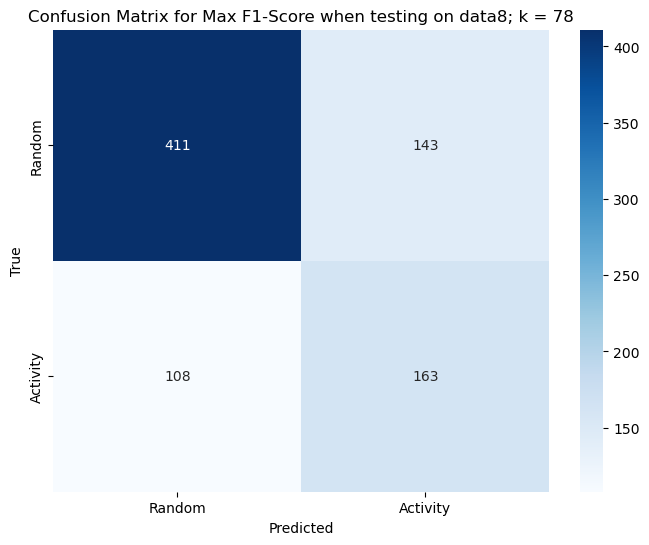

data8 has been tested on everyone


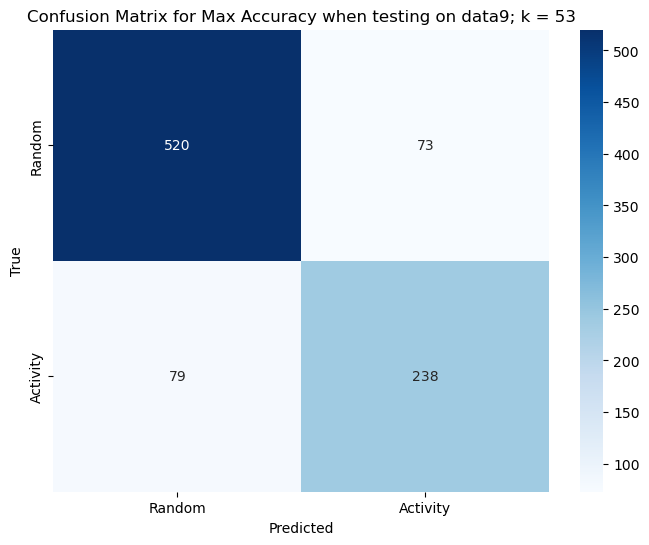

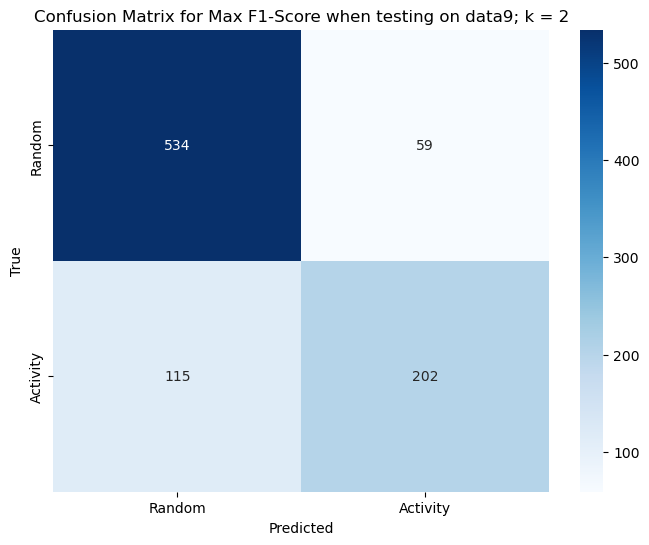

data9 has been tested on everyone


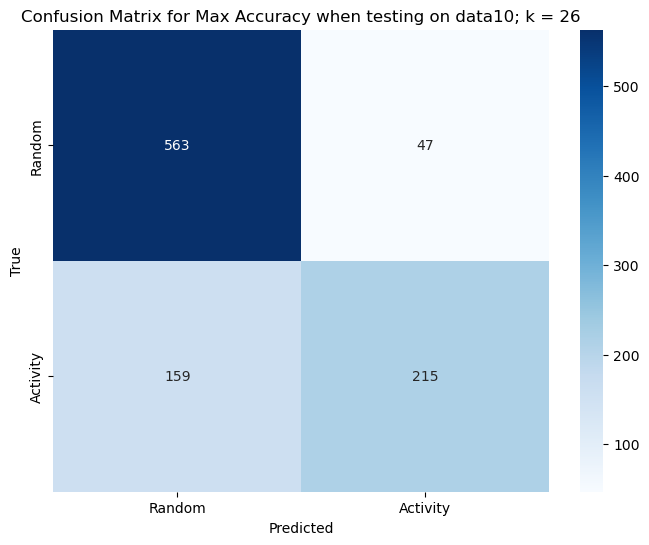

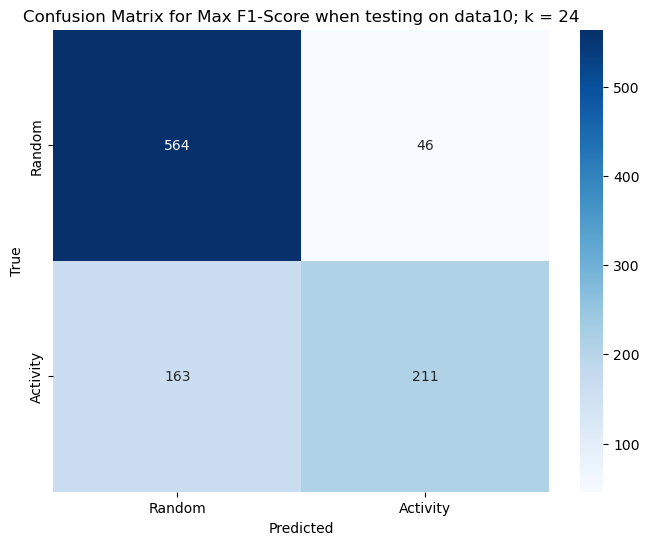

data10 has been tested on everyone


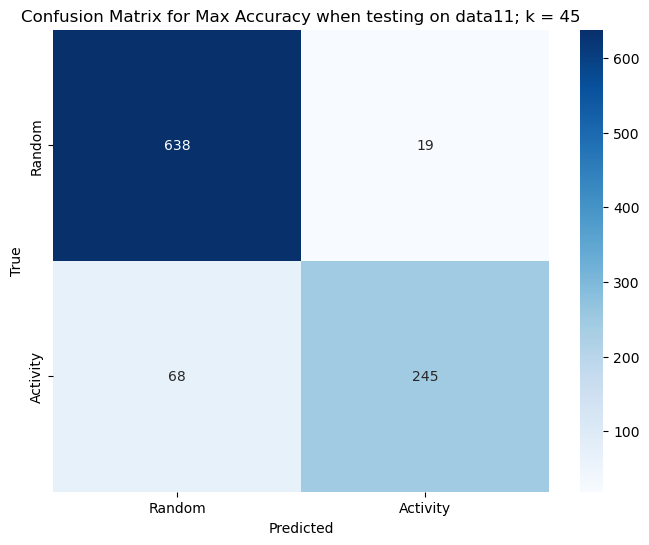

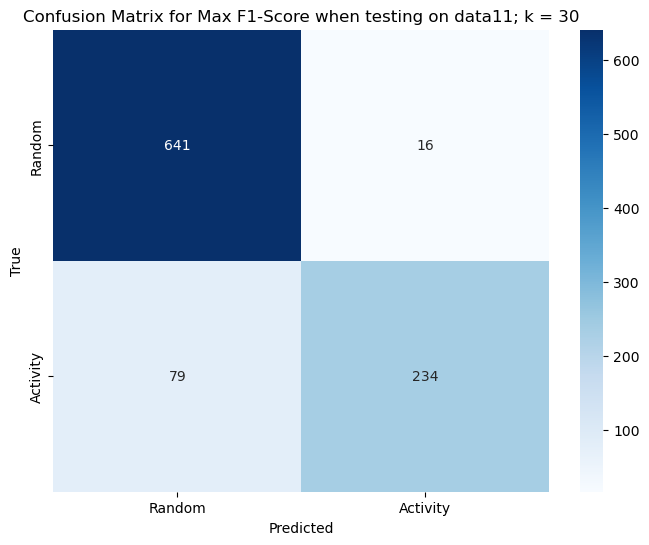

data11 has been tested on everyone


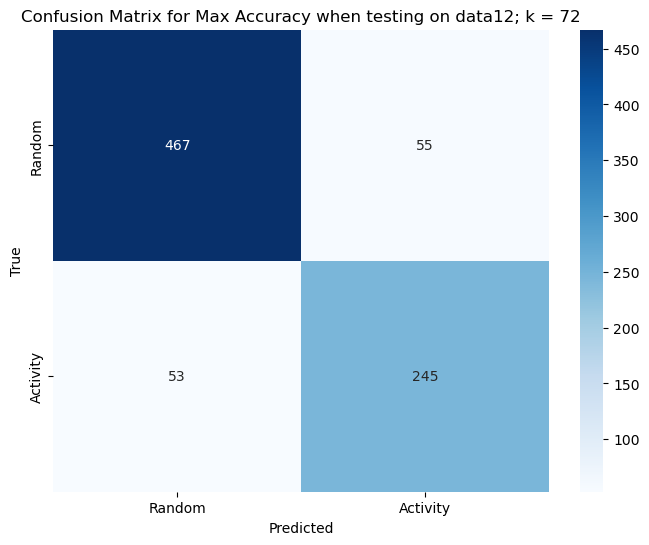

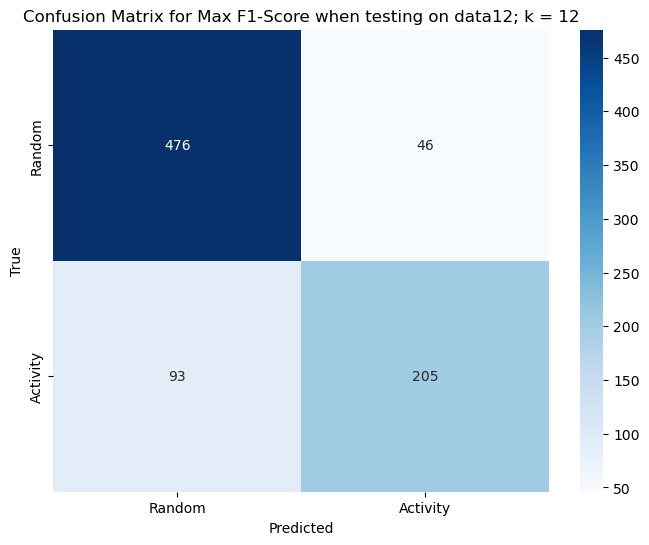

data12 has been tested on everyone


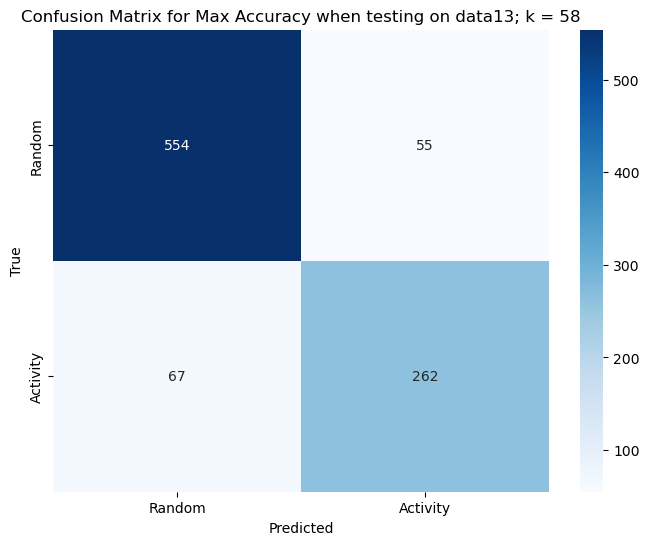

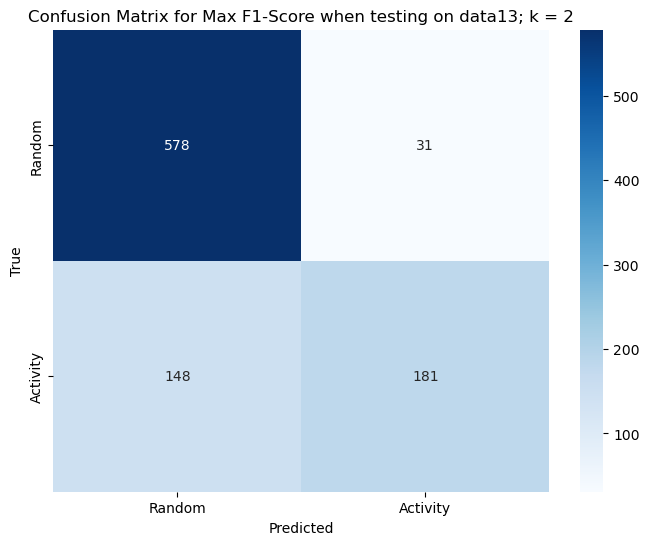

data13 has been tested on everyone


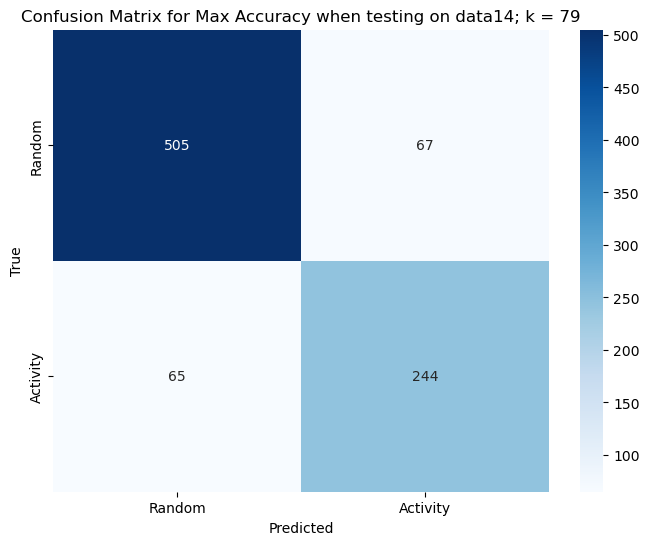

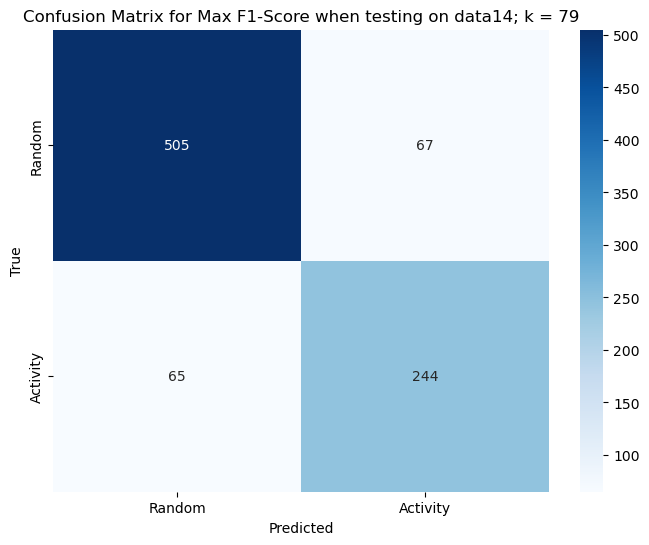

data14 has been tested on everyone


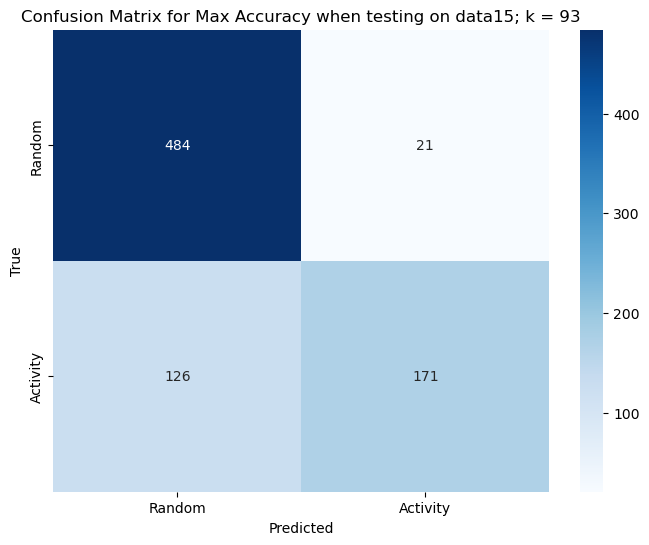

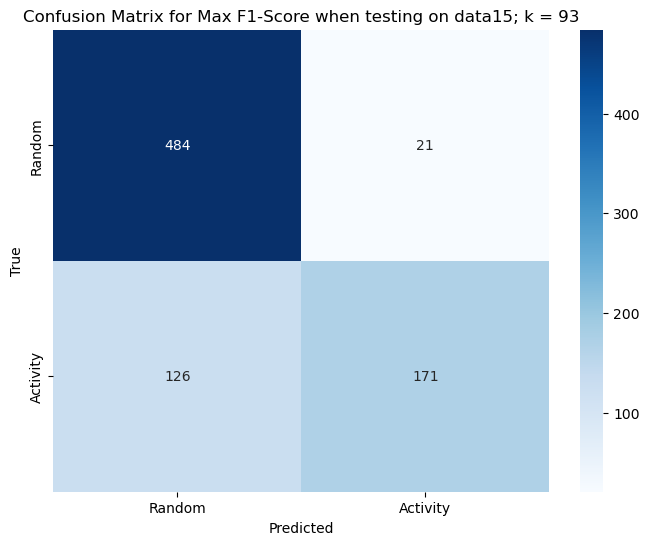

data15 has been tested on everyone


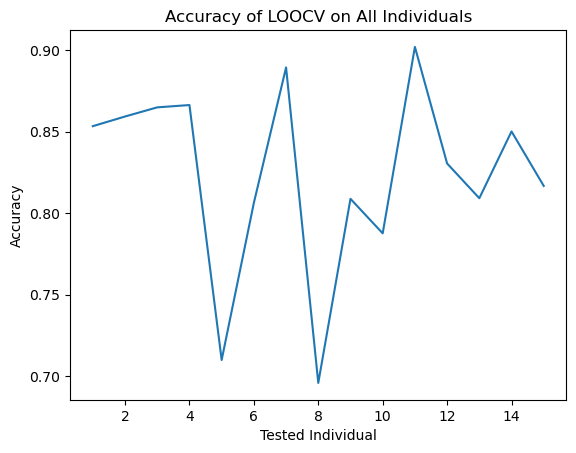

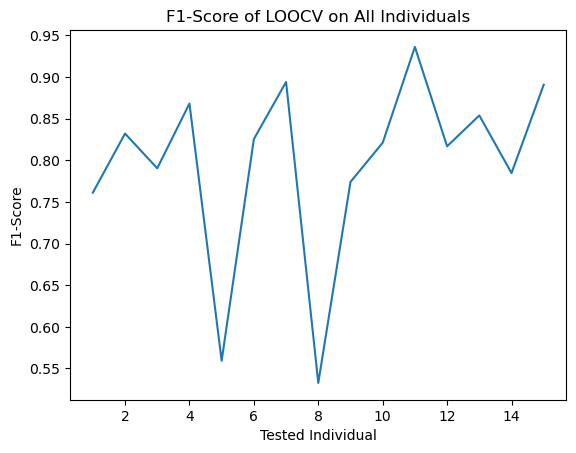

Average Accuracy:  0.8233610128090881
Average F1-Score:  0.7959448547914304


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## umap
## 0: baseline + misc
## 1: activity minus soccer
def plot_clusters(X, y, title):
    plt.figure(figsize=(10, 6))
    palette = sns.color_palette("hsv", len(np.unique(y)))
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=y, legend='full', palette=palette, s=60, alpha=0.8)
    plt.title(title)
    plt.show()

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0, 4])]
    data.loc[data['activity'].isin([2, 7, 8, 9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 5, 6]), 'activity'] = 1
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

umap_reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3)
X_umap = umap_reducer.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_umap, columns=[f'UMAP{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

plot_clusters(X_umap, tsne_df['activity'], "UMAP")

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = precision_score(testingActivity, knn.predict(testingFeatures))
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["Random", "Activity"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, precision_score(testingActivity, y_pred))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


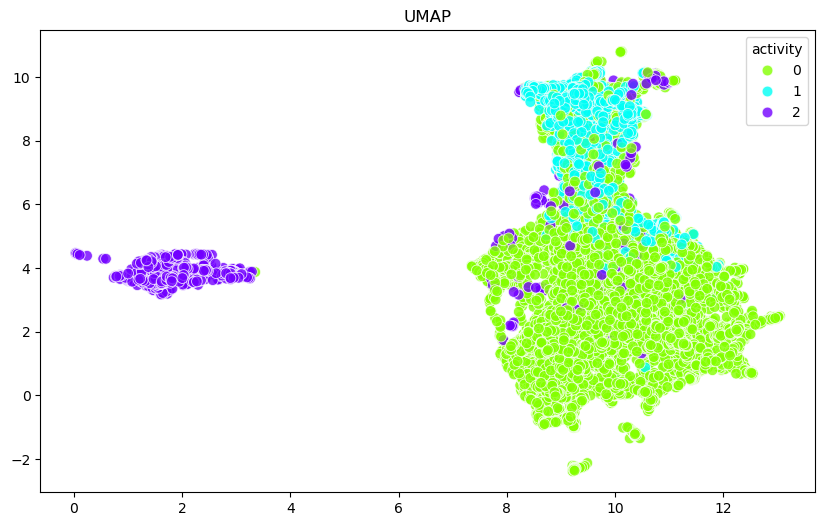

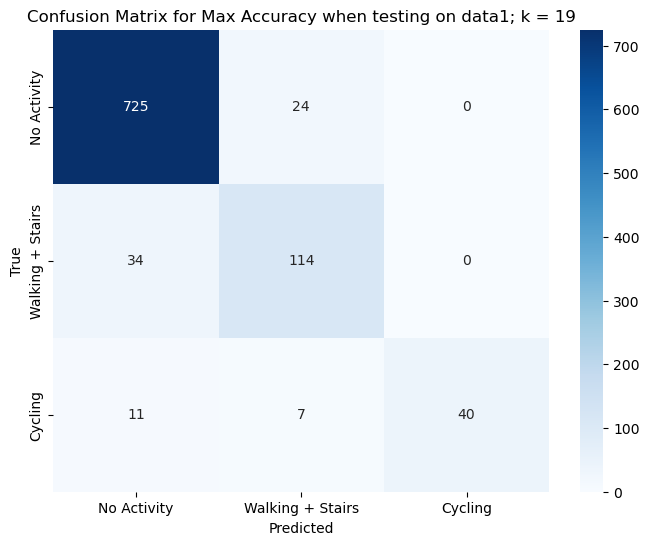

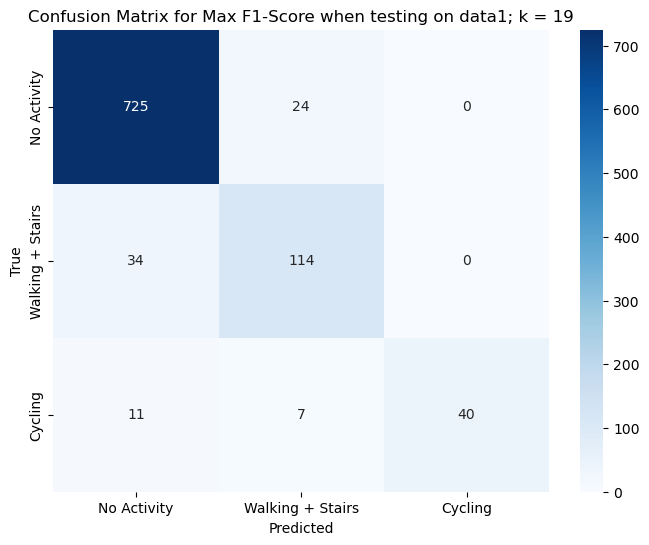

data1 has been tested on everyone


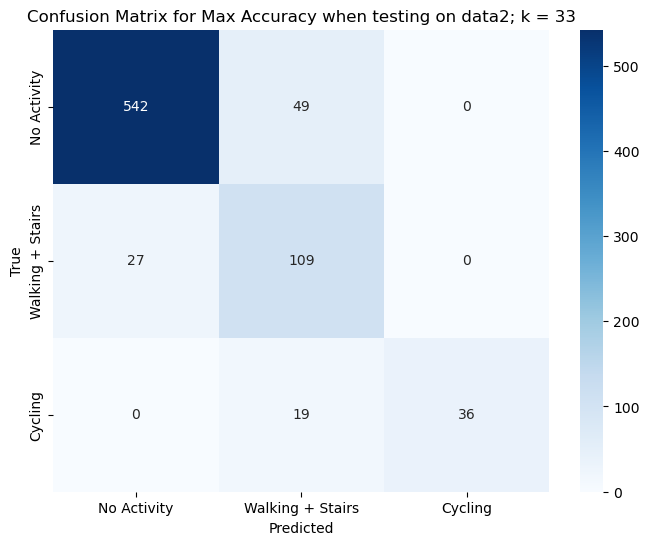

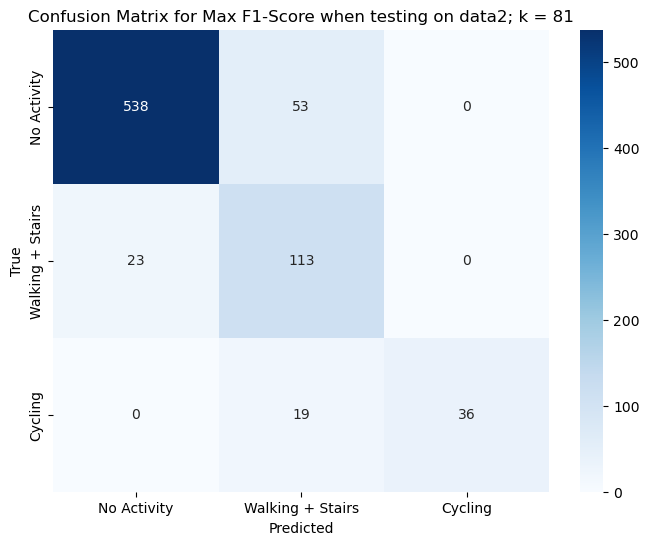

data2 has been tested on everyone


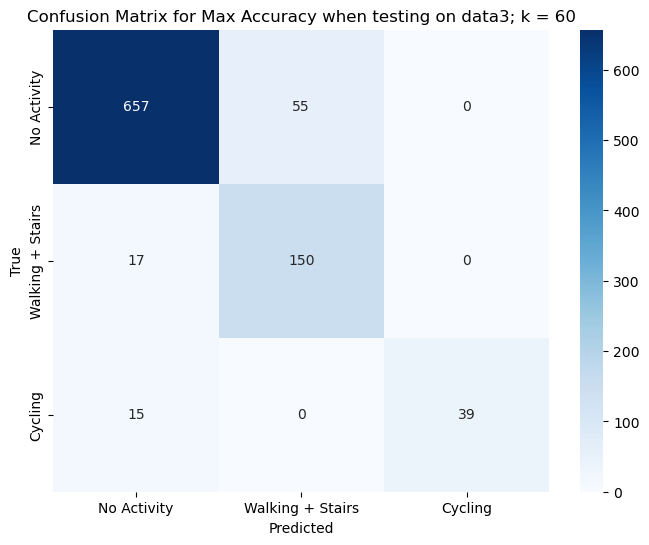

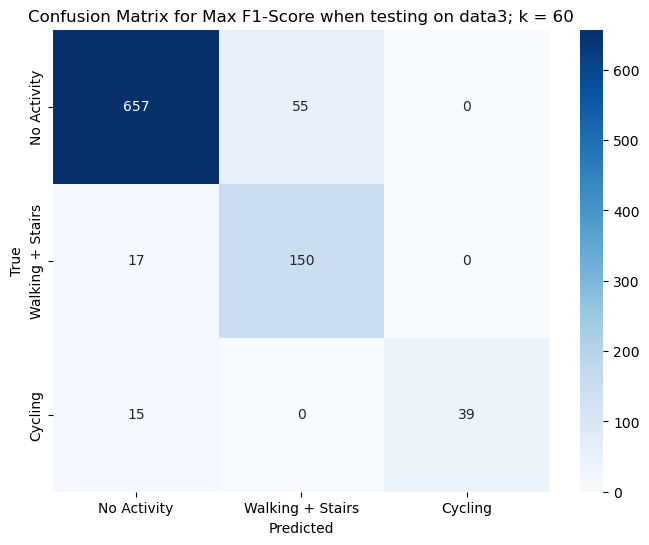

data3 has been tested on everyone


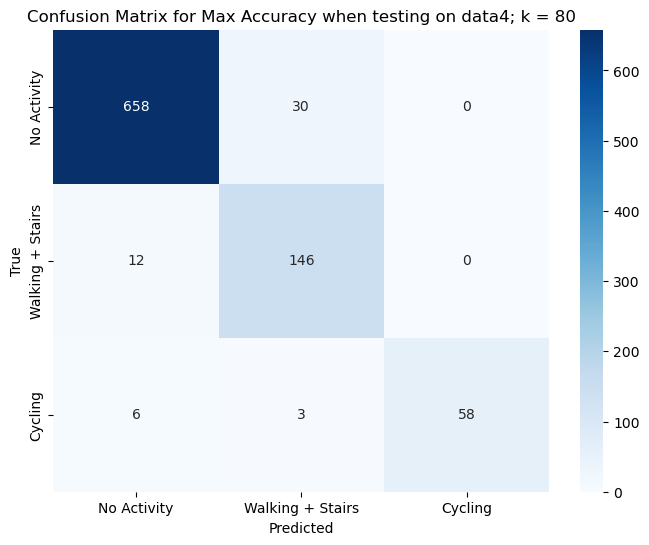

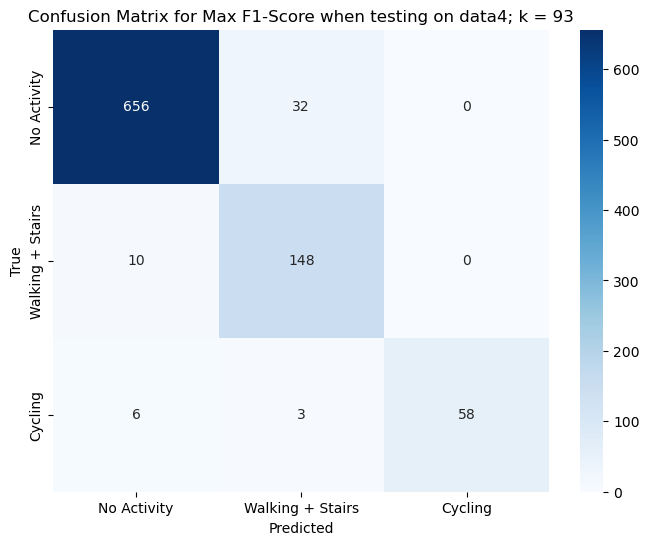

data4 has been tested on everyone


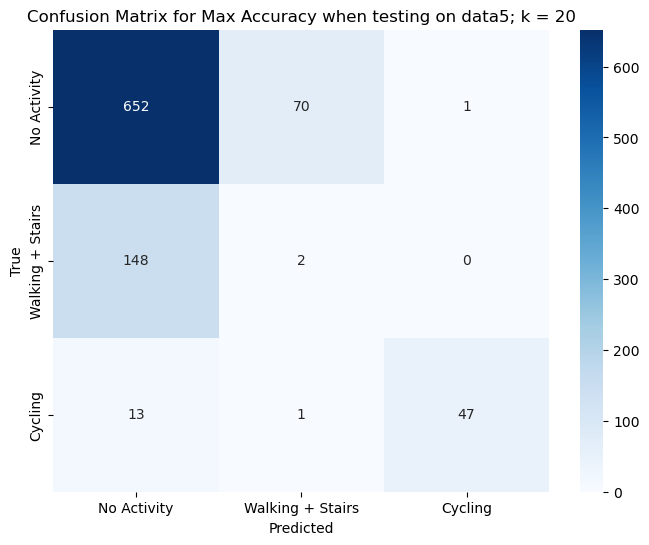

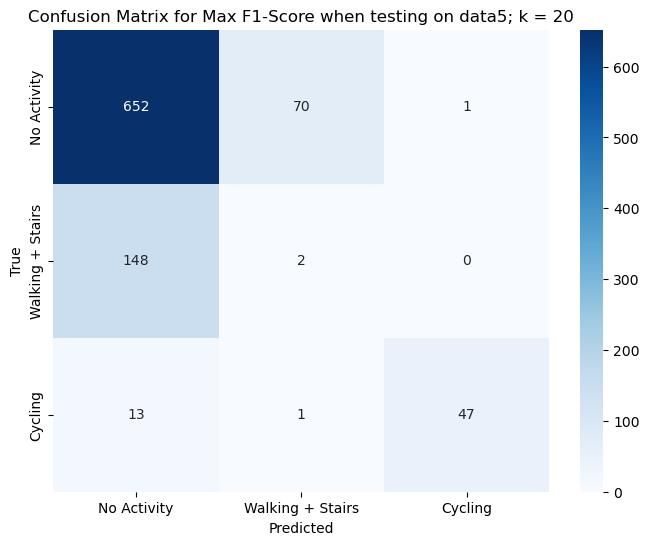

data5 has been tested on everyone


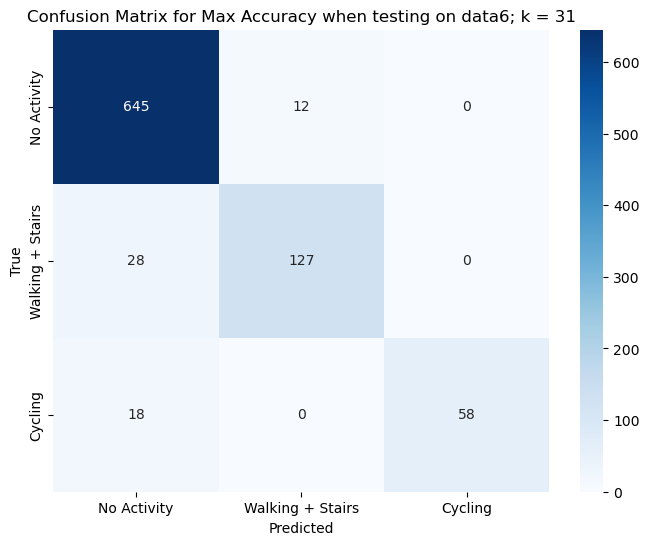

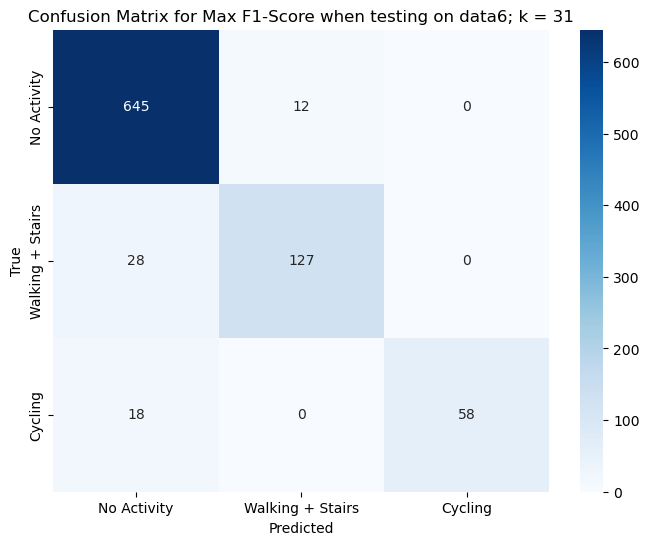

data6 has been tested on everyone


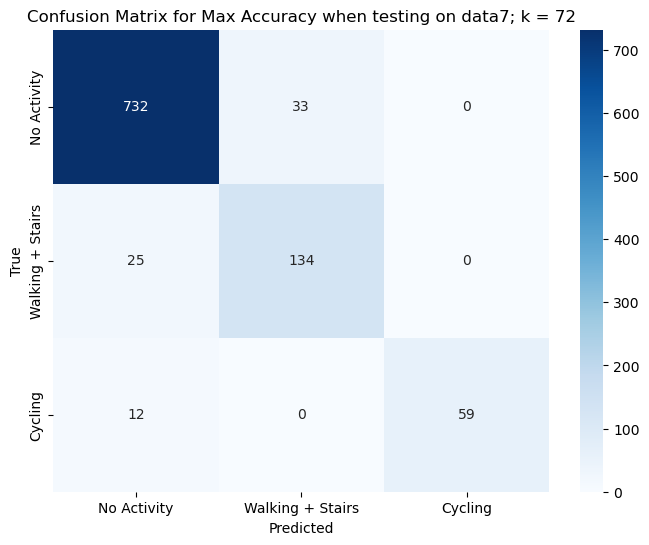

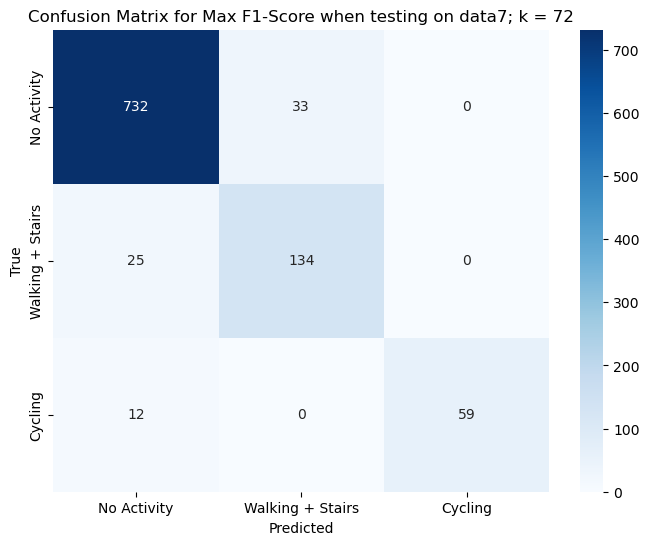

data7 has been tested on everyone


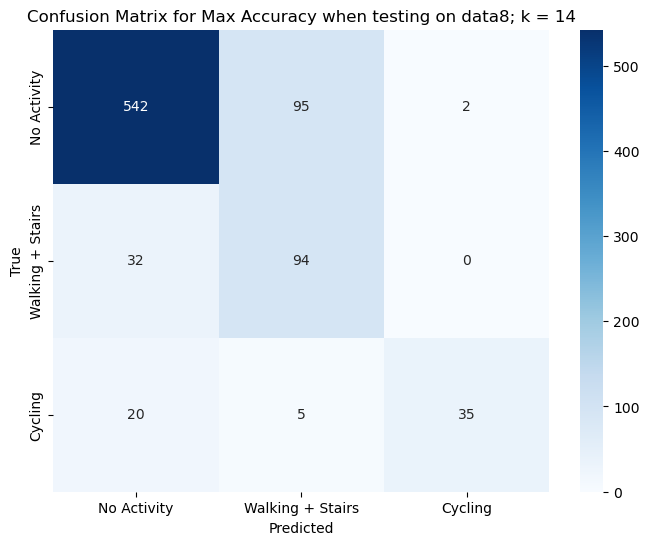

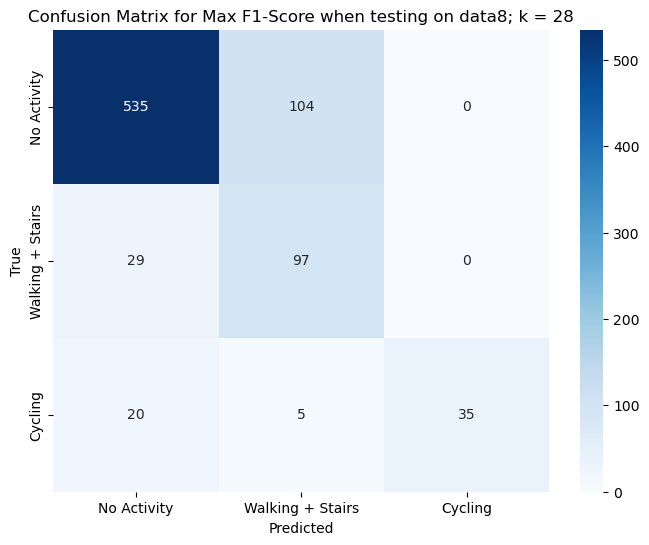

data8 has been tested on everyone


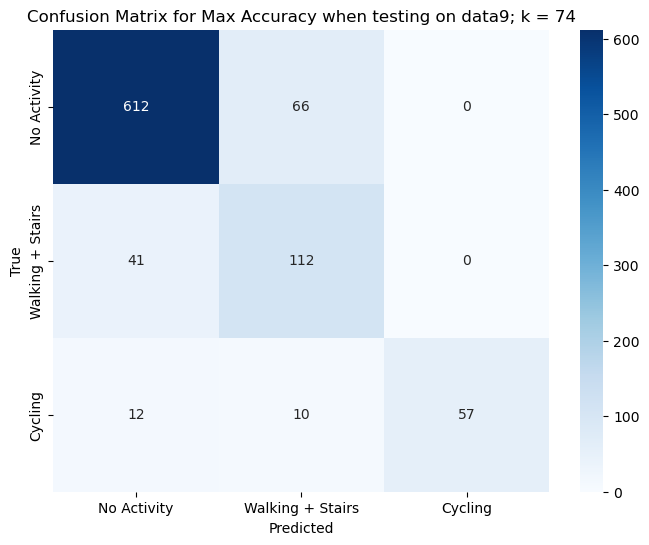

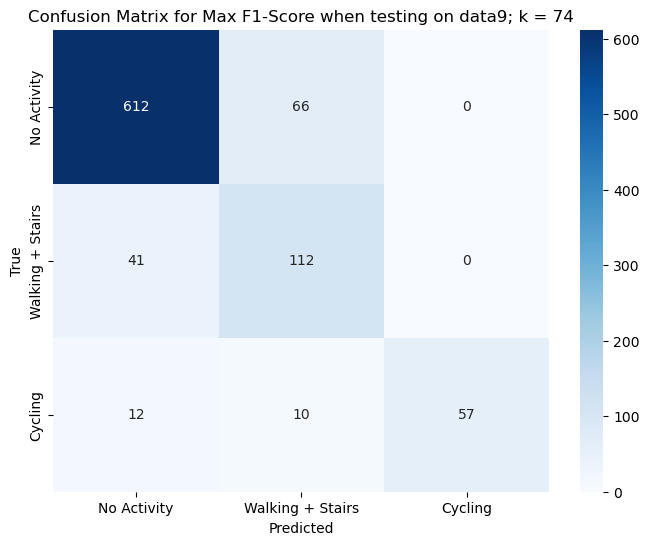

data9 has been tested on everyone


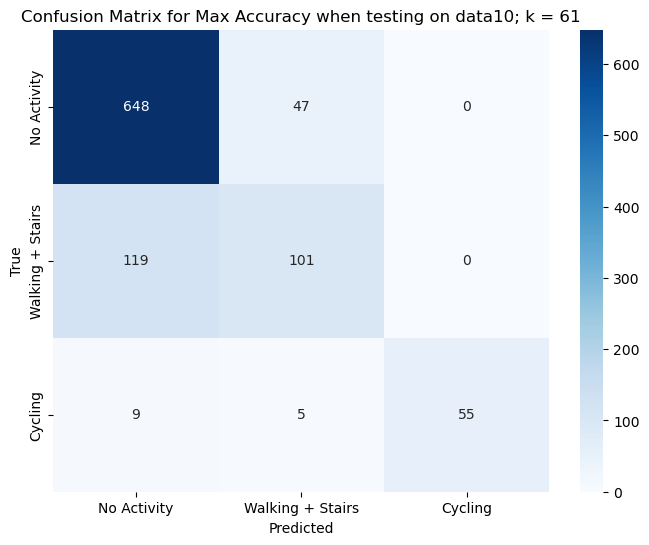

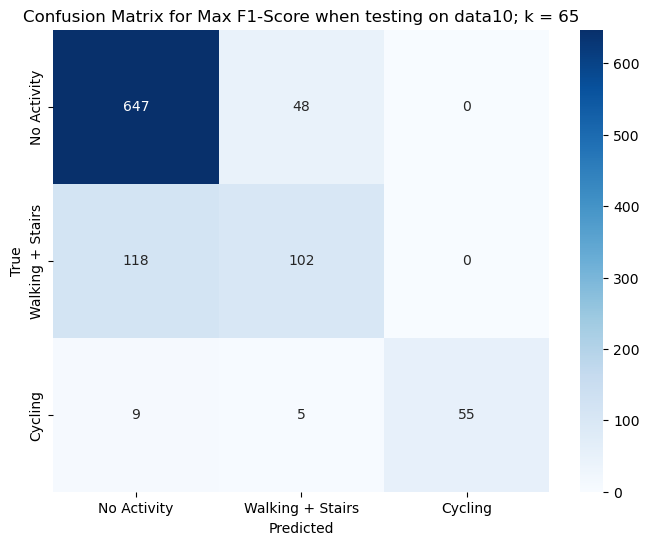

data10 has been tested on everyone


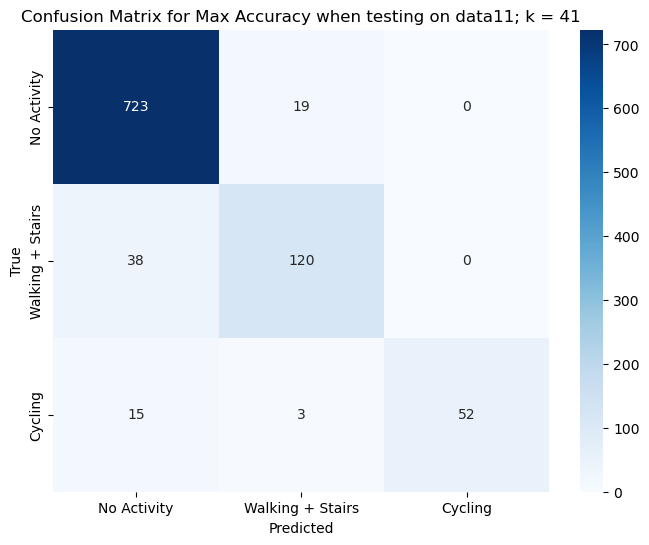

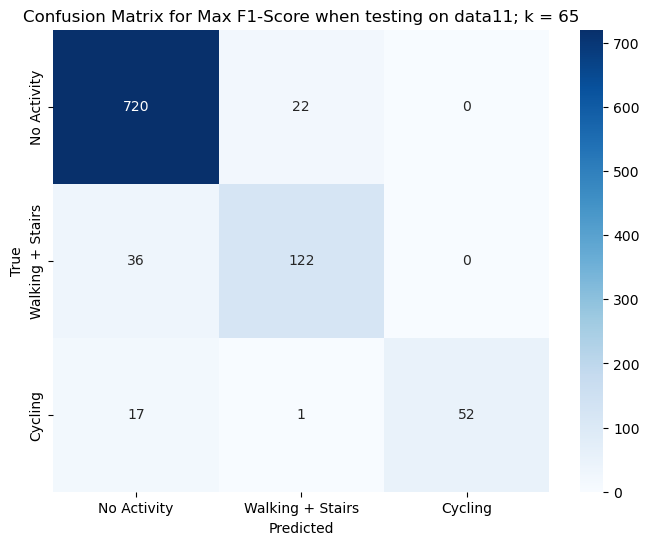

data11 has been tested on everyone


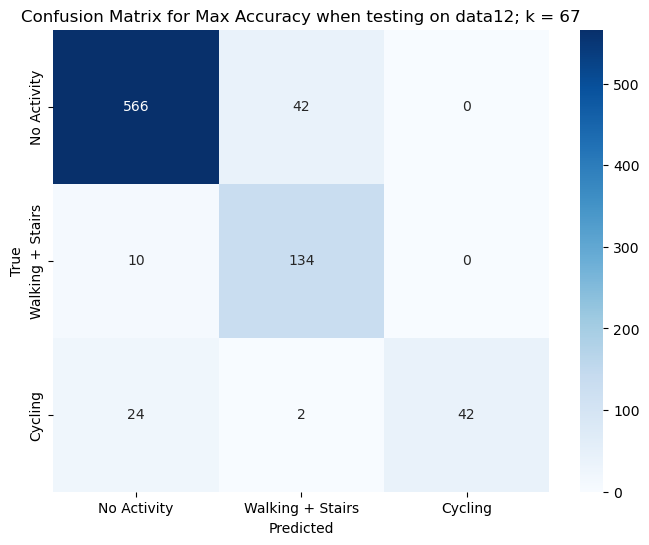

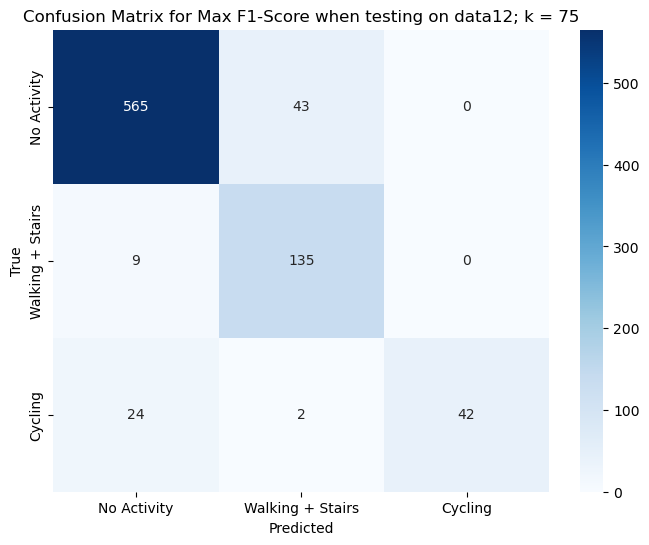

data12 has been tested on everyone


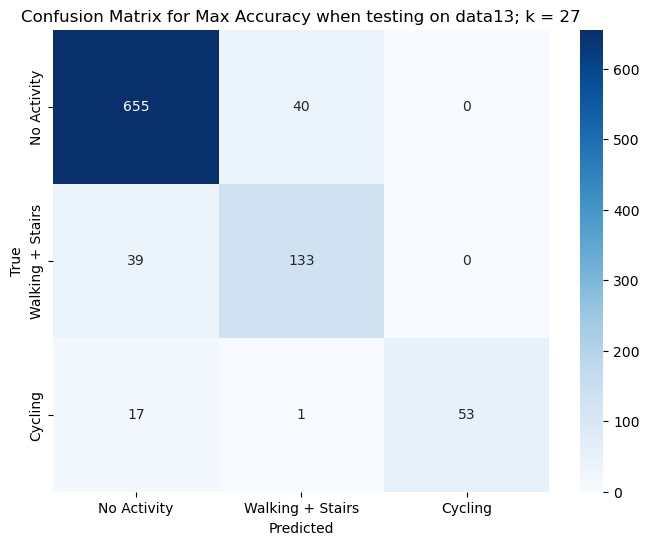

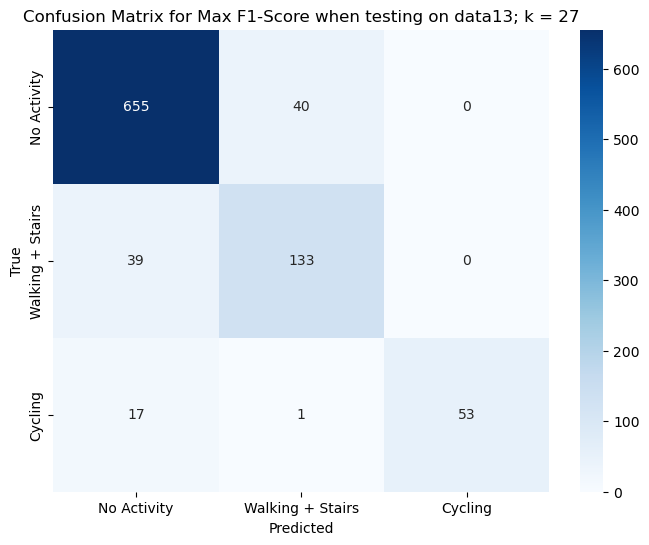

data13 has been tested on everyone


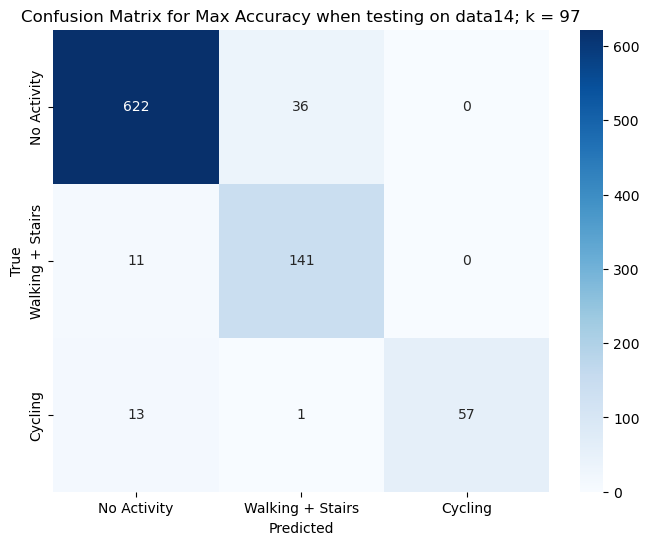

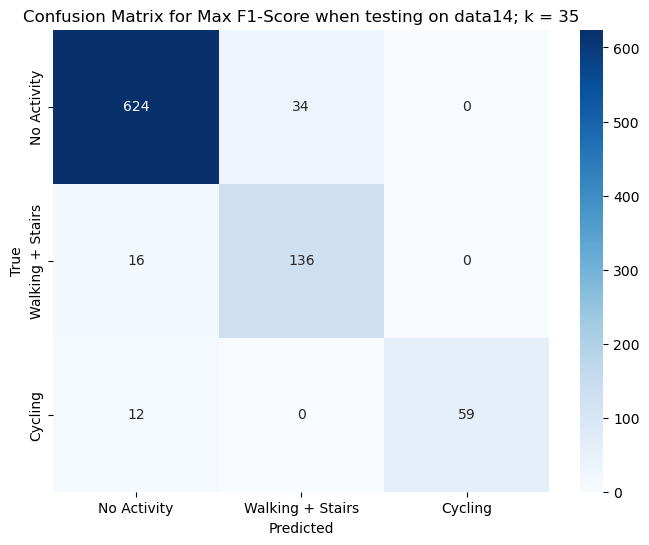

data14 has been tested on everyone


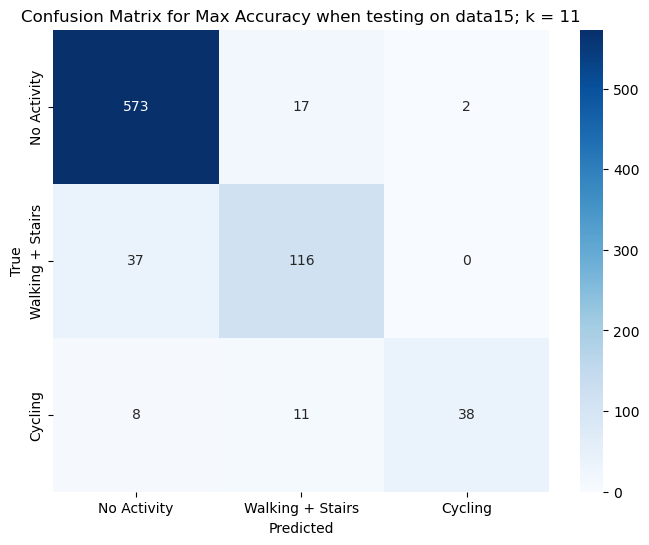

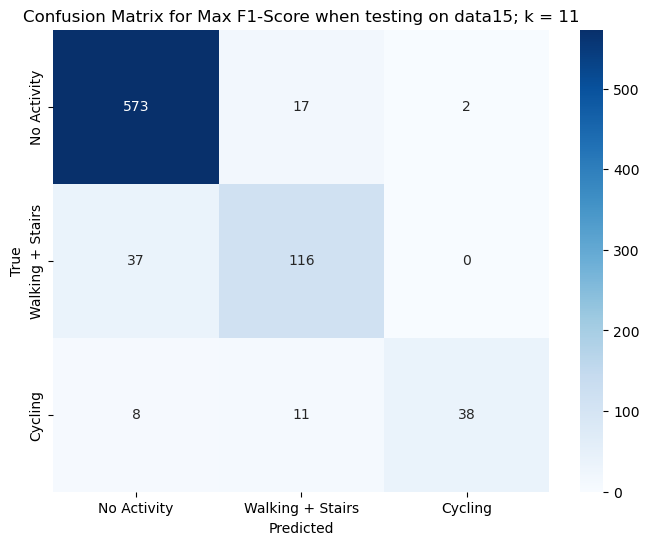

data15 has been tested on everyone


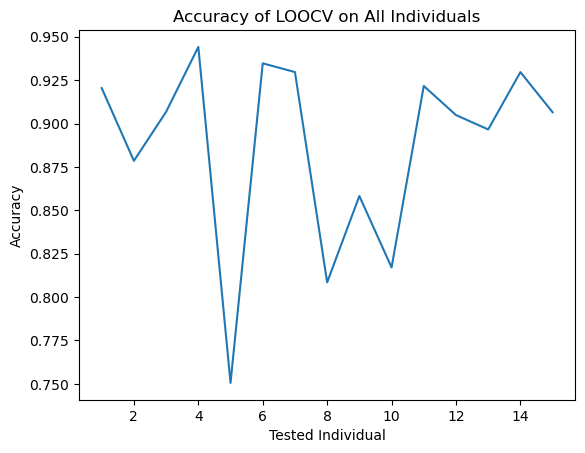

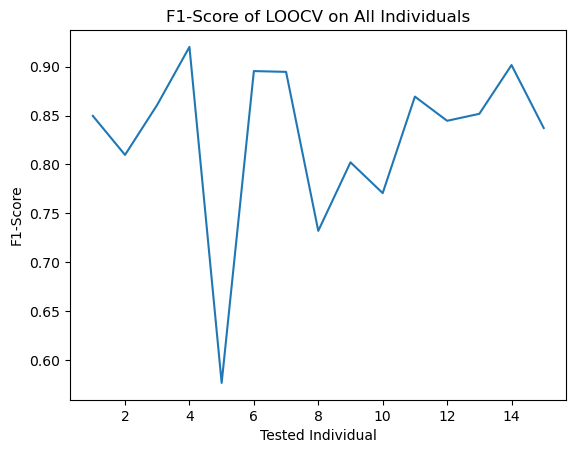

Average Accuracy:  0.8871814234549821
Average F1-Score:  0.8278023334281388


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## umap
## 0: baseline + misc
## 1: walking + stairs
## 2: cycling
def plot_clusters(X, y, title):
    plt.figure(figsize=(10, 6))
    palette = sns.color_palette("hsv", len(np.unique(y)))
    sns.scatterplot(x=X[:, 0], y=X[:, 1], hue=y, legend='full', palette=palette, s=60, alpha=0.8)
    plt.title(title)
    plt.show()

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0,4])]
    data.loc[data['activity'].isin([1,2,7,8,9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 6]), 'activity'] = 1
    data.loc[data['activity'].isin([5]), 'activity'] = 2
    dataframes[name] = data


combined_df = pd.concat(dataframes.values(), ignore_index=True)
numerical_cols = [col for col in combined_df.columns if col != 'activity']
scaled_data = StandardScaler().fit_transform(combined_df[numerical_cols])

umap_reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3)
X_umap = umap_reducer.fit_transform(scaled_data)
tsne_df = pd.DataFrame(data=X_umap, columns=[f'UMAP{i}' for i in np.arange(1, 4)])
tsne_df['activity'] = combined_df['activity']

plot_clusters(X_umap, tsne_df['activity'], "UMAP")

start_idx = 0
for key, df in dataframes.items():
    end_idx = start_idx + len(df)
    dataframes[key] = tsne_df.iloc[start_idx:end_idx].reset_index(drop=True)
    start_idx = end_idx


LOOCVAccuracy = np.array([])
LOOCVf1_score = np.array([])
for tester in dataframes:
    trainingFeatures  = [col for col in dataframes[tester].columns if col not in ["activity", "start_time", "end_time"]]

    testingFeatures = dataframes[tester][trainingFeatures].to_numpy()
    testingActivity = dataframes[tester]["activity"].to_numpy()

    X_train = pd.DataFrame()
    y_train = pd.DataFrame()
    for trainer in dataframes:
        if trainer != tester:
            X_train = pd.concat([X_train, dataframes[trainer][trainingFeatures]], ignore_index=True)
            y_train = pd.concat([y_train, dataframes[trainer]["activity"]], ignore_index=True)

    X_train = X_train.to_numpy()
    y_train = y_train.to_numpy().flatten()

    testingFeatures = StandardScaler().fit_transform(testingFeatures)
    X_train = StandardScaler().fit_transform(X_train)


    k = np.arange(1,100)
    accuracy = np.array([])
    f1score = np.array([])
    maxAccK = 0
    maxF1K = 0
    maxAcc = 0
    maxF1 = 0
    for i in k:
        knn = KNeighborsClassifier(i)
        knn.fit(X_train, y_train)
        acc = (accuracy_score(testingActivity, knn.predict(testingFeatures)))
        f1 = f1_score(testingActivity, knn.predict(testingFeatures), average="macro")
        accuracy = np.append(accuracy, acc)
        f1score = np.append(f1score, f1)
        if acc > maxAcc:
            maxAccK = i
            maxAcc = acc
        if f1 > maxF1:
            maxF1K = i
            maxF1 = f1


    knn = KNeighborsClassifier(maxAccK)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Walking + Stairs", "Cycling"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max Accuracy when testing on {tester}; k = {maxAccK}")
    plt.show()

    knn = KNeighborsClassifier(maxF1K)
    knn.fit(X_train, y_train)

    y_pred = knn.predict(testingFeatures)
    cmat = confusion_matrix(testingActivity, y_pred) #validate model predictions with actual y values
    labels = ["No Activity", "Walking + Stairs", "Cycling"]

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cmat, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)

    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f"Confusion Matrix for Max F1-Score when testing on {tester}; k = {maxF1K}")
    plt.show()

    LOOCVAccuracy = np.append(LOOCVAccuracy, accuracy_score(testingActivity, y_pred))
    LOOCVf1_score = np.append(LOOCVf1_score, f1_score(testingActivity, y_pred, average='macro'))

    print(f"{tester} has been tested on everyone")

plt.plot(np.arange(1,16), LOOCVAccuracy)
plt.title("Accuracy of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("Accuracy")
plt.show()

plt.plot(np.arange(1,16), LOOCVf1_score)
plt.title("F1-Score of LOOCV on All Individuals")
plt.xlabel("Tested Individual")
plt.ylabel("F1-Score")
plt.show()

print("Average Accuracy: ", sum(LOOCVAccuracy) / len(LOOCVAccuracy))
print("Average F1-Score: ", sum(LOOCVf1_score) / len(LOOCVf1_score))


In [ ]:
## ACC_specific_windowed_features.csv
## HR_specific_windowed_features.csv
## BVP_specific_windowed_features.csv
## umap
## 0: baseline + misc
## 1: walking + stairs
## 2: cycling

dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0,4])]
    data.loc[data['activity'].isin([1,2,7,8,9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 6]), 'activity'] = 1
    data.loc[data['activity'].isin([5]), 'activity'] = 2
    data["individual"] = i
    dataframes[name] = data

combined_df = pd.concat(dataframes.values(), ignore_index=True)

X = combined_df.drop(columns=['activity', 'individual'])
y = combined_df['activity']
individuals = combined_df['individual']

logo = LeaveOneGroupOut()

maxAccN = 0
maxF1N = 0
nMaxAcc = 0
nMaxF1 = 0
for n in (15, 25, 50, 100, 200):
    maxAccD = 0
    maxF1D = 0
    dMaxAcc = 0
    dMaxF1 = 0
    for d in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
        maxAccC = 0
        maxF1C = 0
        cMaxAcc = 0
        cMaxF1 = 0
        for c in (2, 3, 4, 5):
            maxAccK = 0
            maxF1K = 0
            maxAcc = 0
            maxF1 = 0
            for k in np.arange(1,101):
                LOOCVAccuracy = np.array([])
                LOOCVf1_score = np.array([])
                for train_index, test_index in logo.split(X, y, groups=individuals):
                    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
                    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

                    umap_reducer = umap.UMAP(n_neighbors=n, min_dist=d, n_components=c)
                    X_train = umap_reducer.fit_transform(X_train)
                    X_test = umap_reducer.transform(X_test)

                    knn = KNeighborsClassifier(k)
                    knn.fit(X_train, y_train)
                    acc = (accuracy_score(y_test, knn.predict(X_test)))
                    f1 = f1_score(y_test, knn.predict(X_test), average="macro")

                    LOOCVAccuracy = np.append(LOOCVAccuracy, acc)
                    LOOCVf1_score = np.append(LOOCVf1_score, f1)

                avgAcc = sum(LOOCVAccuracy) / len(LOOCVAccuracy)
                avgF1 = sum(LOOCVf1_score) / len(LOOCVf1_score)


                if avgAcc > maxAcc:
                    maxAccK = k
                    maxAcc = avgAcc
                if avgF1 > maxF1:
                    maxF1K = k
                    maxF1 = avgF1

            if maxAcc > maxAccC:
                maxAccC = c
                cMaxAcc = maxAcc
            if maxF1 > maxF1C:
                maxF1C = c
                cMaxF1 = maxF1

            print("Component ", c, "tested!")
        if cMaxAcc > maxAccD:
            maxAccD = d
            dMaxAcc = cMaxAcc
        if cMaxF1 > maxF1D:
            maxF1D = d
            dMaxF1 = cMaxF1

        print("min_dist ", d, "tested!")
    if dMaxAcc > maxAccN:
        maxAccN = n
        nMaxAcc = dMaxAcc
    if dMaxF1 > maxF1N:
        maxF1N = n
        nMaxF1 = dMaxF1

    print("Neighbor ", n, "tested!")
print("Best Accuracy Parameters: n: ", maxAccN, " d: ", maxAccD, " c: ", maxAccC, " k: ", maxAccK)
print("Best F1_score Parameters: n: ", maxF1N, " d: ", maxF1D, " c: ", maxF1C, " k: ", maxF1K)


In [ ]:
def objective(trial):
    n_neighbors = trial.suggest_int('n_neighbors', 15, 200)
    min_dist = trial.suggest_float('min_dist', 0.0, 0.99)
    n_components = trial.suggest_int('n_components', 2, 5)
    k = trial.suggest_int('k', 1, 100)

    # Apply UMAP
    umap_reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, n_components=n_components)
    X_train_reduced = umap_reducer.fit_transform(X_train)
    X_val_reduced = umap_reducer.transform(X_test)

    # Train KNN
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_train_reduced, y_train)
    y_pred = knn.predict(X_val_reduced)

    # Compute the objective (negative accuracy in this case, to minimize it)
    return -accuracy_score(y_test, y_pred)


dataframes = {}
for i in np.arange(1,16):
    name = f"data{i}"
    acc = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/ACC_specific_windowed_features.csv")
    hr = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/HR_specific_windowed_features.csv")
    bvp = pd.read_csv(f"HAR/ppg+dalia/data/PPG_FieldStudy/S{i}/S{i}_E4/BVP_specific_windowed_features.csv")
    acc['start_time'] = pd.to_datetime(acc['start_time'])
    hr['start_time'] = pd.to_datetime(hr['start_time'])
    bvp['start_time'] = pd.to_datetime(bvp['start_time'])
    acc['end_time'] = pd.to_datetime(acc['end_time'])
    hr['end_time'] = pd.to_datetime(hr['end_time'])
    bvp['end_time'] = pd.to_datetime(bvp['end_time'])

    common_columns = ['start_time', 'end_time', 'activity']
    data = acc.merge(hr, on=common_columns, how='inner').merge(bvp, on=common_columns, how='inner')
    allFeatures  = [col for col in data.columns if col not in ["start_time", "end_time"]]
    data = data[allFeatures]
    data = data[~data['activity'].isin([0,4])]
    data.loc[data['activity'].isin([1,2,7,8,9]), 'activity'] = 0
    data.loc[data['activity'].isin([3, 6]), 'activity'] = 1
    data.loc[data['activity'].isin([5]), 'activity'] = 2
    data["individual"] = i
    dataframes[name] = data

combined_df = pd.concat(dataframes.values(), ignore_index=True)

X = combined_df.drop(columns=['activity', 'individual'])
X = StandardScaler().fit_transform(X)
X = pd.DataFrame(X)

y = combined_df['activity']
individuals = combined_df['individual']

logo = LeaveOneGroupOut()
LOOCVAccuracy = np.array([])
for train_index, test_index in logo.split(X, y, groups=individuals):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    study = optuna.create_study(direction='minimize')
    study.optimize(objective, n_trials=100)
    print(f"Best hyperparameters found: {study.best_params}")
    LOOCVAccuracy = np.append(LOOCVAccuracy, study.best_params)

## for train_index, test_index in logo.split(X, y, groups=individuals):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    # Perform grid search with cross-validation on the training set
    grid_search = GridSearchCV(pipeline, param_grid, cv=logo.split(X_train, y_train, groups=individuals[train_index]), scoring=precision_scorer, n_jobs=-1)
    grid_search.fit(X_train, y_train)
    
    # Store the best parameters and score for this fold
    best_params_list.append(grid_search.best_params_)
    best_scores_list.append(grid_search.best_score_)

# Determine overall best parameters based on frequency of occurrence
best_params_df = pd.DataFrame(best_params_list)
best_params_overall = best_params_df.mode().iloc[0].to_dict()

# Calculate the average precision score
average_precision_score = np.mean(best_scores_list)

print(f"Overall best parameters: {best_params_overall}")
print(f"Average precision score: {average_precision_score}")
